<a href="https://colab.research.google.com/github/nnajeh/GAN/blob/main/AnoGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

AnoGAN architecture:
  - Deep Convolutional GAN (DCGAN)
  - Iterative z-mapping (gradient descent based)

==> Image-level anomaly detection

# Libraries


In [ ]:
import torch
import torch.nn as nn
import torchvision
from torchvision import transforms
from torchvision.utils import save_image
import os
import numpy as np


import torchvision.datasets as dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils

# Graph & Animation
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Hyper Parameter

In [ ]:
latent_size = 100 
workers = 2 
img_size = 64

channel = 1
c_dim = 1

df_dim = 64
gf_dim = 64
z_dim = 100

epochs = 300
batch_size = 64
learning_rate =  0.002

In [ ]:
latent_size = 100 # z
workers = 2 #

img_size = 64

channel = 1

epochs = 300

batch_size = 64
learning_rate =  0.002
nz =100

batchSize = 64

# Data and Device

In [ ]:
train = "C:/Users/nafti/OneDrive/Bureau/Conda/data/Normal/"

data_set = dataset.ImageFolder(root = train,
                           transform = transforms.Compose([
                                  transforms.Resize(img_size),
                                  transforms.CenterCrop(img_size),
                                  torchvision.transforms.Grayscale(channel),
                                  transforms.ToTensor(),
                                  transforms.Normalize((0.5,),(0.5,))
                              ]))

print("size of dataset :", len(data_set))

data_loader = torch.utils.data.DataLoader(data_set, batch_size = batch_size,
                                         shuffle = True, num_workers = workers, drop_last=True)

# Device setting (GPU or CPU)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print("device :", device)

size of dataset : 397
device : cuda:0


# MODEL

In [ ]:
# Generative Adversarial Networks Model

# === Generator  ===
class Generator(nn.Module):
    def __init__(self):
        super(Generator,self).__init__()
        
        # Batch Normalization 
        def G_block(in_features, out_features, FIRST=True):
            if FIRST:
                block = [
                    nn.ConvTranspose2d(in_features, out_features, 4, 1, 0, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ReLU()
                ]
            else:
                block = [
                    nn.ConvTranspose2d(in_features, out_features, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.ReLU()
                ]
            return block
        
        
        self.G_gen_distribution = nn.Sequential(
            # ------ input is latent_size 100 ------ 
            *G_block(latent_size, img_size*8, FIRST=True),
            # ------ state size is 512x4x4 ------ 
            *G_block(img_size*8, img_size*4, FIRST=False),
            # ------ state size is 256x8x8 ------ 
            *G_block(img_size*4, img_size*2, FIRST=False),
            # ------ state size is 128x16x16 ------ 
            *G_block(img_size*2, img_size, FIRST=False),
        )
        
        self.G_gen_fake_img = nn.Sequential(
            # ------ state size is 64x32x32 ------ 
            nn.ConvTranspose2d(img_size, 1 , 4, 2, 1, bias=False),
            nn.Tanh() # 
            # ------ state size is 1x64x64 ------ 
        )
    
    def forward(self, input):
        distribution = self.G_gen_distribution(input)
        fake_img = self.G_gen_fake_img(distribution)
        
        return fake_img


# === Discriminator  ===
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        # Batch Normalization 
        def D_block(in_features, out_features, BN=True):
            if BN:
                block = [
                    nn.Conv2d(in_features, out_features, 4, 2, 1, bias=False),
                    nn.BatchNorm2d(out_features),
                    nn.LeakyReLU(0.2, inplace=True)
                ]
            else:
                block = [
                    nn.Conv2d(in_features, out_features, 4, 2, 1, bias=False),
                    nn.LeakyReLU(0.2, inplace=True)
                ]
            return block
        
        
        # ============== Feature layer ==============
        self.D_extract_feature = nn.Sequential(
            # ------ input is 1 x 64 x 64 ------ 
            *D_block(channel, img_size, BN=False),
            # ------ state is 64 x 32 x 32 ------ 
            *D_block(img_size, img_size*2, BN=True),
            # ------ state is 128 x 16 x 16 ------ 
            *D_block(img_size*2, img_size*4, BN=True),
            # ------ state is 256 x 8 x 8 ------ 
            *D_block(img_size*4, img_size*8, BN=True)
        )
        
        self.D_classification = nn.Sequential(        
            # ------- state size 512x4x4 ------- 
            nn.Conv2d(img_size*8, channel, 4, 1, 0, bias=False),
            #nn.Linear(fms*8*4*4, 1, bias=False),
            nn.Sigmoid()        
        )
        
        
    def forward(self, input):
        feature = self.D_extract_feature(input)
        classification = self.D_classification(feature)
        
        return classification, feature

# Loss & Optim

In [ ]:
# G and D 
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# D,G 
D = Discriminator().to(device)
G = Generator().to(device)

# weight initialize/ nn.Module 
D.apply(weights_init)
G.apply(weights_init)

# Binary cross entropy loss and optimizer
criterion = nn.BCELoss()

# latent vector
noise_z = torch.randn(img_size, latent_size, 1, 1, device = device)


D_optimizer = torch.optim.Adam(D.parameters(), lr = learning_rate, betas=(0.5,0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr = learning_rate, betas=(0.5,0.999))

#print(D)
#print(G)

def reset_grad():
    D_optimizer.zero_grad()
    G_optimizer.zero_grad()

# FID Metric

In [ ]:
  
import math
import os
import timeit
import math

import numpy as np
import ot
import torch
from torch import nn
import torch.nn.functional as F
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torchvision.models as models
import pdb
from tqdm import tqdm

from scipy.stats import entropy
from numpy.linalg import norm
from scipy import linalg

In [ ]:
def sampleFake(G, nz, sampleSize, batchSize, saveFolder):
    print('sampling fake images ...')
    saveFolder = saveFolder + '0/'

    try:
        os.makedirs(saveFolder)
    except OSError:
        pass

    noise = torch.FloatTensor(batchSize, nz, 1, 1).cuda()
    iter = 0
    for i in range(0, 1 + sampleSize // batchSize):
        noise.data.normal_(0, 1)
        fake = G(noise)
        for j in range(0, len(fake.data)):
            if iter < sampleSize:
                vutils.save_image(fake.data[j].mul(0.5).add(
                    0.5), saveFolder + giveName(iter) + ".png")
            iter += 1
            if iter >= sampleSize:
                break



In [ ]:
def sampleTrue(imageSize, dataroot, sampleSize, batchSize, saveFolder, workers=4):
    print('sampling real images ...')
    saveFolder = saveFolder + '0/'

    dataset = data_set
    dataloader = torch.utils.data.DataLoader(dataset, shuffle=True, batch_size=batchSize, num_workers=int(workers))

    if not os.path.exists(saveFolder):
        try:
            os.makedirs(saveFolder)
        except OSError:
            pass

    iter = 0
    for i, data in enumerate(dataloader, 0):
        img, _ = data
        for j in range(0, len(img)):

            vutils.save_image(img[j].mul(0.5).add(
                0.5), saveFolder + giveName(iter) + ".png")
            iter += 1
            if iter >= sampleSize:
                break
        if iter >= sampleSize:
            break


In [ ]:
def distance(X, Y, sqrt):
    nX = X.size(0)
    nY = Y.size(0)
    X = X.view(nX,-1)
    X2 = (X*X).sum(1).resize_(nX,1)
    Y = Y.view(nY,-1)
    Y2 = (Y*Y).sum(1).resize_(nY,1)

    M = torch.zeros(nX, nY)
    M.copy_(X2.expand(nX, nY) + Y2.expand(nY, nX).transpose(0, 1) -
            2 * torch.mm(X, Y.transpose(0, 1)))

    del X, X2, Y, Y2

    if sqrt:
        M = ((M + M.abs()) / 2).sqrt()

    return M

In [ ]:

def wasserstein(M, sqrt):
    if sqrt:
        M = M.abs().sqrt()
    emd = ot.emd2([], [], M.numpy())

    return emd


In [ ]:

class Score_knn:
    acc = 0
    acc_real = 0
    acc_fake = 0
    precision = 0
    recall = 0
    tp = 0
    fp = 0
    fn = 0
    tn = 0
    

In [ ]:

def knn(Mxx, Mxy, Myy, k, sqrt):
    n0 = Mxx.size(0)
    n1 = Myy.size(0)
    label = torch.cat((torch.ones(n0),torch.zeros(n1)))
    M = torch.cat((torch.cat((Mxx,Mxy),1), torch.cat((Mxy.transpose(0,1),Myy), 1)), 0)
    if sqrt:
        M = M.abs().sqrt()
    INFINITY = float('inf')
    val, idx = (M+torch.diag(INFINITY*torch.ones(n0+n1))).topk(k, 0, False)

    count = torch.zeros(n0+n1)
    for i in range(0,k):
        count = count + label.index_select(0,idx[i])
    pred = torch.ge(count, (float(k)/2)*torch.ones(n0+n1)).float()

    s = Score_knn()
    s.tp = (pred*label).sum()
    s.fp = (pred*(1-label)).sum()
    s.fn = ((1-pred)*label).sum()
    s.tn = ((1-pred)*(1-label)).sum()
    s.precision = s.tp/(s.tp+s.fp)
    s.recall = s.tp/(s.tp+s.fn)
    s.acc_t = s.tp/(s.tp+s.fn)
    s.acc_f = s.tn/(s.tn+s.fp)
    s.acc = torch.eq(label, pred).float().mean()
    s.k = k 

    return s


In [ ]:

def mmd(Mxx, Mxy, Myy, sigma) :
    scale = Mxx.mean()
    Mxx = torch.exp(-Mxx/(scale*2*sigma*sigma))
    Mxy = torch.exp(-Mxy/(scale*2*sigma*sigma))
    Myy = torch.exp(-Myy/(scale*2*sigma*sigma))
    a = Mxx.mean()+Myy.mean()-2*Mxy.mean()
    mmd = math.sqrt(max(a, 0))

    return mmd


In [ ]:

def ent(M, epsilon) :
    n0 = M.size(0)
    n1 = M.size(1)
    neighbors = M.lt(epsilon).float()
    sums = neighbors.sum(0).repeat(n0,1)
    sums[sums.eq(0)] = 1
    neighbors = neighbors.div(sums)
    probs = neighbors.sum(1) / n1
    rem = 1 - probs.sum()
    if rem < 0:
        rem = 0
    probs = torch.cat((probs,rem*torch.ones(1)),0)
    e = {}
    e['probs'] = probs
    probs = probs[probs.gt(0)]
    e['ent'] = -probs.mul(probs.log()).sum()

    return e

In [ ]:

def entropy_score(X, Y, epsilons):
    Mxy = distance(X, Y, False)
    scores = []
    for epsilon in epsilons:
        scores.append(ent(Mxy.t(), epsilon))
    
    return scores

In [ ]:

eps = 1e-20
def inception_score(X):
    kl = X * ((X+eps).log()-(X.mean(0)+eps).log().expand_as(X))
    score = np.exp(kl.sum(1).mean())

    return score


In [ ]:

def mode_score(X, Y):
    kl1 = X * ((X+eps).log()-(X.mean(0)+eps).log().expand_as(X))
    kl2 = X.mean(0) * ((X.mean(0)+eps).log()-(Y.mean(0)+eps).log())
    score = np.exp(kl1.sum(1).mean() - kl2.sum())
    
    return score


def fid(X, Y):
    m = X.mean(0)
    m_w = Y.mean(0)
    X_np = X.numpy()
    Y_np = Y.numpy()

    C = np.cov(X_np.transpose())
    C_w = np.cov(Y_np.transpose())
    C_C_w_sqrt = linalg.sqrtm(C.dot(C_w), True).real

    score = m.dot(m) + m_w.dot(m_w) - 2*m_w.dot(m) + np.trace(C + C_w - 2*C_C_w_sqrt)
    return np.sqrt(score)


In [ ]:

class Score:
    emd = 0
    mmd = 0
    knn = None
    def printScore(self):
        print("-------------------------")
        print("\t\tEMD:",self.emd)
        print("\t\tMMD:",self.mmd)
        print("\t\tPrecision:",self.knn.precision)
        print("\t\tRecall:",self.knn.recall)
        print("\t\tAcc_t:",self.knn.acc_t)
        print("\t\tAcc_f:",self.knn.acc_f)
        print("-------------------------")

    def printScore(self):
        print("-------------------------")
        print("\t\tEMD:",self.emd)
        print("\t\tMMD:",self.mmd)
        print("\t\tPrecision:",self.knn.precision)
        print("\t\tRecall:",self.knn.recall)
        print("\t\tAcc_t:",self.knn.acc_t)
        print("\t\tAcc_f:",self.knn.acc_f)
        print("-------------------------")


In [ ]:
def compute_score(real, fake, k=1, sigma=1, sqrt=True):

    Mxx = distance(real, real, False)
    Mxy = distance(real, fake, False)
    Myy = distance(fake, fake, False)

    s = Score()
    s.emd = wasserstein(Mxy, sqrt)
    s.mmd = mmd(Mxx, Mxy, Myy, sigma)
    s.knn = knn(Mxx, Mxy, Myy, k, sqrt)

    s.printScore()
    
    return s

In [ ]:
def compute_score_raw(imageSize, dataroot, sampleSize, batchSize,
                      saveFolder_r, saveFolder_f, G, nz,
                      conv_model='resnet34', workers=4):

    sampleTrue(imageSize, dataroot, sampleSize, batchSize,
               saveFolder_r, workers=workers)
    sampleFake(G, nz, sampleSize, batchSize, saveFolder_f, )

    convnet_feature_saver = ConvNetFeatureSaver(model=conv_model,
                                                batchSize=batchSize, workers=workers)
    feature_r = convnet_feature_saver.save(saveFolder_r)
    feature_f = convnet_feature_saver.save(saveFolder_f)

    # 4 feature spaces and 7 scores + incep + modescore + fid
    score = np.zeros(4 * 7 + 3)
    for i in range(0, 4):
        print('compute score in space: ' + str(i))
        Mxx = distance(feature_r[i], feature_r[i], False)
        Mxy = distance(feature_r[i], feature_f[i], False)
        Myy = distance(feature_f[i], feature_f[i], False)

        score[i * 7] = wasserstein(Mxy, True)
        score[i * 7 + 1] = mmd(Mxx, Mxy, Myy, 1)
        tmp = knn(Mxx, Mxy, Myy, 1, False)
        score[(i * 7 + 2):(i * 7 + 7)] = \
            tmp.acc, tmp.acc_real, tmp.acc_fake, tmp.precision, tmp.recall

    score[28] = inception_score(feature_f[3])
    score[29] = mode_score(feature_r[3], feature_f[3])
    score[30] = fid(feature_r[3], feature_f[3])
    return score

In [ ]:
def giveName(iter):  # 7 digit name.
    ans = str(iter)
    return ans.zfill(7)

In [ ]:

class ConvNetFeatureSaver(object):
    def __init__(self, model='resnet34', workers=4, batchSize=64):
        '''
        model: inception_v3, vgg13, vgg16, vgg19, resnet18, resnet34,
               resnet50, resnet101, or resnet152
        '''
        self.model = model
        self.batch_size = batchSize
        self.workers = workers
        if self.model.find('vgg') >= 0:
            self.vgg = getattr(models, model)(pretrained=True).cuda().eval()
            self.trans = transforms.Compose([
                transforms.Resize(224),
                transforms.ToTensor(),
                transforms.Normalize((0.485, 0.456, 0.406),
                                     (0.229, 0.224, 0.225)),
            ])
        elif self.model.find('resnet') >= 0:
            resnet = getattr(models, model)(pretrained=True)
            resnet.cuda().eval()
            resnet_feature = nn.Sequential(resnet.conv1, resnet.bn1,
                                           resnet.relu,
                                           resnet.maxpool, resnet.layer1,
                                           resnet.layer2, resnet.layer3,
                                           resnet.layer4).cuda().eval()
            self.resnet = resnet
            self.resnet_feature = resnet_feature
            self.trans = transforms.Compose([
                transforms.Resize(224),
                transforms.ToTensor(),
                transforms.Normalize((0.485, 0.456, 0.406),
                                     (0.229, 0.224, 0.225)),
            ])
        elif self.model == 'inception' or self.model == 'inception_v3':
            inception = models.inception_v3(
                pretrained=True, transform_input=False).cuda().eval()
            inception_feature = nn.Sequential(inception.Conv2d_1a_3x3,
                                              inception.Conv2d_2a_3x3,
                                              inception.Conv2d_2b_3x3,
                                              nn.MaxPool2d(3, 2),
                                              inception.Conv2d_3b_1x1,
                                              inception.Conv2d_4a_3x3,
                                              nn.MaxPool2d(3, 2),
                                              inception.Mixed_5b,
                                              inception.Mixed_5c,
                                              inception.Mixed_5d,
                                              inception.Mixed_6a,
                                              inception.Mixed_6b,
                                              inception.Mixed_6c,
                                              inception.Mixed_6d,
                                              inception.Mixed_7a,
                                              inception.Mixed_7b,
                                              inception.Mixed_7c,
                                              ).cuda().eval()
            self.inception = inception
            self.inception_feature = inception_feature
            self.trans = transforms.Compose([
                transforms.Resize(299),
                transforms.ToTensor(),
                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
            ])
        else:
            raise NotImplementedError

    def save(self, imgFolder, save2disk=False):
        dataset = dset.ImageFolder(root=imgFolder, transform=self.trans)
        dataloader = torch.utils.data.DataLoader(
            dataset, batch_size=self.batch_size, num_workers=self.workers)
        print('extracting features...')
        feature_pixl, feature_conv, feature_smax, feature_logit = [], [], [], []
        for img, _ in tqdm(dataloader):
            with torch.no_grad():
                input = img.cuda()
                if self.model == 'vgg' or self.model == 'vgg16':
                    fconv = self.vgg.features(input).view(input.size(0), -1)
                    flogit = self.vgg.classifier(fconv)
                    # flogit = self.vgg.logitifier(fconv)
                elif self.model.find('resnet') >= 0:
                    fconv = self.resnet_feature(
                        input).mean(3).mean(2).squeeze()
                    flogit = self.resnet.fc(fconv)
                elif self.model == 'inception' or self.model == 'inception_v3':
                    fconv = self.inception_feature(
                        input).mean(3).mean(2).squeeze()
                    flogit = self.inception.fc(fconv)
                else:
                    raise NotImplementedError
                fsmax = F.softmax(flogit)
                feature_pixl.append(img)
                feature_conv.append(fconv.data.cpu())
                feature_logit.append(flogit.data.cpu())
                feature_smax.append(fsmax.data.cpu())

        feature_pixl = torch.cat(feature_pixl, 0).to('cpu')
        feature_conv = torch.cat(feature_conv, 0).to('cpu')
        feature_logit = torch.cat(feature_logit, 0).to('cpu')
        feature_smax = torch.cat(feature_smax, 0).to('cpu')

        if save2disk:
            torch.save(feature_conv, os.path.join(
                imgFolder, 'feature_pixl.pth'))
            torch.save(feature_conv, os.path.join(
                imgFolder, 'feature_conv.pth'))
            torch.save(feature_logit, os.path.join(
                imgFolder, 'feature_logit.pth'))
            torch.save(feature_smax, os.path.join(
                imgFolder, 'feature_smax.pth'))

        return feature_pixl, feature_conv, feature_logit, feature_smax

# Training

In [ ]:
#Display generated data 
def image_check(gen_fake):
    img = gen_fake.data.numpy()
    for i in range(2):
        plt.imshow(img[i][0],cmap='gray')
        plt.show()

In [ ]:
outf = './models'
niter = 25
sampleSize = 2000

In [ ]:
# [emd-mmd-knn(knn,real,fake,precision,recall)]*4 - IS - mode_score - FID
score_tr = np.zeros((niter, 4*7+3))

# compute initial score
s = compute_score_raw(img_size, train, sampleSize, 16, outf+'/real/', outf+'/fake/',
                                 G, latent_size, conv_model='inception_v3', workers=int(workers))
score_tr[0] = s
np.save('%s/score_tr.npy' % (outf), score_tr)


sampling real images ...
sampling fake images ...


  0%|                                                                                           | 0/25 [00:00<?, ?it/s]

extracting features...


C:\Users\nafti\anaconda3\envs\st\lib\site-packages\ipykernel_launcher.py:88: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  0%|                                                                                          | 0/125 [00:00<?, ?it/s]

extracting features...


100%|████████████████████████████████████████████████████████████████████████████████| 125/125 [00:14<00:00,  8.69it/s]


compute score in space: 0
compute score in space: 1
compute score in space: 2
compute score in space: 3


In [ ]:
print(s)

[3.13795129e+02 4.42009573e-01 9.99165595e-01 0.00000000e+00
 0.00000000e+00 1.00000000e+00 9.94962215e-01 1.59828322e+01
 1.05122678e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
 1.00000000e+00 1.00000000e+00 3.27752566e+01 1.05620833e+00
 1.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
 1.00000000e+00 1.11758890e-01 6.23962781e-01 1.00000000e+00
 0.00000000e+00 0.00000000e+00 1.00000000e+00 1.00000000e+00
 1.00583816e+00 5.47425985e-01 1.28973499e-01]


In [ ]:
img_list = []
G_losses = []
D_losses = []
iters = 0
Acc = []

def train(epoch, learning_G_per_D):
    global epochs
    global iters
    
    # data[0].size():64x1x64x64(image) / data[1].size():64(label)
    for i,data in enumerate(data_loader,0):
        
        # Train Discriminator
        real_img = data[0].to(device) # image size: 64x1x64x64(batch, channel, width, height)
        
        b_size = real_img.size(0) # b_size = 64
        real_labels = torch.ones(b_size, 1,1,1).to(device)
        fake_labels = torch.zeros(b_size, 1,1,1).to(device)
        
        # (--------------------------real-----------------------------)
        real_classification, _ = D(real_img) # output = D(x)
        real_loss = criterion(real_classification, real_labels) 
        
        real_score = real_classification
        D_x = real_score.mean().item() 
            
        # (--------------------------fake-----------------------------)
        z = torch.randn(b_size, latent_size, 1, 1).to(device) # z size 
        fake_img = G(z)
        fake_classification, _ = D(fake_img) # output = D(G(z))
        fake_loss = criterion(fake_classification, fake_labels) # D(G(z))
        
        fake_score = fake_classification
        D_G_z1 = fake_score.mean().item()

        # (------------------Backprop and optimize---------------------)
        D_loss = real_loss + fake_loss 
        
        d_real_acc = torch.ge(real_classification.squeeze(), 0.5).float()
        d_fake_acc = torch.le(fake_classification.squeeze(), 0.5).float()
        d_acc = torch.mean(torch.cat((d_real_acc, d_fake_acc), 0))
        
        reset_grad()
        D_loss.backward()
        D_optimizer.step() # D(x)=1, D(G(z))=0
        
        
#------------------------------------------- Train Generater------------------------------------------------------------------
        #z = torch.randn(b_size,latent_size,1,1,device=device) # z size :64x100x1x1
        for k in range(learning_G_per_D):
            fake_img = G(z)
            fake_classification, _ = D(fake_img)  # output : D(G(z))
            D_G_z2 = fake_classification.mean().item()
            G_loss = criterion(fake_classification, real_labels) # D(G(z))=1
            # (------------------Backprop and optimize---------------------)
            reset_grad()
            G_loss.backward()
            G_optimizer.step() # D(G(z))=1
        
        
        # print D_loss, G_loss, D_G_z1, D_G_z2, d_acc (discriminator accuracy)
        print('[%d/%d][%d/%d]\n- D_loss : %.4f / G_loss : %.4f\n- D(x) : %.4f / D(G(z1)) : %.4f / D(G(z2)) : %.4f / d_acc : %.4f' 
                   %(epoch+1, epochs, i, len(data_loader),D_loss.item(),
                     G_loss.item(), D_x,D_G_z1, D_G_z2, d_acc ))
        
        # Save Losses for plotting later
        G_losses.append(G_loss.item())
        D_losses.append(D_loss.item())
        Acc.append(d_acc.item())
        
        #Check how the generator is doing by saving G's output on noise_z
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(data_loader)-1)):
            with torch.no_grad():
                fake = G(noise_z).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
        #Display generated data 
    image_check(fake_img.cpu())
    
    
    ################################################
    #### metric scores computing (key function) ####
    ################################################    
    #s = compute_score_raw(img_size, train, sampleSize, 16, outf+'/real/', outf+'/fake/',
                               #  G, latent_size, conv_model='inception_v3', workers=int(workers))
    #score_tr[epoch] = s

    # save final metric scores of all epoches
    #np.save('%s/score_tr_ep.npy' % outf, score_tr)
    #print('##### training completed :) #####')
    #print('### metric scores output is scored at %s/score_tr_ep.npy ###' % outf)
    
#torch.save(G.state_dict(), 'G.ckpt')
#torch.save(D.state_dict(), 'D.ckpt')

[1/300][0/6]
- D_loss : 1.3829 / G_loss : 0.4037
- D(x) : 0.5006 / D(G(z1)) : 0.4989 / D(G(z2)) : 0.6681 / d_acc : 0.6484
[1/300][1/6]
- D_loss : 1.5669 / G_loss : 0.5088
- D(x) : 0.6221 / D(G(z1)) : 0.6613 / D(G(z2)) : 0.6014 / d_acc : 0.5000
[1/300][2/6]
- D_loss : 1.3792 / G_loss : 0.5582
- D(x) : 0.6006 / D(G(z1)) : 0.5768 / D(G(z2)) : 0.5739 / d_acc : 0.5234
[1/300][3/6]
- D_loss : 1.4902 / G_loss : 0.5391
- D(x) : 0.5509 / D(G(z1)) : 0.5899 / D(G(z2)) : 0.5836 / d_acc : 0.4922
[1/300][4/6]
- D_loss : 1.4524 / G_loss : 0.5554
- D(x) : 0.5570 / D(G(z1)) : 0.5784 / D(G(z2)) : 0.5739 / d_acc : 0.4922
[1/300][5/6]
- D_loss : 1.4381 / G_loss : 0.6031
- D(x) : 0.5557 / D(G(z1)) : 0.5714 / D(G(z2)) : 0.5471 / d_acc : 0.5078


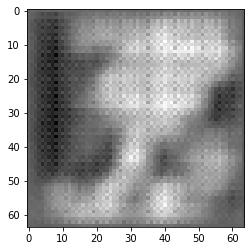

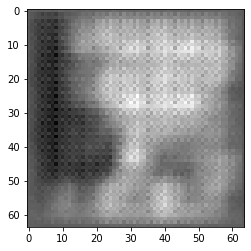

[2/300][0/6]
- D_loss : 1.4161 / G_loss : 0.6694
- D(x) : 0.5271 / D(G(z1)) : 0.5390 / D(G(z2)) : 0.5120 / d_acc : 0.4922
[2/300][1/6]
- D_loss : 1.4087 / G_loss : 0.6781
- D(x) : 0.5000 / D(G(z1)) : 0.5109 / D(G(z2)) : 0.5077 / d_acc : 0.3125
[2/300][2/6]
- D_loss : 1.4150 / G_loss : 0.6971
- D(x) : 0.4960 / D(G(z1)) : 0.5098 / D(G(z2)) : 0.4981 / d_acc : 0.2500
[2/300][3/6]
- D_loss : 1.4014 / G_loss : 0.6838
- D(x) : 0.4877 / D(G(z1)) : 0.4948 / D(G(z2)) : 0.5047 / d_acc : 0.3906
[2/300][4/6]
- D_loss : 1.4249 / G_loss : 0.6958
- D(x) : 0.4899 / D(G(z1)) : 0.5087 / D(G(z2)) : 0.4987 / d_acc : 0.1719
[2/300][5/6]
- D_loss : 1.4141 / G_loss : 0.6974
- D(x) : 0.4856 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4979 / d_acc : 0.3047


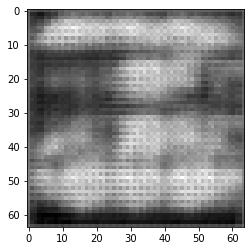

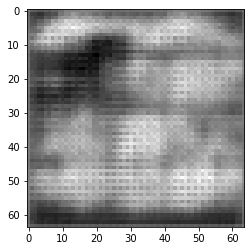

[3/300][0/6]
- D_loss : 1.4142 / G_loss : 0.7106
- D(x) : 0.4841 / D(G(z1)) : 0.4976 / D(G(z2)) : 0.4914 / d_acc : 0.2734
[3/300][1/6]
- D_loss : 1.3927 / G_loss : 0.6997
- D(x) : 0.4862 / D(G(z1)) : 0.4890 / D(G(z2)) : 0.4967 / d_acc : 0.5000
[3/300][2/6]
- D_loss : 1.4006 / G_loss : 0.6900
- D(x) : 0.4855 / D(G(z1)) : 0.4923 / D(G(z2)) : 0.5016 / d_acc : 0.4609
[3/300][3/6]
- D_loss : 1.4065 / G_loss : 0.6908
- D(x) : 0.4892 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5012 / d_acc : 0.2891
[3/300][4/6]
- D_loss : 1.3959 / G_loss : 0.6908
- D(x) : 0.4942 / D(G(z1)) : 0.4989 / D(G(z2)) : 0.5012 / d_acc : 0.4062
[3/300][5/6]
- D_loss : 1.3957 / G_loss : 0.6871
- D(x) : 0.4944 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5030 / d_acc : 0.3906


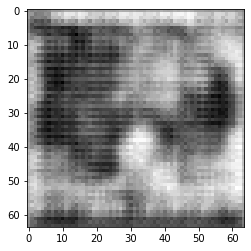

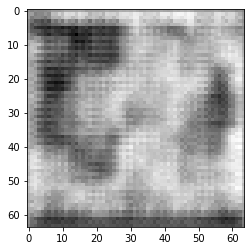

[4/300][0/6]
- D_loss : 1.3986 / G_loss : 0.6904
- D(x) : 0.4952 / D(G(z1)) : 0.5013 / D(G(z2)) : 0.5014 / d_acc : 0.2891
[4/300][1/6]
- D_loss : 1.3928 / G_loss : 0.6959
- D(x) : 0.4961 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4986 / d_acc : 0.4219
[4/300][2/6]
- D_loss : 1.3948 / G_loss : 0.6965
- D(x) : 0.4930 / D(G(z1)) : 0.4972 / D(G(z2)) : 0.4983 / d_acc : 0.4141
[4/300][3/6]
- D_loss : 1.3938 / G_loss : 0.6979
- D(x) : 0.4937 / D(G(z1)) : 0.4974 / D(G(z2)) : 0.4976 / d_acc : 0.4688
[4/300][4/6]
- D_loss : 1.3912 / G_loss : 0.6982
- D(x) : 0.4950 / D(G(z1)) : 0.4973 / D(G(z2)) : 0.4975 / d_acc : 0.5078
[4/300][5/6]
- D_loss : 1.3886 / G_loss : 0.6941
- D(x) : 0.4956 / D(G(z1)) : 0.4967 / D(G(z2)) : 0.4995 / d_acc : 0.5547


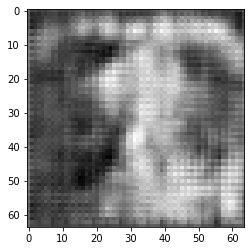

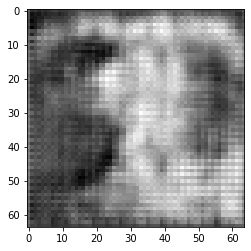

[5/300][0/6]
- D_loss : 1.3902 / G_loss : 0.6901
- D(x) : 0.4967 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.5015 / d_acc : 0.4531
[5/300][1/6]
- D_loss : 1.3972 / G_loss : 0.6968
- D(x) : 0.4962 / D(G(z1)) : 0.5016 / D(G(z2)) : 0.4982 / d_acc : 0.2500
[5/300][2/6]
- D_loss : 1.3883 / G_loss : 0.6985
- D(x) : 0.4962 / D(G(z1)) : 0.4972 / D(G(z2)) : 0.4973 / d_acc : 0.5625
[5/300][3/6]
- D_loss : 1.3872 / G_loss : 0.6915
- D(x) : 0.4956 / D(G(z1)) : 0.4961 / D(G(z2)) : 0.5008 / d_acc : 0.5078
[5/300][4/6]
- D_loss : 1.3955 / G_loss : 0.6938
- D(x) : 0.4958 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.4997 / d_acc : 0.2734
[5/300][5/6]
- D_loss : 1.3910 / G_loss : 0.6955
- D(x) : 0.4967 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.4988 / d_acc : 0.4375


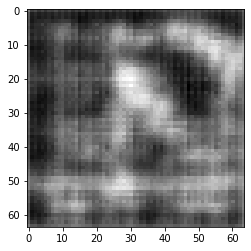

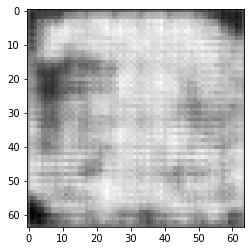

[6/300][0/6]
- D_loss : 1.3913 / G_loss : 0.6924
- D(x) : 0.4963 / D(G(z1)) : 0.4988 / D(G(z2)) : 0.5004 / d_acc : 0.4062
[6/300][1/6]
- D_loss : 1.3903 / G_loss : 0.6945
- D(x) : 0.4981 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4993 / d_acc : 0.3672
[6/300][2/6]
- D_loss : 1.3890 / G_loss : 0.6950
- D(x) : 0.4977 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.4991 / d_acc : 0.4375
[6/300][3/6]
- D_loss : 1.3903 / G_loss : 0.6940
- D(x) : 0.4967 / D(G(z1)) : 0.4987 / D(G(z2)) : 0.4996 / d_acc : 0.4375
[6/300][4/6]
- D_loss : 1.3894 / G_loss : 0.6947
- D(x) : 0.4975 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.4992 / d_acc : 0.4609
[6/300][5/6]
- D_loss : 1.3883 / G_loss : 0.6925
- D(x) : 0.4979 / D(G(z1)) : 0.4989 / D(G(z2)) : 0.5003 / d_acc : 0.5469


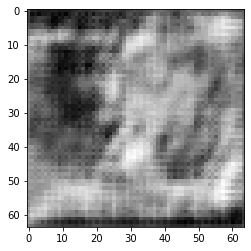

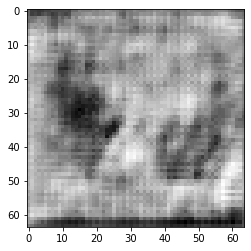

[7/300][0/6]
- D_loss : 1.3901 / G_loss : 0.6897
- D(x) : 0.4981 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5017 / d_acc : 0.4297
[7/300][1/6]
- D_loss : 1.3896 / G_loss : 0.6912
- D(x) : 0.4998 / D(G(z1)) : 0.5015 / D(G(z2)) : 0.5010 / d_acc : 0.3438
[7/300][2/6]
- D_loss : 1.3905 / G_loss : 0.6966
- D(x) : 0.4988 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.4983 / d_acc : 0.3438
[7/300][3/6]
- D_loss : 1.3886 / G_loss : 0.7005
- D(x) : 0.4968 / D(G(z1)) : 0.4979 / D(G(z2)) : 0.4963 / d_acc : 0.5156
[7/300][4/6]
- D_loss : 1.3882 / G_loss : 0.6978
- D(x) : 0.4953 / D(G(z1)) : 0.4962 / D(G(z2)) : 0.4977 / d_acc : 0.5078
[7/300][5/6]
- D_loss : 1.3909 / G_loss : 0.6972
- D(x) : 0.4955 / D(G(z1)) : 0.4977 / D(G(z2)) : 0.4980 / d_acc : 0.4609


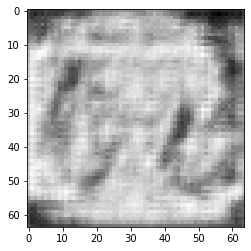

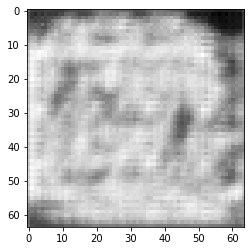

[8/300][0/6]
- D_loss : 1.3883 / G_loss : 0.6945
- D(x) : 0.4970 / D(G(z1)) : 0.4980 / D(G(z2)) : 0.4993 / d_acc : 0.4922
[8/300][1/6]
- D_loss : 1.3885 / G_loss : 0.6924
- D(x) : 0.4984 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5004 / d_acc : 0.4219
[8/300][2/6]
- D_loss : 1.3909 / G_loss : 0.6925
- D(x) : 0.4982 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5003 / d_acc : 0.2891
[8/300][3/6]
- D_loss : 1.3912 / G_loss : 0.6978
- D(x) : 0.4981 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.4977 / d_acc : 0.2656
[8/300][4/6]
- D_loss : 1.3880 / G_loss : 0.6982
- D(x) : 0.4969 / D(G(z1)) : 0.4978 / D(G(z2)) : 0.4975 / d_acc : 0.4609
[8/300][5/6]
- D_loss : 1.3883 / G_loss : 0.6947
- D(x) : 0.4967 / D(G(z1)) : 0.4977 / D(G(z2)) : 0.4992 / d_acc : 0.5078


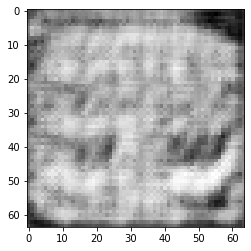

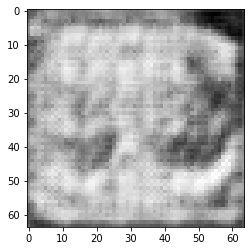

[9/300][0/6]
- D_loss : 1.3882 / G_loss : 0.6916
- D(x) : 0.4981 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5008 / d_acc : 0.5156
[9/300][1/6]
- D_loss : 1.3898 / G_loss : 0.6916
- D(x) : 0.4989 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5008 / d_acc : 0.3203
[9/300][2/6]
- D_loss : 1.3897 / G_loss : 0.6969
- D(x) : 0.4990 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.4981 / d_acc : 0.2734
[9/300][3/6]
- D_loss : 1.3875 / G_loss : 0.6996
- D(x) : 0.4974 / D(G(z1)) : 0.4980 / D(G(z2)) : 0.4968 / d_acc : 0.5781
[9/300][4/6]
- D_loss : 1.3872 / G_loss : 0.6982
- D(x) : 0.4962 / D(G(z1)) : 0.4967 / D(G(z2)) : 0.4975 / d_acc : 0.5312
[9/300][5/6]
- D_loss : 1.3902 / G_loss : 0.6982
- D(x) : 0.4955 / D(G(z1)) : 0.4974 / D(G(z2)) : 0.4975 / d_acc : 0.5078


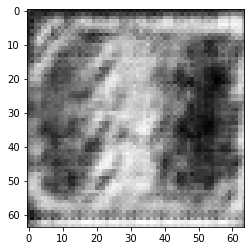

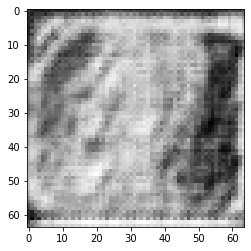

[10/300][0/6]
- D_loss : 1.3878 / G_loss : 0.6967
- D(x) : 0.4967 / D(G(z1)) : 0.4974 / D(G(z2)) : 0.4982 / d_acc : 0.5312
[10/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6919
- D(x) : 0.4978 / D(G(z1)) : 0.4979 / D(G(z2)) : 0.5006 / d_acc : 0.5156
[10/300][2/6]
- D_loss : 1.3888 / G_loss : 0.6896
- D(x) : 0.4991 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5018 / d_acc : 0.4062
[10/300][3/6]
- D_loss : 1.3884 / G_loss : 0.6898
- D(x) : 0.5006 / D(G(z1)) : 0.5017 / D(G(z2)) : 0.5017 / d_acc : 0.3828
[10/300][4/6]
- D_loss : 1.3872 / G_loss : 0.6907
- D(x) : 0.5011 / D(G(z1)) : 0.5016 / D(G(z2)) : 0.5012 / d_acc : 0.3359
[10/300][5/6]
- D_loss : 1.3885 / G_loss : 0.6940
- D(x) : 0.5001 / D(G(z1)) : 0.5011 / D(G(z2)) : 0.4996 / d_acc : 0.3281


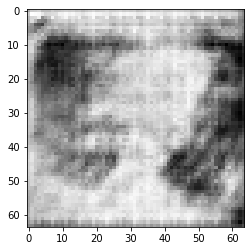

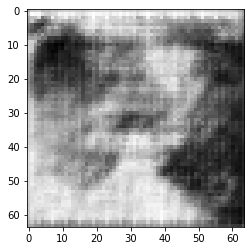

[11/300][0/6]
- D_loss : 1.3879 / G_loss : 0.6948
- D(x) : 0.4988 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4992 / d_acc : 0.3984
[11/300][1/6]
- D_loss : 1.3884 / G_loss : 0.6922
- D(x) : 0.4980 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5005 / d_acc : 0.3672
[11/300][2/6]
- D_loss : 1.3895 / G_loss : 0.6906
- D(x) : 0.4991 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5013 / d_acc : 0.3281
[11/300][3/6]
- D_loss : 1.3876 / G_loss : 0.6883
- D(x) : 0.5006 / D(G(z1)) : 0.5012 / D(G(z2)) : 0.5024 / d_acc : 0.4531
[11/300][4/6]
- D_loss : 1.3891 / G_loss : 0.6890
- D(x) : 0.5010 / D(G(z1)) : 0.5024 / D(G(z2)) : 0.5021 / d_acc : 0.3672
[11/300][5/6]
- D_loss : 1.3879 / G_loss : 0.6903
- D(x) : 0.5011 / D(G(z1)) : 0.5019 / D(G(z2)) : 0.5014 / d_acc : 0.3438


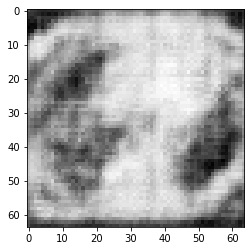

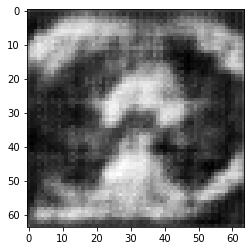

[12/300][0/6]
- D_loss : 1.3876 / G_loss : 0.6926
- D(x) : 0.5007 / D(G(z1)) : 0.5013 / D(G(z2)) : 0.5003 / d_acc : 0.3516
[12/300][1/6]
- D_loss : 1.3883 / G_loss : 0.6976
- D(x) : 0.4991 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4978 / d_acc : 0.3438
[12/300][2/6]
- D_loss : 1.3883 / G_loss : 0.6996
- D(x) : 0.4968 / D(G(z1)) : 0.4978 / D(G(z2)) : 0.4968 / d_acc : 0.5000
[12/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6975
- D(x) : 0.4966 / D(G(z1)) : 0.4967 / D(G(z2)) : 0.4978 / d_acc : 0.5078
[12/300][4/6]
- D_loss : 1.3889 / G_loss : 0.6960
- D(x) : 0.4967 / D(G(z1)) : 0.4979 / D(G(z2)) : 0.4986 / d_acc : 0.4922
[12/300][5/6]
- D_loss : 1.3872 / G_loss : 0.6943
- D(x) : 0.4979 / D(G(z1)) : 0.4983 / D(G(z2)) : 0.4994 / d_acc : 0.5312


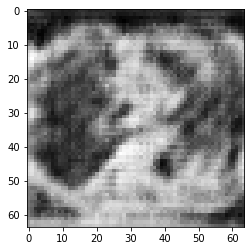

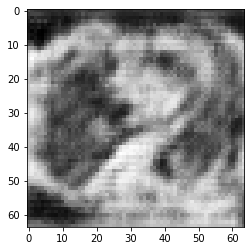

[13/300][0/6]
- D_loss : 1.3866 / G_loss : 0.6933
- D(x) : 0.4990 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4999 / d_acc : 0.5234
[13/300][1/6]
- D_loss : 1.3871 / G_loss : 0.6932
- D(x) : 0.4993 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.4766
[13/300][2/6]
- D_loss : 1.3872 / G_loss : 0.6929
- D(x) : 0.4992 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5001 / d_acc : 0.4375
[13/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6907
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5012 / d_acc : 0.5078
[13/300][4/6]
- D_loss : 1.3884 / G_loss : 0.6909
- D(x) : 0.5000 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5011 / d_acc : 0.2969
[13/300][5/6]
- D_loss : 1.3878 / G_loss : 0.6907
- D(x) : 0.5001 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5012 / d_acc : 0.3438


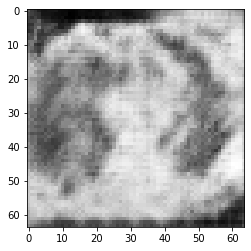

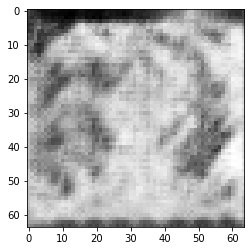

[14/300][0/6]
- D_loss : 1.3878 / G_loss : 0.6900
- D(x) : 0.5002 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5016 / d_acc : 0.3281
[14/300][1/6]
- D_loss : 1.3892 / G_loss : 0.6922
- D(x) : 0.4997 / D(G(z1)) : 0.5011 / D(G(z2)) : 0.5005 / d_acc : 0.3516
[14/300][2/6]
- D_loss : 1.3891 / G_loss : 0.6953
- D(x) : 0.4990 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.4989 / d_acc : 0.3516
[14/300][3/6]
- D_loss : 1.3872 / G_loss : 0.6956
- D(x) : 0.4983 / D(G(z1)) : 0.4987 / D(G(z2)) : 0.4988 / d_acc : 0.4922
[14/300][4/6]
- D_loss : 1.3881 / G_loss : 0.6955
- D(x) : 0.4977 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.4988 / d_acc : 0.4375
[14/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6941
- D(x) : 0.4983 / D(G(z1)) : 0.4987 / D(G(z2)) : 0.4995 / d_acc : 0.4219


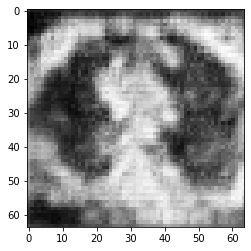

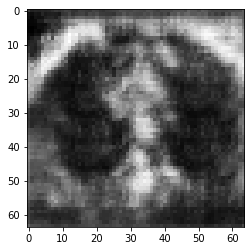

[15/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6912
- D(x) : 0.4992 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5010 / d_acc : 0.5469
[15/300][1/6]
- D_loss : 1.3872 / G_loss : 0.6908
- D(x) : 0.5001 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5012 / d_acc : 0.3516
[15/300][2/6]
- D_loss : 1.3883 / G_loss : 0.6921
- D(x) : 0.4999 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5005 / d_acc : 0.3438
[15/300][3/6]
- D_loss : 1.3875 / G_loss : 0.6928
- D(x) : 0.4997 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5002 / d_acc : 0.3594
[15/300][4/6]
- D_loss : 1.3874 / G_loss : 0.6932
- D(x) : 0.4995 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.4531
[15/300][5/6]
- D_loss : 1.3874 / G_loss : 0.6944
- D(x) : 0.4990 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4994 / d_acc : 0.4375


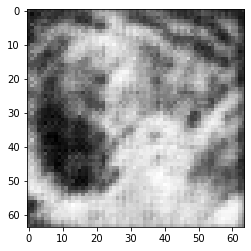

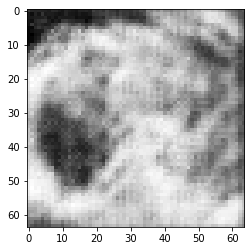

[16/300][0/6]
- D_loss : 1.3871 / G_loss : 0.6944
- D(x) : 0.4988 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4994 / d_acc : 0.4844
[16/300][1/6]
- D_loss : 1.3884 / G_loss : 0.6935
- D(x) : 0.4985 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.4062
[16/300][2/6]
- D_loss : 1.3874 / G_loss : 0.6907
- D(x) : 0.4991 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5012 / d_acc : 0.4453
[16/300][3/6]
- D_loss : 1.3881 / G_loss : 0.6907
- D(x) : 0.5001 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5012 / d_acc : 0.3828
[16/300][4/6]
- D_loss : 1.3874 / G_loss : 0.6927
- D(x) : 0.5004 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5002 / d_acc : 0.2969
[16/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6944
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4994 / d_acc : 0.3984


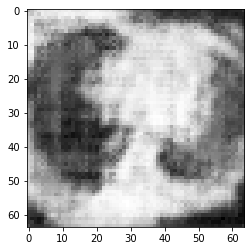

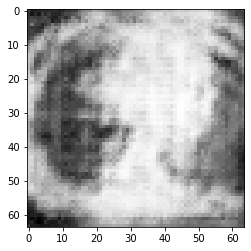

[17/300][0/6]
- D_loss : 1.3871 / G_loss : 0.6952
- D(x) : 0.4988 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4990 / d_acc : 0.5078
[17/300][1/6]
- D_loss : 1.3871 / G_loss : 0.6958
- D(x) : 0.4982 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.4987 / d_acc : 0.5078
[17/300][2/6]
- D_loss : 1.3877 / G_loss : 0.6946
- D(x) : 0.4979 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.4993 / d_acc : 0.4844
[17/300][3/6]
- D_loss : 1.3879 / G_loss : 0.6929
- D(x) : 0.4983 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5001 / d_acc : 0.4453
[17/300][4/6]
- D_loss : 1.3872 / G_loss : 0.6902
- D(x) : 0.4994 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5015 / d_acc : 0.4297
[17/300][5/6]
- D_loss : 1.3887 / G_loss : 0.6895
- D(x) : 0.5001 / D(G(z1)) : 0.5013 / D(G(z2)) : 0.5018 / d_acc : 0.2969


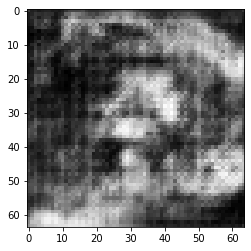

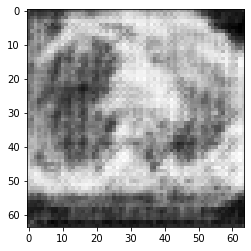

[18/300][0/6]
- D_loss : 1.3878 / G_loss : 0.6902
- D(x) : 0.5008 / D(G(z1)) : 0.5015 / D(G(z2)) : 0.5015 / d_acc : 0.3438
[18/300][1/6]
- D_loss : 1.3876 / G_loss : 0.6913
- D(x) : 0.5006 / D(G(z1)) : 0.5012 / D(G(z2)) : 0.5009 / d_acc : 0.3438
[18/300][2/6]
- D_loss : 1.3876 / G_loss : 0.6930
- D(x) : 0.5001 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5001 / d_acc : 0.3828
[18/300][3/6]
- D_loss : 1.3879 / G_loss : 0.6945
- D(x) : 0.4991 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4993 / d_acc : 0.3906
[18/300][4/6]
- D_loss : 1.3870 / G_loss : 0.6944
- D(x) : 0.4988 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.4994 / d_acc : 0.5312
[18/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6931
- D(x) : 0.4987 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5000 / d_acc : 0.5078


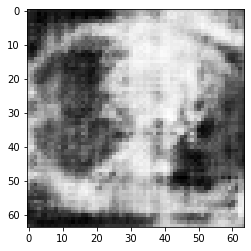

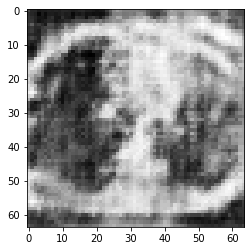

[19/300][0/6]
- D_loss : 1.3881 / G_loss : 0.6933
- D(x) : 0.4989 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4999 / d_acc : 0.4062
[19/300][1/6]
- D_loss : 1.3878 / G_loss : 0.6941
- D(x) : 0.4991 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4995 / d_acc : 0.4062
[19/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6936
- D(x) : 0.4992 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4998 / d_acc : 0.4922
[19/300][3/6]
- D_loss : 1.3868 / G_loss : 0.6936
- D(x) : 0.4994 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4998 / d_acc : 0.4375
[19/300][4/6]
- D_loss : 1.3874 / G_loss : 0.6948
- D(x) : 0.4990 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4992 / d_acc : 0.3594
[19/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6946
- D(x) : 0.4988 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.4993 / d_acc : 0.5312


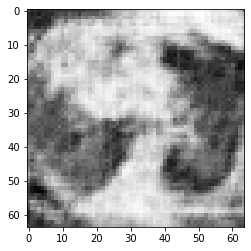

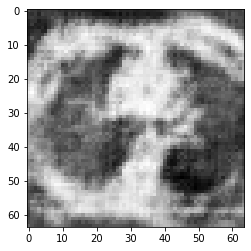

[20/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6940
- D(x) : 0.4989 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.4996 / d_acc : 0.5547
[20/300][1/6]
- D_loss : 1.3872 / G_loss : 0.6934
- D(x) : 0.4989 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4999 / d_acc : 0.4375
[20/300][2/6]
- D_loss : 1.3869 / G_loss : 0.6933
- D(x) : 0.4993 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4999 / d_acc : 0.5078
[20/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6935
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.5156
[20/300][4/6]
- D_loss : 1.3869 / G_loss : 0.6930
- D(x) : 0.4993 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5001 / d_acc : 0.4609
[20/300][5/6]
- D_loss : 1.3874 / G_loss : 0.6931
- D(x) : 0.4994 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.4453


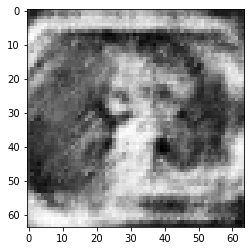

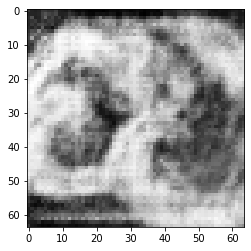

[21/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6927
- D(x) : 0.4995 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5002 / d_acc : 0.4609
[21/300][1/6]
- D_loss : 1.3868 / G_loss : 0.6924
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5004 / d_acc : 0.3984
[21/300][2/6]
- D_loss : 1.3871 / G_loss : 0.6934
- D(x) : 0.4998 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.4999 / d_acc : 0.3047
[21/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6943
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4994 / d_acc : 0.5156
[21/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6940
- D(x) : 0.4991 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4996 / d_acc : 0.5625
[21/300][5/6]
- D_loss : 1.3872 / G_loss : 0.6930
- D(x) : 0.4990 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5001 / d_acc : 0.4766


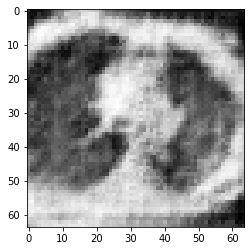

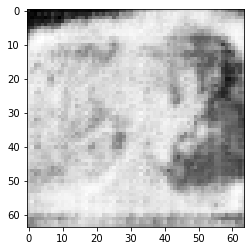

[22/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6916
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5008 / d_acc : 0.4766
[22/300][1/6]
- D_loss : 1.3869 / G_loss : 0.6919
- D(x) : 0.5003 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5006 / d_acc : 0.4219
[22/300][2/6]
- D_loss : 1.3870 / G_loss : 0.6933
- D(x) : 0.5001 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.4999 / d_acc : 0.4688
[22/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6942
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4995 / d_acc : 0.4688
[22/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6935
- D(x) : 0.4994 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4998 / d_acc : 0.5000
[22/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6927
- D(x) : 0.4996 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5002 / d_acc : 0.5156


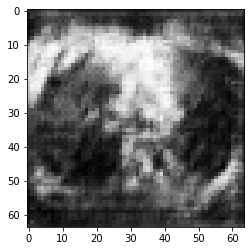

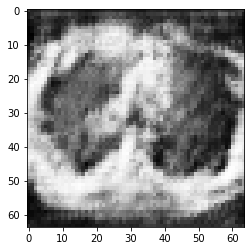

[23/300][0/6]
- D_loss : 1.3871 / G_loss : 0.6930
- D(x) : 0.4997 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5001 / d_acc : 0.4141
[23/300][1/6]
- D_loss : 1.3868 / G_loss : 0.6929
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5001 / d_acc : 0.4844
[23/300][2/6]
- D_loss : 1.3870 / G_loss : 0.6927
- D(x) : 0.4997 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5002 / d_acc : 0.4531
[23/300][3/6]
- D_loss : 1.3868 / G_loss : 0.6935
- D(x) : 0.4998 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4998 / d_acc : 0.4531
[23/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6934
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4999 / d_acc : 0.4688
[23/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6929
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.4609


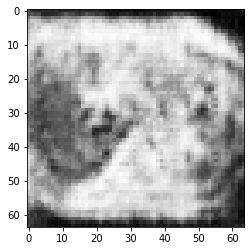

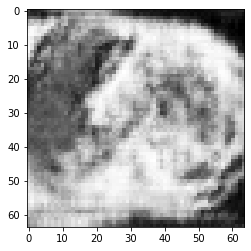

[24/300][0/6]
- D_loss : 1.3869 / G_loss : 0.6929
- D(x) : 0.4997 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.3984
[24/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6934
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4999 / d_acc : 0.5469
[24/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6929
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.5000
[24/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6926
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.5312
[24/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6927
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5002 / d_acc : 0.4609
[24/300][5/6]
- D_loss : 1.3869 / G_loss : 0.6936
- D(x) : 0.4998 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4998 / d_acc : 0.4531


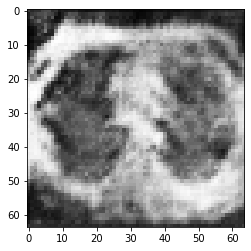

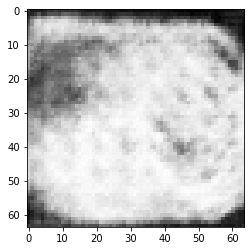

[25/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6936
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4998 / d_acc : 0.5234
[25/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6927
- D(x) : 0.4996 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5002 / d_acc : 0.5547
[25/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6919
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5006 / d_acc : 0.4688
[25/300][3/6]
- D_loss : 1.3875 / G_loss : 0.6916
- D(x) : 0.5000 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5008 / d_acc : 0.4062
[25/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6910
- D(x) : 0.5007 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5011 / d_acc : 0.3672
[25/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6925
- D(x) : 0.5006 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5003 / d_acc : 0.3984


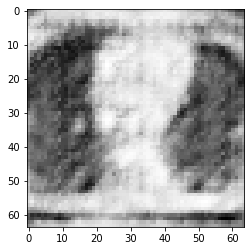

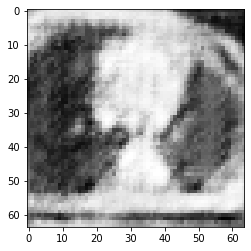

[26/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6935
- D(x) : 0.5000 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.4998 / d_acc : 0.4062
[26/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6942
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4995 / d_acc : 0.5469
[26/300][2/6]
- D_loss : 1.3870 / G_loss : 0.6943
- D(x) : 0.4991 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4994 / d_acc : 0.5234
[26/300][3/6]
- D_loss : 1.3868 / G_loss : 0.6933
- D(x) : 0.4991 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4999 / d_acc : 0.4844
[26/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6926
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.4766
[26/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6921
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5005 / d_acc : 0.4531


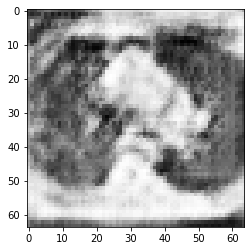

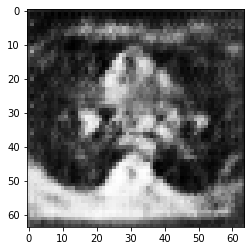

[27/300][0/6]
- D_loss : 1.3871 / G_loss : 0.6921
- D(x) : 0.5001 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5005 / d_acc : 0.4141
[27/300][1/6]
- D_loss : 1.3870 / G_loss : 0.6930
- D(x) : 0.5001 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5001 / d_acc : 0.4141
[27/300][2/6]
- D_loss : 1.3869 / G_loss : 0.6932
- D(x) : 0.4997 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.5000
[27/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6933
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4999 / d_acc : 0.5312
[27/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6929
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.5156
[27/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6929
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4297


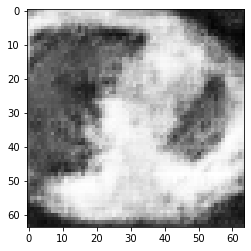

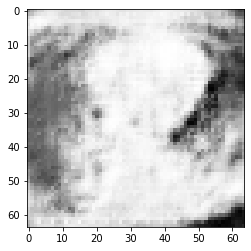

[28/300][0/6]
- D_loss : 1.3869 / G_loss : 0.6938
- D(x) : 0.4998 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4997 / d_acc : 0.4375
[28/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6940
- D(x) : 0.4996 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4996 / d_acc : 0.5156
[28/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6936
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.4766
[28/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6934
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4999 / d_acc : 0.4844
[28/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6931
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.4844
[28/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6926
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5003 / d_acc : 0.4531


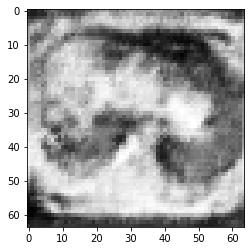

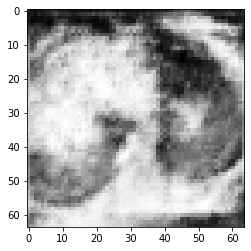

[29/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6922
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5005 / d_acc : 0.4453
[29/300][1/6]
- D_loss : 1.3869 / G_loss : 0.6914
- D(x) : 0.5001 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5009 / d_acc : 0.3750
[29/300][2/6]
- D_loss : 1.3869 / G_loss : 0.6913
- D(x) : 0.5004 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5009 / d_acc : 0.3203
[29/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6919
- D(x) : 0.5006 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5006 / d_acc : 0.3750
[29/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6930
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5001 / d_acc : 0.3984
[29/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6930
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4531


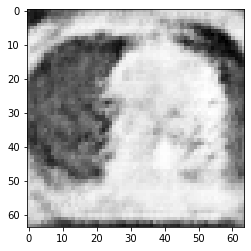

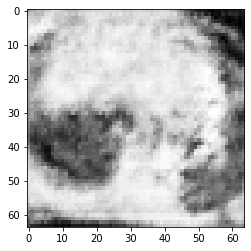

[30/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6935
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4998 / d_acc : 0.4766
[30/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6931
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.5469
[30/300][2/6]
- D_loss : 1.3871 / G_loss : 0.6933
- D(x) : 0.4995 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4999 / d_acc : 0.4375
[30/300][3/6]
- D_loss : 1.3868 / G_loss : 0.6931
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.5078
[30/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6934
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4999 / d_acc : 0.5000
[30/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6937
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4997 / d_acc : 0.5625


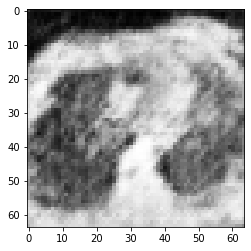

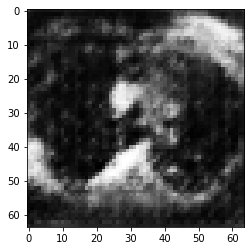

[31/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6938
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4997 / d_acc : 0.5391
[31/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6934
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4999 / d_acc : 0.5312
[31/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6933
- D(x) : 0.4995 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4999 / d_acc : 0.5156
[31/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6932
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.5078
[31/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6932
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.5312
[31/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6927
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5002 / d_acc : 0.5391


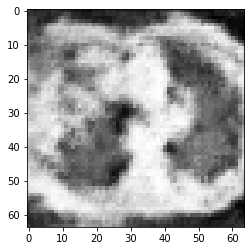

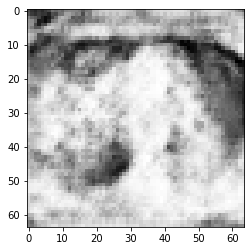

[32/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6924
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5004 / d_acc : 0.5078
[32/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6918
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5007 / d_acc : 0.5156
[32/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6915
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5008 / d_acc : 0.4141
[32/300][3/6]
- D_loss : 1.3869 / G_loss : 0.6913
- D(x) : 0.5004 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5009 / d_acc : 0.3516
[32/300][4/6]
- D_loss : 1.3870 / G_loss : 0.6921
- D(x) : 0.5004 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5005 / d_acc : 0.4141
[32/300][5/6]
- D_loss : 1.3869 / G_loss : 0.6933
- D(x) : 0.5001 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.4999 / d_acc : 0.3750


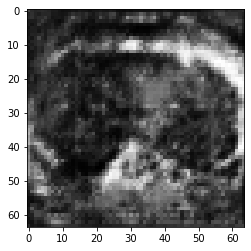

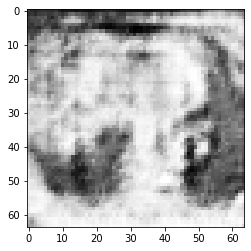

[33/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6941
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4995 / d_acc : 0.5078
[33/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6943
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4994 / d_acc : 0.5078
[33/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6938
- D(x) : 0.4992 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4997 / d_acc : 0.5703
[33/300][3/6]
- D_loss : 1.3872 / G_loss : 0.6936
- D(x) : 0.4991 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.4922
[33/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6930
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5001 / d_acc : 0.5391
[33/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6925
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5003 / d_acc : 0.5000


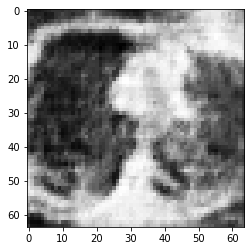

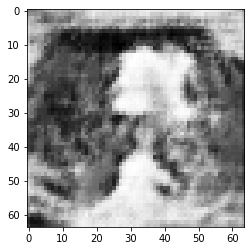

[34/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6926
- D(x) : 0.4999 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5003 / d_acc : 0.4141
[34/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6922
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5005 / d_acc : 0.4766
[34/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6919
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5006 / d_acc : 0.4688
[34/300][3/6]
- D_loss : 1.3870 / G_loss : 0.6928
- D(x) : 0.5002 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5002 / d_acc : 0.3359
[34/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6936
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4998 / d_acc : 0.5625
[34/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6934
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4999 / d_acc : 0.5156


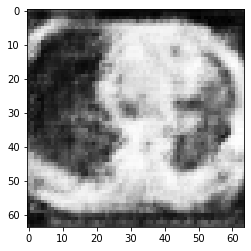

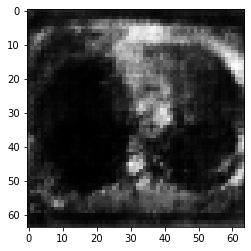

[35/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6932
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.4844
[35/300][1/6]
- D_loss : 1.3871 / G_loss : 0.6935
- D(x) : 0.4995 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4998 / d_acc : 0.4844
[35/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6940
- D(x) : 0.4994 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4996 / d_acc : 0.4766
[35/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6935
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4998 / d_acc : 0.5156
[35/300][4/6]
- D_loss : 1.3861 / G_loss : 0.6925
- D(x) : 0.4998 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5003 / d_acc : 0.5703
[35/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6917
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5007 / d_acc : 0.4531


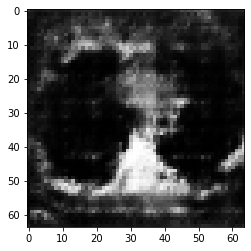

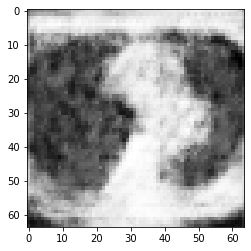

[36/300][0/6]
- D_loss : 1.3869 / G_loss : 0.6926
- D(x) : 0.5003 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5003 / d_acc : 0.2734
[36/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6931
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5000 / d_acc : 0.4844
[36/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6924
- D(x) : 0.4997 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5004 / d_acc : 0.5000
[36/300][3/6]
- D_loss : 1.3874 / G_loss : 0.6932
- D(x) : 0.4998 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5000 / d_acc : 0.3750
[36/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6930
- D(x) : 0.4999 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.5469
[36/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6928
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5002 / d_acc : 0.5078


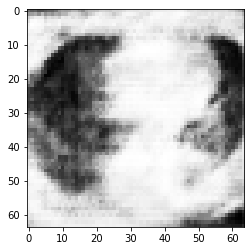

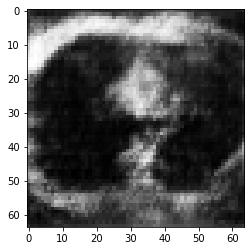

[37/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6933
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4999 / d_acc : 0.5234
[37/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6933
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4999 / d_acc : 0.5234
[37/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6931
- D(x) : 0.4995 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.4922
[37/300][3/6]
- D_loss : 1.3871 / G_loss : 0.6928
- D(x) : 0.4996 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5002 / d_acc : 0.4766
[37/300][4/6]
- D_loss : 1.3868 / G_loss : 0.6929
- D(x) : 0.4998 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5001 / d_acc : 0.5000
[37/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6932
- D(x) : 0.4998 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5000 / d_acc : 0.4922


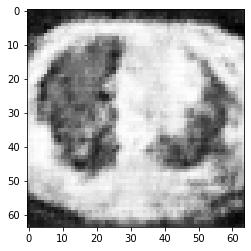

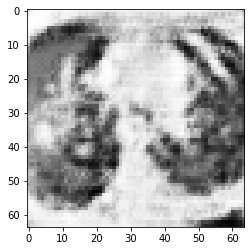

[38/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6941
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4995 / d_acc : 0.4219
[38/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6936
- D(x) : 0.4993 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4997 / d_acc : 0.5547
[38/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6936
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4998 / d_acc : 0.5156
[38/300][3/6]
- D_loss : 1.3869 / G_loss : 0.6933
- D(x) : 0.4994 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4999 / d_acc : 0.5156
[38/300][4/6]
- D_loss : 1.3867 / G_loss : 0.6943
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4994 / d_acc : 0.4688
[38/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6939
- D(x) : 0.4993 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4996 / d_acc : 0.5391


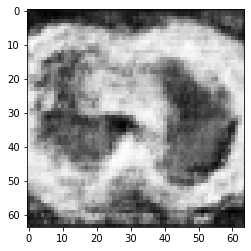

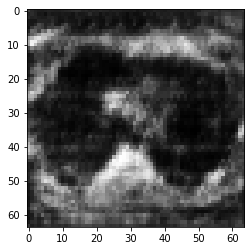

[39/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5001 / d_acc : 0.5469
[39/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6918
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5007 / d_acc : 0.4609
[39/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6918
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5007 / d_acc : 0.4062
[39/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6921
- D(x) : 0.5004 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5005 / d_acc : 0.3828
[39/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6925
- D(x) : 0.5003 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5003 / d_acc : 0.3984
[39/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6930
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5001 / d_acc : 0.5000


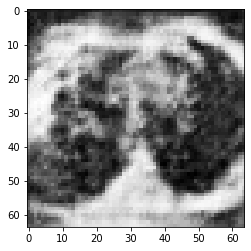

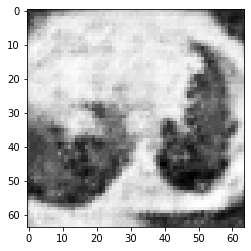

[40/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6927
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5002 / d_acc : 0.4141
[40/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6929
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5001 / d_acc : 0.4766
[40/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6926
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5003 / d_acc : 0.4453
[40/300][3/6]
- D_loss : 1.3862 / G_loss : 0.6926
- D(x) : 0.5002 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5003 / d_acc : 0.4453
[40/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6934
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.4999 / d_acc : 0.4844
[40/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6941
- D(x) : 0.4997 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4995 / d_acc : 0.4922


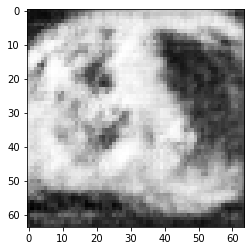

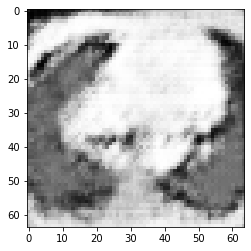

[41/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6936
- D(x) : 0.4993 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4998 / d_acc : 0.5234
[41/300][1/6]
- D_loss : 1.3869 / G_loss : 0.6928
- D(x) : 0.4994 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5002 / d_acc : 0.4766
[41/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6916
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5008 / d_acc : 0.5156
[41/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6911
- D(x) : 0.5006 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5010 / d_acc : 0.4375
[41/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6918
- D(x) : 0.5007 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5007 / d_acc : 0.4141
[41/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.5005 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5001 / d_acc : 0.4531


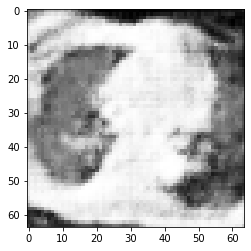

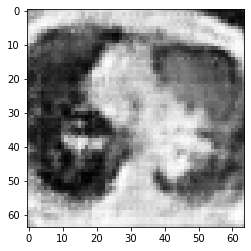

[42/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4688
[42/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6930
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.5000
[42/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6936
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4998 / d_acc : 0.4688
[42/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6935
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4998 / d_acc : 0.4766
[42/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6935
- D(x) : 0.4996 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.4922
[42/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6935
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4998 / d_acc : 0.4766


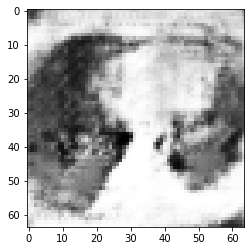

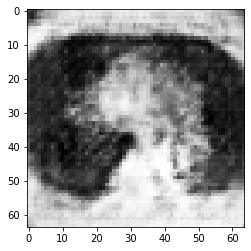

[43/300][0/6]
- D_loss : 1.3872 / G_loss : 0.6936
- D(x) : 0.4994 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4998 / d_acc : 0.4922
[43/300][1/6]
- D_loss : 1.3870 / G_loss : 0.6931
- D(x) : 0.4993 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.4766
[43/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6923
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5004 / d_acc : 0.4688
[43/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6912
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5010 / d_acc : 0.5000
[43/300][4/6]
- D_loss : 1.3868 / G_loss : 0.6909
- D(x) : 0.5006 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5011 / d_acc : 0.4141
[43/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6922
- D(x) : 0.5007 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5005 / d_acc : 0.4453


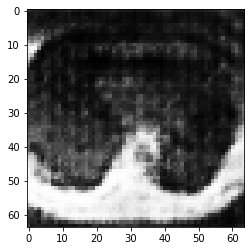

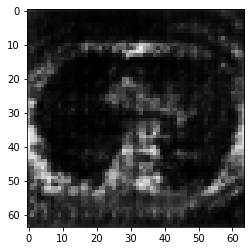

[44/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6935
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.4998 / d_acc : 0.4766
[44/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6938
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4997 / d_acc : 0.5000
[44/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6937
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4997 / d_acc : 0.5156
[44/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6928
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5002 / d_acc : 0.5391
[44/300][4/6]
- D_loss : 1.3862 / G_loss : 0.6920
- D(x) : 0.5001 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5006 / d_acc : 0.4844
[44/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6919
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5006 / d_acc : 0.4453


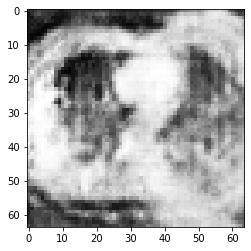

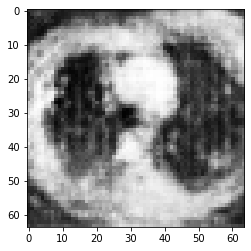

[45/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6922
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5005 / d_acc : 0.3906
[45/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6926
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5003 / d_acc : 0.5000
[45/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6932
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5000 / d_acc : 0.4531
[45/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6928
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5002 / d_acc : 0.5000
[45/300][4/6]
- D_loss : 1.3869 / G_loss : 0.6926
- D(x) : 0.4997 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5003 / d_acc : 0.4766
[45/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6918
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5007 / d_acc : 0.5156


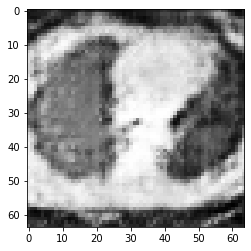

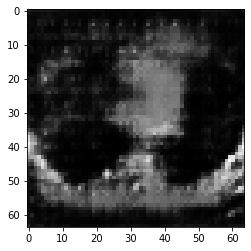

[46/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6918
- D(x) : 0.5005 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5007 / d_acc : 0.4297
[46/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6924
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5004 / d_acc : 0.3750
[46/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6930
- D(x) : 0.5000 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5001 / d_acc : 0.4609
[46/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6933
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4999 / d_acc : 0.4844
[46/300][4/6]
- D_loss : 1.3868 / G_loss : 0.6927
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5002 / d_acc : 0.4609
[46/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6916
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5008 / d_acc : 0.5234


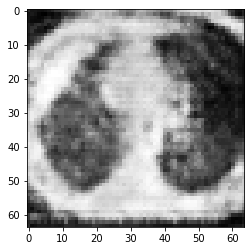

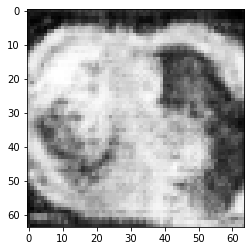

[47/300][0/6]
- D_loss : 1.3869 / G_loss : 0.6917
- D(x) : 0.5003 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5007 / d_acc : 0.4609
[47/300][1/6]
- D_loss : 1.3870 / G_loss : 0.6927
- D(x) : 0.5003 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5002 / d_acc : 0.4219
[47/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6931
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5000 / d_acc : 0.4844
[47/300][3/6]
- D_loss : 1.3868 / G_loss : 0.6938
- D(x) : 0.4996 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4997 / d_acc : 0.4453
[47/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6938
- D(x) : 0.4993 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4997 / d_acc : 0.5000
[47/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6925
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5003 / d_acc : 0.5000


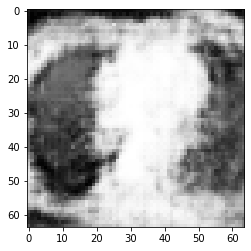

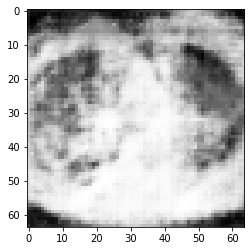

[48/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6919
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5006 / d_acc : 0.4141
[48/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6924
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5004 / d_acc : 0.4141
[48/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6931
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5000 / d_acc : 0.4141
[48/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6936
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4998 / d_acc : 0.4688
[48/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6934
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4999 / d_acc : 0.5547
[48/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6930
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.5156


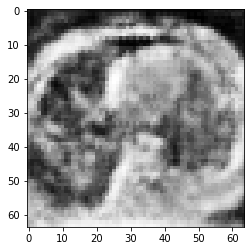

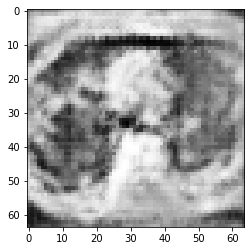

[49/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6921
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5005 / d_acc : 0.5156
[49/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6925
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5003 / d_acc : 0.4609
[49/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5001 / d_acc : 0.4609
[49/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6924
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5004 / d_acc : 0.4844
[49/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5004 / d_acc : 0.5391
[49/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6925
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5003 / d_acc : 0.5000


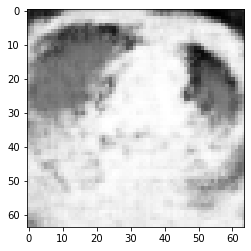

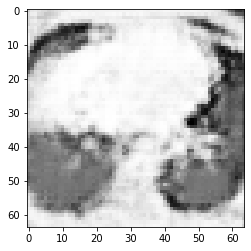

[50/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6932
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5000 / d_acc : 0.5000
[50/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6937
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4997 / d_acc : 0.5078
[50/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6942
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4995 / d_acc : 0.4844
[50/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6942
- D(x) : 0.4992 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4995 / d_acc : 0.5156
[50/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6935
- D(x) : 0.4993 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4998 / d_acc : 0.5234
[50/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6929
- D(x) : 0.4993 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5001 / d_acc : 0.4609


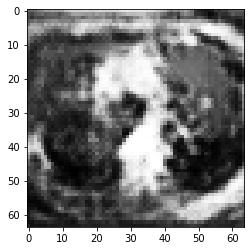

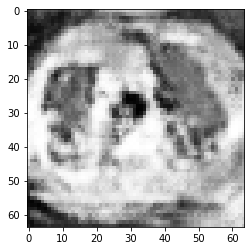

[51/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6920
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5006 / d_acc : 0.4688
[51/300][1/6]
- D_loss : 1.3861 / G_loss : 0.6918
- D(x) : 0.5005 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5007 / d_acc : 0.4766
[51/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6928
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5002 / d_acc : 0.4062
[51/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6932
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.5078
[51/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6932
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.4922
[51/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6927
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5002 / d_acc : 0.5078


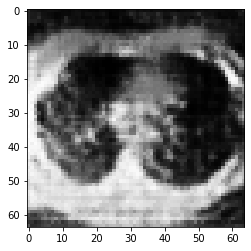

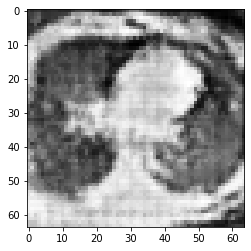

[52/300][0/6]
- D_loss : 1.3866 / G_loss : 0.6923
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5004 / d_acc : 0.4375
[52/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6918
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5007 / d_acc : 0.4609
[52/300][2/6]
- D_loss : 1.3869 / G_loss : 0.6926
- D(x) : 0.5003 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5003 / d_acc : 0.3984
[52/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6939
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4996 / d_acc : 0.4766
[52/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6940
- D(x) : 0.4996 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4996 / d_acc : 0.5000
[52/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6933
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4999 / d_acc : 0.5234


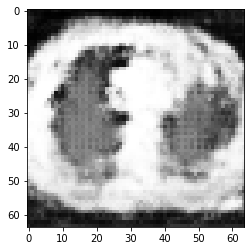

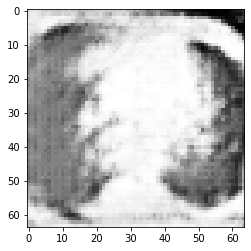

[53/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6925
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.5234
[53/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6922
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5005 / d_acc : 0.4375
[53/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6926
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5003 / d_acc : 0.4297
[53/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6930
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5000 / d_acc : 0.4688
[53/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6930
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4453
[53/300][5/6]
- D_loss : 1.3869 / G_loss : 0.6931
- D(x) : 0.4997 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.4922


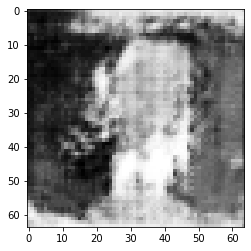

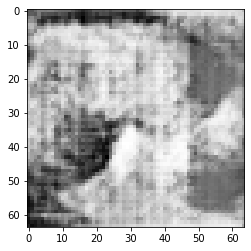

[54/300][0/6]
- D_loss : 1.3871 / G_loss : 0.6932
- D(x) : 0.4996 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.4766
[54/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6930
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5001 / d_acc : 0.5391
[54/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6925
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5003 / d_acc : 0.4922
[54/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6927
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5002 / d_acc : 0.4922
[54/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6924
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5004 / d_acc : 0.4609
[54/300][5/6]
- D_loss : 1.3869 / G_loss : 0.6919
- D(x) : 0.4999 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5006 / d_acc : 0.4375


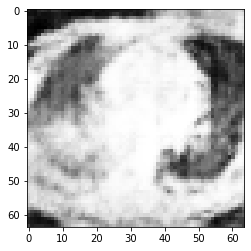

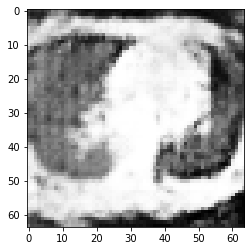

[55/300][0/6]
- D_loss : 1.3866 / G_loss : 0.6918
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5007 / d_acc : 0.4531
[55/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6924
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5004 / d_acc : 0.5000
[55/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6928
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4922
[55/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6935
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4998 / d_acc : 0.4531
[55/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6934
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4999 / d_acc : 0.4609
[55/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6922
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5005 / d_acc : 0.4609


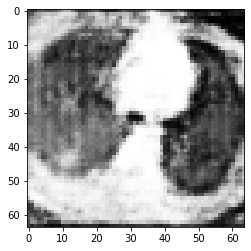

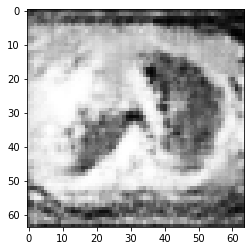

[56/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6912
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5010 / d_acc : 0.4375
[56/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6910
- D(x) : 0.5006 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5011 / d_acc : 0.5156
[56/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6917
- D(x) : 0.5008 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5007 / d_acc : 0.4375
[56/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6924
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5004 / d_acc : 0.4375
[56/300][4/6]
- D_loss : 1.3867 / G_loss : 0.6931
- D(x) : 0.4999 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5000 / d_acc : 0.4766
[56/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6926
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.4844


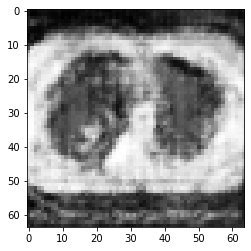

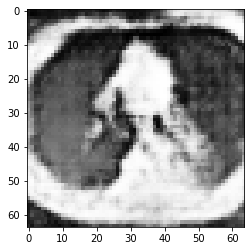

[57/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6922
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5005 / d_acc : 0.4219
[57/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6924
- D(x) : 0.5004 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5004 / d_acc : 0.4766
[57/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6930
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5001 / d_acc : 0.4688
[57/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6938
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4997 / d_acc : 0.4375
[57/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6935
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.5000
[57/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5004 / d_acc : 0.4453


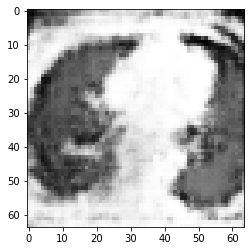

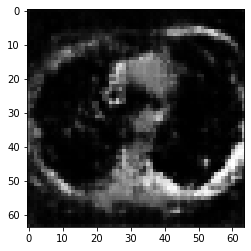

[58/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6914
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5009 / d_acc : 0.5000
[58/300][1/6]
- D_loss : 1.3869 / G_loss : 0.6928
- D(x) : 0.5005 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5002 / d_acc : 0.4453
[58/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6937
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4997 / d_acc : 0.4297
[58/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6935
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.4453
[58/300][4/6]
- D_loss : 1.3868 / G_loss : 0.6932
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.4688
[58/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6939
- D(x) : 0.4995 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4996 / d_acc : 0.4375


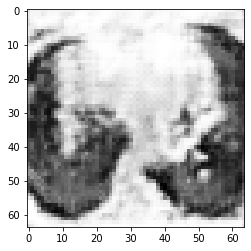

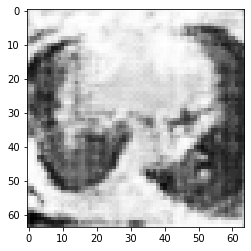

[59/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6939
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4996 / d_acc : 0.5234
[59/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6933
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4999 / d_acc : 0.4688
[59/300][2/6]
- D_loss : 1.3869 / G_loss : 0.6937
- D(x) : 0.4995 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4997 / d_acc : 0.4609
[59/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6941
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4995 / d_acc : 0.4922
[59/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6940
- D(x) : 0.4993 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4996 / d_acc : 0.5000
[59/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6928
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5002 / d_acc : 0.5000


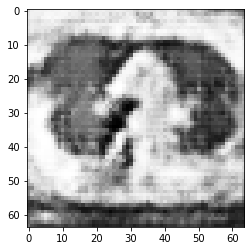

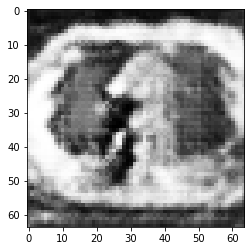

[60/300][0/6]
- D_loss : 1.3869 / G_loss : 0.6918
- D(x) : 0.4999 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5007 / d_acc : 0.4688
[60/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6916
- D(x) : 0.5006 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5008 / d_acc : 0.4453
[60/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6916
- D(x) : 0.5006 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5008 / d_acc : 0.4297
[60/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6921
- D(x) : 0.5006 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5005 / d_acc : 0.4219
[60/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5001 / d_acc : 0.4141
[60/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6938
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4997 / d_acc : 0.5000


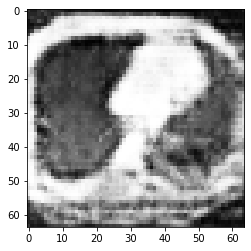

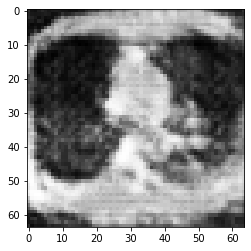

[61/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6937
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4997 / d_acc : 0.4922
[61/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6932
- D(x) : 0.4993 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5000 / d_acc : 0.4844
[61/300][2/6]
- D_loss : 1.3871 / G_loss : 0.6925
- D(x) : 0.4994 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.4766
[61/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6922
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5005 / d_acc : 0.5078
[61/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6922
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5005 / d_acc : 0.4375
[61/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6924
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.4922


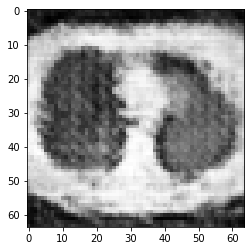

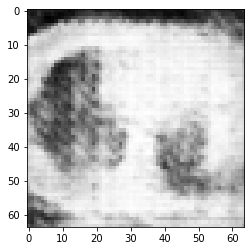

[62/300][0/6]
- D_loss : 1.3869 / G_loss : 0.6927
- D(x) : 0.4999 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4141
[62/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6926
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5003 / d_acc : 0.4609
[62/300][2/6]
- D_loss : 1.3870 / G_loss : 0.6928
- D(x) : 0.4998 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4609
[62/300][3/6]
- D_loss : 1.3868 / G_loss : 0.6934
- D(x) : 0.4998 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4999 / d_acc : 0.4141
[62/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6939
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4996 / d_acc : 0.5078
[62/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6944
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4994 / d_acc : 0.4844


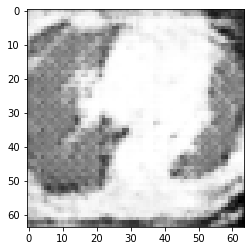

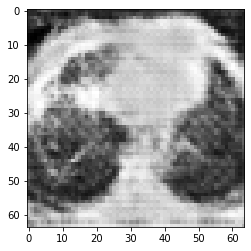

[63/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6934
- D(x) : 0.4993 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4999 / d_acc : 0.5000
[63/300][1/6]
- D_loss : 1.3870 / G_loss : 0.6924
- D(x) : 0.4995 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5004 / d_acc : 0.4375
[63/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6923
- D(x) : 0.5001 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.4453
[63/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6925
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5003 / d_acc : 0.5234
[63/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5001 / d_acc : 0.4609
[63/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6931
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.4688


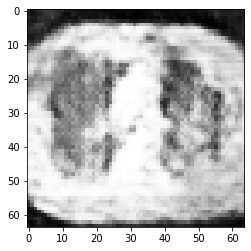

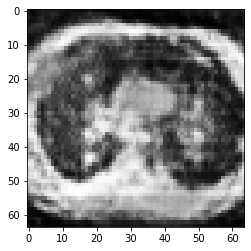

[64/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6926
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5003 / d_acc : 0.5234
[64/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6919
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5006 / d_acc : 0.4688
[64/300][2/6]
- D_loss : 1.3869 / G_loss : 0.6919
- D(x) : 0.5002 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5006 / d_acc : 0.4219
[64/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6925
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5003 / d_acc : 0.4531
[64/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6928
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4531
[64/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6930
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5001 / d_acc : 0.4375


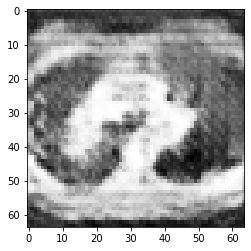

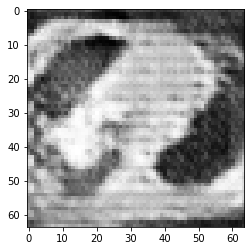

[65/300][0/6]
- D_loss : 1.3866 / G_loss : 0.6936
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4998 / d_acc : 0.4766
[65/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6937
- D(x) : 0.4996 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4997 / d_acc : 0.5078
[65/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6935
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.4922
[65/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6927
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5002 / d_acc : 0.4922
[65/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6920
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5006 / d_acc : 0.4922
[65/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6921
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5005 / d_acc : 0.5469


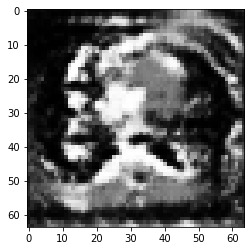

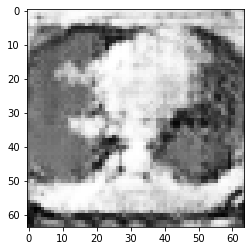

[66/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6925
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5003 / d_acc : 0.4922
[66/300][1/6]
- D_loss : 1.3862 / G_loss : 0.6928
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4922
[66/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4688
[66/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6930
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4531
[66/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6931
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.4844
[66/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6932
- D(x) : 0.4999 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.5391


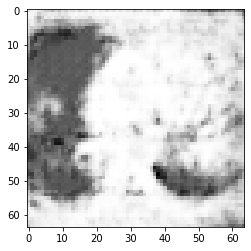

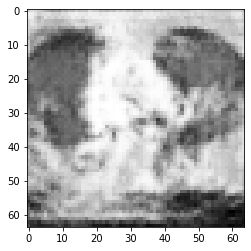

[67/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6928
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5002 / d_acc : 0.4922
[67/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6922
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5005 / d_acc : 0.4766
[67/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6923
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.5078
[67/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6925
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5003 / d_acc : 0.5312
[67/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6926
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5003 / d_acc : 0.5078
[67/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6922
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5005 / d_acc : 0.4844


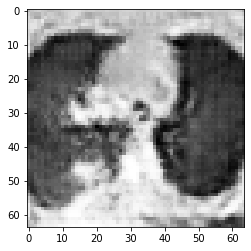

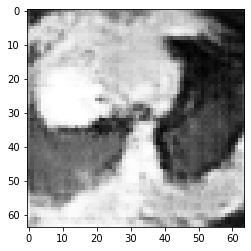

[68/300][0/6]
- D_loss : 1.3869 / G_loss : 0.6925
- D(x) : 0.5000 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5003 / d_acc : 0.4531
[68/300][1/6]
- D_loss : 1.3862 / G_loss : 0.6925
- D(x) : 0.5003 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5003 / d_acc : 0.5312
[68/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6936
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.4998 / d_acc : 0.4375
[68/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6940
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4996 / d_acc : 0.4922
[68/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6938
- D(x) : 0.4994 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4997 / d_acc : 0.5234
[68/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6930
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5001 / d_acc : 0.4688


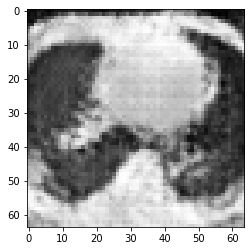

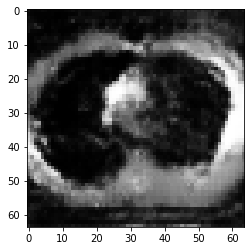

[69/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6916
- D(x) : 0.5000 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5008 / d_acc : 0.5391
[69/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6912
- D(x) : 0.5004 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5010 / d_acc : 0.4062
[69/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6915
- D(x) : 0.5007 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5008 / d_acc : 0.4688
[69/300][3/6]
- D_loss : 1.3862 / G_loss : 0.6923
- D(x) : 0.5006 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5004 / d_acc : 0.4375
[69/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6929
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5001 / d_acc : 0.4688
[69/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6932
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.4609


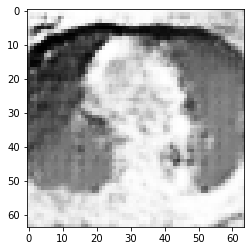

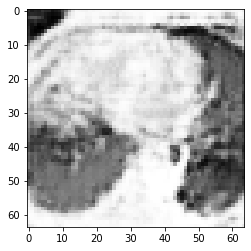

[70/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.5156
[70/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6930
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.5000
[70/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6931
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.4922
[70/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6933
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4999 / d_acc : 0.4844
[70/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6936
- D(x) : 0.4996 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4998 / d_acc : 0.4688
[70/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6939
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4996 / d_acc : 0.4609


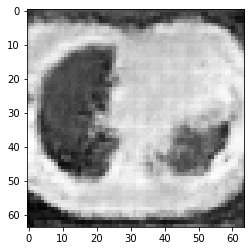

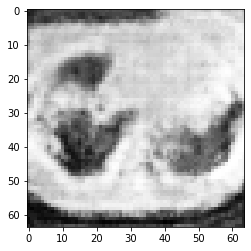

[71/300][0/6]
- D_loss : 1.3861 / G_loss : 0.6937
- D(x) : 0.4995 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4997 / d_acc : 0.5078
[71/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6931
- D(x) : 0.4993 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5000 / d_acc : 0.4766
[71/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6925
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.4531
[71/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6919
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5006 / d_acc : 0.5078
[71/300][4/6]
- D_loss : 1.3868 / G_loss : 0.6917
- D(x) : 0.5002 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5007 / d_acc : 0.4766
[71/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6922
- D(x) : 0.5003 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5005 / d_acc : 0.5000


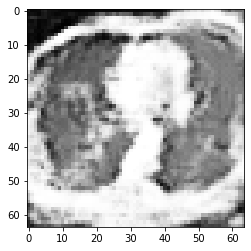

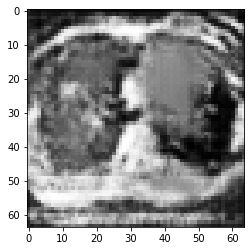

[72/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6930
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5001 / d_acc : 0.5156
[72/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6927
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5002 / d_acc : 0.4844
[72/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6924
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5004 / d_acc : 0.4531
[72/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6925
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5003 / d_acc : 0.4922
[72/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6931
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5000 / d_acc : 0.5000
[72/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6939
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4996 / d_acc : 0.4453


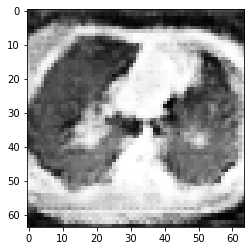

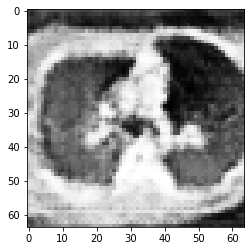

[73/300][0/6]
- D_loss : 1.3866 / G_loss : 0.6936
- D(x) : 0.4993 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4998 / d_acc : 0.4609
[73/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6929
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5001 / d_acc : 0.4531
[73/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6925
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5003 / d_acc : 0.4844
[73/300][3/6]
- D_loss : 1.3860 / G_loss : 0.6922
- D(x) : 0.5003 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5005 / d_acc : 0.5312
[73/300][4/6]
- D_loss : 1.3862 / G_loss : 0.6924
- D(x) : 0.5004 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.5156
[73/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6928
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4844


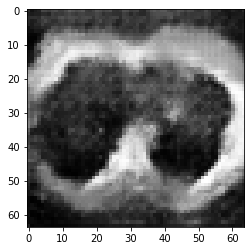

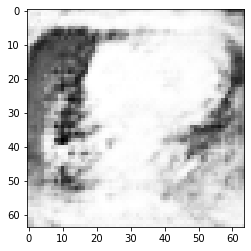

[74/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6929
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4766
[74/300][1/6]
- D_loss : 1.3868 / G_loss : 0.6923
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5004 / d_acc : 0.4219
[74/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6912
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5010 / d_acc : 0.4219
[74/300][3/6]
- D_loss : 1.3875 / G_loss : 0.6935
- D(x) : 0.5002 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.4998 / d_acc : 0.4141
[74/300][4/6]
- D_loss : 1.3862 / G_loss : 0.6937
- D(x) : 0.4997 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4997 / d_acc : 0.4688
[74/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6931
- D(x) : 0.4997 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5000 / d_acc : 0.5703


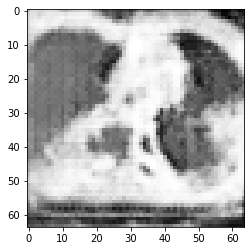

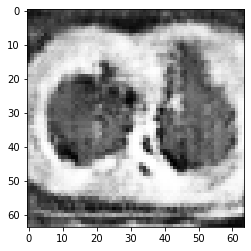

[75/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6925
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5003 / d_acc : 0.4688
[75/300][1/6]
- D_loss : 1.3862 / G_loss : 0.6920
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5006 / d_acc : 0.5391
[75/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6921
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5005 / d_acc : 0.4688
[75/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6928
- D(x) : 0.5003 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5002 / d_acc : 0.4609
[75/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6931
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.4453
[75/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6923
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5004 / d_acc : 0.4766


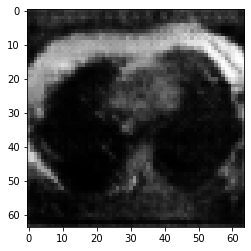

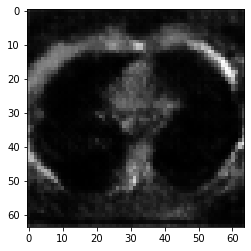

[76/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6920
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5006 / d_acc : 0.4375
[76/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6930
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5000 / d_acc : 0.4141
[76/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6945
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4993 / d_acc : 0.4766
[76/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6945
- D(x) : 0.4991 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.4993 / d_acc : 0.5078
[76/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6937
- D(x) : 0.4991 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4997 / d_acc : 0.5078
[76/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6935
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.5078


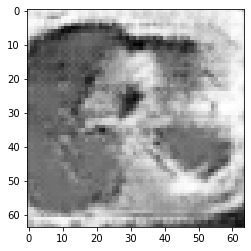

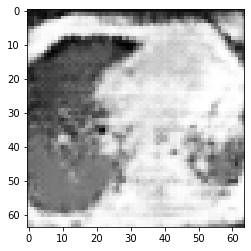

[77/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5004 / d_acc : 0.5078
[77/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6924
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.5078
[77/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6930
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5001 / d_acc : 0.5547
[77/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6931
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.4922
[77/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6923
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5004 / d_acc : 0.4453
[77/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6913
- D(x) : 0.5003 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5009 / d_acc : 0.4844


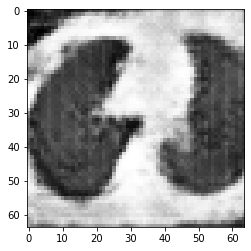

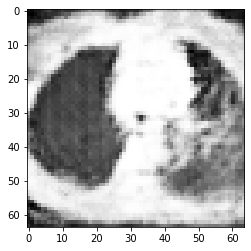

[78/300][0/6]
- D_loss : 1.3860 / G_loss : 0.6910
- D(x) : 0.5008 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5011 / d_acc : 0.5625
[78/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6919
- D(x) : 0.5008 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5006 / d_acc : 0.4844
[78/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6923
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5004 / d_acc : 0.5000
[78/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6924
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5004 / d_acc : 0.4609
[78/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6926
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5003 / d_acc : 0.4844
[78/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6938
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4997 / d_acc : 0.4453


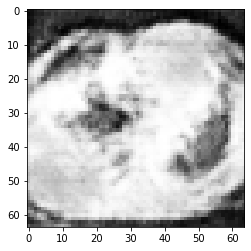

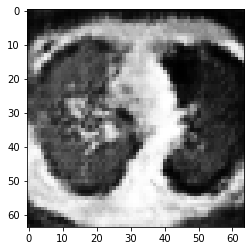

[79/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6937
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4997 / d_acc : 0.5078
[79/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6929
- D(x) : 0.4993 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5001 / d_acc : 0.5000
[79/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6924
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5004 / d_acc : 0.4922
[79/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6925
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5003 / d_acc : 0.4688
[79/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6934
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.4999 / d_acc : 0.5156
[79/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6943
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4994 / d_acc : 0.5000


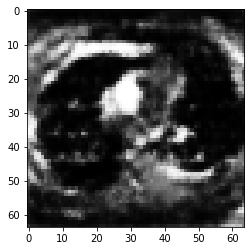

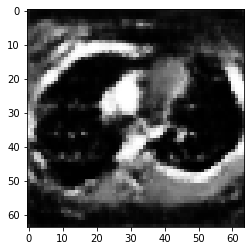

[80/300][0/6]
- D_loss : 1.3866 / G_loss : 0.6947
- D(x) : 0.4991 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4992 / d_acc : 0.4844
[80/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6936
- D(x) : 0.4989 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.4998 / d_acc : 0.5156
[80/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6916
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5008 / d_acc : 0.4531
[80/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6907
- D(x) : 0.5007 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5012 / d_acc : 0.4844
[80/300][4/6]
- D_loss : 1.3868 / G_loss : 0.6914
- D(x) : 0.5008 / D(G(z1)) : 0.5011 / D(G(z2)) : 0.5009 / d_acc : 0.4688
[80/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6930
- D(x) : 0.5005 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5001 / d_acc : 0.4688


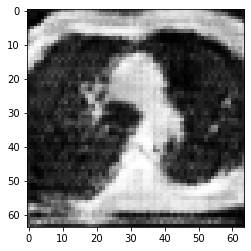

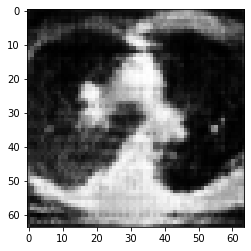

[81/300][0/6]
- D_loss : 1.3861 / G_loss : 0.6933
- D(x) : 0.5000 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4999 / d_acc : 0.5391
[81/300][1/6]
- D_loss : 1.3861 / G_loss : 0.6929
- D(x) : 0.4998 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5001 / d_acc : 0.5078
[81/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6926
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5003 / d_acc : 0.4844
[81/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6926
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5003 / d_acc : 0.5156
[81/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6929
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.5234
[81/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6933
- D(x) : 0.4997 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4999 / d_acc : 0.4375


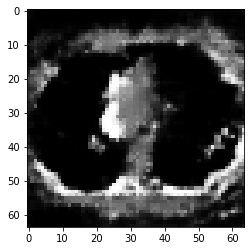

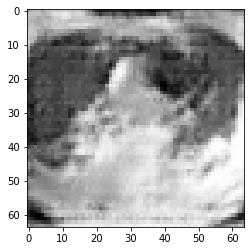

[82/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6928
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5002 / d_acc : 0.5234
[82/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6920
- D(x) : 0.4997 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5006 / d_acc : 0.4688
[82/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6916
- D(x) : 0.5004 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5008 / d_acc : 0.5000
[82/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6925
- D(x) : 0.5005 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5003 / d_acc : 0.5156
[82/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6944
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4994 / d_acc : 0.4453
[82/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6946
- D(x) : 0.4992 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4993 / d_acc : 0.5312


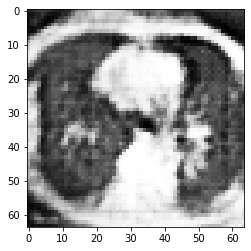

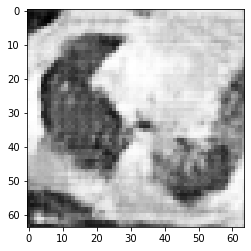

[83/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6934
- D(x) : 0.4989 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.4999 / d_acc : 0.4531
[83/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6921
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5005 / d_acc : 0.4922
[83/300][2/6]
- D_loss : 1.3862 / G_loss : 0.6913
- D(x) : 0.5004 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5009 / d_acc : 0.4766
[83/300][3/6]
- D_loss : 1.3861 / G_loss : 0.6905
- D(x) : 0.5007 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5013 / d_acc : 0.5625
[83/300][4/6]
- D_loss : 1.3870 / G_loss : 0.6913
- D(x) : 0.5009 / D(G(z1)) : 0.5012 / D(G(z2)) : 0.5009 / d_acc : 0.4375
[83/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6925
- D(x) : 0.5006 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5003 / d_acc : 0.3906


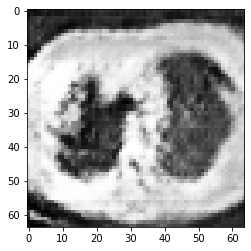

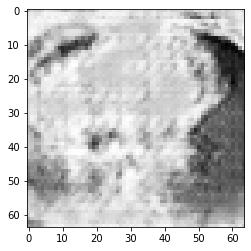

[84/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6931
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5000 / d_acc : 0.4531
[84/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6940
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4996 / d_acc : 0.5547
[84/300][2/6]
- D_loss : 1.3862 / G_loss : 0.6940
- D(x) : 0.4994 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4996 / d_acc : 0.5000
[84/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6935
- D(x) : 0.4993 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4998 / d_acc : 0.5078
[84/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6929
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5001 / d_acc : 0.4453
[84/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5004 / d_acc : 0.4922


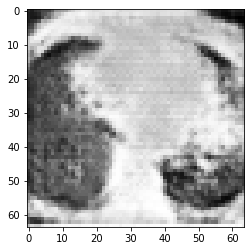

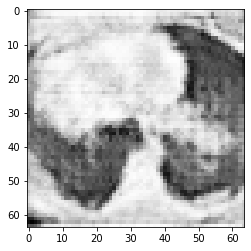

[85/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6921
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5005 / d_acc : 0.4844
[85/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6923
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5004 / d_acc : 0.4531
[85/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6928
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5002 / d_acc : 0.4219
[85/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6931
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.5156
[85/300][4/6]
- D_loss : 1.3861 / G_loss : 0.6932
- D(x) : 0.4999 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.4922
[85/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6929
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.5469


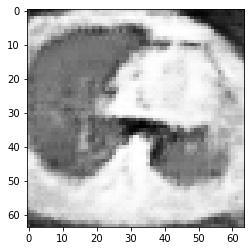

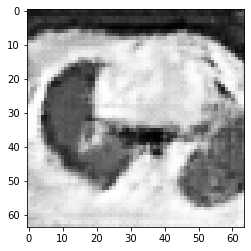

[86/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6925
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5003 / d_acc : 0.4297
[86/300][1/6]
- D_loss : 1.3862 / G_loss : 0.6918
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5007 / d_acc : 0.4609
[86/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6913
- D(x) : 0.5004 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5010 / d_acc : 0.4375
[86/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6921
- D(x) : 0.5006 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5005 / d_acc : 0.4922
[86/300][4/6]
- D_loss : 1.3862 / G_loss : 0.6928
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5002 / d_acc : 0.5156
[86/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6931
- D(x) : 0.5000 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.5234


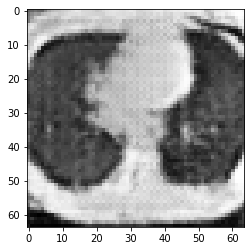

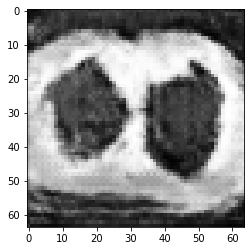

[87/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6936
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4998 / d_acc : 0.4766
[87/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6938
- D(x) : 0.4993 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4997 / d_acc : 0.4922
[87/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6926
- D(x) : 0.4992 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5003 / d_acc : 0.4688
[87/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6909
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5011 / d_acc : 0.4844
[87/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6908
- D(x) : 0.5009 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5012 / d_acc : 0.4219
[87/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6929
- D(x) : 0.5007 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5001 / d_acc : 0.3906


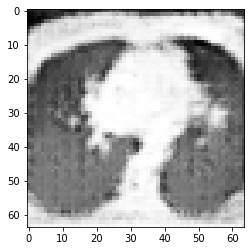

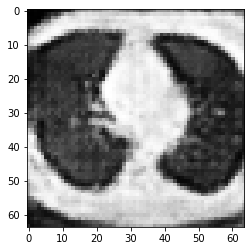

[88/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6940
- D(x) : 0.4999 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4996 / d_acc : 0.5078
[88/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6942
- D(x) : 0.4993 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4995 / d_acc : 0.5469
[88/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6936
- D(x) : 0.4991 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4998 / d_acc : 0.5078
[88/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6924
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5004 / d_acc : 0.5000
[88/300][4/6]
- D_loss : 1.3867 / G_loss : 0.6916
- D(x) : 0.4999 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5008 / d_acc : 0.4766
[88/300][5/6]
- D_loss : 1.3861 / G_loss : 0.6911
- D(x) : 0.5006 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5010 / d_acc : 0.5156


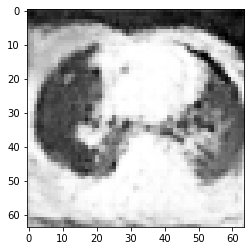

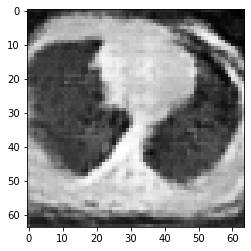

[89/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6916
- D(x) : 0.5008 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5008 / d_acc : 0.4844
[89/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6926
- D(x) : 0.5004 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5003 / d_acc : 0.4453
[89/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6927
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5002 / d_acc : 0.5156
[89/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6927
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5002 / d_acc : 0.4844
[89/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5004 / d_acc : 0.4688
[89/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6925
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5003 / d_acc : 0.4844


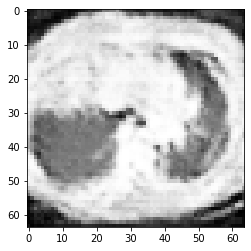

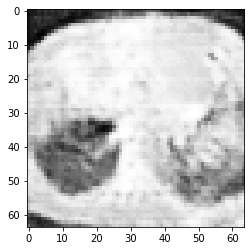

[90/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6930
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.5078
[90/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6933
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4999 / d_acc : 0.5078
[90/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6931
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.4844
[90/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6929
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.4922
[90/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6927
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5002 / d_acc : 0.4844
[90/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6921
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5005 / d_acc : 0.5078


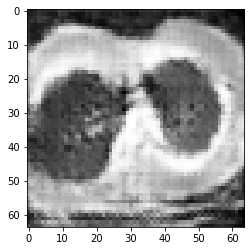

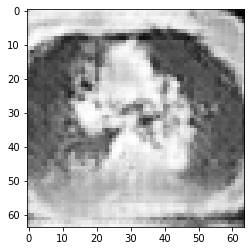

[91/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6924
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.4609
[91/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6925
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5003 / d_acc : 0.5156
[91/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6920
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5006 / d_acc : 0.4766
[91/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6927
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5002 / d_acc : 0.4609
[91/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6930
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4844
[91/300][5/6]
- D_loss : 1.3861 / G_loss : 0.6932
- D(x) : 0.4998 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.5078


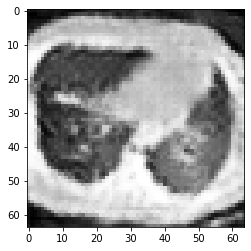

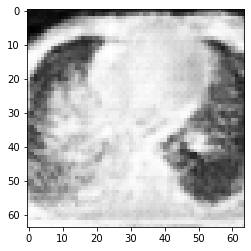

[92/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6927
- D(x) : 0.4997 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5002 / d_acc : 0.5078
[92/300][1/6]
- D_loss : 1.3868 / G_loss : 0.6923
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5004 / d_acc : 0.4688
[92/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6919
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5006 / d_acc : 0.5000
[92/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6922
- D(x) : 0.5003 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5005 / d_acc : 0.4688
[92/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6927
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4297
[92/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6930
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.5234


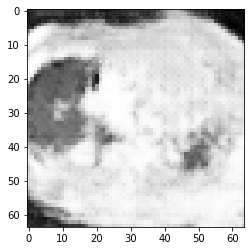

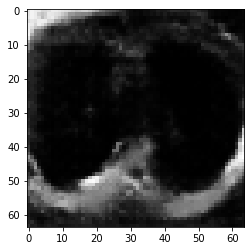

[93/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.5000
[93/300][1/6]
- D_loss : 1.3862 / G_loss : 0.6926
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5003 / d_acc : 0.4766
[93/300][2/6]
- D_loss : 1.3861 / G_loss : 0.6921
- D(x) : 0.5001 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5005 / d_acc : 0.4922
[93/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6931
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5000 / d_acc : 0.5312
[93/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6928
- D(x) : 0.4997 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5002 / d_acc : 0.4844
[93/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6926
- D(x) : 0.4999 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.5078


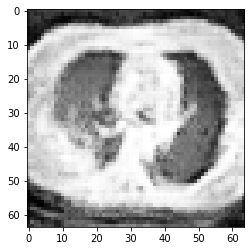

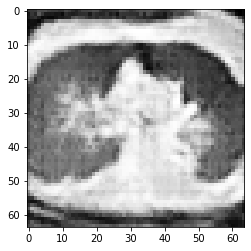

[94/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6920
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5006 / d_acc : 0.4375
[94/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6918
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5007 / d_acc : 0.4609
[94/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6924
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5004 / d_acc : 0.4688
[94/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5001 / d_acc : 0.4609
[94/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6930
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5001 / d_acc : 0.4766
[94/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6926
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.5156


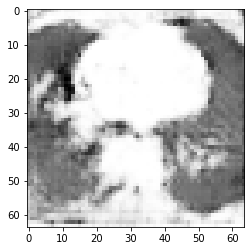

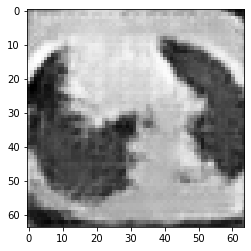

[95/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6919
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5006 / d_acc : 0.5234
[95/300][1/6]
- D_loss : 1.3861 / G_loss : 0.6919
- D(x) : 0.5003 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5006 / d_acc : 0.5234
[95/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6926
- D(x) : 0.5001 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5003 / d_acc : 0.4375
[95/300][3/6]
- D_loss : 1.3861 / G_loss : 0.6929
- D(x) : 0.5000 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5001 / d_acc : 0.4688
[95/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6929
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.4766
[95/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6929
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.4844


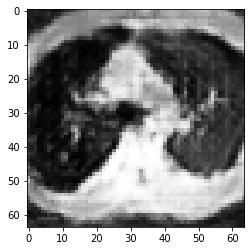

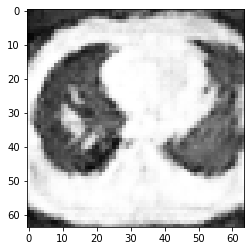

[96/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6922
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5005 / d_acc : 0.5156
[96/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6925
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5003 / d_acc : 0.4766
[96/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6932
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5000 / d_acc : 0.5078
[96/300][3/6]
- D_loss : 1.3872 / G_loss : 0.6931
- D(x) : 0.4993 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.4141
[96/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6927
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5002 / d_acc : 0.5000
[96/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6926
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5003 / d_acc : 0.4922


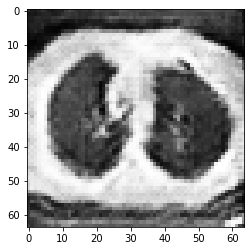

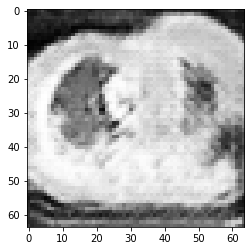

[97/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6930
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.5156
[97/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6932
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.4688
[97/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6931
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.5312
[97/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6919
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5006 / d_acc : 0.4609
[97/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6911
- D(x) : 0.5001 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5010 / d_acc : 0.4531
[97/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6917
- D(x) : 0.5007 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5007 / d_acc : 0.4844


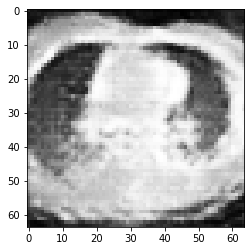

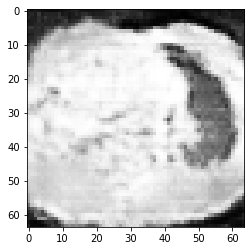

[98/300][0/6]
- D_loss : 1.3866 / G_loss : 0.6924
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5004 / d_acc : 0.4688
[98/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6930
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5001 / d_acc : 0.4766
[98/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6929
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5001 / d_acc : 0.5312
[98/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5004 / d_acc : 0.4531
[98/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6922
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5005 / d_acc : 0.4922
[98/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6916
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5008 / d_acc : 0.5156


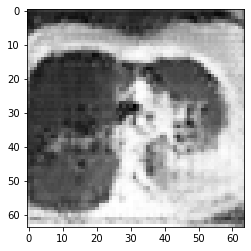

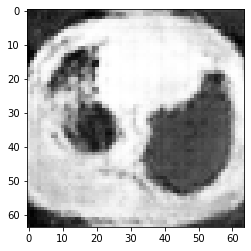

[99/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6921
- D(x) : 0.5005 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5005 / d_acc : 0.4922
[99/300][1/6]
- D_loss : 1.3862 / G_loss : 0.6923
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.5078
[99/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6920
- D(x) : 0.4998 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5006 / d_acc : 0.4375
[99/300][3/6]
- D_loss : 1.3870 / G_loss : 0.6917
- D(x) : 0.4999 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5007 / d_acc : 0.4531
[99/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6925
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5003 / d_acc : 0.5156
[99/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6935
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.4998 / d_acc : 0.4531


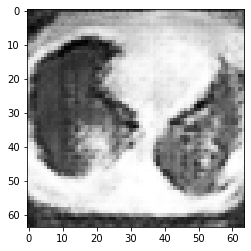

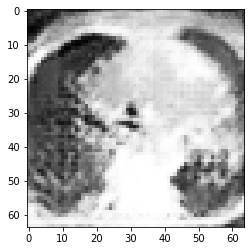

[100/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6937
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4997 / d_acc : 0.4844
[100/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6934
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4999 / d_acc : 0.5156
[100/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6937
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4997 / d_acc : 0.5078
[100/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6930
- D(x) : 0.4993 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5001 / d_acc : 0.4922
[100/300][4/6]
- D_loss : 1.3861 / G_loss : 0.6926
- D(x) : 0.4998 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5003 / d_acc : 0.5312
[100/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6924
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5003 / d_acc : 0.5078


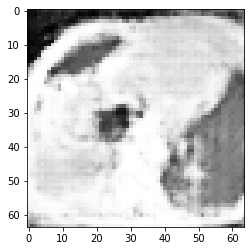

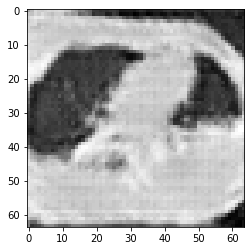

[101/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6920
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5006 / d_acc : 0.4688
[101/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6923
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5004 / d_acc : 0.4922
[101/300][2/6]
- D_loss : 1.3860 / G_loss : 0.6919
- D(x) : 0.5003 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5006 / d_acc : 0.4922
[101/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6921
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5005 / d_acc : 0.4453
[101/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6924
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5004 / d_acc : 0.4844
[101/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6929
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4844


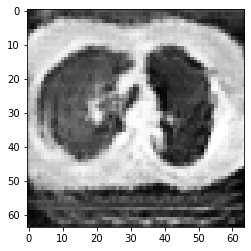

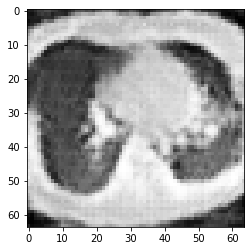

[102/300][0/6]
- D_loss : 1.3860 / G_loss : 0.6926
- D(x) : 0.4999 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5003 / d_acc : 0.4922
[102/300][1/6]
- D_loss : 1.3856 / G_loss : 0.6919
- D(x) : 0.5001 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5006 / d_acc : 0.5469
[102/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6916
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5008 / d_acc : 0.4141
[102/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6924
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.5156
[102/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5001 / d_acc : 0.4688
[102/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6931
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.4453


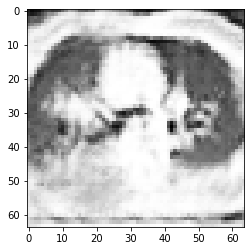

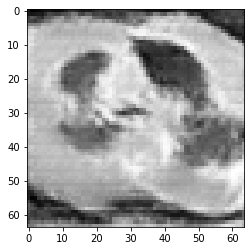

[103/300][0/6]
- D_loss : 1.3861 / G_loss : 0.6931
- D(x) : 0.4997 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5000 / d_acc : 0.5078
[103/300][1/6]
- D_loss : 1.3860 / G_loss : 0.6927
- D(x) : 0.4998 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5002 / d_acc : 0.5234
[103/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6914
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5009 / d_acc : 0.4609
[103/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6914
- D(x) : 0.5003 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5009 / d_acc : 0.4375
[103/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6930
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5001 / d_acc : 0.4531
[103/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6935
- D(x) : 0.4997 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4998 / d_acc : 0.4688


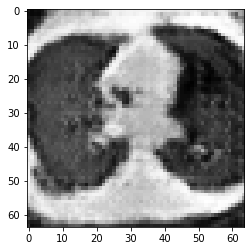

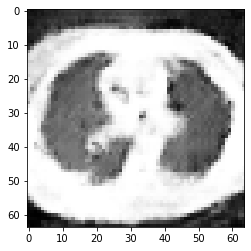

[104/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6928
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5002 / d_acc : 0.4609
[104/300][1/6]
- D_loss : 1.3870 / G_loss : 0.6914
- D(x) : 0.4993 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5009 / d_acc : 0.4688
[104/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6912
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5010 / d_acc : 0.4688
[104/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6924
- D(x) : 0.5005 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5004 / d_acc : 0.4609
[104/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6937
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4997 / d_acc : 0.4297
[104/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6932
- D(x) : 0.4993 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5000 / d_acc : 0.5391


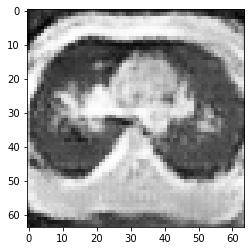

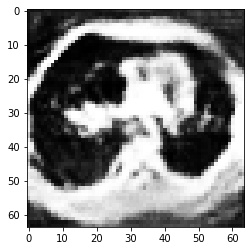

[105/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6922
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5005 / d_acc : 0.4844
[105/300][1/6]
- D_loss : 1.3862 / G_loss : 0.6917
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5007 / d_acc : 0.4922
[105/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6916
- D(x) : 0.5003 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5008 / d_acc : 0.4844
[105/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6926
- D(x) : 0.5004 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5003 / d_acc : 0.4844
[105/300][4/6]
- D_loss : 1.3861 / G_loss : 0.6924
- D(x) : 0.5000 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5004 / d_acc : 0.5000
[105/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6922
- D(x) : 0.5000 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5005 / d_acc : 0.5000


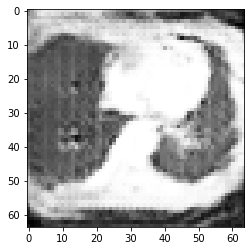

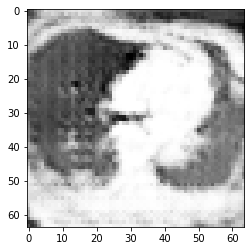

[106/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6926
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5003 / d_acc : 0.4297
[106/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6932
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5000 / d_acc : 0.4375
[106/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6925
- D(x) : 0.4997 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5003 / d_acc : 0.4688
[106/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6926
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5003 / d_acc : 0.4297
[106/300][4/6]
- D_loss : 1.3861 / G_loss : 0.6933
- D(x) : 0.5000 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4999 / d_acc : 0.5000
[106/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6935
- D(x) : 0.4996 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.4922


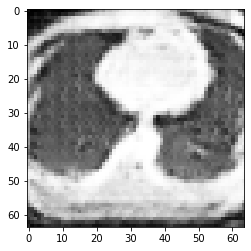

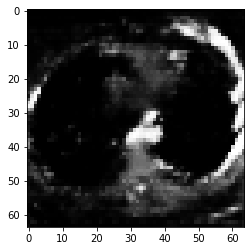

[107/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6920
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5006 / d_acc : 0.5000
[107/300][1/6]
- D_loss : 1.3868 / G_loss : 0.6913
- D(x) : 0.4999 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5009 / d_acc : 0.4844
[107/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6916
- D(x) : 0.5005 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5008 / d_acc : 0.4766
[107/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6924
- D(x) : 0.5004 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5004 / d_acc : 0.5000
[107/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6924
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5004 / d_acc : 0.5781
[107/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6917
- D(x) : 0.4996 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5007 / d_acc : 0.4453


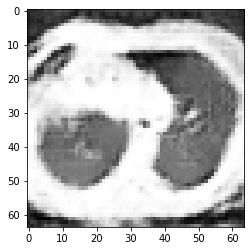

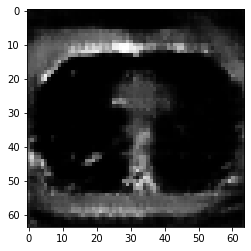

[108/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6904
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5014 / d_acc : 0.4844
[108/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6907
- D(x) : 0.5011 / D(G(z1)) : 0.5011 / D(G(z2)) : 0.5013 / d_acc : 0.5000
[108/300][2/6]
- D_loss : 1.3870 / G_loss : 0.6923
- D(x) : 0.5006 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5004 / d_acc : 0.4531
[108/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6938
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.4997 / d_acc : 0.4219
[108/300][4/6]
- D_loss : 1.3860 / G_loss : 0.6948
- D(x) : 0.4995 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4992 / d_acc : 0.5078
[108/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6949
- D(x) : 0.4987 / D(G(z1)) : 0.4988 / D(G(z2)) : 0.4991 / d_acc : 0.5312


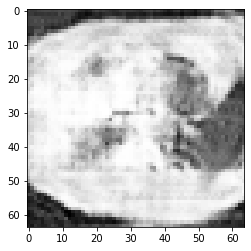

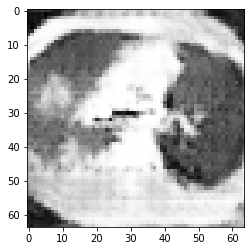

[109/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6937
- D(x) : 0.4988 / D(G(z1)) : 0.4988 / D(G(z2)) : 0.4997 / d_acc : 0.5234
[109/300][1/6]
- D_loss : 1.3859 / G_loss : 0.6923
- D(x) : 0.4995 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5004 / d_acc : 0.5391
[109/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6917
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5007 / d_acc : 0.4844
[109/300][3/6]
- D_loss : 1.3867 / G_loss : 0.6915
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5008 / d_acc : 0.4297
[109/300][4/6]
- D_loss : 1.3867 / G_loss : 0.6904
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5014 / d_acc : 0.4766
[109/300][5/6]
- D_loss : 1.3866 / G_loss : 0.6911
- D(x) : 0.5008 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5010 / d_acc : 0.4297


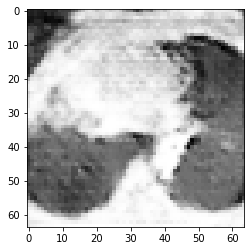

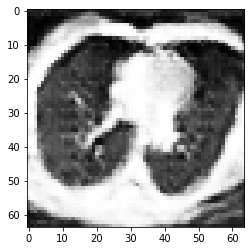

[110/300][0/6]
- D_loss : 1.3860 / G_loss : 0.6925
- D(x) : 0.5007 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5003 / d_acc : 0.5234
[110/300][1/6]
- D_loss : 1.3861 / G_loss : 0.6937
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4997 / d_acc : 0.4609
[110/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6930
- D(x) : 0.4992 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5001 / d_acc : 0.5312
[110/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6918
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5007 / d_acc : 0.5000
[110/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6916
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5008 / d_acc : 0.5156
[110/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.5156


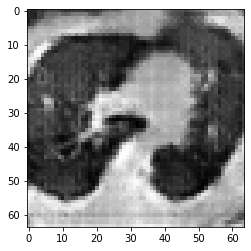

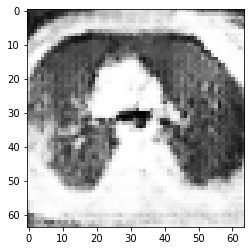

[111/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6922
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5005 / d_acc : 0.4688
[111/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6921
- D(x) : 0.4999 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5005 / d_acc : 0.4688
[111/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6919
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5006 / d_acc : 0.5000
[111/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6923
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5004 / d_acc : 0.4688
[111/300][4/6]
- D_loss : 1.3862 / G_loss : 0.6927
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5002 / d_acc : 0.5234
[111/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6923
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5004 / d_acc : 0.5234


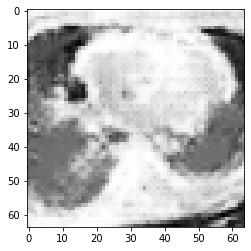

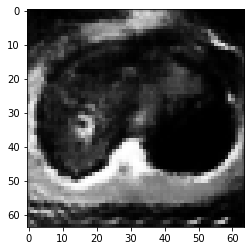

[112/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6916
- D(x) : 0.5000 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5008 / d_acc : 0.4453
[112/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6919
- D(x) : 0.5001 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5006 / d_acc : 0.4219
[112/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6924
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.5312
[112/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6929
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5001 / d_acc : 0.4844
[112/300][4/6]
- D_loss : 1.3861 / G_loss : 0.6925
- D(x) : 0.4998 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5003 / d_acc : 0.5000
[112/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6924
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5004 / d_acc : 0.4766


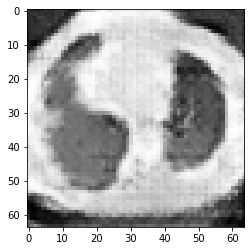

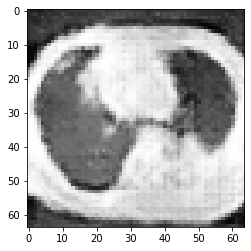

[113/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6929
- D(x) : 0.4996 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5001 / d_acc : 0.4844
[113/300][1/6]
- D_loss : 1.3866 / G_loss : 0.6916
- D(x) : 0.4995 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5008 / d_acc : 0.4844
[113/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6902
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5015 / d_acc : 0.4219
[113/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6916
- D(x) : 0.5009 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5008 / d_acc : 0.3984
[113/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6935
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.4998 / d_acc : 0.4844
[113/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6942
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4995 / d_acc : 0.4922


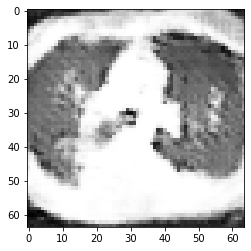

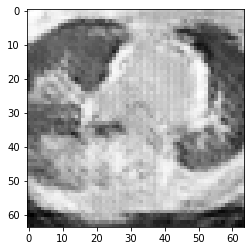

[114/300][0/6]
- D_loss : 1.3860 / G_loss : 0.6938
- D(x) : 0.4992 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.4997 / d_acc : 0.4766
[114/300][1/6]
- D_loss : 1.3861 / G_loss : 0.6929
- D(x) : 0.4993 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5001 / d_acc : 0.5312
[114/300][2/6]
- D_loss : 1.3862 / G_loss : 0.6915
- D(x) : 0.4997 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5008 / d_acc : 0.4531
[114/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6909
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5011 / d_acc : 0.5312
[114/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6907
- D(x) : 0.5005 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5012 / d_acc : 0.5078
[114/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6905
- D(x) : 0.5006 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5013 / d_acc : 0.4609


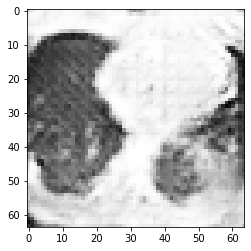

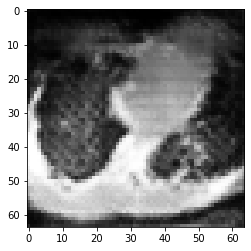

[115/300][0/6]
- D_loss : 1.3866 / G_loss : 0.6917
- D(x) : 0.5007 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5007 / d_acc : 0.4609
[115/300][1/6]
- D_loss : 1.3870 / G_loss : 0.6944
- D(x) : 0.4999 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.4994 / d_acc : 0.4375
[115/300][2/6]
- D_loss : 1.3859 / G_loss : 0.6936
- D(x) : 0.4992 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.4998 / d_acc : 0.5547
[115/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6933
- D(x) : 0.4992 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4999 / d_acc : 0.4766
[115/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6927
- D(x) : 0.4994 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5002 / d_acc : 0.4922
[115/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6908
- D(x) : 0.4998 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5012 / d_acc : 0.5078


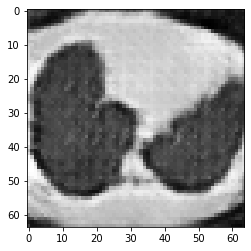

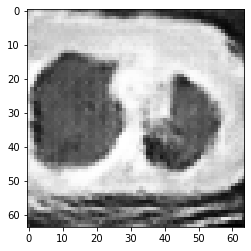

[116/300][0/6]
- D_loss : 1.3858 / G_loss : 0.6905
- D(x) : 0.5009 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5013 / d_acc : 0.5000
[116/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6914
- D(x) : 0.5008 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5009 / d_acc : 0.5625
[116/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6935
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.4998 / d_acc : 0.4531
[116/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6928
- D(x) : 0.4993 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5002 / d_acc : 0.5000
[116/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6923
- D(x) : 0.4997 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5004 / d_acc : 0.5156
[116/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6929
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5002 / d_acc : 0.5078


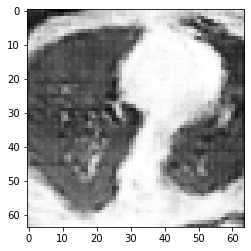

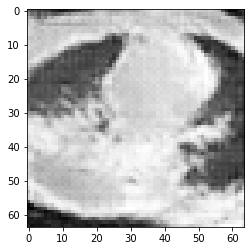

[117/300][0/6]
- D_loss : 1.3859 / G_loss : 0.6925
- D(x) : 0.4998 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5003 / d_acc : 0.5391
[117/300][1/6]
- D_loss : 1.3860 / G_loss : 0.6919
- D(x) : 0.4999 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5006 / d_acc : 0.5391
[117/300][2/6]
- D_loss : 1.3857 / G_loss : 0.6916
- D(x) : 0.5004 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5008 / d_acc : 0.5000
[117/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6928
- D(x) : 0.5003 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4922
[117/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.4995 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5004 / d_acc : 0.5000
[117/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6923
- D(x) : 0.4997 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5004 / d_acc : 0.5469


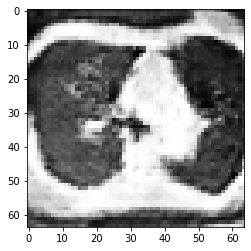

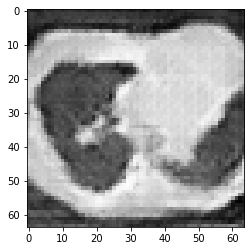

[118/300][0/6]
- D_loss : 1.3861 / G_loss : 0.6932
- D(x) : 0.4998 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5000 / d_acc : 0.4922
[118/300][1/6]
- D_loss : 1.3858 / G_loss : 0.6924
- D(x) : 0.4996 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5004 / d_acc : 0.5391
[118/300][2/6]
- D_loss : 1.3869 / G_loss : 0.6923
- D(x) : 0.4996 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5004 / d_acc : 0.4219
[118/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6919
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5007 / d_acc : 0.4688
[118/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6913
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5009 / d_acc : 0.4531
[118/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6899
- D(x) : 0.5001 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5017 / d_acc : 0.5156


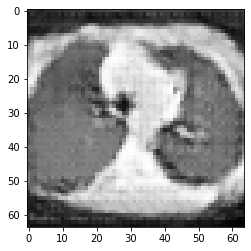

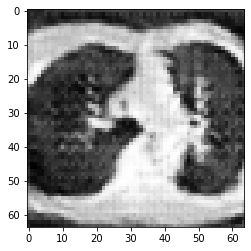

[119/300][0/6]
- D_loss : 1.3869 / G_loss : 0.6904
- D(x) : 0.5007 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5014 / d_acc : 0.4766
[119/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6929
- D(x) : 0.5008 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5001 / d_acc : 0.4844
[119/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6936
- D(x) : 0.4994 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.4375
[119/300][3/6]
- D_loss : 1.3872 / G_loss : 0.6928
- D(x) : 0.4990 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5002 / d_acc : 0.4844
[119/300][4/6]
- D_loss : 1.3873 / G_loss : 0.6917
- D(x) : 0.4991 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5008 / d_acc : 0.5234
[119/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6911
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5011 / d_acc : 0.5312


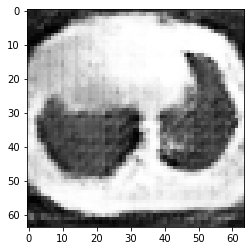

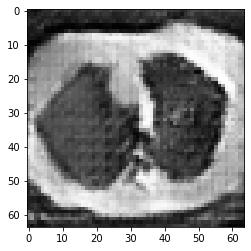

[120/300][0/6]
- D_loss : 1.3876 / G_loss : 0.6917
- D(x) : 0.5002 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5007 / d_acc : 0.5156
[120/300][1/6]
- D_loss : 1.3867 / G_loss : 0.6931
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5000 / d_acc : 0.5078
[120/300][2/6]
- D_loss : 1.3862 / G_loss : 0.6937
- D(x) : 0.4997 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.4997 / d_acc : 0.4766
[120/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6937
- D(x) : 0.4993 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.4997 / d_acc : 0.5312
[120/300][4/6]
- D_loss : 1.3867 / G_loss : 0.6931
- D(x) : 0.4991 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5000 / d_acc : 0.5469
[120/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6923
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5004 / d_acc : 0.5469


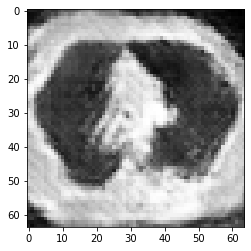

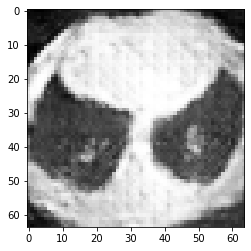

[121/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6909
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5011 / d_acc : 0.5234
[121/300][1/6]
- D_loss : 1.3859 / G_loss : 0.6912
- D(x) : 0.5009 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5010 / d_acc : 0.4844
[121/300][2/6]
- D_loss : 1.3862 / G_loss : 0.6924
- D(x) : 0.5004 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5004 / d_acc : 0.5312
[121/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6920
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5006 / d_acc : 0.4766
[121/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6911
- D(x) : 0.4998 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5010 / d_acc : 0.4531
[121/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6910
- D(x) : 0.5005 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5011 / d_acc : 0.4688


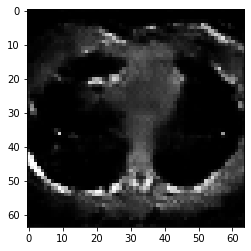

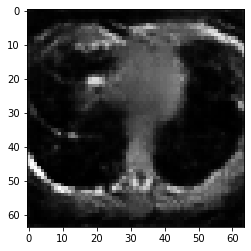

[122/300][0/6]
- D_loss : 1.3858 / G_loss : 0.6919
- D(x) : 0.5006 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5006 / d_acc : 0.5156
[122/300][1/6]
- D_loss : 1.3856 / G_loss : 0.6922
- D(x) : 0.5004 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5005 / d_acc : 0.5469
[122/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6920
- D(x) : 0.4999 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5006 / d_acc : 0.5078
[122/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6925
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5003 / d_acc : 0.4531
[122/300][4/6]
- D_loss : 1.3860 / G_loss : 0.6935
- D(x) : 0.4998 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.4998 / d_acc : 0.5000
[122/300][5/6]
- D_loss : 1.3861 / G_loss : 0.6927
- D(x) : 0.4991 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5002 / d_acc : 0.5078


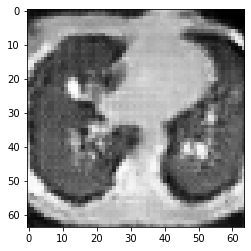

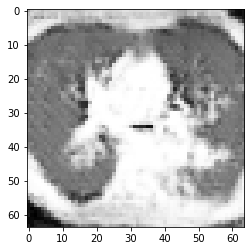

[123/300][0/6]
- D_loss : 1.3865 / G_loss : 0.6902
- D(x) : 0.4996 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5015 / d_acc : 0.5547
[123/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6911
- D(x) : 0.5008 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5010 / d_acc : 0.4922
[123/300][2/6]
- D_loss : 1.3859 / G_loss : 0.6921
- D(x) : 0.5005 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5005 / d_acc : 0.5469
[123/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6936
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4998 / d_acc : 0.5078
[123/300][4/6]
- D_loss : 1.3861 / G_loss : 0.6929
- D(x) : 0.4992 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5001 / d_acc : 0.5156
[123/300][5/6]
- D_loss : 1.3858 / G_loss : 0.6920
- D(x) : 0.4996 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5006 / d_acc : 0.5625


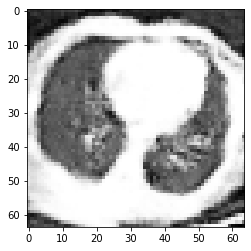

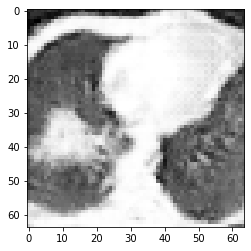

[124/300][0/6]
- D_loss : 1.3851 / G_loss : 0.6900
- D(x) : 0.5001 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5016 / d_acc : 0.5156
[124/300][1/6]
- D_loss : 1.3861 / G_loss : 0.6889
- D(x) : 0.5009 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5022 / d_acc : 0.5234
[124/300][2/6]
- D_loss : 1.3858 / G_loss : 0.6908
- D(x) : 0.5015 / D(G(z1)) : 0.5012 / D(G(z2)) : 0.5012 / d_acc : 0.4844
[124/300][3/6]
- D_loss : 1.3871 / G_loss : 0.6918
- D(x) : 0.4998 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5007 / d_acc : 0.5078
[124/300][4/6]
- D_loss : 1.3860 / G_loss : 0.6917
- D(x) : 0.5000 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5008 / d_acc : 0.4844
[124/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6913
- D(x) : 0.4996 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5009 / d_acc : 0.4453


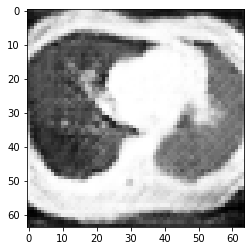

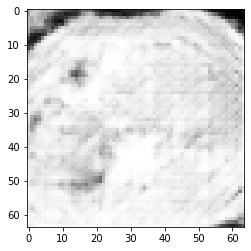

[125/300][0/6]
- D_loss : 1.3859 / G_loss : 0.6914
- D(x) : 0.5003 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5009 / d_acc : 0.4688
[125/300][1/6]
- D_loss : 1.3862 / G_loss : 0.6919
- D(x) : 0.5003 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5006 / d_acc : 0.4844
[125/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6932
- D(x) : 0.4998 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5000 / d_acc : 0.5000
[125/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6944
- D(x) : 0.4992 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4994 / d_acc : 0.4766
[125/300][4/6]
- D_loss : 1.3871 / G_loss : 0.6938
- D(x) : 0.4983 / D(G(z1)) : 0.4987 / D(G(z2)) : 0.4997 / d_acc : 0.4375
[125/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6915
- D(x) : 0.4991 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5008 / d_acc : 0.4609


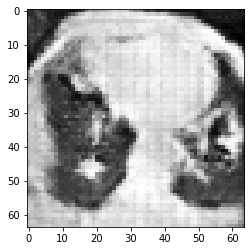

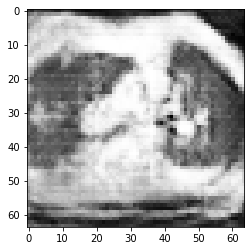

[126/300][0/6]
- D_loss : 1.3860 / G_loss : 0.6896
- D(x) : 0.5002 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5018 / d_acc : 0.5391
[126/300][1/6]
- D_loss : 1.3868 / G_loss : 0.6902
- D(x) : 0.5010 / D(G(z1)) : 0.5012 / D(G(z2)) : 0.5015 / d_acc : 0.4766
[126/300][2/6]
- D_loss : 1.3870 / G_loss : 0.6907
- D(x) : 0.5005 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5012 / d_acc : 0.4062
[126/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6908
- D(x) : 0.5006 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5012 / d_acc : 0.4609
[126/300][4/6]
- D_loss : 1.3865 / G_loss : 0.6940
- D(x) : 0.5003 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.4996 / d_acc : 0.4844
[126/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6936
- D(x) : 0.4990 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.4998 / d_acc : 0.5312


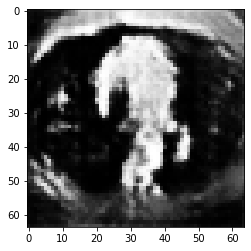

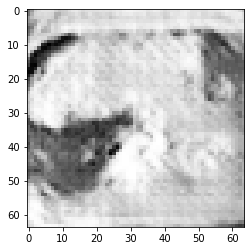

[127/300][0/6]
- D_loss : 1.3856 / G_loss : 0.6913
- D(x) : 0.4993 / D(G(z1)) : 0.4989 / D(G(z2)) : 0.5010 / d_acc : 0.4922
[127/300][1/6]
- D_loss : 1.3859 / G_loss : 0.6893
- D(x) : 0.5003 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5019 / d_acc : 0.5312
[127/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6909
- D(x) : 0.5008 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5011 / d_acc : 0.4609
[127/300][3/6]
- D_loss : 1.3864 / G_loss : 0.6924
- D(x) : 0.5003 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.4688
[127/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6925
- D(x) : 0.4993 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5003 / d_acc : 0.4688
[127/300][5/6]
- D_loss : 1.3865 / G_loss : 0.6926
- D(x) : 0.4995 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5003 / d_acc : 0.5234


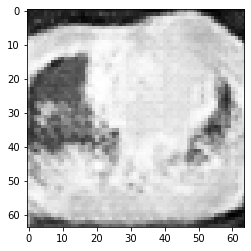

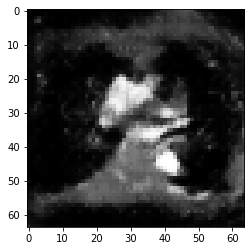

[128/300][0/6]
- D_loss : 1.3861 / G_loss : 0.6929
- D(x) : 0.4996 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5001 / d_acc : 0.5000
[128/300][1/6]
- D_loss : 1.3861 / G_loss : 0.6915
- D(x) : 0.4995 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5008 / d_acc : 0.5312
[128/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6917
- D(x) : 0.4998 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5007 / d_acc : 0.4922
[128/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6910
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5011 / d_acc : 0.4844
[128/300][4/6]
- D_loss : 1.3858 / G_loss : 0.6906
- D(x) : 0.5005 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5013 / d_acc : 0.5391
[128/300][5/6]
- D_loss : 1.3860 / G_loss : 0.6902
- D(x) : 0.5005 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5015 / d_acc : 0.4844


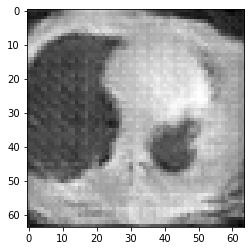

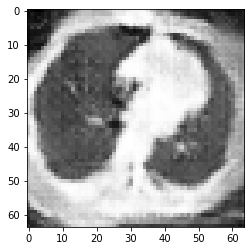

[129/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6919
- D(x) : 0.5006 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5006 / d_acc : 0.5234
[129/300][1/6]
- D_loss : 1.3861 / G_loss : 0.6909
- D(x) : 0.4999 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5011 / d_acc : 0.5234
[129/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6924
- D(x) : 0.5002 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5004 / d_acc : 0.5078
[129/300][3/6]
- D_loss : 1.3860 / G_loss : 0.6938
- D(x) : 0.4995 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.4997 / d_acc : 0.5156
[129/300][4/6]
- D_loss : 1.3864 / G_loss : 0.6940
- D(x) : 0.4990 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.4996 / d_acc : 0.5156
[129/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6930
- D(x) : 0.4987 / D(G(z1)) : 0.4987 / D(G(z2)) : 0.5001 / d_acc : 0.4453


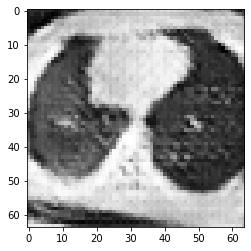

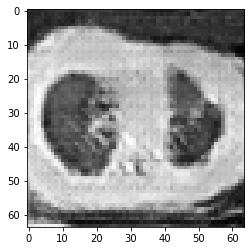

[130/300][0/6]
- D_loss : 1.3861 / G_loss : 0.6911
- D(x) : 0.4994 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5010 / d_acc : 0.5156
[130/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6902
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5015 / d_acc : 0.4609
[130/300][2/6]
- D_loss : 1.3867 / G_loss : 0.6905
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5013 / d_acc : 0.4609
[130/300][3/6]
- D_loss : 1.3860 / G_loss : 0.6909
- D(x) : 0.5006 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5011 / d_acc : 0.4922
[130/300][4/6]
- D_loss : 1.3858 / G_loss : 0.6907
- D(x) : 0.5005 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5012 / d_acc : 0.5391
[130/300][5/6]
- D_loss : 1.3855 / G_loss : 0.6907
- D(x) : 0.5006 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5012 / d_acc : 0.5234


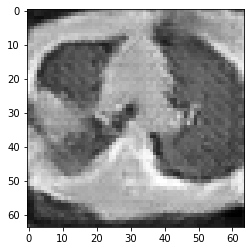

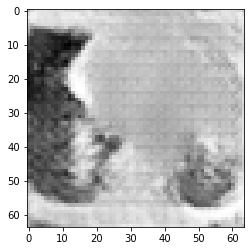

[131/300][0/6]
- D_loss : 1.3859 / G_loss : 0.6905
- D(x) : 0.5005 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5013 / d_acc : 0.4922
[131/300][1/6]
- D_loss : 1.3856 / G_loss : 0.6906
- D(x) : 0.5004 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5013 / d_acc : 0.5078
[131/300][2/6]
- D_loss : 1.3862 / G_loss : 0.6927
- D(x) : 0.5003 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5002 / d_acc : 0.4297
[131/300][3/6]
- D_loss : 1.3859 / G_loss : 0.6930
- D(x) : 0.4993 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5001 / d_acc : 0.5391
[131/300][4/6]
- D_loss : 1.3867 / G_loss : 0.6912
- D(x) : 0.4991 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5010 / d_acc : 0.5000
[131/300][5/6]
- D_loss : 1.3867 / G_loss : 0.6900
- D(x) : 0.5000 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5016 / d_acc : 0.4844


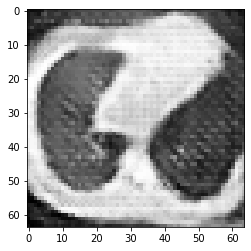

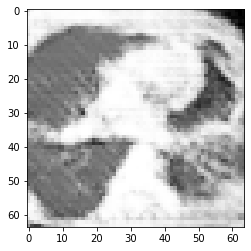

[132/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6914
- D(x) : 0.5008 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5009 / d_acc : 0.4609
[132/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6921
- D(x) : 0.5000 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5005 / d_acc : 0.4922
[132/300][2/6]
- D_loss : 1.3865 / G_loss : 0.6907
- D(x) : 0.4994 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5012 / d_acc : 0.4688
[132/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6902
- D(x) : 0.5001 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5015 / d_acc : 0.4766
[132/300][4/6]
- D_loss : 1.3863 / G_loss : 0.6918
- D(x) : 0.5004 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5007 / d_acc : 0.5312
[132/300][5/6]
- D_loss : 1.3871 / G_loss : 0.6953
- D(x) : 0.4995 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4989 / d_acc : 0.4766


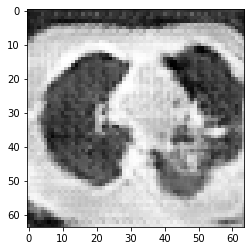

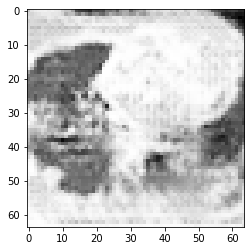

[133/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6948
- D(x) : 0.4982 / D(G(z1)) : 0.4982 / D(G(z2)) : 0.4992 / d_acc : 0.4844
[133/300][1/6]
- D_loss : 1.3858 / G_loss : 0.6912
- D(x) : 0.4984 / D(G(z1)) : 0.4981 / D(G(z2)) : 0.5010 / d_acc : 0.5859
[133/300][2/6]
- D_loss : 1.3856 / G_loss : 0.6892
- D(x) : 0.5005 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5020 / d_acc : 0.5547
[133/300][3/6]
- D_loss : 1.3869 / G_loss : 0.6879
- D(x) : 0.5006 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5026 / d_acc : 0.4609
[133/300][4/6]
- D_loss : 1.3870 / G_loss : 0.6872
- D(x) : 0.5014 / D(G(z1)) : 0.5017 / D(G(z2)) : 0.5030 / d_acc : 0.5078
[133/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6904
- D(x) : 0.5019 / D(G(z1)) : 0.5019 / D(G(z2)) : 0.5014 / d_acc : 0.5078


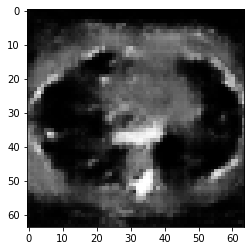

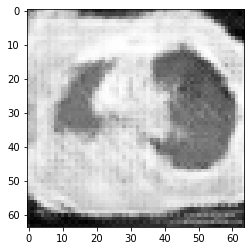

[134/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6907
- D(x) : 0.5002 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5012 / d_acc : 0.4688
[134/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6934
- D(x) : 0.5001 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.4999 / d_acc : 0.4688
[134/300][2/6]
- D_loss : 1.3859 / G_loss : 0.6937
- D(x) : 0.4988 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.4997 / d_acc : 0.4688
[134/300][3/6]
- D_loss : 1.3859 / G_loss : 0.6921
- D(x) : 0.4992 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5005 / d_acc : 0.4844
[134/300][4/6]
- D_loss : 1.3854 / G_loss : 0.6918
- D(x) : 0.4999 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5007 / d_acc : 0.6016
[134/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6892
- D(x) : 0.4995 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5020 / d_acc : 0.4844


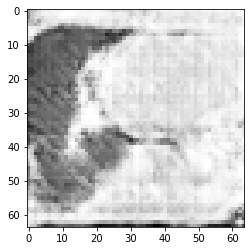

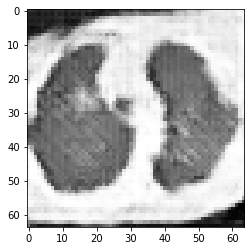

[135/300][0/6]
- D_loss : 1.3871 / G_loss : 0.6899
- D(x) : 0.5009 / D(G(z1)) : 0.5013 / D(G(z2)) : 0.5016 / d_acc : 0.5469
[135/300][1/6]
- D_loss : 1.3859 / G_loss : 0.6923
- D(x) : 0.5009 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5004 / d_acc : 0.4922
[135/300][2/6]
- D_loss : 1.3861 / G_loss : 0.6933
- D(x) : 0.4996 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.4999 / d_acc : 0.5391
[135/300][3/6]
- D_loss : 1.3865 / G_loss : 0.6935
- D(x) : 0.4987 / D(G(z1)) : 0.4988 / D(G(z2)) : 0.4998 / d_acc : 0.5234
[135/300][4/6]
- D_loss : 1.3868 / G_loss : 0.6924
- D(x) : 0.4985 / D(G(z1)) : 0.4987 / D(G(z2)) : 0.5004 / d_acc : 0.4766
[135/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6924
- D(x) : 0.4991 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5004 / d_acc : 0.4766


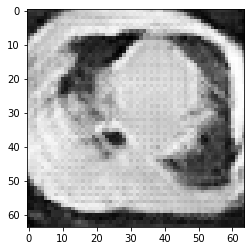

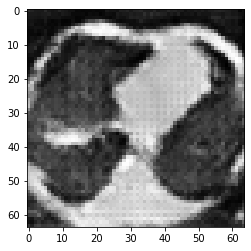

[136/300][0/6]
- D_loss : 1.3849 / G_loss : 0.6896
- D(x) : 0.5000 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5018 / d_acc : 0.5859
[136/300][1/6]
- D_loss : 1.3860 / G_loss : 0.6883
- D(x) : 0.5009 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5024 / d_acc : 0.4844
[136/300][2/6]
- D_loss : 1.3862 / G_loss : 0.6900
- D(x) : 0.5010 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5016 / d_acc : 0.5312
[136/300][3/6]
- D_loss : 1.3857 / G_loss : 0.6921
- D(x) : 0.5005 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5005 / d_acc : 0.4922
[136/300][4/6]
- D_loss : 1.3850 / G_loss : 0.6900
- D(x) : 0.4999 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5016 / d_acc : 0.5625
[136/300][5/6]
- D_loss : 1.3860 / G_loss : 0.6879
- D(x) : 0.5004 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5026 / d_acc : 0.4844


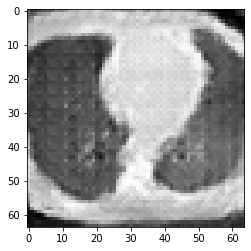

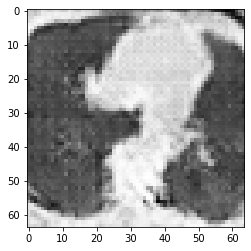

[137/300][0/6]
- D_loss : 1.3857 / G_loss : 0.6929
- D(x) : 0.5014 / D(G(z1)) : 0.5011 / D(G(z2)) : 0.5001 / d_acc : 0.5547
[137/300][1/6]
- D_loss : 1.3871 / G_loss : 0.6919
- D(x) : 0.4982 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.5006 / d_acc : 0.5000
[137/300][2/6]
- D_loss : 1.3856 / G_loss : 0.6889
- D(x) : 0.4995 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5021 / d_acc : 0.5312
[137/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6888
- D(x) : 0.5008 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5022 / d_acc : 0.5078
[137/300][4/6]
- D_loss : 1.3867 / G_loss : 0.6882
- D(x) : 0.5004 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.5025 / d_acc : 0.4219
[137/300][5/6]
- D_loss : 1.3871 / G_loss : 0.6940
- D(x) : 0.5008 / D(G(z1)) : 0.5012 / D(G(z2)) : 0.4996 / d_acc : 0.4531


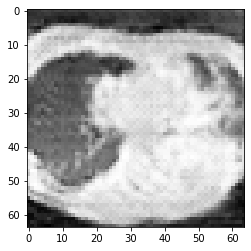

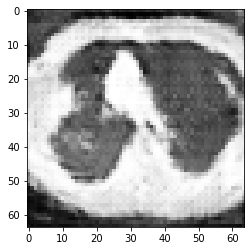

[138/300][0/6]
- D_loss : 1.3851 / G_loss : 0.6926
- D(x) : 0.4991 / D(G(z1)) : 0.4985 / D(G(z2)) : 0.5003 / d_acc : 0.5469
[138/300][1/6]
- D_loss : 1.3855 / G_loss : 0.6917
- D(x) : 0.4994 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5007 / d_acc : 0.5000
[138/300][2/6]
- D_loss : 1.3861 / G_loss : 0.6921
- D(x) : 0.4997 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5005 / d_acc : 0.5391
[138/300][3/6]
- D_loss : 1.3858 / G_loss : 0.6906
- D(x) : 0.4997 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5013 / d_acc : 0.5234
[138/300][4/6]
- D_loss : 1.3876 / G_loss : 0.6884
- D(x) : 0.4993 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5024 / d_acc : 0.4922
[138/300][5/6]
- D_loss : 1.3877 / G_loss : 0.6916
- D(x) : 0.5004 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5008 / d_acc : 0.4531


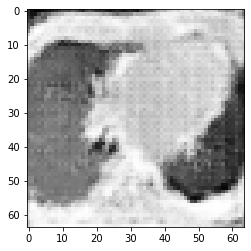

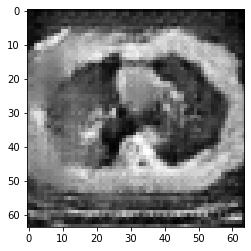

[139/300][0/6]
- D_loss : 1.3861 / G_loss : 0.6915
- D(x) : 0.4996 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5008 / d_acc : 0.5000
[139/300][1/6]
- D_loss : 1.3854 / G_loss : 0.6913
- D(x) : 0.4999 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5010 / d_acc : 0.5156
[139/300][2/6]
- D_loss : 1.3859 / G_loss : 0.6927
- D(x) : 0.4999 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5003 / d_acc : 0.5625
[139/300][3/6]
- D_loss : 1.3870 / G_loss : 0.6926
- D(x) : 0.4989 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5003 / d_acc : 0.4453
[139/300][4/6]
- D_loss : 1.3866 / G_loss : 0.6921
- D(x) : 0.4988 / D(G(z1)) : 0.4989 / D(G(z2)) : 0.5005 / d_acc : 0.5156
[139/300][5/6]
- D_loss : 1.3859 / G_loss : 0.6908
- D(x) : 0.4992 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5012 / d_acc : 0.5625


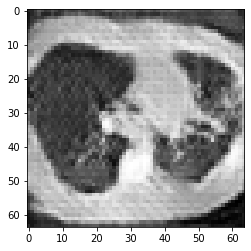

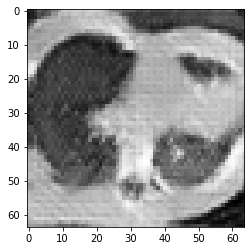

[140/300][0/6]
- D_loss : 1.3868 / G_loss : 0.6884
- D(x) : 0.4997 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5024 / d_acc : 0.4688
[140/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6871
- D(x) : 0.5009 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5031 / d_acc : 0.5078
[140/300][2/6]
- D_loss : 1.3859 / G_loss : 0.6867
- D(x) : 0.5015 / D(G(z1)) : 0.5012 / D(G(z2)) : 0.5032 / d_acc : 0.4609
[140/300][3/6]
- D_loss : 1.3863 / G_loss : 0.6915
- D(x) : 0.5020 / D(G(z1)) : 0.5020 / D(G(z2)) : 0.5008 / d_acc : 0.4609
[140/300][4/6]
- D_loss : 1.3855 / G_loss : 0.6945
- D(x) : 0.4997 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.4993 / d_acc : 0.5391
[140/300][5/6]
- D_loss : 1.3851 / G_loss : 0.6902
- D(x) : 0.4984 / D(G(z1)) : 0.4978 / D(G(z2)) : 0.5015 / d_acc : 0.5234


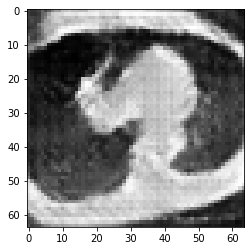

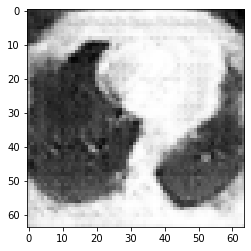

[141/300][0/6]
- D_loss : 1.3867 / G_loss : 0.6857
- D(x) : 0.4997 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5038 / d_acc : 0.4609
[141/300][1/6]
- D_loss : 1.3876 / G_loss : 0.6882
- D(x) : 0.5020 / D(G(z1)) : 0.5026 / D(G(z2)) : 0.5025 / d_acc : 0.4844
[141/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6951
- D(x) : 0.5011 / D(G(z1)) : 0.5011 / D(G(z2)) : 0.4990 / d_acc : 0.5391
[141/300][3/6]
- D_loss : 1.3856 / G_loss : 0.6953
- D(x) : 0.4976 / D(G(z1)) : 0.4972 / D(G(z2)) : 0.4989 / d_acc : 0.5234
[141/300][4/6]
- D_loss : 1.3862 / G_loss : 0.6916
- D(x) : 0.4974 / D(G(z1)) : 0.4973 / D(G(z2)) : 0.5008 / d_acc : 0.5156
[141/300][5/6]
- D_loss : 1.3868 / G_loss : 0.6887
- D(x) : 0.4990 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5023 / d_acc : 0.4766


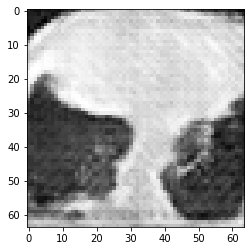

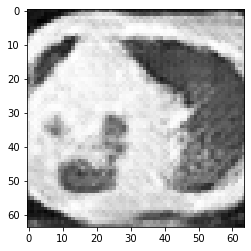

[142/300][0/6]
- D_loss : 1.3839 / G_loss : 0.6847
- D(x) : 0.5014 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5042 / d_acc : 0.5625
[142/300][1/6]
- D_loss : 1.3865 / G_loss : 0.6881
- D(x) : 0.5027 / D(G(z1)) : 0.5028 / D(G(z2)) : 0.5025 / d_acc : 0.4531
[142/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6936
- D(x) : 0.5013 / D(G(z1)) : 0.5013 / D(G(z2)) : 0.4998 / d_acc : 0.4688
[142/300][3/6]
- D_loss : 1.3858 / G_loss : 0.6915
- D(x) : 0.4987 / D(G(z1)) : 0.4984 / D(G(z2)) : 0.5009 / d_acc : 0.5469
[142/300][4/6]
- D_loss : 1.3848 / G_loss : 0.6909
- D(x) : 0.4998 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5012 / d_acc : 0.5234
[142/300][5/6]
- D_loss : 1.3870 / G_loss : 0.6947
- D(x) : 0.4995 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.4992 / d_acc : 0.4844


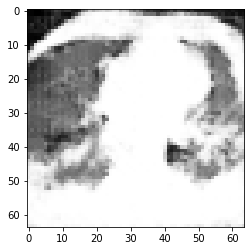

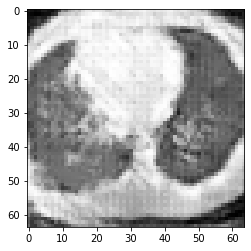

[143/300][0/6]
- D_loss : 1.3854 / G_loss : 0.6915
- D(x) : 0.4980 / D(G(z1)) : 0.4975 / D(G(z2)) : 0.5008 / d_acc : 0.4922
[143/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6877
- D(x) : 0.4991 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5028 / d_acc : 0.4688
[143/300][2/6]
- D_loss : 1.3860 / G_loss : 0.6863
- D(x) : 0.5009 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5034 / d_acc : 0.4609
[143/300][3/6]
- D_loss : 1.3859 / G_loss : 0.6853
- D(x) : 0.5019 / D(G(z1)) : 0.5017 / D(G(z2)) : 0.5040 / d_acc : 0.5078
[143/300][4/6]
- D_loss : 1.3856 / G_loss : 0.6894
- D(x) : 0.5025 / D(G(z1)) : 0.5021 / D(G(z2)) : 0.5019 / d_acc : 0.5391
[143/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6963
- D(x) : 0.5007 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.4984 / d_acc : 0.4844


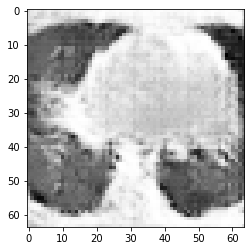

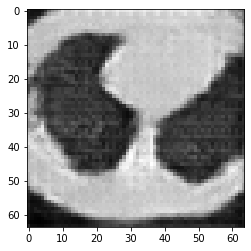

[144/300][0/6]
- D_loss : 1.3855 / G_loss : 0.6929
- D(x) : 0.4973 / D(G(z1)) : 0.4968 / D(G(z2)) : 0.5002 / d_acc : 0.5312
[144/300][1/6]
- D_loss : 1.3872 / G_loss : 0.6902
- D(x) : 0.4980 / D(G(z1)) : 0.4984 / D(G(z2)) : 0.5015 / d_acc : 0.4531
[144/300][2/6]
- D_loss : 1.3882 / G_loss : 0.6903
- D(x) : 0.4988 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5014 / d_acc : 0.4609
[144/300][3/6]
- D_loss : 1.3860 / G_loss : 0.6911
- D(x) : 0.4998 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5010 / d_acc : 0.4844
[144/300][4/6]
- D_loss : 1.3862 / G_loss : 0.6861
- D(x) : 0.4993 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5036 / d_acc : 0.4766
[144/300][5/6]
- D_loss : 1.3878 / G_loss : 0.6914
- D(x) : 0.5011 / D(G(z1)) : 0.5018 / D(G(z2)) : 0.5009 / d_acc : 0.4688


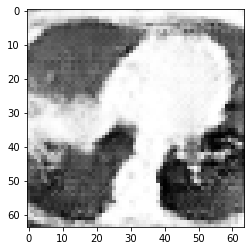

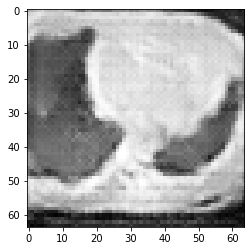

[145/300][0/6]
- D_loss : 1.3849 / G_loss : 0.6927
- D(x) : 0.5002 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5002 / d_acc : 0.5312
[145/300][1/6]
- D_loss : 1.3852 / G_loss : 0.6873
- D(x) : 0.4987 / D(G(z1)) : 0.4982 / D(G(z2)) : 0.5029 / d_acc : 0.5234
[145/300][2/6]
- D_loss : 1.3868 / G_loss : 0.6900
- D(x) : 0.5008 / D(G(z1)) : 0.5010 / D(G(z2)) : 0.5016 / d_acc : 0.4141
[145/300][3/6]
- D_loss : 1.3855 / G_loss : 0.6881
- D(x) : 0.5003 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5025 / d_acc : 0.5078
[145/300][4/6]
- D_loss : 1.3860 / G_loss : 0.6919
- D(x) : 0.5010 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5007 / d_acc : 0.5078
[145/300][5/6]
- D_loss : 1.3848 / G_loss : 0.6895
- D(x) : 0.4993 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.5018 / d_acc : 0.5078


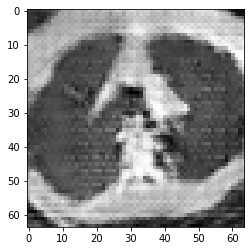

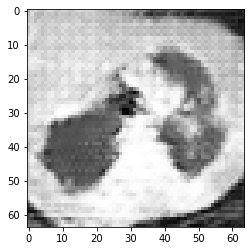

[146/300][0/6]
- D_loss : 1.3862 / G_loss : 0.6866
- D(x) : 0.4999 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5033 / d_acc : 0.4922
[146/300][1/6]
- D_loss : 1.3845 / G_loss : 0.6876
- D(x) : 0.5022 / D(G(z1)) : 0.5013 / D(G(z2)) : 0.5028 / d_acc : 0.5469
[146/300][2/6]
- D_loss : 1.3866 / G_loss : 0.6904
- D(x) : 0.5005 / D(G(z1)) : 0.5007 / D(G(z2)) : 0.5014 / d_acc : 0.4609
[146/300][3/6]
- D_loss : 1.3875 / G_loss : 0.6925
- D(x) : 0.4992 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5004 / d_acc : 0.5156
[146/300][4/6]
- D_loss : 1.3873 / G_loss : 0.6881
- D(x) : 0.4983 / D(G(z1)) : 0.4988 / D(G(z2)) : 0.5025 / d_acc : 0.5312
[146/300][5/6]
- D_loss : 1.3856 / G_loss : 0.6878
- D(x) : 0.5006 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5027 / d_acc : 0.5469


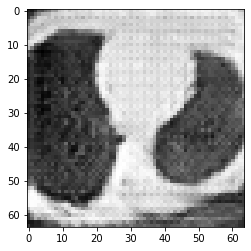

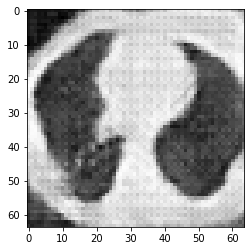

[147/300][0/6]
- D_loss : 1.3871 / G_loss : 0.6928
- D(x) : 0.5010 / D(G(z1)) : 0.5014 / D(G(z2)) : 0.5002 / d_acc : 0.4297
[147/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6921
- D(x) : 0.4985 / D(G(z1)) : 0.4985 / D(G(z2)) : 0.5005 / d_acc : 0.5391
[147/300][2/6]
- D_loss : 1.3879 / G_loss : 0.6872
- D(x) : 0.4979 / D(G(z1)) : 0.4987 / D(G(z2)) : 0.5030 / d_acc : 0.4922
[147/300][3/6]
- D_loss : 1.3846 / G_loss : 0.6882
- D(x) : 0.5016 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5025 / d_acc : 0.5156
[147/300][4/6]
- D_loss : 1.3851 / G_loss : 0.6901
- D(x) : 0.5009 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5015 / d_acc : 0.5312
[147/300][5/6]
- D_loss : 1.3845 / G_loss : 0.6918
- D(x) : 0.5003 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5007 / d_acc : 0.5469


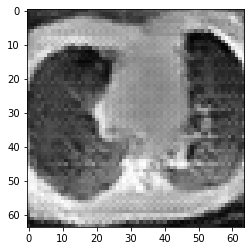

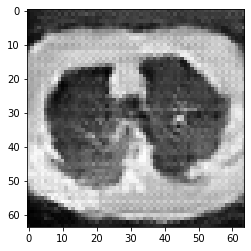

[148/300][0/6]
- D_loss : 1.3836 / G_loss : 0.6897
- D(x) : 0.4998 / D(G(z1)) : 0.4984 / D(G(z2)) : 0.5018 / d_acc : 0.5781
[148/300][1/6]
- D_loss : 1.3857 / G_loss : 0.6882
- D(x) : 0.4999 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5025 / d_acc : 0.5234
[148/300][2/6]
- D_loss : 1.3858 / G_loss : 0.6888
- D(x) : 0.4998 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5022 / d_acc : 0.5312
[148/300][3/6]
- D_loss : 1.3860 / G_loss : 0.6887
- D(x) : 0.5000 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5023 / d_acc : 0.4922
[148/300][4/6]
- D_loss : 1.3837 / G_loss : 0.6907
- D(x) : 0.5012 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5012 / d_acc : 0.6094
[148/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6853
- D(x) : 0.4990 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5040 / d_acc : 0.5000


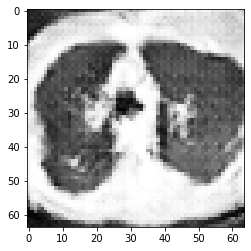

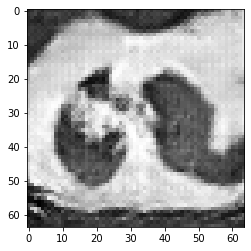

[149/300][0/6]
- D_loss : 1.3840 / G_loss : 0.6871
- D(x) : 0.5024 / D(G(z1)) : 0.5011 / D(G(z2)) : 0.5031 / d_acc : 0.5625
[149/300][1/6]
- D_loss : 1.3844 / G_loss : 0.6875
- D(x) : 0.5013 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5028 / d_acc : 0.5312
[149/300][2/6]
- D_loss : 1.3853 / G_loss : 0.6916
- D(x) : 0.5009 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5008 / d_acc : 0.5156
[149/300][3/6]
- D_loss : 1.3859 / G_loss : 0.6908
- D(x) : 0.4985 / D(G(z1)) : 0.4983 / D(G(z2)) : 0.5012 / d_acc : 0.4844
[149/300][4/6]
- D_loss : 1.3834 / G_loss : 0.6914
- D(x) : 0.4996 / D(G(z1)) : 0.4981 / D(G(z2)) : 0.5009 / d_acc : 0.5312
[149/300][5/6]
- D_loss : 1.3860 / G_loss : 0.6880
- D(x) : 0.4985 / D(G(z1)) : 0.4984 / D(G(z2)) : 0.5026 / d_acc : 0.5469


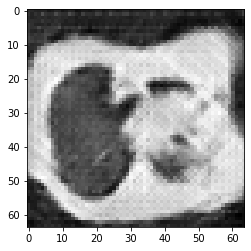

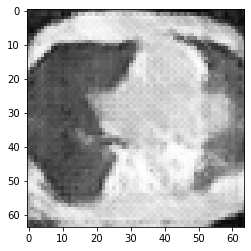

[150/300][0/6]
- D_loss : 1.3876 / G_loss : 0.6902
- D(x) : 0.4989 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5016 / d_acc : 0.5078
[150/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6881
- D(x) : 0.4995 / D(G(z1)) : 0.4994 / D(G(z2)) : 0.5026 / d_acc : 0.4688
[150/300][2/6]
- D_loss : 1.3912 / G_loss : 0.6953
- D(x) : 0.4982 / D(G(z1)) : 0.5006 / D(G(z2)) : 0.4989 / d_acc : 0.4688
[150/300][3/6]
- D_loss : 1.3866 / G_loss : 0.6898
- D(x) : 0.4968 / D(G(z1)) : 0.4969 / D(G(z2)) : 0.5017 / d_acc : 0.5234
[150/300][4/6]
- D_loss : 1.3888 / G_loss : 0.6827
- D(x) : 0.4981 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5053 / d_acc : 0.4766
[150/300][5/6]
- D_loss : 1.3848 / G_loss : 0.6857
- D(x) : 0.5034 / D(G(z1)) : 0.5027 / D(G(z2)) : 0.5037 / d_acc : 0.4844


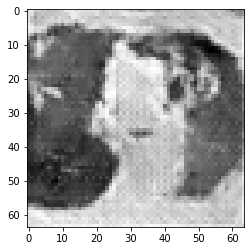

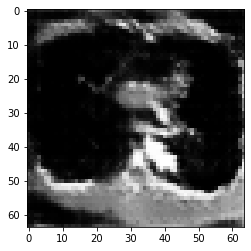

[151/300][0/6]
- D_loss : 1.3864 / G_loss : 0.6876
- D(x) : 0.5019 / D(G(z1)) : 0.5019 / D(G(z2)) : 0.5028 / d_acc : 0.5312
[151/300][1/6]
- D_loss : 1.3858 / G_loss : 0.6888
- D(x) : 0.5008 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5022 / d_acc : 0.5000
[151/300][2/6]
- D_loss : 1.3860 / G_loss : 0.6927
- D(x) : 0.5001 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.5003 / d_acc : 0.4844
[151/300][3/6]
- D_loss : 1.3861 / G_loss : 0.6938
- D(x) : 0.4982 / D(G(z1)) : 0.4981 / D(G(z2)) : 0.4997 / d_acc : 0.5234
[151/300][4/6]
- D_loss : 1.3844 / G_loss : 0.6879
- D(x) : 0.4982 / D(G(z1)) : 0.4972 / D(G(z2)) : 0.5027 / d_acc : 0.5391
[151/300][5/6]
- D_loss : 1.3862 / G_loss : 0.6851
- D(x) : 0.5004 / D(G(z1)) : 0.5004 / D(G(z2)) : 0.5041 / d_acc : 0.5000


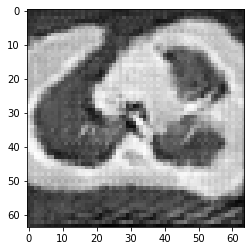

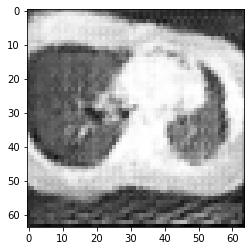

[152/300][0/6]
- D_loss : 1.3853 / G_loss : 0.6839
- D(x) : 0.5014 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5047 / d_acc : 0.5547
[152/300][1/6]
- D_loss : 1.3860 / G_loss : 0.6852
- D(x) : 0.5023 / D(G(z1)) : 0.5021 / D(G(z2)) : 0.5040 / d_acc : 0.4766
[152/300][2/6]
- D_loss : 1.3880 / G_loss : 0.6933
- D(x) : 0.5004 / D(G(z1)) : 0.5012 / D(G(z2)) : 0.4999 / d_acc : 0.4609
[152/300][3/6]
- D_loss : 1.3850 / G_loss : 0.6896
- D(x) : 0.4978 / D(G(z1)) : 0.4971 / D(G(z2)) : 0.5018 / d_acc : 0.5312
[152/300][4/6]
- D_loss : 1.3841 / G_loss : 0.6856
- D(x) : 0.4996 / D(G(z1)) : 0.4985 / D(G(z2)) : 0.5038 / d_acc : 0.5234
[152/300][5/6]
- D_loss : 1.3849 / G_loss : 0.6872
- D(x) : 0.5013 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5030 / d_acc : 0.5547


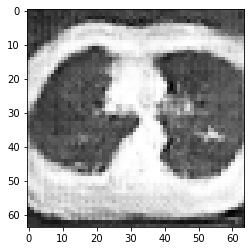

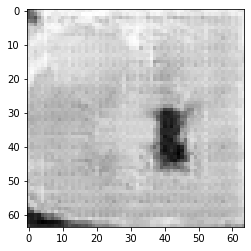

[153/300][0/6]
- D_loss : 1.3848 / G_loss : 0.6919
- D(x) : 0.5010 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5007 / d_acc : 0.5156
[153/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6905
- D(x) : 0.4981 / D(G(z1)) : 0.4981 / D(G(z2)) : 0.5014 / d_acc : 0.5234
[153/300][2/6]
- D_loss : 1.3882 / G_loss : 0.6850
- D(x) : 0.4971 / D(G(z1)) : 0.4980 / D(G(z2)) : 0.5041 / d_acc : 0.4688
[153/300][3/6]
- D_loss : 1.3860 / G_loss : 0.6812
- D(x) : 0.5011 / D(G(z1)) : 0.5009 / D(G(z2)) : 0.5060 / d_acc : 0.4922
[153/300][4/6]
- D_loss : 1.3843 / G_loss : 0.6881
- D(x) : 0.5044 / D(G(z1)) : 0.5033 / D(G(z2)) : 0.5025 / d_acc : 0.4922
[153/300][5/6]
- D_loss : 1.3863 / G_loss : 0.6900
- D(x) : 0.4992 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5016 / d_acc : 0.5000


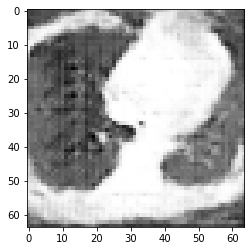

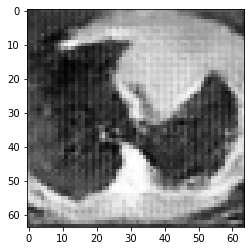

[154/300][0/6]
- D_loss : 1.3835 / G_loss : 0.6883
- D(x) : 0.4997 / D(G(z1)) : 0.4983 / D(G(z2)) : 0.5025 / d_acc : 0.5391
[154/300][1/6]
- D_loss : 1.3860 / G_loss : 0.6861
- D(x) : 0.4986 / D(G(z1)) : 0.4983 / D(G(z2)) : 0.5036 / d_acc : 0.5078
[154/300][2/6]
- D_loss : 1.3872 / G_loss : 0.6880
- D(x) : 0.4998 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5026 / d_acc : 0.4766
[154/300][3/6]
- D_loss : 1.3852 / G_loss : 0.6917
- D(x) : 0.5008 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5008 / d_acc : 0.4922
[154/300][4/6]
- D_loss : 1.3856 / G_loss : 0.6953
- D(x) : 0.4987 / D(G(z1)) : 0.4983 / D(G(z2)) : 0.4989 / d_acc : 0.5000
[154/300][5/6]
- D_loss : 1.3842 / G_loss : 0.6847
- D(x) : 0.4975 / D(G(z1)) : 0.4963 / D(G(z2)) : 0.5043 / d_acc : 0.5703


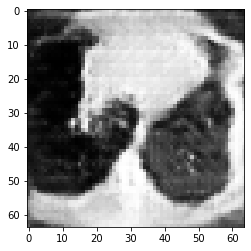

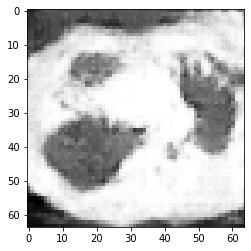

[155/300][0/6]
- D_loss : 1.3840 / G_loss : 0.6777
- D(x) : 0.5016 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5078 / d_acc : 0.5234
[155/300][1/6]
- D_loss : 1.3893 / G_loss : 0.6874
- D(x) : 0.5045 / D(G(z1)) : 0.5059 / D(G(z2)) : 0.5029 / d_acc : 0.4297
[155/300][2/6]
- D_loss : 1.3864 / G_loss : 0.6941
- D(x) : 0.5002 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.4996 / d_acc : 0.5000
[155/300][3/6]
- D_loss : 1.3862 / G_loss : 0.6896
- D(x) : 0.4969 / D(G(z1)) : 0.4968 / D(G(z2)) : 0.5018 / d_acc : 0.5312
[155/300][4/6]
- D_loss : 1.3842 / G_loss : 0.6894
- D(x) : 0.4993 / D(G(z1)) : 0.4982 / D(G(z2)) : 0.5019 / d_acc : 0.5000
[155/300][5/6]
- D_loss : 1.3842 / G_loss : 0.6842
- D(x) : 0.4992 / D(G(z1)) : 0.4980 / D(G(z2)) : 0.5046 / d_acc : 0.5312


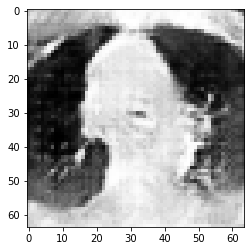

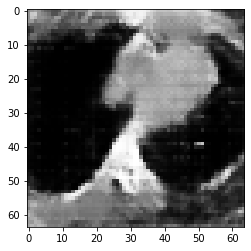

[156/300][0/6]
- D_loss : 1.3863 / G_loss : 0.6898
- D(x) : 0.5015 / D(G(z1)) : 0.5014 / D(G(z2)) : 0.5017 / d_acc : 0.4531
[156/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6870
- D(x) : 0.4993 / D(G(z1)) : 0.4992 / D(G(z2)) : 0.5031 / d_acc : 0.4531
[156/300][2/6]
- D_loss : 1.3833 / G_loss : 0.6892
- D(x) : 0.5011 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5020 / d_acc : 0.5781
[156/300][3/6]
- D_loss : 1.3855 / G_loss : 0.6860
- D(x) : 0.4988 / D(G(z1)) : 0.4984 / D(G(z2)) : 0.5036 / d_acc : 0.4688
[156/300][4/6]
- D_loss : 1.3857 / G_loss : 0.6810
- D(x) : 0.4989 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.5061 / d_acc : 0.5000
[156/300][5/6]
- D_loss : 1.3837 / G_loss : 0.6874
- D(x) : 0.5033 / D(G(z1)) : 0.5019 / D(G(z2)) : 0.5029 / d_acc : 0.5469


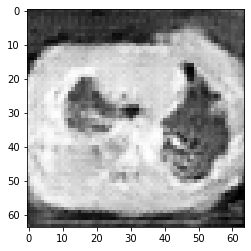

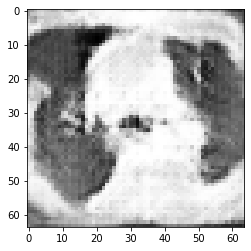

[157/300][0/6]
- D_loss : 1.3854 / G_loss : 0.6877
- D(x) : 0.4996 / D(G(z1)) : 0.4991 / D(G(z2)) : 0.5028 / d_acc : 0.4922
[157/300][1/6]
- D_loss : 1.3846 / G_loss : 0.6846
- D(x) : 0.4995 / D(G(z1)) : 0.4986 / D(G(z2)) : 0.5043 / d_acc : 0.4688
[157/300][2/6]
- D_loss : 1.3825 / G_loss : 0.6892
- D(x) : 0.5025 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5020 / d_acc : 0.4922
[157/300][3/6]
- D_loss : 1.3845 / G_loss : 0.6853
- D(x) : 0.4990 / D(G(z1)) : 0.4980 / D(G(z2)) : 0.5040 / d_acc : 0.5000
[157/300][4/6]
- D_loss : 1.3879 / G_loss : 0.6841
- D(x) : 0.4983 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5046 / d_acc : 0.3984
[157/300][5/6]
- D_loss : 1.3891 / G_loss : 0.6776
- D(x) : 0.4987 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5079 / d_acc : 0.4609


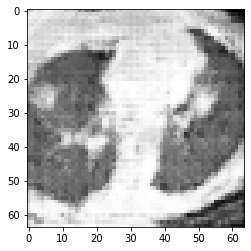

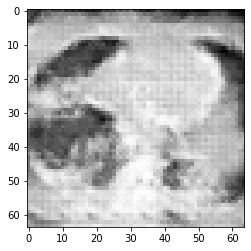

[158/300][0/6]
- D_loss : 1.3859 / G_loss : 0.6867
- D(x) : 0.5048 / D(G(z1)) : 0.5045 / D(G(z2)) : 0.5033 / d_acc : 0.4453
[158/300][1/6]
- D_loss : 1.3825 / G_loss : 0.6943
- D(x) : 0.5019 / D(G(z1)) : 0.4999 / D(G(z2)) : 0.4994 / d_acc : 0.5547
[158/300][2/6]
- D_loss : 1.3859 / G_loss : 0.6848
- D(x) : 0.4960 / D(G(z1)) : 0.4957 / D(G(z2)) : 0.5042 / d_acc : 0.5312
[158/300][3/6]
- D_loss : 1.3854 / G_loss : 0.6808
- D(x) : 0.5004 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5062 / d_acc : 0.5469
[158/300][4/6]
- D_loss : 1.3858 / G_loss : 0.6838
- D(x) : 0.5023 / D(G(z1)) : 0.5020 / D(G(z2)) : 0.5047 / d_acc : 0.4766
[158/300][5/6]
- D_loss : 1.3837 / G_loss : 0.6889
- D(x) : 0.5019 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5022 / d_acc : 0.5547


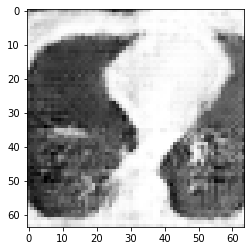

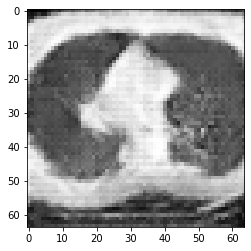

[159/300][0/6]
- D_loss : 1.3833 / G_loss : 0.6914
- D(x) : 0.4998 / D(G(z1)) : 0.4982 / D(G(z2)) : 0.5009 / d_acc : 0.4922
[159/300][1/6]
- D_loss : 1.3871 / G_loss : 0.7004
- D(x) : 0.4978 / D(G(z1)) : 0.4981 / D(G(z2)) : 0.4964 / d_acc : 0.4688
[159/300][2/6]
- D_loss : 1.3843 / G_loss : 0.6864
- D(x) : 0.4943 / D(G(z1)) : 0.4931 / D(G(z2)) : 0.5034 / d_acc : 0.5234
[159/300][3/6]
- D_loss : 1.3834 / G_loss : 0.6741
- D(x) : 0.5008 / D(G(z1)) : 0.4993 / D(G(z2)) : 0.5096 / d_acc : 0.5625
[159/300][4/6]
- D_loss : 1.3883 / G_loss : 0.6869
- D(x) : 0.5046 / D(G(z1)) : 0.5055 / D(G(z2)) : 0.5032 / d_acc : 0.4766
[159/300][5/6]
- D_loss : 1.3829 / G_loss : 0.6826
- D(x) : 0.5003 / D(G(z1)) : 0.4985 / D(G(z2)) : 0.5054 / d_acc : 0.5000


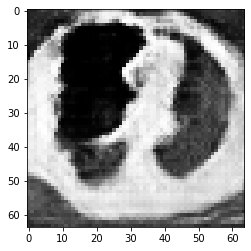

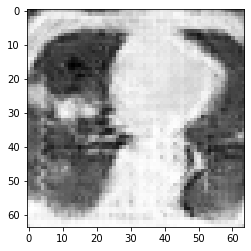

[160/300][0/6]
- D_loss : 1.3853 / G_loss : 0.6891
- D(x) : 0.5021 / D(G(z1)) : 0.5016 / D(G(z2)) : 0.5021 / d_acc : 0.4609
[160/300][1/6]
- D_loss : 1.3863 / G_loss : 0.6913
- D(x) : 0.4971 / D(G(z1)) : 0.4970 / D(G(z2)) : 0.5009 / d_acc : 0.5391
[160/300][2/6]
- D_loss : 1.3836 / G_loss : 0.6744
- D(x) : 0.4983 / D(G(z1)) : 0.4969 / D(G(z2)) : 0.5095 / d_acc : 0.5234
[160/300][3/6]
- D_loss : 1.3823 / G_loss : 0.6787
- D(x) : 0.5066 / D(G(z1)) : 0.5045 / D(G(z2)) : 0.5073 / d_acc : 0.5000
[160/300][4/6]
- D_loss : 1.3875 / G_loss : 0.6954
- D(x) : 0.5027 / D(G(z1)) : 0.5032 / D(G(z2)) : 0.4989 / d_acc : 0.4531
[160/300][5/6]
- D_loss : 1.3829 / G_loss : 0.6896
- D(x) : 0.4956 / D(G(z1)) : 0.4937 / D(G(z2)) : 0.5018 / d_acc : 0.5703


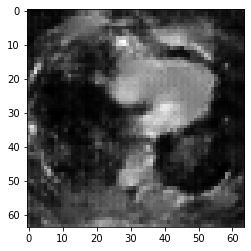

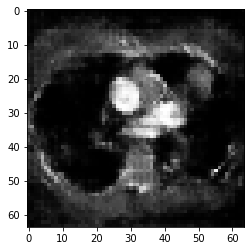

[161/300][0/6]
- D_loss : 1.3822 / G_loss : 0.6833
- D(x) : 0.4998 / D(G(z1)) : 0.4977 / D(G(z2)) : 0.5050 / d_acc : 0.5547
[161/300][1/6]
- D_loss : 1.3837 / G_loss : 0.6836
- D(x) : 0.5004 / D(G(z1)) : 0.4990 / D(G(z2)) : 0.5049 / d_acc : 0.5234
[161/300][2/6]
- D_loss : 1.3848 / G_loss : 0.6906
- D(x) : 0.5004 / D(G(z1)) : 0.4995 / D(G(z2)) : 0.5013 / d_acc : 0.4688
[161/300][3/6]
- D_loss : 1.3828 / G_loss : 0.6786
- D(x) : 0.4970 / D(G(z1)) : 0.4951 / D(G(z2)) : 0.5073 / d_acc : 0.5391
[161/300][4/6]
- D_loss : 1.3825 / G_loss : 0.6793
- D(x) : 0.5035 / D(G(z1)) : 0.5015 / D(G(z2)) : 0.5070 / d_acc : 0.5156
[161/300][5/6]
- D_loss : 1.3843 / G_loss : 0.6864
- D(x) : 0.5022 / D(G(z1)) : 0.5011 / D(G(z2)) : 0.5034 / d_acc : 0.5469


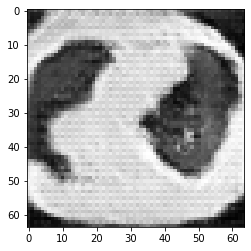

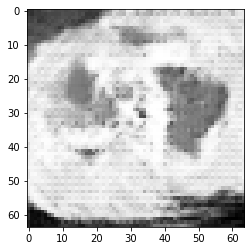

[162/300][0/6]
- D_loss : 1.3790 / G_loss : 0.6873
- D(x) : 0.5008 / D(G(z1)) : 0.4970 / D(G(z2)) : 0.5030 / d_acc : 0.6094
[162/300][1/6]
- D_loss : 1.3835 / G_loss : 0.6861
- D(x) : 0.4982 / D(G(z1)) : 0.4967 / D(G(z2)) : 0.5036 / d_acc : 0.5156
[162/300][2/6]
- D_loss : 1.3863 / G_loss : 0.6783
- D(x) : 0.4985 / D(G(z1)) : 0.4985 / D(G(z2)) : 0.5075 / d_acc : 0.5156
[162/300][3/6]
- D_loss : 1.3860 / G_loss : 0.6829
- D(x) : 0.5026 / D(G(z1)) : 0.5023 / D(G(z2)) : 0.5052 / d_acc : 0.5000
[162/300][4/6]
- D_loss : 1.3834 / G_loss : 0.6768
- D(x) : 0.5001 / D(G(z1)) : 0.4985 / D(G(z2)) : 0.5083 / d_acc : 0.5391
[162/300][5/6]
- D_loss : 1.3864 / G_loss : 0.6909
- D(x) : 0.5023 / D(G(z1)) : 0.5022 / D(G(z2)) : 0.5011 / d_acc : 0.4531


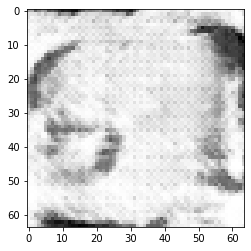

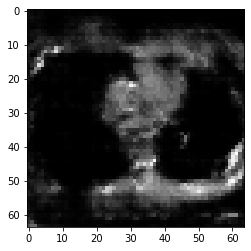

[163/300][0/6]
- D_loss : 1.3783 / G_loss : 0.6803
- D(x) : 0.4986 / D(G(z1)) : 0.4945 / D(G(z2)) : 0.5066 / d_acc : 0.6094
[163/300][1/6]
- D_loss : 1.3851 / G_loss : 0.6823
- D(x) : 0.4997 / D(G(z1)) : 0.4989 / D(G(z2)) : 0.5055 / d_acc : 0.5000
[163/300][2/6]
- D_loss : 1.3778 / G_loss : 0.6792
- D(x) : 0.5020 / D(G(z1)) : 0.4976 / D(G(z2)) : 0.5071 / d_acc : 0.6484
[163/300][3/6]
- D_loss : 1.3826 / G_loss : 0.6730
- D(x) : 0.5028 / D(G(z1)) : 0.5008 / D(G(z2)) : 0.5103 / d_acc : 0.4766
[163/300][4/6]
- D_loss : 1.3850 / G_loss : 0.6994
- D(x) : 0.5049 / D(G(z1)) : 0.5040 / D(G(z2)) : 0.4970 / d_acc : 0.5078
[163/300][5/6]
- D_loss : 1.3853 / G_loss : 0.6827
- D(x) : 0.4916 / D(G(z1)) : 0.4907 / D(G(z2)) : 0.5054 / d_acc : 0.4922


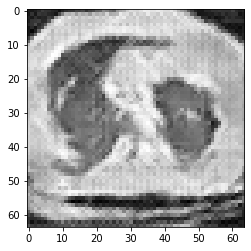

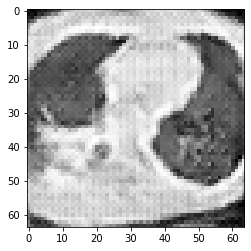

[164/300][0/6]
- D_loss : 1.3886 / G_loss : 0.6715
- D(x) : 0.4988 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5110 / d_acc : 0.5156
[164/300][1/6]
- D_loss : 1.3849 / G_loss : 0.6874
- D(x) : 0.5055 / D(G(z1)) : 0.5047 / D(G(z2)) : 0.5029 / d_acc : 0.4297
[164/300][2/6]
- D_loss : 1.3799 / G_loss : 0.6775
- D(x) : 0.4994 / D(G(z1)) : 0.4961 / D(G(z2)) : 0.5080 / d_acc : 0.6406
[164/300][3/6]
- D_loss : 1.3862 / G_loss : 0.6848
- D(x) : 0.5006 / D(G(z1)) : 0.5003 / D(G(z2)) : 0.5043 / d_acc : 0.4922
[164/300][4/6]
- D_loss : 1.3889 / G_loss : 0.6821
- D(x) : 0.4964 / D(G(z1)) : 0.4976 / D(G(z2)) : 0.5056 / d_acc : 0.4688
[164/300][5/6]
- D_loss : 1.3891 / G_loss : 0.6736
- D(x) : 0.4985 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5100 / d_acc : 0.4766


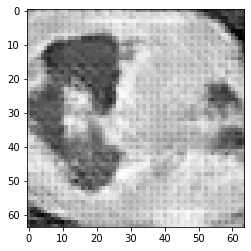

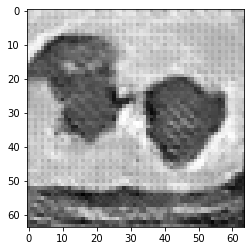

[165/300][0/6]
- D_loss : 1.3847 / G_loss : 0.6847
- D(x) : 0.5047 / D(G(z1)) : 0.5036 / D(G(z2)) : 0.5043 / d_acc : 0.5469
[165/300][1/6]
- D_loss : 1.3858 / G_loss : 0.6859
- D(x) : 0.4989 / D(G(z1)) : 0.4985 / D(G(z2)) : 0.5037 / d_acc : 0.5156
[165/300][2/6]
- D_loss : 1.3842 / G_loss : 0.6874
- D(x) : 0.4988 / D(G(z1)) : 0.4976 / D(G(z2)) : 0.5029 / d_acc : 0.5703
[165/300][3/6]
- D_loss : 1.3875 / G_loss : 0.6782
- D(x) : 0.4958 / D(G(z1)) : 0.4963 / D(G(z2)) : 0.5076 / d_acc : 0.5156
[165/300][4/6]
- D_loss : 1.3815 / G_loss : 0.6755
- D(x) : 0.5027 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5089 / d_acc : 0.5547
[165/300][5/6]
- D_loss : 1.3770 / G_loss : 0.6893
- D(x) : 0.5053 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5020 / d_acc : 0.6094


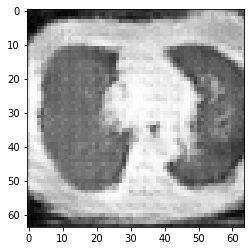

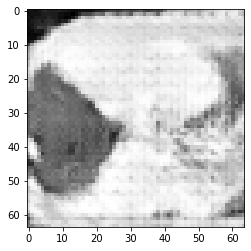

[166/300][0/6]
- D_loss : 1.3757 / G_loss : 0.6775
- D(x) : 0.4991 / D(G(z1)) : 0.4936 / D(G(z2)) : 0.5080 / d_acc : 0.6094
[166/300][1/6]
- D_loss : 1.3807 / G_loss : 0.6593
- D(x) : 0.5029 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5174 / d_acc : 0.5234
[166/300][2/6]
- D_loss : 1.3895 / G_loss : 0.7041
- D(x) : 0.5091 / D(G(z1)) : 0.5103 / D(G(z2)) : 0.4946 / d_acc : 0.4531
[166/300][3/6]
- D_loss : 1.3796 / G_loss : 0.6776
- D(x) : 0.4905 / D(G(z1)) : 0.4868 / D(G(z2)) : 0.5079 / d_acc : 0.5781
[166/300][4/6]
- D_loss : 1.3797 / G_loss : 0.6754
- D(x) : 0.5010 / D(G(z1)) : 0.4974 / D(G(z2)) : 0.5090 / d_acc : 0.5625
[166/300][5/6]
- D_loss : 1.3849 / G_loss : 0.6866
- D(x) : 0.5007 / D(G(z1)) : 0.4998 / D(G(z2)) : 0.5034 / d_acc : 0.5000


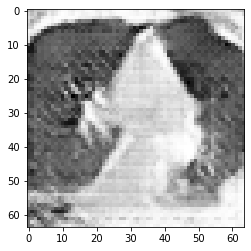

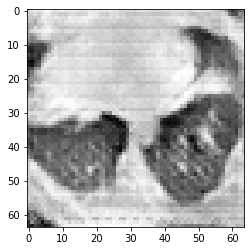

[167/300][0/6]
- D_loss : 1.3831 / G_loss : 0.6676
- D(x) : 0.4980 / D(G(z1)) : 0.4963 / D(G(z2)) : 0.5130 / d_acc : 0.5234
[167/300][1/6]
- D_loss : 1.3820 / G_loss : 0.6828
- D(x) : 0.5061 / D(G(z1)) : 0.5037 / D(G(z2)) : 0.5053 / d_acc : 0.5625
[167/300][2/6]
- D_loss : 1.3838 / G_loss : 0.6632
- D(x) : 0.4987 / D(G(z1)) : 0.4973 / D(G(z2)) : 0.5152 / d_acc : 0.5312
[167/300][3/6]
- D_loss : 1.3848 / G_loss : 0.6935
- D(x) : 0.5072 / D(G(z1)) : 0.5062 / D(G(z2)) : 0.4999 / d_acc : 0.4922
[167/300][4/6]
- D_loss : 1.3797 / G_loss : 0.6912
- D(x) : 0.4953 / D(G(z1)) : 0.4918 / D(G(z2)) : 0.5011 / d_acc : 0.5781
[167/300][5/6]
- D_loss : 1.3814 / G_loss : 0.6626
- D(x) : 0.4956 / D(G(z1)) : 0.4928 / D(G(z2)) : 0.5156 / d_acc : 0.5703


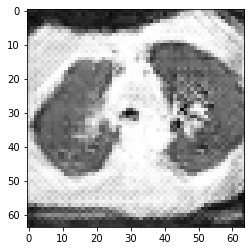

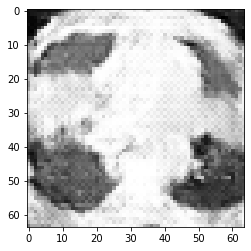

[168/300][0/6]
- D_loss : 1.3793 / G_loss : 0.6775
- D(x) : 0.5099 / D(G(z1)) : 0.5061 / D(G(z2)) : 0.5080 / d_acc : 0.5391
[168/300][1/6]
- D_loss : 1.3797 / G_loss : 0.6901
- D(x) : 0.4999 / D(G(z1)) : 0.4964 / D(G(z2)) : 0.5017 / d_acc : 0.5703
[168/300][2/6]
- D_loss : 1.3751 / G_loss : 0.6680
- D(x) : 0.4970 / D(G(z1)) : 0.4910 / D(G(z2)) : 0.5128 / d_acc : 0.6172
[168/300][3/6]
- D_loss : 1.3780 / G_loss : 0.6773
- D(x) : 0.5058 / D(G(z1)) : 0.5013 / D(G(z2)) : 0.5081 / d_acc : 0.5625
[168/300][4/6]
- D_loss : 1.3878 / G_loss : 0.6732
- D(x) : 0.4979 / D(G(z1)) : 0.4983 / D(G(z2)) : 0.5101 / d_acc : 0.4688
[168/300][5/6]
- D_loss : 1.3809 / G_loss : 0.6799
- D(x) : 0.5018 / D(G(z1)) : 0.4988 / D(G(z2)) : 0.5068 / d_acc : 0.5078


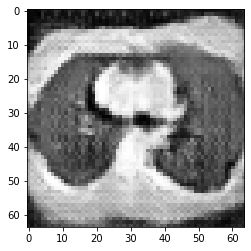

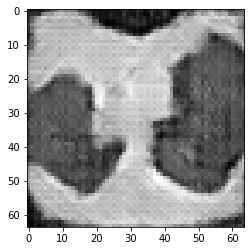

[169/300][0/6]
- D_loss : 1.3894 / G_loss : 0.6720
- D(x) : 0.4966 / D(G(z1)) : 0.4979 / D(G(z2)) : 0.5108 / d_acc : 0.4688
[169/300][1/6]
- D_loss : 1.3896 / G_loss : 0.6611
- D(x) : 0.4999 / D(G(z1)) : 0.5014 / D(G(z2)) : 0.5164 / d_acc : 0.4688
[169/300][2/6]
- D_loss : 1.3829 / G_loss : 0.6919
- D(x) : 0.5094 / D(G(z1)) : 0.5073 / D(G(z2)) : 0.5007 / d_acc : 0.4531
[169/300][3/6]
- D_loss : 1.3832 / G_loss : 0.6777
- D(x) : 0.4918 / D(G(z1)) : 0.4899 / D(G(z2)) : 0.5080 / d_acc : 0.5156
[169/300][4/6]
- D_loss : 1.3811 / G_loss : 0.6714
- D(x) : 0.5016 / D(G(z1)) : 0.4988 / D(G(z2)) : 0.5112 / d_acc : 0.5469
[169/300][5/6]
- D_loss : 1.3825 / G_loss : 0.6767
- D(x) : 0.5024 / D(G(z1)) : 0.5002 / D(G(z2)) : 0.5085 / d_acc : 0.5078


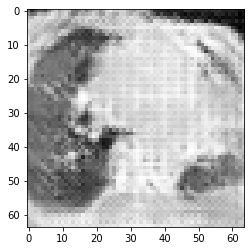

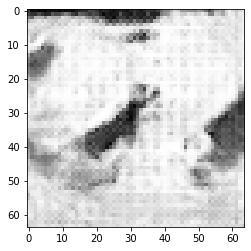

[170/300][0/6]
- D_loss : 1.3758 / G_loss : 0.6758
- D(x) : 0.5044 / D(G(z1)) : 0.4988 / D(G(z2)) : 0.5089 / d_acc : 0.5859
[170/300][1/6]
- D_loss : 1.3850 / G_loss : 0.6784
- D(x) : 0.4990 / D(G(z1)) : 0.4980 / D(G(z2)) : 0.5075 / d_acc : 0.5703
[170/300][2/6]
- D_loss : 1.3794 / G_loss : 0.6942
- D(x) : 0.5020 / D(G(z1)) : 0.4984 / D(G(z2)) : 0.4995 / d_acc : 0.5547
[170/300][3/6]
- D_loss : 1.3777 / G_loss : 0.6538
- D(x) : 0.4931 / D(G(z1)) : 0.4884 / D(G(z2)) : 0.5203 / d_acc : 0.5469
[170/300][4/6]
- D_loss : 1.3785 / G_loss : 0.6868
- D(x) : 0.5129 / D(G(z1)) : 0.5084 / D(G(z2)) : 0.5032 / d_acc : 0.5703
[170/300][5/6]
- D_loss : 1.3833 / G_loss : 0.6626
- D(x) : 0.4942 / D(G(z1)) : 0.4923 / D(G(z2)) : 0.5157 / d_acc : 0.5078


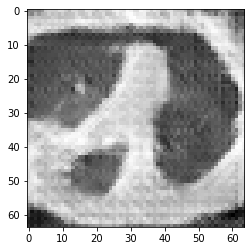

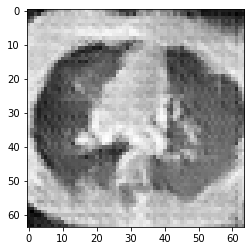

[171/300][0/6]
- D_loss : 1.3785 / G_loss : 0.6863
- D(x) : 0.5089 / D(G(z1)) : 0.5046 / D(G(z2)) : 0.5037 / d_acc : 0.5781
[171/300][1/6]
- D_loss : 1.3897 / G_loss : 0.6635
- D(x) : 0.4910 / D(G(z1)) : 0.4918 / D(G(z2)) : 0.5152 / d_acc : 0.5312
[171/300][2/6]
- D_loss : 1.3879 / G_loss : 0.6742
- D(x) : 0.5040 / D(G(z1)) : 0.5044 / D(G(z2)) : 0.5097 / d_acc : 0.4531
[171/300][3/6]
- D_loss : 1.3791 / G_loss : 0.6843
- D(x) : 0.5040 / D(G(z1)) : 0.5001 / D(G(z2)) : 0.5046 / d_acc : 0.5859
[171/300][4/6]
- D_loss : 1.3813 / G_loss : 0.6795
- D(x) : 0.4959 / D(G(z1)) : 0.4930 / D(G(z2)) : 0.5070 / d_acc : 0.5078
[171/300][5/6]
- D_loss : 1.3821 / G_loss : 0.6548
- D(x) : 0.4978 / D(G(z1)) : 0.4953 / D(G(z2)) : 0.5198 / d_acc : 0.5312


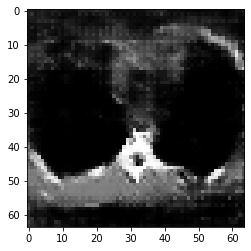

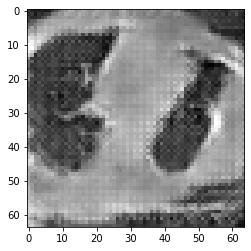

[172/300][0/6]
- D_loss : 1.3780 / G_loss : 0.6808
- D(x) : 0.5129 / D(G(z1)) : 0.5079 / D(G(z2)) : 0.5064 / d_acc : 0.5781
[172/300][1/6]
- D_loss : 1.3826 / G_loss : 0.6872
- D(x) : 0.4964 / D(G(z1)) : 0.4941 / D(G(z2)) : 0.5031 / d_acc : 0.5156
[172/300][2/6]
- D_loss : 1.3707 / G_loss : 0.6686
- D(x) : 0.4988 / D(G(z1)) : 0.4906 / D(G(z2)) : 0.5126 / d_acc : 0.6016
[172/300][3/6]
- D_loss : 1.3727 / G_loss : 0.6520
- D(x) : 0.5057 / D(G(z1)) : 0.4984 / D(G(z2)) : 0.5211 / d_acc : 0.5625
[172/300][4/6]
- D_loss : 1.3702 / G_loss : 0.7199
- D(x) : 0.5128 / D(G(z1)) : 0.5043 / D(G(z2)) : 0.4869 / d_acc : 0.5938
[172/300][5/6]
- D_loss : 1.3891 / G_loss : 0.6112
- D(x) : 0.4711 / D(G(z1)) : 0.4707 / D(G(z2)) : 0.5430 / d_acc : 0.5156


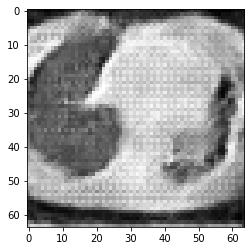

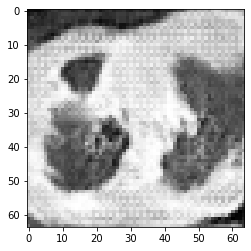

[173/300][0/6]
- D_loss : 1.3764 / G_loss : 0.6933
- D(x) : 0.5349 / D(G(z1)) : 0.5275 / D(G(z2)) : 0.5001 / d_acc : 0.5469
[173/300][1/6]
- D_loss : 1.3613 / G_loss : 0.6744
- D(x) : 0.4963 / D(G(z1)) : 0.4831 / D(G(z2)) : 0.5097 / d_acc : 0.6562
[173/300][2/6]
- D_loss : 1.3811 / G_loss : 0.6763
- D(x) : 0.4950 / D(G(z1)) : 0.4917 / D(G(z2)) : 0.5087 / d_acc : 0.5859
[173/300][3/6]
- D_loss : 1.3804 / G_loss : 0.6480
- D(x) : 0.4966 / D(G(z1)) : 0.4931 / D(G(z2)) : 0.5233 / d_acc : 0.5547
[173/300][4/6]
- D_loss : 1.3743 / G_loss : 0.6787
- D(x) : 0.5138 / D(G(z1)) : 0.5073 / D(G(z2)) : 0.5077 / d_acc : 0.5469
[173/300][5/6]
- D_loss : 1.3770 / G_loss : 0.6724
- D(x) : 0.4944 / D(G(z1)) : 0.4891 / D(G(z2)) : 0.5107 / d_acc : 0.5781


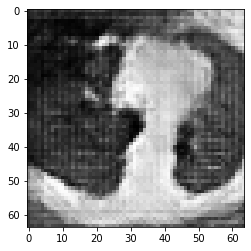

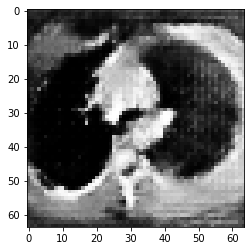

[174/300][0/6]
- D_loss : 1.3713 / G_loss : 0.6610
- D(x) : 0.4996 / D(G(z1)) : 0.4915 / D(G(z2)) : 0.5166 / d_acc : 0.5703
[174/300][1/6]
- D_loss : 1.3604 / G_loss : 0.6742
- D(x) : 0.5114 / D(G(z1)) : 0.4978 / D(G(z2)) : 0.5098 / d_acc : 0.6328
[174/300][2/6]
- D_loss : 1.3799 / G_loss : 0.6586
- D(x) : 0.4963 / D(G(z1)) : 0.4927 / D(G(z2)) : 0.5180 / d_acc : 0.5469
[174/300][3/6]
- D_loss : 1.3772 / G_loss : 0.6540
- D(x) : 0.5015 / D(G(z1)) : 0.4964 / D(G(z2)) : 0.5202 / d_acc : 0.6016
[174/300][4/6]
- D_loss : 1.3785 / G_loss : 0.6455
- D(x) : 0.5068 / D(G(z1)) : 0.5023 / D(G(z2)) : 0.5246 / d_acc : 0.5078
[174/300][5/6]
- D_loss : 1.3794 / G_loss : 0.7072
- D(x) : 0.5129 / D(G(z1)) : 0.5088 / D(G(z2)) : 0.4933 / d_acc : 0.5078


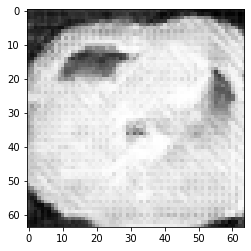

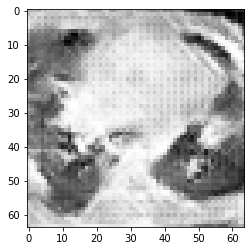

[175/300][0/6]
- D_loss : 1.3813 / G_loss : 0.6496
- D(x) : 0.4832 / D(G(z1)) : 0.4792 / D(G(z2)) : 0.5226 / d_acc : 0.5234
[175/300][1/6]
- D_loss : 1.3864 / G_loss : 0.6636
- D(x) : 0.5062 / D(G(z1)) : 0.5054 / D(G(z2)) : 0.5151 / d_acc : 0.4844
[175/300][2/6]
- D_loss : 1.3638 / G_loss : 0.6850
- D(x) : 0.5080 / D(G(z1)) : 0.4963 / D(G(z2)) : 0.5042 / d_acc : 0.7188
[175/300][3/6]
- D_loss : 1.3850 / G_loss : 0.6398
- D(x) : 0.4884 / D(G(z1)) : 0.4869 / D(G(z2)) : 0.5276 / d_acc : 0.4922
[175/300][4/6]
- D_loss : 1.3674 / G_loss : 0.6826
- D(x) : 0.5186 / D(G(z1)) : 0.5083 / D(G(z2)) : 0.5056 / d_acc : 0.5469
[175/300][5/6]
- D_loss : 1.3721 / G_loss : 0.6406
- D(x) : 0.4937 / D(G(z1)) : 0.4857 / D(G(z2)) : 0.5272 / d_acc : 0.5859


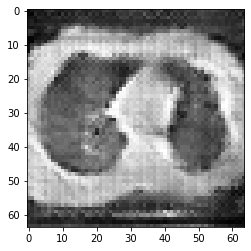

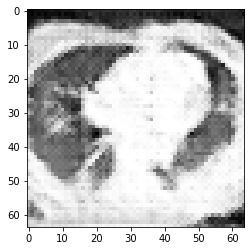

[176/300][0/6]
- D_loss : 1.3781 / G_loss : 0.6941
- D(x) : 0.5127 / D(G(z1)) : 0.5077 / D(G(z2)) : 0.4997 / d_acc : 0.5391
[176/300][1/6]
- D_loss : 1.3703 / G_loss : 0.6426
- D(x) : 0.4885 / D(G(z1)) : 0.4796 / D(G(z2)) : 0.5261 / d_acc : 0.5703
[176/300][2/6]
- D_loss : 1.3689 / G_loss : 0.6365
- D(x) : 0.5119 / D(G(z1)) : 0.5026 / D(G(z2)) : 0.5294 / d_acc : 0.6328
[176/300][3/6]
- D_loss : 1.3734 / G_loss : 0.7153
- D(x) : 0.5140 / D(G(z1)) : 0.5065 / D(G(z2)) : 0.4892 / d_acc : 0.5625
[176/300][4/6]
- D_loss : 1.3852 / G_loss : 0.6193
- D(x) : 0.4744 / D(G(z1)) : 0.4719 / D(G(z2)) : 0.5385 / d_acc : 0.5469
[176/300][5/6]
- D_loss : 1.3758 / G_loss : 0.6920
- D(x) : 0.5251 / D(G(z1)) : 0.5184 / D(G(z2)) : 0.5009 / d_acc : 0.5156


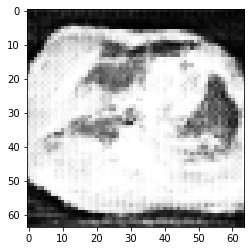

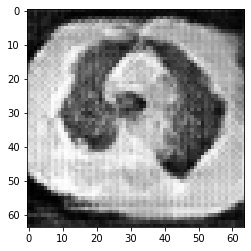

[177/300][0/6]
- D_loss : 1.3873 / G_loss : 0.6158
- D(x) : 0.4859 / D(G(z1)) : 0.4849 / D(G(z2)) : 0.5406 / d_acc : 0.5469
[177/300][1/6]
- D_loss : 1.3782 / G_loss : 0.6988
- D(x) : 0.5244 / D(G(z1)) : 0.5183 / D(G(z2)) : 0.4975 / d_acc : 0.5156
[177/300][2/6]
- D_loss : 1.4001 / G_loss : 0.6704
- D(x) : 0.4782 / D(G(z1)) : 0.4837 / D(G(z2)) : 0.5121 / d_acc : 0.4453
[177/300][3/6]
- D_loss : 1.3848 / G_loss : 0.6594
- D(x) : 0.4973 / D(G(z1)) : 0.4951 / D(G(z2)) : 0.5173 / d_acc : 0.5469
[177/300][4/6]
- D_loss : 1.3752 / G_loss : 0.6442
- D(x) : 0.5040 / D(G(z1)) : 0.4979 / D(G(z2)) : 0.5255 / d_acc : 0.5547
[177/300][5/6]
- D_loss : 1.4007 / G_loss : 0.6831
- D(x) : 0.5039 / D(G(z1)) : 0.5100 / D(G(z2)) : 0.5058 / d_acc : 0.4453


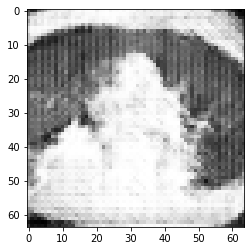

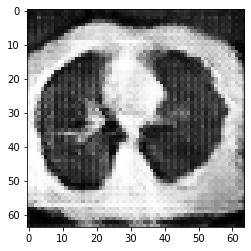

[178/300][0/6]
- D_loss : 1.3738 / G_loss : 0.6521
- D(x) : 0.4923 / D(G(z1)) : 0.4843 / D(G(z2)) : 0.5213 / d_acc : 0.6250
[178/300][1/6]
- D_loss : 1.3742 / G_loss : 0.6624
- D(x) : 0.5101 / D(G(z1)) : 0.5029 / D(G(z2)) : 0.5158 / d_acc : 0.5781
[178/300][2/6]
- D_loss : 1.3628 / G_loss : 0.6551
- D(x) : 0.5061 / D(G(z1)) : 0.4936 / D(G(z2)) : 0.5196 / d_acc : 0.6094
[178/300][3/6]
- D_loss : 1.3776 / G_loss : 0.6645
- D(x) : 0.5058 / D(G(z1)) : 0.5005 / D(G(z2)) : 0.5149 / d_acc : 0.5781
[178/300][4/6]
- D_loss : 1.3577 / G_loss : 0.6482
- D(x) : 0.5056 / D(G(z1)) : 0.4904 / D(G(z2)) : 0.5234 / d_acc : 0.6094
[178/300][5/6]
- D_loss : 1.3693 / G_loss : 0.6750
- D(x) : 0.5091 / D(G(z1)) : 0.4997 / D(G(z2)) : 0.5095 / d_acc : 0.5625


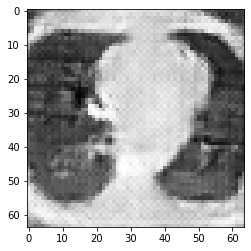

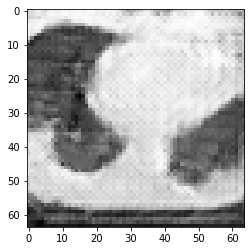

[179/300][0/6]
- D_loss : 1.3512 / G_loss : 0.6622
- D(x) : 0.5015 / D(G(z1)) : 0.4830 / D(G(z2)) : 0.5160 / d_acc : 0.7109
[179/300][1/6]
- D_loss : 1.3454 / G_loss : 0.6480
- D(x) : 0.5064 / D(G(z1)) : 0.4851 / D(G(z2)) : 0.5233 / d_acc : 0.7188
[179/300][2/6]
- D_loss : 1.3513 / G_loss : 0.6809
- D(x) : 0.5151 / D(G(z1)) : 0.4966 / D(G(z2)) : 0.5065 / d_acc : 0.6484
[179/300][3/6]
- D_loss : 1.3753 / G_loss : 0.5649
- D(x) : 0.4833 / D(G(z1)) : 0.4763 / D(G(z2)) : 0.5688 / d_acc : 0.5703
[179/300][4/6]
- D_loss : 1.4074 / G_loss : 0.7724
- D(x) : 0.5423 / D(G(z1)) : 0.5478 / D(G(z2)) : 0.4622 / d_acc : 0.4844
[179/300][5/6]
- D_loss : 1.3902 / G_loss : 0.5599
- D(x) : 0.4407 / D(G(z1)) : 0.4342 / D(G(z2)) : 0.5717 / d_acc : 0.5000


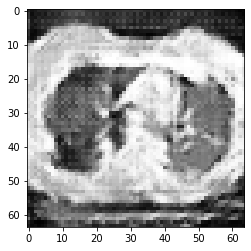

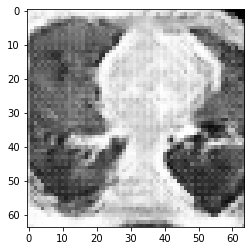

[180/300][0/6]
- D_loss : 1.3803 / G_loss : 0.7122
- D(x) : 0.5555 / D(G(z1)) : 0.5461 / D(G(z2)) : 0.4910 / d_acc : 0.5000
[180/300][1/6]
- D_loss : 1.3551 / G_loss : 0.6528
- D(x) : 0.4832 / D(G(z1)) : 0.4653 / D(G(z2)) : 0.5209 / d_acc : 0.5781
[180/300][2/6]
- D_loss : 1.3669 / G_loss : 0.6523
- D(x) : 0.5031 / D(G(z1)) : 0.4919 / D(G(z2)) : 0.5213 / d_acc : 0.5781
[180/300][3/6]
- D_loss : 1.3714 / G_loss : 0.6719
- D(x) : 0.5040 / D(G(z1)) : 0.4955 / D(G(z2)) : 0.5111 / d_acc : 0.5703
[180/300][4/6]
- D_loss : 1.3795 / G_loss : 0.6220
- D(x) : 0.4880 / D(G(z1)) : 0.4834 / D(G(z2)) : 0.5381 / d_acc : 0.5703
[180/300][5/6]
- D_loss : 1.3773 / G_loss : 0.6948
- D(x) : 0.5267 / D(G(z1)) : 0.5162 / D(G(z2)) : 0.5005 / d_acc : 0.5625


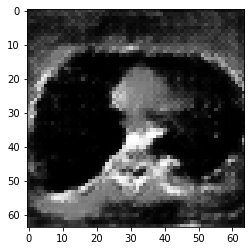

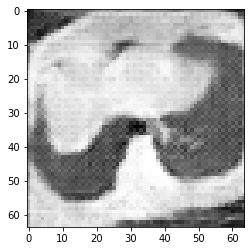

[181/300][0/6]
- D_loss : 1.3681 / G_loss : 0.6475
- D(x) : 0.4915 / D(G(z1)) : 0.4795 / D(G(z2)) : 0.5237 / d_acc : 0.5391
[181/300][1/6]
- D_loss : 1.3769 / G_loss : 0.6842
- D(x) : 0.5056 / D(G(z1)) : 0.5000 / D(G(z2)) : 0.5049 / d_acc : 0.5547
[181/300][2/6]
- D_loss : 1.3598 / G_loss : 0.6119
- D(x) : 0.4921 / D(G(z1)) : 0.4771 / D(G(z2)) : 0.5429 / d_acc : 0.6172
[181/300][3/6]
- D_loss : 1.3721 / G_loss : 0.6928
- D(x) : 0.5242 / D(G(z1)) : 0.5152 / D(G(z2)) : 0.5006 / d_acc : 0.5391
[181/300][4/6]
- D_loss : 1.3649 / G_loss : 0.5856
- D(x) : 0.4862 / D(G(z1)) : 0.4736 / D(G(z2)) : 0.5572 / d_acc : 0.5312
[181/300][5/6]
- D_loss : 1.3536 / G_loss : 0.6997
- D(x) : 0.5440 / D(G(z1)) : 0.5243 / D(G(z2)) : 0.4974 / d_acc : 0.5312


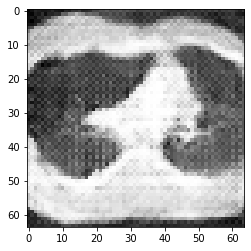

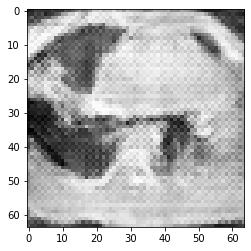

[182/300][0/6]
- D_loss : 1.3424 / G_loss : 0.6715
- D(x) : 0.4890 / D(G(z1)) : 0.4648 / D(G(z2)) : 0.5116 / d_acc : 0.5938
[182/300][1/6]
- D_loss : 1.3412 / G_loss : 0.5551
- D(x) : 0.4988 / D(G(z1)) : 0.4742 / D(G(z2)) : 0.5744 / d_acc : 0.6406
[182/300][2/6]
- D_loss : 1.3894 / G_loss : 0.7912
- D(x) : 0.5448 / D(G(z1)) : 0.5407 / D(G(z2)) : 0.4535 / d_acc : 0.5547
[182/300][3/6]
- D_loss : 1.3941 / G_loss : 0.5261
- D(x) : 0.4294 / D(G(z1)) : 0.4207 / D(G(z2)) : 0.5911 / d_acc : 0.5078
[182/300][4/6]
- D_loss : 1.3794 / G_loss : 0.6648
- D(x) : 0.5520 / D(G(z1)) : 0.5429 / D(G(z2)) : 0.5146 / d_acc : 0.5156
[182/300][5/6]
- D_loss : 1.3286 / G_loss : 0.6634
- D(x) : 0.5044 / D(G(z1)) : 0.4740 / D(G(z2)) : 0.5157 / d_acc : 0.7266


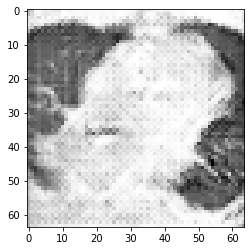

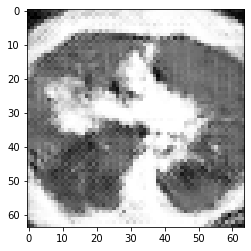

[183/300][0/6]
- D_loss : 1.3506 / G_loss : 0.5836
- D(x) : 0.4908 / D(G(z1)) : 0.4708 / D(G(z2)) : 0.5587 / d_acc : 0.6406
[183/300][1/6]
- D_loss : 1.3398 / G_loss : 0.7247
- D(x) : 0.5436 / D(G(z1)) : 0.5163 / D(G(z2)) : 0.4854 / d_acc : 0.6406
[183/300][2/6]
- D_loss : 1.3515 / G_loss : 0.5771
- D(x) : 0.4691 / D(G(z1)) : 0.4461 / D(G(z2)) : 0.5626 / d_acc : 0.5312
[183/300][3/6]
- D_loss : 1.3784 / G_loss : 0.6672
- D(x) : 0.5333 / D(G(z1)) : 0.5247 / D(G(z2)) : 0.5141 / d_acc : 0.5469
[183/300][4/6]
- D_loss : 1.3643 / G_loss : 0.5941
- D(x) : 0.4886 / D(G(z1)) : 0.4738 / D(G(z2)) : 0.5529 / d_acc : 0.5547
[183/300][5/6]
- D_loss : 1.3553 / G_loss : 0.6643
- D(x) : 0.5267 / D(G(z1)) : 0.5080 / D(G(z2)) : 0.5155 / d_acc : 0.6250


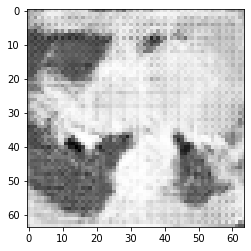

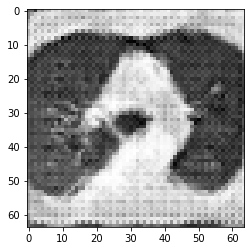

[184/300][0/6]
- D_loss : 1.3138 / G_loss : 0.6760
- D(x) : 0.5142 / D(G(z1)) : 0.4752 / D(G(z2)) : 0.5094 / d_acc : 0.7500
[184/300][1/6]
- D_loss : 1.3519 / G_loss : 0.5791
- D(x) : 0.4925 / D(G(z1)) : 0.4716 / D(G(z2)) : 0.5610 / d_acc : 0.5938
[184/300][2/6]
- D_loss : 1.3301 / G_loss : 0.7298
- D(x) : 0.5427 / D(G(z1)) : 0.5098 / D(G(z2)) : 0.4826 / d_acc : 0.5859
[184/300][3/6]
- D_loss : 1.3794 / G_loss : 0.5109
- D(x) : 0.4536 / D(G(z1)) : 0.4435 / D(G(z2)) : 0.6005 / d_acc : 0.5391
[184/300][4/6]
- D_loss : 1.3636 / G_loss : 0.6862
- D(x) : 0.5655 / D(G(z1)) : 0.5459 / D(G(z2)) : 0.5050 / d_acc : 0.5312
[184/300][5/6]
- D_loss : 1.3705 / G_loss : 0.5733
- D(x) : 0.4708 / D(G(z1)) : 0.4578 / D(G(z2)) : 0.5644 / d_acc : 0.5156


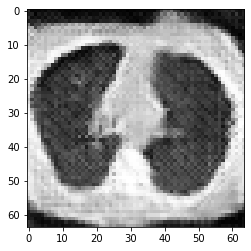

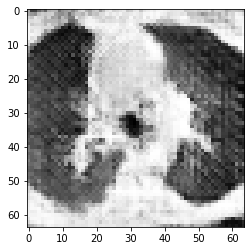

[185/300][0/6]
- D_loss : 1.3607 / G_loss : 0.6967
- D(x) : 0.5397 / D(G(z1)) : 0.5219 / D(G(z2)) : 0.4995 / d_acc : 0.5234
[185/300][1/6]
- D_loss : 1.3544 / G_loss : 0.6168
- D(x) : 0.4788 / D(G(z1)) : 0.4576 / D(G(z2)) : 0.5403 / d_acc : 0.6016
[185/300][2/6]
- D_loss : 1.3411 / G_loss : 0.6503
- D(x) : 0.5186 / D(G(z1)) : 0.4936 / D(G(z2)) : 0.5225 / d_acc : 0.6484
[185/300][3/6]
- D_loss : 1.3411 / G_loss : 0.5960
- D(x) : 0.5047 / D(G(z1)) : 0.4801 / D(G(z2)) : 0.5521 / d_acc : 0.6562
[185/300][4/6]
- D_loss : 1.3225 / G_loss : 0.6984
- D(x) : 0.5392 / D(G(z1)) : 0.5020 / D(G(z2)) : 0.4982 / d_acc : 0.6328
[185/300][5/6]
- D_loss : 1.3221 / G_loss : 0.5530
- D(x) : 0.4795 / D(G(z1)) : 0.4415 / D(G(z2)) : 0.5759 / d_acc : 0.5859


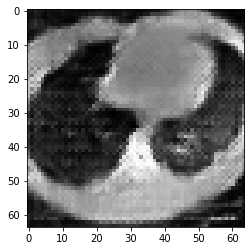

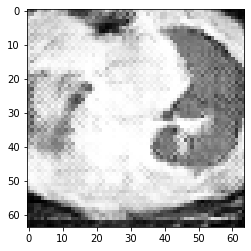

[186/300][0/6]
- D_loss : 1.3192 / G_loss : 0.6914
- D(x) : 0.5648 / D(G(z1)) : 0.5244 / D(G(z2)) : 0.5018 / d_acc : 0.5781
[186/300][1/6]
- D_loss : 1.3631 / G_loss : 0.5493
- D(x) : 0.4691 / D(G(z1)) : 0.4512 / D(G(z2)) : 0.5782 / d_acc : 0.5703
[186/300][2/6]
- D_loss : 1.3842 / G_loss : 0.6257
- D(x) : 0.5373 / D(G(z1)) : 0.5312 / D(G(z2)) : 0.5367 / d_acc : 0.5000
[186/300][3/6]
- D_loss : 1.3396 / G_loss : 0.6896
- D(x) : 0.5219 / D(G(z1)) : 0.4935 / D(G(z2)) : 0.5030 / d_acc : 0.6094
[186/300][4/6]
- D_loss : 1.3389 / G_loss : 0.5586
- D(x) : 0.4758 / D(G(z1)) : 0.4456 / D(G(z2)) : 0.5734 / d_acc : 0.6016
[186/300][5/6]
- D_loss : 1.3457 / G_loss : 0.7014
- D(x) : 0.5503 / D(G(z1)) : 0.5228 / D(G(z2)) : 0.4966 / d_acc : 0.6328


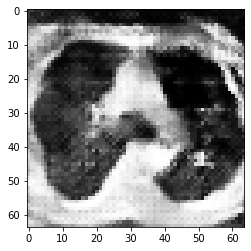

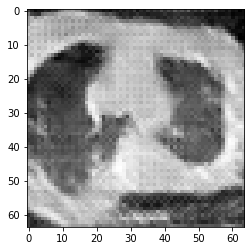

[187/300][0/6]
- D_loss : 1.3198 / G_loss : 0.5515
- D(x) : 0.4788 / D(G(z1)) : 0.4392 / D(G(z2)) : 0.5770 / d_acc : 0.6406
[187/300][1/6]
- D_loss : 1.3541 / G_loss : 0.6900
- D(x) : 0.5360 / D(G(z1)) : 0.5156 / D(G(z2)) : 0.5024 / d_acc : 0.6250
[187/300][2/6]
- D_loss : 1.3468 / G_loss : 0.5539
- D(x) : 0.4743 / D(G(z1)) : 0.4479 / D(G(z2)) : 0.5761 / d_acc : 0.6094
[187/300][3/6]
- D_loss : 1.3203 / G_loss : 0.6958
- D(x) : 0.5502 / D(G(z1)) : 0.5123 / D(G(z2)) : 0.4992 / d_acc : 0.6406
[187/300][4/6]
- D_loss : 1.3013 / G_loss : 0.5105
- D(x) : 0.4863 / D(G(z1)) : 0.4381 / D(G(z2)) : 0.6007 / d_acc : 0.6094
[187/300][5/6]
- D_loss : 1.3352 / G_loss : 0.7471
- D(x) : 0.5698 / D(G(z1)) : 0.5366 / D(G(z2)) : 0.4742 / d_acc : 0.5469


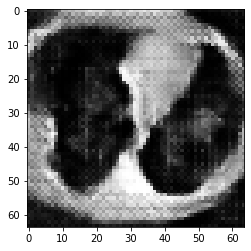

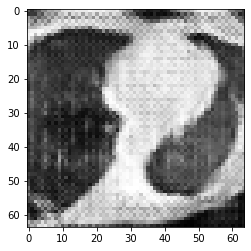

[188/300][0/6]
- D_loss : 1.3354 / G_loss : 0.5166
- D(x) : 0.4498 / D(G(z1)) : 0.4107 / D(G(z2)) : 0.5979 / d_acc : 0.5625
[188/300][1/6]
- D_loss : 1.3866 / G_loss : 0.5940
- D(x) : 0.5426 / D(G(z1)) : 0.5351 / D(G(z2)) : 0.5555 / d_acc : 0.5000
[188/300][2/6]
- D_loss : 1.3615 / G_loss : 0.6650
- D(x) : 0.5279 / D(G(z1)) : 0.5049 / D(G(z2)) : 0.5225 / d_acc : 0.5938
[188/300][3/6]
- D_loss : 1.3951 / G_loss : 0.6278
- D(x) : 0.4961 / D(G(z1)) : 0.4780 / D(G(z2)) : 0.5354 / d_acc : 0.5156
[188/300][4/6]
- D_loss : 1.4245 / G_loss : 0.5326
- D(x) : 0.4592 / D(G(z1)) : 0.4703 / D(G(z2)) : 0.5883 / d_acc : 0.4844
[188/300][5/6]
- D_loss : 1.3348 / G_loss : 0.7713
- D(x) : 0.5708 / D(G(z1)) : 0.5347 / D(G(z2)) : 0.4631 / d_acc : 0.5547


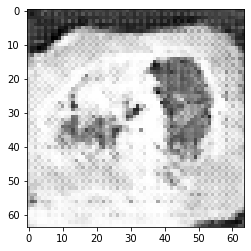

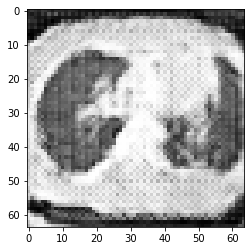

[189/300][0/6]
- D_loss : 1.3675 / G_loss : 0.4841
- D(x) : 0.4387 / D(G(z1)) : 0.4167 / D(G(z2)) : 0.6177 / d_acc : 0.5312
[189/300][1/6]
- D_loss : 1.3875 / G_loss : 0.7377
- D(x) : 0.5714 / D(G(z1)) : 0.5589 / D(G(z2)) : 0.4789 / d_acc : 0.5391
[189/300][2/6]
- D_loss : 1.3281 / G_loss : 0.5799
- D(x) : 0.4602 / D(G(z1)) : 0.4223 / D(G(z2)) : 0.5608 / d_acc : 0.5625
[189/300][3/6]
- D_loss : 1.3256 / G_loss : 0.6186
- D(x) : 0.5357 / D(G(z1)) : 0.5020 / D(G(z2)) : 0.5396 / d_acc : 0.6562
[189/300][4/6]
- D_loss : 1.2767 / G_loss : 0.6932
- D(x) : 0.5406 / D(G(z1)) : 0.4820 / D(G(z2)) : 0.5012 / d_acc : 0.7812
[189/300][5/6]
- D_loss : 1.3103 / G_loss : 0.4905
- D(x) : 0.4830 / D(G(z1)) : 0.4366 / D(G(z2)) : 0.6131 / d_acc : 0.6172


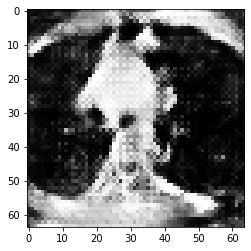

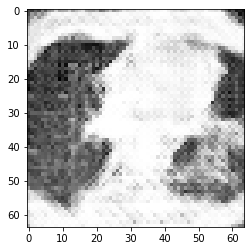

[190/300][0/6]
- D_loss : 1.2988 / G_loss : 0.8055
- D(x) : 0.5966 / D(G(z1)) : 0.5395 / D(G(z2)) : 0.4485 / d_acc : 0.5391
[190/300][1/6]
- D_loss : 1.3078 / G_loss : 0.5132
- D(x) : 0.4462 / D(G(z1)) : 0.3883 / D(G(z2)) : 0.5997 / d_acc : 0.5781
[190/300][2/6]
- D_loss : 1.3613 / G_loss : 0.5794
- D(x) : 0.5429 / D(G(z1)) : 0.5240 / D(G(z2)) : 0.5611 / d_acc : 0.5312
[190/300][3/6]
- D_loss : 1.2975 / G_loss : 0.6042
- D(x) : 0.5318 / D(G(z1)) : 0.4809 / D(G(z2)) : 0.5500 / d_acc : 0.7656
[190/300][4/6]
- D_loss : 1.2841 / G_loss : 0.5399
- D(x) : 0.5079 / D(G(z1)) : 0.4464 / D(G(z2)) : 0.5839 / d_acc : 0.7031
[190/300][5/6]
- D_loss : 1.3266 / G_loss : 0.6817
- D(x) : 0.5508 / D(G(z1)) : 0.5131 / D(G(z2)) : 0.5074 / d_acc : 0.6094


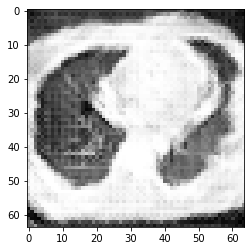

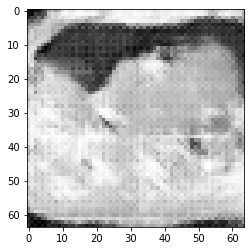

[191/300][0/6]
- D_loss : 1.3031 / G_loss : 0.4830
- D(x) : 0.4851 / D(G(z1)) : 0.4263 / D(G(z2)) : 0.6194 / d_acc : 0.7031
[191/300][1/6]
- D_loss : 1.3020 / G_loss : 0.7851
- D(x) : 0.5934 / D(G(z1)) : 0.5335 / D(G(z2)) : 0.4601 / d_acc : 0.6172
[191/300][2/6]
- D_loss : 1.2906 / G_loss : 0.4771
- D(x) : 0.4515 / D(G(z1)) : 0.3850 / D(G(z2)) : 0.6220 / d_acc : 0.5469
[191/300][3/6]
- D_loss : 1.2914 / G_loss : 0.6264
- D(x) : 0.5883 / D(G(z1)) : 0.5291 / D(G(z2)) : 0.5357 / d_acc : 0.5859
[191/300][4/6]
- D_loss : 1.2904 / G_loss : 0.5326
- D(x) : 0.4977 / D(G(z1)) : 0.4437 / D(G(z2)) : 0.5879 / d_acc : 0.6875
[191/300][5/6]
- D_loss : 1.2927 / G_loss : 0.5482
- D(x) : 0.5376 / D(G(z1)) : 0.4847 / D(G(z2)) : 0.5796 / d_acc : 0.7031


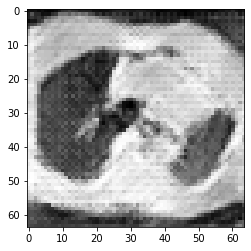

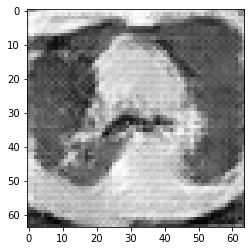

[192/300][0/6]
- D_loss : 1.2417 / G_loss : 0.7016
- D(x) : 0.5685 / D(G(z1)) : 0.4870 / D(G(z2)) : 0.4969 / d_acc : 0.7891
[192/300][1/6]
- D_loss : 1.2910 / G_loss : 0.4959
- D(x) : 0.4754 / D(G(z1)) : 0.4147 / D(G(z2)) : 0.6107 / d_acc : 0.6797
[192/300][2/6]
- D_loss : 1.2635 / G_loss : 0.7183
- D(x) : 0.5857 / D(G(z1)) : 0.5127 / D(G(z2)) : 0.4890 / d_acc : 0.6484
[192/300][3/6]
- D_loss : 1.3639 / G_loss : 0.3992
- D(x) : 0.4242 / D(G(z1)) : 0.3907 / D(G(z2)) : 0.6721 / d_acc : 0.5469
[192/300][4/6]
- D_loss : 1.2792 / G_loss : 0.7042
- D(x) : 0.6534 / D(G(z1)) : 0.5678 / D(G(z2)) : 0.4964 / d_acc : 0.5781
[192/300][5/6]
- D_loss : 1.2703 / G_loss : 0.5669
- D(x) : 0.4773 / D(G(z1)) : 0.4037 / D(G(z2)) : 0.5692 / d_acc : 0.6562


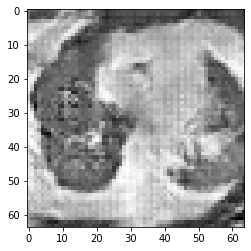

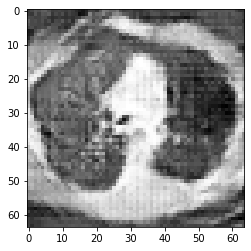

[193/300][0/6]
- D_loss : 1.1907 / G_loss : 0.5586
- D(x) : 0.5553 / D(G(z1)) : 0.4482 / D(G(z2)) : 0.5742 / d_acc : 0.8594
[193/300][1/6]
- D_loss : 1.1819 / G_loss : 0.6803
- D(x) : 0.5853 / D(G(z1)) : 0.4706 / D(G(z2)) : 0.5082 / d_acc : 0.8281
[193/300][2/6]
- D_loss : 1.2926 / G_loss : 0.3905
- D(x) : 0.4479 / D(G(z1)) : 0.3795 / D(G(z2)) : 0.6781 / d_acc : 0.5859
[193/300][3/6]
- D_loss : 1.3937 / G_loss : 0.8461
- D(x) : 0.6216 / D(G(z1)) : 0.5936 / D(G(z2)) : 0.4321 / d_acc : 0.4688
[193/300][4/6]
- D_loss : 1.3075 / G_loss : 0.4440
- D(x) : 0.4285 / D(G(z1)) : 0.3578 / D(G(z2)) : 0.6434 / d_acc : 0.5391
[193/300][5/6]
- D_loss : 1.4087 / G_loss : 0.8163
- D(x) : 0.5746 / D(G(z1)) : 0.5664 / D(G(z2)) : 0.4444 / d_acc : 0.4766


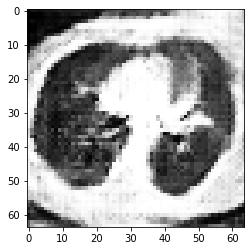

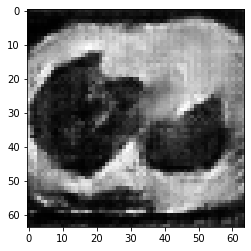

[194/300][0/6]
- D_loss : 1.3498 / G_loss : 0.3627
- D(x) : 0.4312 / D(G(z1)) : 0.3857 / D(G(z2)) : 0.6981 / d_acc : 0.5703
[194/300][1/6]
- D_loss : 1.3560 / G_loss : 0.7693
- D(x) : 0.6265 / D(G(z1)) : 0.5813 / D(G(z2)) : 0.4659 / d_acc : 0.5469
[194/300][2/6]
- D_loss : 1.4589 / G_loss : 0.4618
- D(x) : 0.3987 / D(G(z1)) : 0.4018 / D(G(z2)) : 0.6312 / d_acc : 0.5234
[194/300][3/6]
- D_loss : 1.3406 / G_loss : 0.6284
- D(x) : 0.5834 / D(G(z1)) : 0.5488 / D(G(z2)) : 0.5356 / d_acc : 0.5391
[194/300][4/6]
- D_loss : 1.3449 / G_loss : 0.5568
- D(x) : 0.4899 / D(G(z1)) : 0.4619 / D(G(z2)) : 0.5741 / d_acc : 0.5938
[194/300][5/6]
- D_loss : 1.3027 / G_loss : 0.5996
- D(x) : 0.5258 / D(G(z1)) : 0.4786 / D(G(z2)) : 0.5510 / d_acc : 0.7188


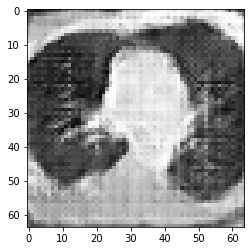

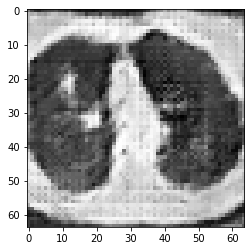

[195/300][0/6]
- D_loss : 1.1755 / G_loss : 0.6413
- D(x) : 0.5739 / D(G(z1)) : 0.4552 / D(G(z2)) : 0.5282 / d_acc : 0.8516
[195/300][1/6]
- D_loss : 1.2617 / G_loss : 0.5869
- D(x) : 0.5062 / D(G(z1)) : 0.4348 / D(G(z2)) : 0.5579 / d_acc : 0.7344
[195/300][2/6]
- D_loss : 1.2348 / G_loss : 0.5047
- D(x) : 0.5286 / D(G(z1)) : 0.4442 / D(G(z2)) : 0.6047 / d_acc : 0.7812
[195/300][3/6]
- D_loss : 1.2162 / G_loss : 0.6691
- D(x) : 0.5818 / D(G(z1)) : 0.4856 / D(G(z2)) : 0.5145 / d_acc : 0.7578
[195/300][4/6]
- D_loss : 1.2813 / G_loss : 0.4507
- D(x) : 0.4858 / D(G(z1)) : 0.4168 / D(G(z2)) : 0.6398 / d_acc : 0.6562
[195/300][5/6]
- D_loss : 1.1778 / G_loss : 0.6306
- D(x) : 0.6291 / D(G(z1)) : 0.5020 / D(G(z2)) : 0.5363 / d_acc : 0.6875


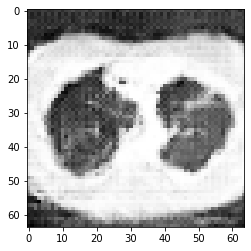

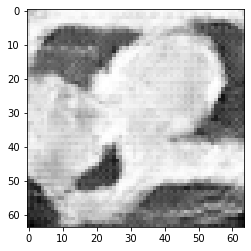

[196/300][0/6]
- D_loss : 1.1546 / G_loss : 0.5994
- D(x) : 0.5485 / D(G(z1)) : 0.4147 / D(G(z2)) : 0.5524 / d_acc : 0.8203
[196/300][1/6]
- D_loss : 1.1089 / G_loss : 0.5799
- D(x) : 0.5729 / D(G(z1)) : 0.4159 / D(G(z2)) : 0.5622 / d_acc : 0.8828
[196/300][2/6]
- D_loss : 1.1539 / G_loss : 0.3649
- D(x) : 0.5147 / D(G(z1)) : 0.3775 / D(G(z2)) : 0.6958 / d_acc : 0.8125
[196/300][3/6]
- D_loss : 1.2142 / G_loss : 0.9774
- D(x) : 0.6610 / D(G(z1)) : 0.5418 / D(G(z2)) : 0.3810 / d_acc : 0.6406
[196/300][4/6]
- D_loss : 1.3203 / G_loss : 0.2508
- D(x) : 0.3680 / D(G(z1)) : 0.2578 / D(G(z2)) : 0.7792 / d_acc : 0.5000
[196/300][5/6]
- D_loss : 1.3776 / G_loss : 0.7665
- D(x) : 0.7259 / D(G(z1)) : 0.6467 / D(G(z2)) : 0.4672 / d_acc : 0.5000


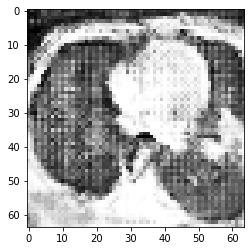

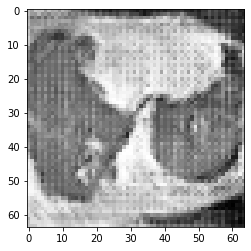

[197/300][0/6]
- D_loss : 1.4695 / G_loss : 0.4067
- D(x) : 0.3818 / D(G(z1)) : 0.3821 / D(G(z2)) : 0.6682 / d_acc : 0.5234
[197/300][1/6]
- D_loss : 1.2476 / G_loss : 0.6493
- D(x) : 0.6246 / D(G(z1)) : 0.5314 / D(G(z2)) : 0.5271 / d_acc : 0.6562
[197/300][2/6]
- D_loss : 1.2923 / G_loss : 0.4756
- D(x) : 0.4737 / D(G(z1)) : 0.4058 / D(G(z2)) : 0.6253 / d_acc : 0.6094
[197/300][3/6]
- D_loss : 1.3087 / G_loss : 0.5929
- D(x) : 0.5699 / D(G(z1)) : 0.4996 / D(G(z2)) : 0.5549 / d_acc : 0.6953
[197/300][4/6]
- D_loss : 1.2002 / G_loss : 0.5234
- D(x) : 0.5322 / D(G(z1)) : 0.4254 / D(G(z2)) : 0.5941 / d_acc : 0.7656
[197/300][5/6]
- D_loss : 1.2816 / G_loss : 0.5143
- D(x) : 0.5200 / D(G(z1)) : 0.4566 / D(G(z2)) : 0.5995 / d_acc : 0.7031


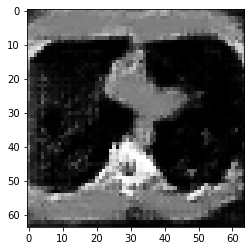

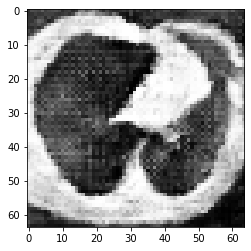

[198/300][0/6]
- D_loss : 1.1168 / G_loss : 0.6239
- D(x) : 0.5931 / D(G(z1)) : 0.4394 / D(G(z2)) : 0.5389 / d_acc : 0.8750
[198/300][1/6]
- D_loss : 1.1492 / G_loss : 0.5004
- D(x) : 0.5489 / D(G(z1)) : 0.4154 / D(G(z2)) : 0.6078 / d_acc : 0.8203
[198/300][2/6]
- D_loss : 1.0582 / G_loss : 0.6107
- D(x) : 0.6134 / D(G(z1)) : 0.4300 / D(G(z2)) : 0.5453 / d_acc : 0.9531
[198/300][3/6]
- D_loss : 1.1775 / G_loss : 0.3811
- D(x) : 0.5078 / D(G(z1)) : 0.3821 / D(G(z2)) : 0.6842 / d_acc : 0.7422
[198/300][4/6]
- D_loss : 1.1702 / G_loss : 1.0109
- D(x) : 0.6892 / D(G(z1)) : 0.5421 / D(G(z2)) : 0.3702 / d_acc : 0.6094
[198/300][5/6]
- D_loss : 1.3465 / G_loss : 0.2727
- D(x) : 0.3497 / D(G(z1)) : 0.2428 / D(G(z2)) : 0.7623 / d_acc : 0.5000


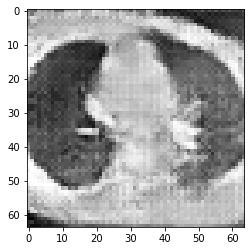

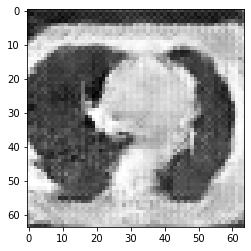

[199/300][0/6]
- D_loss : 1.2439 / G_loss : 0.8516
- D(x) : 0.7619 / D(G(z1)) : 0.6155 / D(G(z2)) : 0.4322 / d_acc : 0.5156
[199/300][1/6]
- D_loss : 1.2723 / G_loss : 0.4023
- D(x) : 0.4145 / D(G(z1)) : 0.3131 / D(G(z2)) : 0.6701 / d_acc : 0.5234
[199/300][2/6]
- D_loss : 1.1131 / G_loss : 0.5643
- D(x) : 0.6572 / D(G(z1)) : 0.4902 / D(G(z2)) : 0.5714 / d_acc : 0.7969
[199/300][3/6]
- D_loss : 1.1818 / G_loss : 0.5638
- D(x) : 0.5434 / D(G(z1)) : 0.4232 / D(G(z2)) : 0.5720 / d_acc : 0.7891
[199/300][4/6]
- D_loss : 1.0912 / G_loss : 0.4474
- D(x) : 0.5741 / D(G(z1)) : 0.4030 / D(G(z2)) : 0.6432 / d_acc : 0.8438
[199/300][5/6]
- D_loss : 1.1495 / G_loss : 0.6753
- D(x) : 0.6110 / D(G(z1)) : 0.4675 / D(G(z2)) : 0.5135 / d_acc : 0.7734


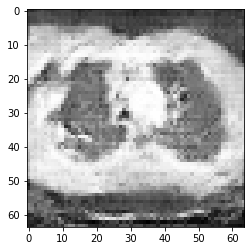

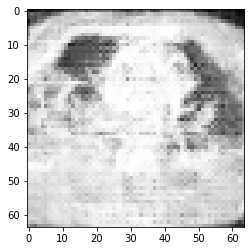

[200/300][0/6]
- D_loss : 0.9995 / G_loss : 0.4264
- D(x) : 0.5572 / D(G(z1)) : 0.3294 / D(G(z2)) : 0.6550 / d_acc : 0.8828
[200/300][1/6]
- D_loss : 0.9350 / G_loss : 0.7767
- D(x) : 0.7020 / D(G(z1)) : 0.4310 / D(G(z2)) : 0.4625 / d_acc : 0.8828
[200/300][2/6]
- D_loss : 1.2056 / G_loss : 0.3053
- D(x) : 0.4338 / D(G(z1)) : 0.2917 / D(G(z2)) : 0.7381 / d_acc : 0.6016
[200/300][3/6]
- D_loss : 1.1965 / G_loss : 0.7749
- D(x) : 0.6988 / D(G(z1)) : 0.5603 / D(G(z2)) : 0.4634 / d_acc : 0.6016
[200/300][4/6]
- D_loss : 1.1774 / G_loss : 0.2862
- D(x) : 0.4510 / D(G(z1)) : 0.3040 / D(G(z2)) : 0.7525 / d_acc : 0.5938
[200/300][5/6]
- D_loss : 1.3424 / G_loss : 0.8064
- D(x) : 0.6340 / D(G(z1)) : 0.5810 / D(G(z2)) : 0.4728 / d_acc : 0.5234


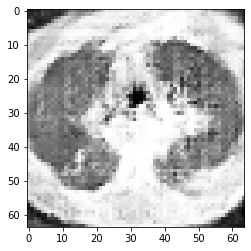

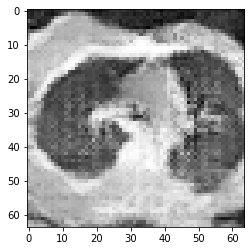

[201/300][0/6]
- D_loss : 1.2288 / G_loss : 0.2581
- D(x) : 0.4379 / D(G(z1)) : 0.2985 / D(G(z2)) : 0.7739 / d_acc : 0.6328
[201/300][1/6]
- D_loss : 1.2931 / G_loss : 0.9629
- D(x) : 0.7675 / D(G(z1)) : 0.6286 / D(G(z2)) : 0.3861 / d_acc : 0.5000
[201/300][2/6]
- D_loss : 1.4070 / G_loss : 0.3219
- D(x) : 0.3533 / D(G(z1)) : 0.2655 / D(G(z2)) : 0.7263 / d_acc : 0.5234
[201/300][3/6]
- D_loss : 1.2679 / G_loss : 0.5757
- D(x) : 0.6668 / D(G(z1)) : 0.5682 / D(G(z2)) : 0.5649 / d_acc : 0.5703
[201/300][4/6]
- D_loss : 1.2300 / G_loss : 0.5013
- D(x) : 0.5088 / D(G(z1)) : 0.4125 / D(G(z2)) : 0.6074 / d_acc : 0.7031
[201/300][5/6]
- D_loss : 1.2059 / G_loss : 0.5004
- D(x) : 0.5647 / D(G(z1)) : 0.4556 / D(G(z2)) : 0.6099 / d_acc : 0.7422


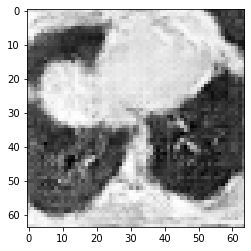

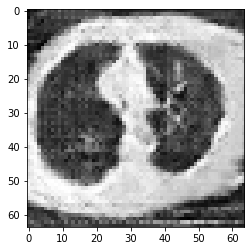

[202/300][0/6]
- D_loss : 1.0677 / G_loss : 0.5366
- D(x) : 0.5888 / D(G(z1)) : 0.4020 / D(G(z2)) : 0.5880 / d_acc : 0.8438
[202/300][1/6]
- D_loss : 1.0534 / G_loss : 0.4662
- D(x) : 0.5776 / D(G(z1)) : 0.3770 / D(G(z2)) : 0.6305 / d_acc : 0.9062
[202/300][2/6]
- D_loss : 1.0139 / G_loss : 0.4729
- D(x) : 0.6135 / D(G(z1)) : 0.3988 / D(G(z2)) : 0.6249 / d_acc : 0.9297
[202/300][3/6]
- D_loss : 1.0172 / G_loss : 0.7856
- D(x) : 0.6407 / D(G(z1)) : 0.4265 / D(G(z2)) : 0.4587 / d_acc : 0.9141
[202/300][4/6]
- D_loss : 1.0490 / G_loss : 0.2950
- D(x) : 0.4825 / D(G(z1)) : 0.2562 / D(G(z2)) : 0.7454 / d_acc : 0.7188
[202/300][5/6]
- D_loss : 1.0803 / G_loss : 0.7278
- D(x) : 0.7727 / D(G(z1)) : 0.5522 / D(G(z2)) : 0.4865 / d_acc : 0.6094


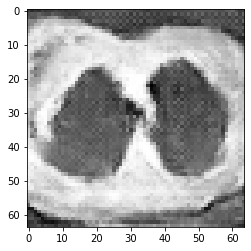

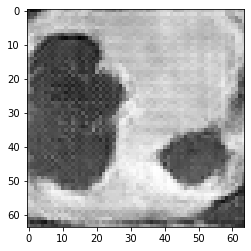

[203/300][0/6]
- D_loss : 1.0223 / G_loss : 0.4738
- D(x) : 0.5189 / D(G(z1)) : 0.2906 / D(G(z2)) : 0.6247 / d_acc : 0.7812
[203/300][1/6]
- D_loss : 0.9849 / G_loss : 0.5053
- D(x) : 0.6401 / D(G(z1)) : 0.4064 / D(G(z2)) : 0.6056 / d_acc : 0.9141
[203/300][2/6]
- D_loss : 1.0974 / G_loss : 0.3879
- D(x) : 0.5626 / D(G(z1)) : 0.3918 / D(G(z2)) : 0.6804 / d_acc : 0.8438
[203/300][3/6]
- D_loss : 1.0823 / G_loss : 0.6723
- D(x) : 0.6457 / D(G(z1)) : 0.4677 / D(G(z2)) : 0.5154 / d_acc : 0.8359
[203/300][4/6]
- D_loss : 1.0307 / G_loss : 0.3188
- D(x) : 0.5323 / D(G(z1)) : 0.3080 / D(G(z2)) : 0.7293 / d_acc : 0.8125
[203/300][5/6]
- D_loss : 1.0685 / G_loss : 0.6633
- D(x) : 0.7018 / D(G(z1)) : 0.4945 / D(G(z2)) : 0.5232 / d_acc : 0.7500


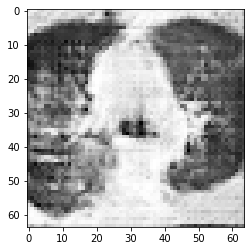

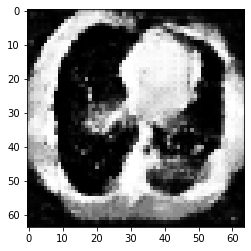

[204/300][0/6]
- D_loss : 0.9928 / G_loss : 0.2718
- D(x) : 0.5120 / D(G(z1)) : 0.2457 / D(G(z2)) : 0.7638 / d_acc : 0.7656
[204/300][1/6]
- D_loss : 1.0973 / G_loss : 0.8787
- D(x) : 0.7494 / D(G(z1)) : 0.5374 / D(G(z2)) : 0.4202 / d_acc : 0.6875
[204/300][2/6]
- D_loss : 1.2326 / G_loss : 0.2327
- D(x) : 0.3856 / D(G(z1)) : 0.2134 / D(G(z2)) : 0.7948 / d_acc : 0.5547
[204/300][3/6]
- D_loss : 1.2240 / G_loss : 0.8371
- D(x) : 0.7983 / D(G(z1)) : 0.6092 / D(G(z2)) : 0.4424 / d_acc : 0.5703
[204/300][4/6]
- D_loss : 1.2437 / G_loss : 0.3040
- D(x) : 0.4026 / D(G(z1)) : 0.2628 / D(G(z2)) : 0.7392 / d_acc : 0.5703
[204/300][5/6]
- D_loss : 1.1111 / G_loss : 0.4430
- D(x) : 0.7022 / D(G(z1)) : 0.5166 / D(G(z2)) : 0.6448 / d_acc : 0.6719


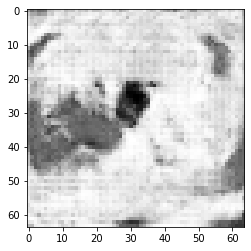

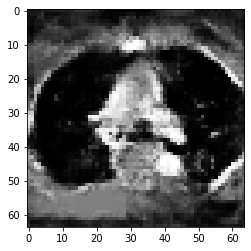

[205/300][0/6]
- D_loss : 0.9551 / G_loss : 0.5961
- D(x) : 0.6592 / D(G(z1)) : 0.4037 / D(G(z2)) : 0.5535 / d_acc : 0.9062
[205/300][1/6]
- D_loss : 1.0102 / G_loss : 0.3433
- D(x) : 0.5175 / D(G(z1)) : 0.2766 / D(G(z2)) : 0.7113 / d_acc : 0.7578
[205/300][2/6]
- D_loss : 1.0337 / G_loss : 0.6620
- D(x) : 0.7039 / D(G(z1)) : 0.4836 / D(G(z2)) : 0.5198 / d_acc : 0.8047
[205/300][3/6]
- D_loss : 1.0493 / G_loss : 0.2918
- D(x) : 0.4912 / D(G(z1)) : 0.2761 / D(G(z2)) : 0.7488 / d_acc : 0.7188
[205/300][4/6]
- D_loss : 0.9748 / G_loss : 0.8709
- D(x) : 0.7830 / D(G(z1)) : 0.5065 / D(G(z2)) : 0.4237 / d_acc : 0.7266
[205/300][5/6]
- D_loss : 1.1225 / G_loss : 0.3372
- D(x) : 0.4227 / D(G(z1)) : 0.2052 / D(G(z2)) : 0.7169 / d_acc : 0.6094


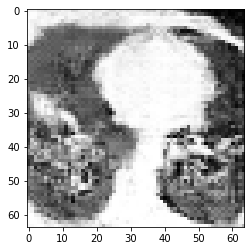

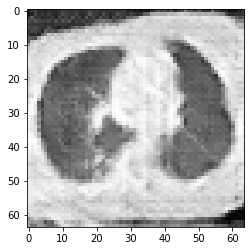

[206/300][0/6]
- D_loss : 1.0199 / G_loss : 0.6804
- D(x) : 0.7534 / D(G(z1)) : 0.5038 / D(G(z2)) : 0.5158 / d_acc : 0.7578
[206/300][1/6]
- D_loss : 0.9782 / G_loss : 0.3360
- D(x) : 0.5394 / D(G(z1)) : 0.2794 / D(G(z2)) : 0.7162 / d_acc : 0.8359
[206/300][2/6]
- D_loss : 0.9488 / G_loss : 0.5939
- D(x) : 0.7445 / D(G(z1)) : 0.4686 / D(G(z2)) : 0.5570 / d_acc : 0.8438
[206/300][3/6]
- D_loss : 0.8100 / G_loss : 0.4259
- D(x) : 0.6045 / D(G(z1)) : 0.2506 / D(G(z2)) : 0.6556 / d_acc : 0.9062
[206/300][4/6]
- D_loss : 1.0229 / G_loss : 0.4181
- D(x) : 0.6095 / D(G(z1)) : 0.3964 / D(G(z2)) : 0.6609 / d_acc : 0.8438
[206/300][5/6]
- D_loss : 0.8888 / G_loss : 0.5238
- D(x) : 0.6511 / D(G(z1)) : 0.3525 / D(G(z2)) : 0.5976 / d_acc : 0.9453


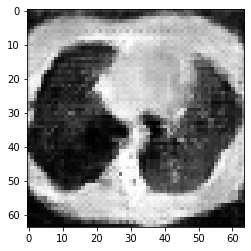

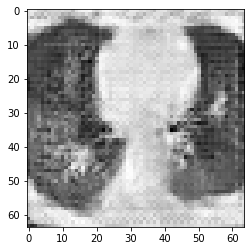

[207/300][0/6]
- D_loss : 0.7351 / G_loss : 0.6565
- D(x) : 0.7385 / D(G(z1)) : 0.3411 / D(G(z2)) : 0.5262 / d_acc : 0.9844
[207/300][1/6]
- D_loss : 0.8208 / G_loss : 0.2808
- D(x) : 0.5732 / D(G(z1)) : 0.2086 / D(G(z2)) : 0.7599 / d_acc : 0.8281
[207/300][2/6]
- D_loss : 0.9047 / G_loss : 0.7263
- D(x) : 0.7985 / D(G(z1)) : 0.4666 / D(G(z2)) : 0.4916 / d_acc : 0.7500
[207/300][3/6]
- D_loss : 0.8903 / G_loss : 0.3179
- D(x) : 0.5337 / D(G(z1)) : 0.2035 / D(G(z2)) : 0.7296 / d_acc : 0.7891
[207/300][4/6]
- D_loss : 0.7887 / G_loss : 0.4865
- D(x) : 0.7546 / D(G(z1)) : 0.3864 / D(G(z2)) : 0.6212 / d_acc : 0.9531
[207/300][5/6]
- D_loss : 0.6980 / G_loss : 0.4642
- D(x) : 0.7292 / D(G(z1)) : 0.3042 / D(G(z2)) : 0.6331 / d_acc : 0.9844


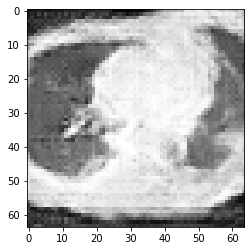

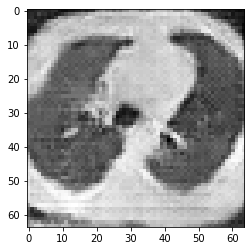

[208/300][0/6]
- D_loss : 0.6667 / G_loss : 0.3359
- D(x) : 0.6806 / D(G(z1)) : 0.2336 / D(G(z2)) : 0.7168 / d_acc : 0.9844
[208/300][1/6]
- D_loss : 0.7468 / G_loss : 0.7731
- D(x) : 0.7869 / D(G(z1)) : 0.3897 / D(G(z2)) : 0.4671 / d_acc : 0.9688
[208/300][2/6]
- D_loss : 0.9305 / G_loss : 0.1889
- D(x) : 0.4742 / D(G(z1)) : 0.1381 / D(G(z2)) : 0.8289 / d_acc : 0.6797
[208/300][3/6]
- D_loss : 1.0642 / G_loss : 0.9666
- D(x) : 0.8622 / D(G(z1)) : 0.5836 / D(G(z2)) : 0.3967 / d_acc : 0.6094
[208/300][4/6]
- D_loss : 1.1001 / G_loss : 0.1922
- D(x) : 0.4169 / D(G(z1)) : 0.1596 / D(G(z2)) : 0.8261 / d_acc : 0.6094
[208/300][5/6]
- D_loss : 1.1006 / G_loss : 0.7904
- D(x) : 0.8579 / D(G(z1)) : 0.5901 / D(G(z2)) : 0.4642 / d_acc : 0.6016


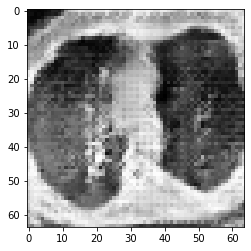

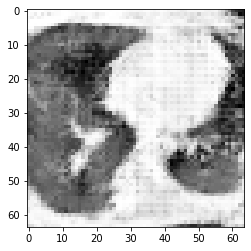

[209/300][0/6]
- D_loss : 1.1491 / G_loss : 0.2380
- D(x) : 0.4279 / D(G(z1)) : 0.2055 / D(G(z2)) : 0.7904 / d_acc : 0.6094
[209/300][1/6]
- D_loss : 0.9493 / G_loss : 0.6323
- D(x) : 0.8139 / D(G(z1)) : 0.5059 / D(G(z2)) : 0.5391 / d_acc : 0.7578
[209/300][2/6]
- D_loss : 0.7898 / G_loss : 0.4749
- D(x) : 0.6465 / D(G(z1)) : 0.2800 / D(G(z2)) : 0.6271 / d_acc : 0.9297
[209/300][3/6]
- D_loss : 0.7952 / G_loss : 0.4688
- D(x) : 0.6578 / D(G(z1)) : 0.2959 / D(G(z2)) : 0.6293 / d_acc : 0.9531
[209/300][4/6]
- D_loss : 0.8333 / G_loss : 0.4500
- D(x) : 0.6450 / D(G(z1)) : 0.3094 / D(G(z2)) : 0.6418 / d_acc : 0.9766
[209/300][5/6]
- D_loss : 0.8007 / G_loss : 0.4425
- D(x) : 0.6715 / D(G(z1)) : 0.3113 / D(G(z2)) : 0.6485 / d_acc : 0.9453


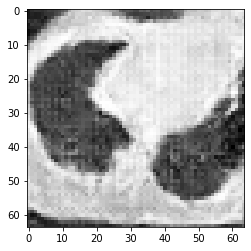

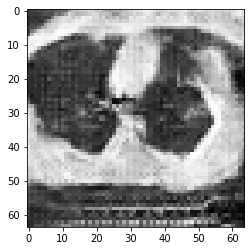

[210/300][0/6]
- D_loss : 0.6604 / G_loss : 0.7150
- D(x) : 0.7793 / D(G(z1)) : 0.3263 / D(G(z2)) : 0.4994 / d_acc : 0.9766
[210/300][1/6]
- D_loss : 0.5979 / G_loss : 0.3363
- D(x) : 0.6831 / D(G(z1)) : 0.1811 / D(G(z2)) : 0.7176 / d_acc : 0.9766
[210/300][2/6]
- D_loss : 0.6752 / G_loss : 0.5580
- D(x) : 0.7729 / D(G(z1)) : 0.3293 / D(G(z2)) : 0.5776 / d_acc : 0.9766
[210/300][3/6]
- D_loss : 0.6884 / G_loss : 0.4182
- D(x) : 0.6699 / D(G(z1)) : 0.2323 / D(G(z2)) : 0.6610 / d_acc : 0.9766
[210/300][4/6]
- D_loss : 0.6796 / G_loss : 0.6784
- D(x) : 0.7546 / D(G(z1)) : 0.3164 / D(G(z2)) : 0.5212 / d_acc : 0.9844
[210/300][5/6]
- D_loss : 0.6502 / G_loss : 0.4336
- D(x) : 0.6924 / D(G(z1)) : 0.2264 / D(G(z2)) : 0.6555 / d_acc : 0.9766


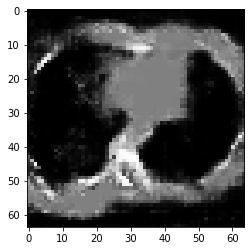

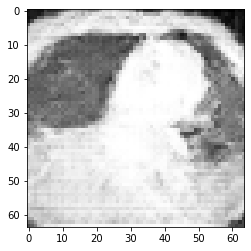

[211/300][0/6]
- D_loss : 0.6529 / G_loss : 0.3944
- D(x) : 0.7206 / D(G(z1)) : 0.2607 / D(G(z2)) : 0.6774 / d_acc : 0.9766
[211/300][1/6]
- D_loss : 0.5387 / G_loss : 0.4159
- D(x) : 0.7817 / D(G(z1)) : 0.2445 / D(G(z2)) : 0.6634 / d_acc : 1.0000
[211/300][2/6]
- D_loss : 0.6007 / G_loss : 0.8530
- D(x) : 0.8089 / D(G(z1)) : 0.3108 / D(G(z2)) : 0.4332 / d_acc : 0.9922
[211/300][3/6]
- D_loss : 1.0359 / G_loss : 0.1613
- D(x) : 0.4401 / D(G(z1)) : 0.1285 / D(G(z2)) : 0.8523 / d_acc : 0.6484
[211/300][4/6]
- D_loss : 1.1564 / G_loss : 1.2065
- D(x) : 0.9218 / D(G(z1)) : 0.6176 / D(G(z2)) : 0.3202 / d_acc : 0.6328
[211/300][5/6]
- D_loss : 1.2748 / G_loss : 0.2027
- D(x) : 0.3303 / D(G(z1)) : 0.1137 / D(G(z2)) : 0.8211 / d_acc : 0.5312


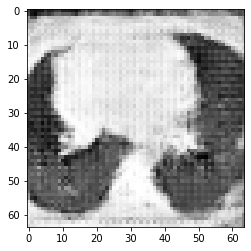

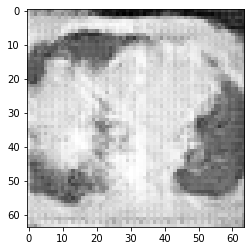

[212/300][0/6]
- D_loss : 1.0073 / G_loss : 0.7793
- D(x) : 0.8360 / D(G(z1)) : 0.5115 / D(G(z2)) : 0.4886 / d_acc : 0.7422
[212/300][1/6]
- D_loss : 1.3694 / G_loss : 0.1704
- D(x) : 0.3881 / D(G(z1)) : 0.2465 / D(G(z2)) : 0.8451 / d_acc : 0.5859
[212/300][2/6]
- D_loss : 1.0601 / G_loss : 0.5522
- D(x) : 0.8492 / D(G(z1)) : 0.5700 / D(G(z2)) : 0.5818 / d_acc : 0.6250
[212/300][3/6]
- D_loss : 0.8646 / G_loss : 0.2152
- D(x) : 0.6033 / D(G(z1)) : 0.2577 / D(G(z2)) : 0.8091 / d_acc : 0.9141
[212/300][4/6]
- D_loss : 1.0536 / G_loss : 0.4529
- D(x) : 0.6903 / D(G(z1)) : 0.4699 / D(G(z2)) : 0.6421 / d_acc : 0.7578
[212/300][5/6]
- D_loss : 1.0025 / G_loss : 0.3854
- D(x) : 0.5740 / D(G(z1)) : 0.3279 / D(G(z2)) : 0.6853 / d_acc : 0.8203


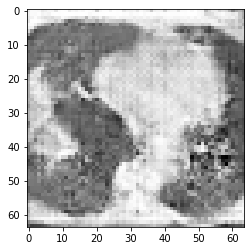

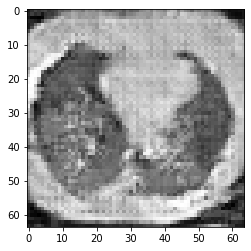

[213/300][0/6]
- D_loss : 0.7017 / G_loss : 0.4804
- D(x) : 0.7371 / D(G(z1)) : 0.3091 / D(G(z2)) : 0.6227 / d_acc : 0.9375
[213/300][1/6]
- D_loss : 0.6505 / G_loss : 0.3543
- D(x) : 0.7019 / D(G(z1)) : 0.2395 / D(G(z2)) : 0.7052 / d_acc : 0.9766
[213/300][2/6]
- D_loss : 0.7808 / G_loss : 0.4290
- D(x) : 0.6884 / D(G(z1)) : 0.3174 / D(G(z2)) : 0.6560 / d_acc : 0.9531
[213/300][3/6]
- D_loss : 0.7348 / G_loss : 0.4752
- D(x) : 0.7044 / D(G(z1)) : 0.2965 / D(G(z2)) : 0.6270 / d_acc : 0.9688
[213/300][4/6]
- D_loss : 0.5502 / G_loss : 0.3848
- D(x) : 0.7337 / D(G(z1)) : 0.1988 / D(G(z2)) : 0.6861 / d_acc : 0.9844
[213/300][5/6]
- D_loss : 0.7431 / G_loss : 0.8432
- D(x) : 0.7949 / D(G(z1)) : 0.3843 / D(G(z2)) : 0.4524 / d_acc : 0.8828


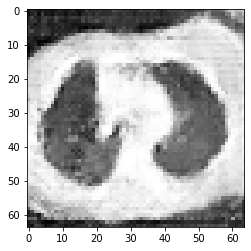

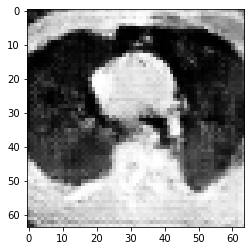

[214/300][0/6]
- D_loss : 0.6318 / G_loss : 0.2854
- D(x) : 0.6117 / D(G(z1)) : 0.1025 / D(G(z2)) : 0.7545 / d_acc : 0.9062
[214/300][1/6]
- D_loss : 0.6385 / G_loss : 0.7592
- D(x) : 0.9119 / D(G(z1)) : 0.4016 / D(G(z2)) : 0.4911 / d_acc : 0.8750
[214/300][2/6]
- D_loss : 0.7021 / G_loss : 0.3599
- D(x) : 0.6083 / D(G(z1)) : 0.1496 / D(G(z2)) : 0.7014 / d_acc : 0.8750
[214/300][3/6]
- D_loss : 0.5679 / G_loss : 0.3957
- D(x) : 0.8121 / D(G(z1)) : 0.2871 / D(G(z2)) : 0.6817 / d_acc : 0.9766
[214/300][4/6]
- D_loss : 0.5786 / G_loss : 0.5065
- D(x) : 0.7602 / D(G(z1)) : 0.2487 / D(G(z2)) : 0.6093 / d_acc : 0.9844
[214/300][5/6]
- D_loss : 0.5205 / G_loss : 0.4978
- D(x) : 0.7825 / D(G(z1)) : 0.2250 / D(G(z2)) : 0.6164 / d_acc : 0.9922


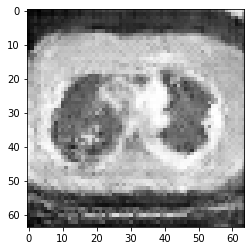

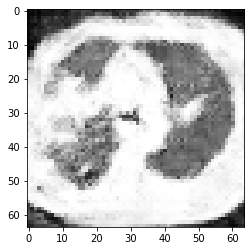

[215/300][0/6]
- D_loss : 0.4421 / G_loss : 0.4500
- D(x) : 0.7751 / D(G(z1)) : 0.1594 / D(G(z2)) : 0.6429 / d_acc : 1.0000
[215/300][1/6]
- D_loss : 0.4659 / G_loss : 0.3929
- D(x) : 0.7896 / D(G(z1)) : 0.1961 / D(G(z2)) : 0.6788 / d_acc : 1.0000
[215/300][2/6]
- D_loss : 0.5027 / G_loss : 0.4135
- D(x) : 0.7947 / D(G(z1)) : 0.2293 / D(G(z2)) : 0.6652 / d_acc : 1.0000
[215/300][3/6]
- D_loss : 0.5249 / G_loss : 0.2979
- D(x) : 0.7354 / D(G(z1)) : 0.1756 / D(G(z2)) : 0.7459 / d_acc : 0.9922
[215/300][4/6]
- D_loss : 0.4635 / G_loss : 0.7115
- D(x) : 0.8926 / D(G(z1)) : 0.2843 / D(G(z2)) : 0.5081 / d_acc : 0.9609
[215/300][5/6]
- D_loss : 0.4697 / G_loss : 0.2856
- D(x) : 0.7277 / D(G(z1)) : 0.1257 / D(G(z2)) : 0.7544 / d_acc : 0.9766


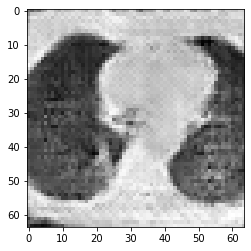

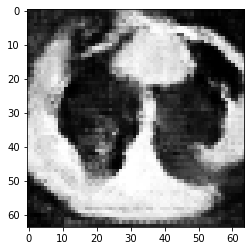

[216/300][0/6]
- D_loss : 0.6755 / G_loss : 0.8444
- D(x) : 0.8194 / D(G(z1)) : 0.3562 / D(G(z2)) : 0.4639 / d_acc : 0.9609
[216/300][1/6]
- D_loss : 0.5887 / G_loss : 0.2986
- D(x) : 0.6768 / D(G(z1)) : 0.1464 / D(G(z2)) : 0.7460 / d_acc : 0.9375
[216/300][2/6]
- D_loss : 0.4921 / G_loss : 0.3092
- D(x) : 0.7891 / D(G(z1)) : 0.2127 / D(G(z2)) : 0.7377 / d_acc : 0.9922
[216/300][3/6]
- D_loss : 0.4374 / G_loss : 0.8145
- D(x) : 0.9093 / D(G(z1)) : 0.2781 / D(G(z2)) : 0.4569 / d_acc : 0.9844
[216/300][4/6]
- D_loss : 0.4960 / G_loss : 0.2297
- D(x) : 0.6620 / D(G(z1)) : 0.0640 / D(G(z2)) : 0.7973 / d_acc : 0.9609
[216/300][5/6]
- D_loss : 0.4806 / G_loss : 0.3864
- D(x) : 0.8601 / D(G(z1)) : 0.2636 / D(G(z2)) : 0.6833 / d_acc : 0.9766


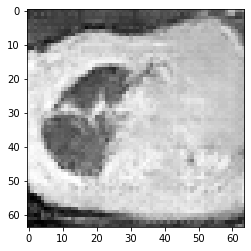

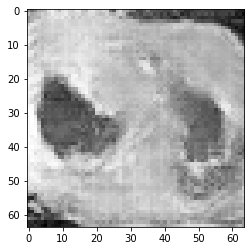

[217/300][0/6]
- D_loss : 0.4804 / G_loss : 0.6343
- D(x) : 0.8328 / D(G(z1)) : 0.2456 / D(G(z2)) : 0.5433 / d_acc : 1.0000
[217/300][1/6]
- D_loss : 0.3569 / G_loss : 0.2979
- D(x) : 0.7828 / D(G(z1)) : 0.0919 / D(G(z2)) : 0.7496 / d_acc : 0.9922
[217/300][2/6]
- D_loss : 0.3756 / G_loss : 0.4720
- D(x) : 0.8790 / D(G(z1)) : 0.2082 / D(G(z2)) : 0.6327 / d_acc : 0.9922
[217/300][3/6]
- D_loss : 0.3363 / G_loss : 0.4599
- D(x) : 0.8507 / D(G(z1)) : 0.1513 / D(G(z2)) : 0.6370 / d_acc : 0.9922
[217/300][4/6]
- D_loss : 0.4174 / G_loss : 0.3145
- D(x) : 0.7852 / D(G(z1)) : 0.1491 / D(G(z2)) : 0.7336 / d_acc : 0.9844
[217/300][5/6]
- D_loss : 0.3092 / G_loss : 0.3101
- D(x) : 0.8485 / D(G(z1)) : 0.1291 / D(G(z2)) : 0.7391 / d_acc : 1.0000


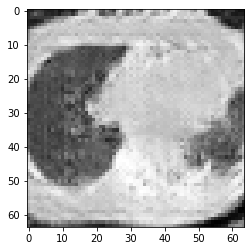

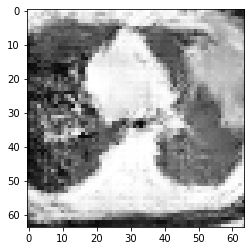

[218/300][0/6]
- D_loss : 0.2961 / G_loss : 0.5522
- D(x) : 0.9314 / D(G(z1)) : 0.1944 / D(G(z2)) : 0.5857 / d_acc : 0.9922
[218/300][1/6]
- D_loss : 0.2385 / G_loss : 0.5913
- D(x) : 0.8786 / D(G(z1)) : 0.0978 / D(G(z2)) : 0.5649 / d_acc : 0.9922
[218/300][2/6]
- D_loss : 0.5290 / G_loss : 0.1019
- D(x) : 0.6422 / D(G(z1)) : 0.0522 / D(G(z2)) : 0.9037 / d_acc : 0.9141
[218/300][3/6]
- D_loss : 0.8794 / G_loss : 1.4633
- D(x) : 0.9659 / D(G(z1)) : 0.5271 / D(G(z2)) : 0.2600 / d_acc : 0.7266
[218/300][4/6]
- D_loss : 0.7694 / G_loss : 0.1855
- D(x) : 0.5125 / D(G(z1)) : 0.0447 / D(G(z2)) : 0.8323 / d_acc : 0.7734
[218/300][5/6]
- D_loss : 0.6356 / G_loss : 0.7508
- D(x) : 0.9212 / D(G(z1)) : 0.3882 / D(G(z2)) : 0.4892 / d_acc : 0.8359


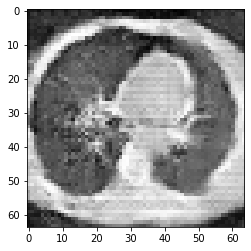

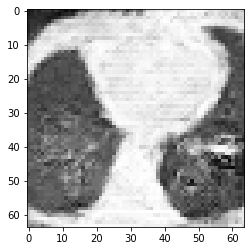

[219/300][0/6]
- D_loss : 0.5005 / G_loss : 0.2870
- D(x) : 0.7166 / D(G(z1)) : 0.1191 / D(G(z2)) : 0.7660 / d_acc : 0.9297
[219/300][1/6]
- D_loss : 0.5569 / G_loss : 0.4417
- D(x) : 0.8482 / D(G(z1)) : 0.2701 / D(G(z2)) : 0.6516 / d_acc : 0.9453
[219/300][2/6]
- D_loss : 0.5116 / G_loss : 0.7137
- D(x) : 0.8031 / D(G(z1)) : 0.2191 / D(G(z2)) : 0.5605 / d_acc : 0.9688
[219/300][3/6]
- D_loss : 0.5088 / G_loss : 0.1983
- D(x) : 0.7175 / D(G(z1)) : 0.1020 / D(G(z2)) : 0.8222 / d_acc : 0.9297
[219/300][4/6]
- D_loss : 0.5563 / G_loss : 0.2540
- D(x) : 0.7872 / D(G(z1)) : 0.2485 / D(G(z2)) : 0.7778 / d_acc : 0.9609
[219/300][5/6]
- D_loss : 0.3677 / G_loss : 0.7310
- D(x) : 0.9124 / D(G(z1)) : 0.2289 / D(G(z2)) : 0.4975 / d_acc : 0.9922


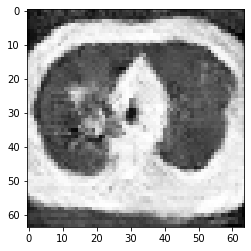

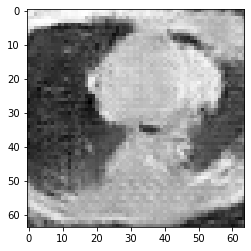

[220/300][0/6]
- D_loss : 0.3192 / G_loss : 0.2880
- D(x) : 0.8013 / D(G(z1)) : 0.0850 / D(G(z2)) : 0.7535 / d_acc : 1.0000
[220/300][1/6]
- D_loss : 0.3662 / G_loss : 0.3863
- D(x) : 0.8652 / D(G(z1)) : 0.1874 / D(G(z2)) : 0.6878 / d_acc : 0.9922
[220/300][2/6]
- D_loss : 0.2834 / G_loss : 0.4507
- D(x) : 0.8869 / D(G(z1)) : 0.1447 / D(G(z2)) : 0.6468 / d_acc : 1.0000
[220/300][3/6]
- D_loss : 0.4271 / G_loss : 0.2694
- D(x) : 0.7642 / D(G(z1)) : 0.1224 / D(G(z2)) : 0.7669 / d_acc : 0.9531
[220/300][4/6]
- D_loss : 0.2704 / G_loss : 0.4181
- D(x) : 0.9014 / D(G(z1)) : 0.1449 / D(G(z2)) : 0.6655 / d_acc : 1.0000
[220/300][5/6]
- D_loss : 0.3752 / G_loss : 0.3883
- D(x) : 0.8230 / D(G(z1)) : 0.1544 / D(G(z2)) : 0.6835 / d_acc : 1.0000


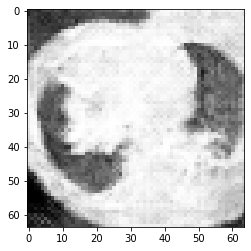

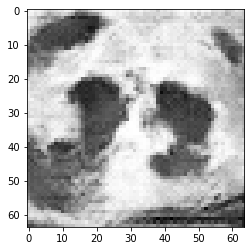

[221/300][0/6]
- D_loss : 0.2734 / G_loss : 0.6677
- D(x) : 0.9283 / D(G(z1)) : 0.1729 / D(G(z2)) : 0.5235 / d_acc : 1.0000
[221/300][1/6]
- D_loss : 0.3551 / G_loss : 0.2374
- D(x) : 0.7610 / D(G(z1)) : 0.0603 / D(G(z2)) : 0.7918 / d_acc : 0.9766
[221/300][2/6]
- D_loss : 0.3643 / G_loss : 0.6123
- D(x) : 0.9320 / D(G(z1)) : 0.2457 / D(G(z2)) : 0.5560 / d_acc : 0.9922
[221/300][3/6]
- D_loss : 0.2773 / G_loss : 0.3947
- D(x) : 0.8414 / D(G(z1)) : 0.0853 / D(G(z2)) : 0.6818 / d_acc : 0.9844
[221/300][4/6]
- D_loss : 0.2482 / G_loss : 0.3284
- D(x) : 0.8810 / D(G(z1)) : 0.1081 / D(G(z2)) : 0.7263 / d_acc : 1.0000
[221/300][5/6]
- D_loss : 0.3018 / G_loss : 0.4936
- D(x) : 0.8882 / D(G(z1)) : 0.1512 / D(G(z2)) : 0.6265 / d_acc : 0.9844


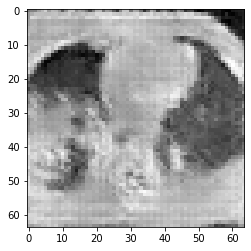

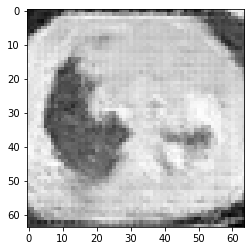

[222/300][0/6]
- D_loss : 0.2998 / G_loss : 0.4271
- D(x) : 0.8610 / D(G(z1)) : 0.1288 / D(G(z2)) : 0.6580 / d_acc : 0.9844
[222/300][1/6]
- D_loss : 0.2014 / G_loss : 0.3830
- D(x) : 0.8945 / D(G(z1)) : 0.0818 / D(G(z2)) : 0.6903 / d_acc : 1.0000
[222/300][2/6]
- D_loss : 0.2114 / G_loss : 0.4255
- D(x) : 0.9112 / D(G(z1)) : 0.1073 / D(G(z2)) : 0.6621 / d_acc : 1.0000
[222/300][3/6]
- D_loss : 0.2461 / G_loss : 0.3490
- D(x) : 0.8671 / D(G(z1)) : 0.0942 / D(G(z2)) : 0.7151 / d_acc : 1.0000
[222/300][4/6]
- D_loss : 0.1814 / G_loss : 0.4821
- D(x) : 0.9336 / D(G(z1)) : 0.1015 / D(G(z2)) : 0.6249 / d_acc : 1.0000
[222/300][5/6]
- D_loss : 0.2298 / G_loss : 0.3683
- D(x) : 0.8758 / D(G(z1)) : 0.0856 / D(G(z2)) : 0.6986 / d_acc : 0.9922


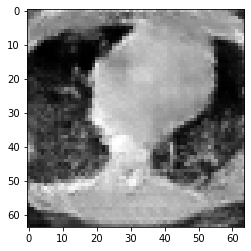

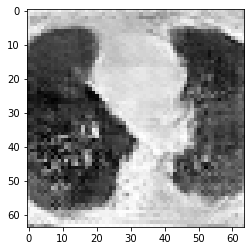

[223/300][0/6]
- D_loss : 0.2423 / G_loss : 0.9090
- D(x) : 0.9361 / D(G(z1)) : 0.1532 / D(G(z2)) : 0.4429 / d_acc : 0.9922
[223/300][1/6]
- D_loss : 0.2926 / G_loss : 0.2139
- D(x) : 0.7937 / D(G(z1)) : 0.0470 / D(G(z2)) : 0.8092 / d_acc : 0.9922
[223/300][2/6]
- D_loss : 0.2971 / G_loss : 1.0085
- D(x) : 0.9722 / D(G(z1)) : 0.2192 / D(G(z2)) : 0.3888 / d_acc : 0.9766
[223/300][3/6]
- D_loss : 0.3271 / G_loss : 0.1844
- D(x) : 0.7600 / D(G(z1)) : 0.0325 / D(G(z2)) : 0.8331 / d_acc : 0.9688
[223/300][4/6]
- D_loss : 0.2975 / G_loss : 0.5890
- D(x) : 0.9409 / D(G(z1)) : 0.2027 / D(G(z2)) : 0.5692 / d_acc : 1.0000
[223/300][5/6]
- D_loss : 0.2676 / G_loss : 0.5154
- D(x) : 0.8743 / D(G(z1)) : 0.0988 / D(G(z2)) : 0.6072 / d_acc : 0.9922


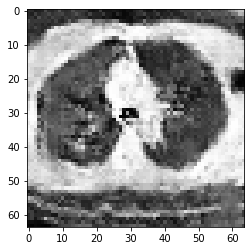

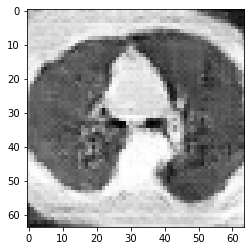

[224/300][0/6]
- D_loss : 0.1967 / G_loss : 0.5887
- D(x) : 0.9266 / D(G(z1)) : 0.1075 / D(G(z2)) : 0.5676 / d_acc : 0.9922
[224/300][1/6]
- D_loss : 0.1868 / G_loss : 0.3972
- D(x) : 0.8834 / D(G(z1)) : 0.0579 / D(G(z2)) : 0.6829 / d_acc : 1.0000
[224/300][2/6]
- D_loss : 0.2037 / G_loss : 0.2836
- D(x) : 0.8906 / D(G(z1)) : 0.0794 / D(G(z2)) : 0.7561 / d_acc : 1.0000
[224/300][3/6]
- D_loss : 0.2286 / G_loss : 0.7921
- D(x) : 0.9460 / D(G(z1)) : 0.1541 / D(G(z2)) : 0.4761 / d_acc : 1.0000
[224/300][4/6]
- D_loss : 0.2076 / G_loss : 0.4472
- D(x) : 0.8591 / D(G(z1)) : 0.0469 / D(G(z2)) : 0.6509 / d_acc : 1.0000
[224/300][5/6]
- D_loss : 0.1513 / G_loss : 0.4379
- D(x) : 0.9418 / D(G(z1)) : 0.0830 / D(G(z2)) : 0.6523 / d_acc : 1.0000


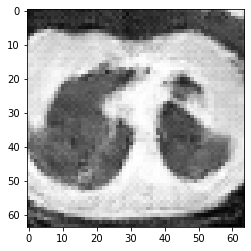

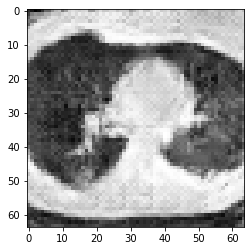

[225/300][0/6]
- D_loss : 0.1363 / G_loss : 0.7989
- D(x) : 0.9711 / D(G(z1)) : 0.0987 / D(G(z2)) : 0.4768 / d_acc : 1.0000
[225/300][1/6]
- D_loss : 0.3028 / G_loss : 0.1785
- D(x) : 0.7795 / D(G(z1)) : 0.0346 / D(G(z2)) : 0.8380 / d_acc : 0.9844
[225/300][2/6]
- D_loss : 0.4614 / G_loss : 2.8126
- D(x) : 0.9804 / D(G(z1)) : 0.3337 / D(G(z2)) : 0.0892 / d_acc : 0.9219
[225/300][3/6]
- D_loss : 0.5787 / G_loss : 0.3146
- D(x) : 0.5930 / D(G(z1)) : 0.0090 / D(G(z2)) : 0.7388 / d_acc : 0.8359
[225/300][4/6]
- D_loss : 0.4210 / G_loss : 0.4395
- D(x) : 0.8681 / D(G(z1)) : 0.2268 / D(G(z2)) : 0.6632 / d_acc : 0.9688
[225/300][5/6]
- D_loss : 0.6396 / G_loss : 0.2521
- D(x) : 0.7193 / D(G(z1)) : 0.2216 / D(G(z2)) : 0.7925 / d_acc : 0.8906


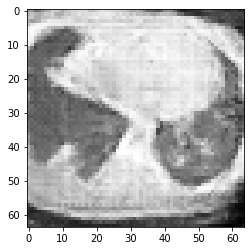

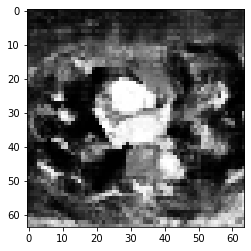

[226/300][0/6]
- D_loss : 0.5972 / G_loss : 2.3821
- D(x) : 0.9630 / D(G(z1)) : 0.3971 / D(G(z2)) : 0.1775 / d_acc : 0.8438
[226/300][1/6]
- D_loss : 0.9207 / G_loss : 0.0773
- D(x) : 0.4797 / D(G(z1)) : 0.0528 / D(G(z2)) : 0.9264 / d_acc : 0.7109
[226/300][2/6]
- D_loss : 1.0708 / G_loss : 2.3109
- D(x) : 0.9682 / D(G(z1)) : 0.5852 / D(G(z2)) : 0.1392 / d_acc : 0.6797
[226/300][3/6]
- D_loss : 2.4023 / G_loss : 0.0565
- D(x) : 0.1416 / D(G(z1)) : 0.0275 / D(G(z2)) : 0.9454 / d_acc : 0.5000
[226/300][4/6]
- D_loss : 1.5536 / G_loss : 0.7654
- D(x) : 0.9489 / D(G(z1)) : 0.7101 / D(G(z2)) : 0.5061 / d_acc : 0.5703
[226/300][5/6]
- D_loss : 2.5338 / G_loss : 0.0715
- D(x) : 0.1395 / D(G(z1)) : 0.1691 / D(G(z2)) : 0.9319 / d_acc : 0.4922


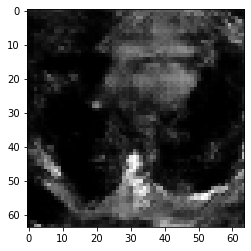

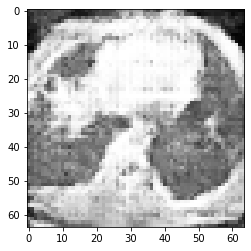

[227/300][0/6]
- D_loss : 2.0450 / G_loss : 0.9986
- D(x) : 0.9547 / D(G(z1)) : 0.7931 / D(G(z2)) : 0.4751 / d_acc : 0.5000
[227/300][1/6]
- D_loss : 1.4407 / G_loss : 0.0787
- D(x) : 0.4024 / D(G(z1)) : 0.2806 / D(G(z2)) : 0.9273 / d_acc : 0.5859
[227/300][2/6]
- D_loss : 1.9597 / G_loss : 0.8035
- D(x) : 0.7432 / D(G(z1)) : 0.7657 / D(G(z2)) : 0.4832 / d_acc : 0.4844
[227/300][3/6]
- D_loss : 1.3774 / G_loss : 0.1328
- D(x) : 0.3918 / D(G(z1)) : 0.2369 / D(G(z2)) : 0.8771 / d_acc : 0.6250
[227/300][4/6]
- D_loss : 1.3830 / G_loss : 1.3127
- D(x) : 0.8182 / D(G(z1)) : 0.6581 / D(G(z2)) : 0.3042 / d_acc : 0.5703
[227/300][5/6]
- D_loss : 1.2800 / G_loss : 0.1856
- D(x) : 0.3734 / D(G(z1)) : 0.1401 / D(G(z2)) : 0.8372 / d_acc : 0.5859


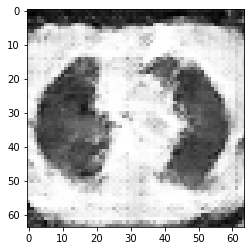

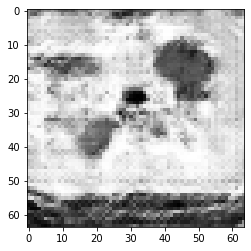

[228/300][0/6]
- D_loss : 1.1274 / G_loss : 0.8133
- D(x) : 0.8630 / D(G(z1)) : 0.5715 / D(G(z2)) : 0.4624 / d_acc : 0.6328
[228/300][1/6]
- D_loss : 0.7608 / G_loss : 0.2991
- D(x) : 0.5959 / D(G(z1)) : 0.1708 / D(G(z2)) : 0.7472 / d_acc : 0.8438
[228/300][2/6]
- D_loss : 0.7451 / G_loss : 0.2139
- D(x) : 0.6694 / D(G(z1)) : 0.2615 / D(G(z2)) : 0.8101 / d_acc : 0.9219
[228/300][3/6]
- D_loss : 0.8508 / G_loss : 0.8856
- D(x) : 0.8589 / D(G(z1)) : 0.4780 / D(G(z2)) : 0.4275 / d_acc : 0.7344
[228/300][4/6]
- D_loss : 0.6064 / G_loss : 0.3271
- D(x) : 0.6293 / D(G(z1)) : 0.0975 / D(G(z2)) : 0.7257 / d_acc : 0.9141
[228/300][5/6]
- D_loss : 0.7800 / G_loss : 0.1944
- D(x) : 0.6472 / D(G(z1)) : 0.2598 / D(G(z2)) : 0.8247 / d_acc : 0.9062


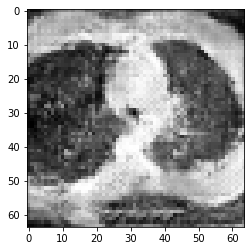

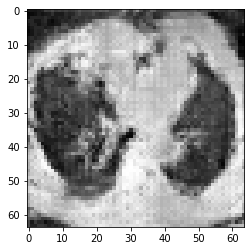

[229/300][0/6]
- D_loss : 0.5806 / G_loss : 0.9009
- D(x) : 0.9553 / D(G(z1)) : 0.3859 / D(G(z2)) : 0.4273 / d_acc : 0.8672
[229/300][1/6]
- D_loss : 0.6335 / G_loss : 0.3105
- D(x) : 0.6061 / D(G(z1)) : 0.0805 / D(G(z2)) : 0.7399 / d_acc : 0.8281
[229/300][2/6]
- D_loss : 0.5740 / G_loss : 0.2762
- D(x) : 0.7798 / D(G(z1)) : 0.2456 / D(G(z2)) : 0.7612 / d_acc : 0.9453
[229/300][3/6]
- D_loss : 0.4849 / G_loss : 0.6162
- D(x) : 0.8831 / D(G(z1)) : 0.2872 / D(G(z2)) : 0.5493 / d_acc : 0.9531
[229/300][4/6]
- D_loss : 0.3711 / G_loss : 0.4007
- D(x) : 0.7712 / D(G(z1)) : 0.0923 / D(G(z2)) : 0.6754 / d_acc : 0.9922
[229/300][5/6]
- D_loss : 0.3820 / G_loss : 0.2622
- D(x) : 0.8325 / D(G(z1)) : 0.1665 / D(G(z2)) : 0.7713 / d_acc : 0.9922


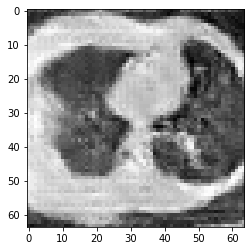

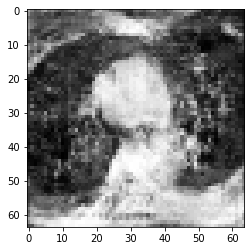

[230/300][0/6]
- D_loss : 0.3228 / G_loss : 0.3637
- D(x) : 0.8722 / D(G(z1)) : 0.1605 / D(G(z2)) : 0.6987 / d_acc : 0.9922
[230/300][1/6]
- D_loss : 0.2851 / G_loss : 0.5694
- D(x) : 0.8947 / D(G(z1)) : 0.1548 / D(G(z2)) : 0.5717 / d_acc : 1.0000
[230/300][2/6]
- D_loss : 0.3273 / G_loss : 0.4655
- D(x) : 0.8318 / D(G(z1)) : 0.1245 / D(G(z2)) : 0.6338 / d_acc : 1.0000
[230/300][3/6]
- D_loss : 0.2259 / G_loss : 0.4087
- D(x) : 0.8850 / D(G(z1)) : 0.0947 / D(G(z2)) : 0.6694 / d_acc : 1.0000
[230/300][4/6]
- D_loss : 0.4498 / G_loss : 0.3008
- D(x) : 0.7681 / D(G(z1)) : 0.1613 / D(G(z2)) : 0.7429 / d_acc : 1.0000
[230/300][5/6]
- D_loss : 0.3503 / G_loss : 0.4057
- D(x) : 0.8712 / D(G(z1)) : 0.1834 / D(G(z2)) : 0.6750 / d_acc : 1.0000


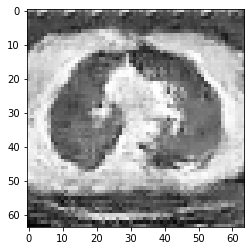

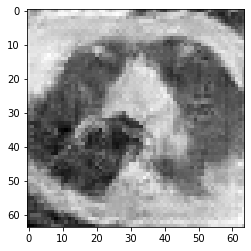

[231/300][0/6]
- D_loss : 0.2564 / G_loss : 0.6486
- D(x) : 0.9100 / D(G(z1)) : 0.1442 / D(G(z2)) : 0.5345 / d_acc : 1.0000
[231/300][1/6]
- D_loss : 0.1563 / G_loss : 0.5820
- D(x) : 0.9212 / D(G(z1)) : 0.0698 / D(G(z2)) : 0.5715 / d_acc : 1.0000
[231/300][2/6]
- D_loss : 0.3373 / G_loss : 0.3484
- D(x) : 0.7871 / D(G(z1)) : 0.0848 / D(G(z2)) : 0.7104 / d_acc : 1.0000
[231/300][3/6]
- D_loss : 0.2659 / G_loss : 0.4233
- D(x) : 0.9079 / D(G(z1)) : 0.1487 / D(G(z2)) : 0.6622 / d_acc : 1.0000
[231/300][4/6]
- D_loss : 0.2702 / G_loss : 0.4754
- D(x) : 0.8839 / D(G(z1)) : 0.1296 / D(G(z2)) : 0.6299 / d_acc : 1.0000
[231/300][5/6]
- D_loss : 0.2599 / G_loss : 0.4945
- D(x) : 0.8740 / D(G(z1)) : 0.1098 / D(G(z2)) : 0.6166 / d_acc : 1.0000


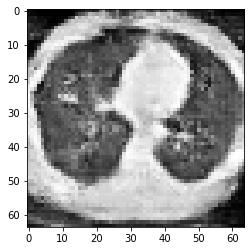

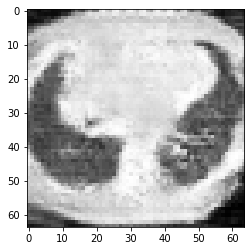

[232/300][0/6]
- D_loss : 0.2333 / G_loss : 0.4341
- D(x) : 0.8867 / D(G(z1)) : 0.1018 / D(G(z2)) : 0.6563 / d_acc : 1.0000
[232/300][1/6]
- D_loss : 0.1861 / G_loss : 0.5333
- D(x) : 0.9161 / D(G(z1)) : 0.0909 / D(G(z2)) : 0.5974 / d_acc : 1.0000
[232/300][2/6]
- D_loss : 0.1632 / G_loss : 0.5198
- D(x) : 0.9170 / D(G(z1)) : 0.0701 / D(G(z2)) : 0.6012 / d_acc : 1.0000
[232/300][3/6]
- D_loss : 0.1716 / G_loss : 0.4687
- D(x) : 0.9267 / D(G(z1)) : 0.0885 / D(G(z2)) : 0.6335 / d_acc : 1.0000
[232/300][4/6]
- D_loss : 0.1870 / G_loss : 0.2963
- D(x) : 0.9000 / D(G(z1)) : 0.0754 / D(G(z2)) : 0.7470 / d_acc : 1.0000
[232/300][5/6]
- D_loss : 0.3002 / G_loss : 0.4338
- D(x) : 0.8801 / D(G(z1)) : 0.1503 / D(G(z2)) : 0.6564 / d_acc : 1.0000


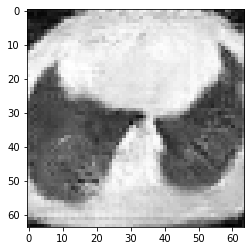

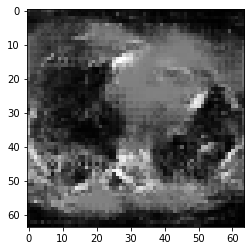

[233/300][0/6]
- D_loss : 0.3505 / G_loss : 1.1695
- D(x) : 0.8751 / D(G(z1)) : 0.1889 / D(G(z2)) : 0.3880 / d_acc : 1.0000
[233/300][1/6]
- D_loss : 0.2493 / G_loss : 0.4092
- D(x) : 0.8530 / D(G(z1)) : 0.0738 / D(G(z2)) : 0.6728 / d_acc : 0.9922
[233/300][2/6]
- D_loss : 0.3190 / G_loss : 1.0175
- D(x) : 0.8794 / D(G(z1)) : 0.1604 / D(G(z2)) : 0.4325 / d_acc : 0.9922
[233/300][3/6]
- D_loss : 0.3555 / G_loss : 0.6433
- D(x) : 0.8965 / D(G(z1)) : 0.1003 / D(G(z2)) : 0.5386 / d_acc : 0.9922
[233/300][4/6]
- D_loss : 0.1691 / G_loss : 0.7608
- D(x) : 0.9140 / D(G(z1)) : 0.0693 / D(G(z2)) : 0.4992 / d_acc : 0.9922
[233/300][5/6]
- D_loss : 0.2774 / G_loss : 0.4515
- D(x) : 0.8631 / D(G(z1)) : 0.1100 / D(G(z2)) : 0.6468 / d_acc : 0.9922


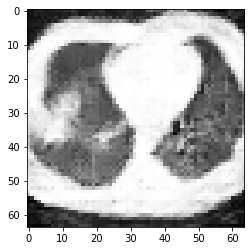

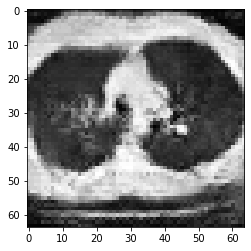

[234/300][0/6]
- D_loss : 0.2169 / G_loss : 0.8759
- D(x) : 0.9370 / D(G(z1)) : 0.1352 / D(G(z2)) : 0.4354 / d_acc : 1.0000
[234/300][1/6]
- D_loss : 0.2114 / G_loss : 0.8141
- D(x) : 0.9127 / D(G(z1)) : 0.0544 / D(G(z2)) : 0.4650 / d_acc : 0.9922
[234/300][2/6]
- D_loss : 0.1425 / G_loss : 0.6799
- D(x) : 0.9311 / D(G(z1)) : 0.0661 / D(G(z2)) : 0.5206 / d_acc : 1.0000
[234/300][3/6]
- D_loss : 0.1706 / G_loss : 0.7035
- D(x) : 0.9186 / D(G(z1)) : 0.0789 / D(G(z2)) : 0.5089 / d_acc : 1.0000
[234/300][4/6]
- D_loss : 0.1635 / G_loss : 0.5231
- D(x) : 0.9027 / D(G(z1)) : 0.0566 / D(G(z2)) : 0.6071 / d_acc : 1.0000
[234/300][5/6]
- D_loss : 0.1731 / G_loss : 0.6684
- D(x) : 0.9359 / D(G(z1)) : 0.0977 / D(G(z2)) : 0.5243 / d_acc : 1.0000


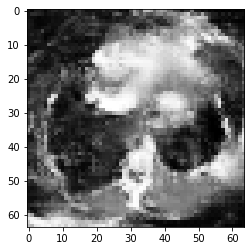

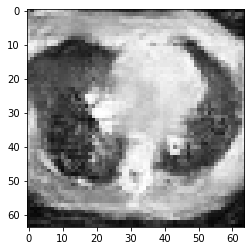

[235/300][0/6]
- D_loss : 0.1213 / G_loss : 1.2490
- D(x) : 0.9635 / D(G(z1)) : 0.0791 / D(G(z2)) : 0.3248 / d_acc : 1.0000
[235/300][1/6]
- D_loss : 0.2727 / G_loss : 0.2607
- D(x) : 0.7958 / D(G(z1)) : 0.0338 / D(G(z2)) : 0.7736 / d_acc : 1.0000
[235/300][2/6]
- D_loss : 0.3286 / G_loss : 1.5573
- D(x) : 0.9848 / D(G(z1)) : 0.2570 / D(G(z2)) : 0.2658 / d_acc : 0.9844
[235/300][3/6]
- D_loss : 0.1998 / G_loss : 0.8619
- D(x) : 0.8550 / D(G(z1)) : 0.0345 / D(G(z2)) : 0.4460 / d_acc : 0.9922
[235/300][4/6]
- D_loss : 0.1671 / G_loss : 0.4456
- D(x) : 0.8906 / D(G(z1)) : 0.0462 / D(G(z2)) : 0.6499 / d_acc : 1.0000
[235/300][5/6]
- D_loss : 0.1445 / G_loss : 0.6655
- D(x) : 0.9719 / D(G(z1)) : 0.1066 / D(G(z2)) : 0.5309 / d_acc : 1.0000


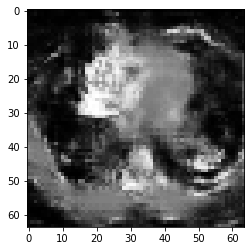

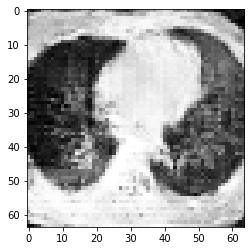

[236/300][0/6]
- D_loss : 0.1398 / G_loss : 0.7786
- D(x) : 0.9338 / D(G(z1)) : 0.0661 / D(G(z2)) : 0.4824 / d_acc : 1.0000
[236/300][1/6]
- D_loss : 0.1649 / G_loss : 0.6743
- D(x) : 0.9108 / D(G(z1)) : 0.0655 / D(G(z2)) : 0.5275 / d_acc : 1.0000
[236/300][2/6]
- D_loss : 0.1360 / G_loss : 0.5213
- D(x) : 0.9299 / D(G(z1)) : 0.0590 / D(G(z2)) : 0.6069 / d_acc : 1.0000
[236/300][3/6]
- D_loss : 0.1468 / G_loss : 0.9372
- D(x) : 0.9610 / D(G(z1)) : 0.1000 / D(G(z2)) : 0.4140 / d_acc : 1.0000
[236/300][4/6]
- D_loss : 0.1169 / G_loss : 0.7790
- D(x) : 0.9260 / D(G(z1)) : 0.0375 / D(G(z2)) : 0.4790 / d_acc : 1.0000
[236/300][5/6]
- D_loss : 0.1367 / G_loss : 0.4464
- D(x) : 0.9231 / D(G(z1)) : 0.0532 / D(G(z2)) : 0.6460 / d_acc : 1.0000


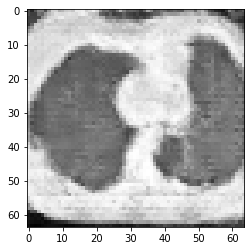

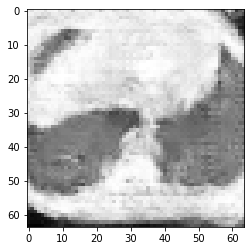

[237/300][0/6]
- D_loss : 0.1297 / G_loss : 0.7943
- D(x) : 0.9645 / D(G(z1)) : 0.0874 / D(G(z2)) : 0.4684 / d_acc : 1.0000
[237/300][1/6]
- D_loss : 0.1378 / G_loss : 0.7188
- D(x) : 0.9221 / D(G(z1)) : 0.0528 / D(G(z2)) : 0.5080 / d_acc : 1.0000
[237/300][2/6]
- D_loss : 0.1868 / G_loss : 0.3868
- D(x) : 0.8689 / D(G(z1)) : 0.0414 / D(G(z2)) : 0.6872 / d_acc : 1.0000
[237/300][3/6]
- D_loss : 0.1617 / G_loss : 0.6857
- D(x) : 0.9666 / D(G(z1)) : 0.1155 / D(G(z2)) : 0.5185 / d_acc : 1.0000
[237/300][4/6]
- D_loss : 0.1640 / G_loss : 1.3291
- D(x) : 0.9490 / D(G(z1)) : 0.1003 / D(G(z2)) : 0.3514 / d_acc : 1.0000
[237/300][5/6]
- D_loss : 0.2323 / G_loss : 0.5051
- D(x) : 0.8155 / D(G(z1)) : 0.0202 / D(G(z2)) : 0.6691 / d_acc : 1.0000


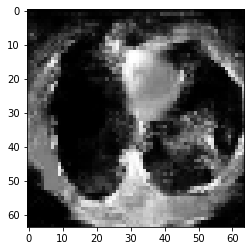

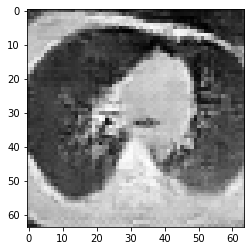

[238/300][0/6]
- D_loss : 0.2109 / G_loss : 1.2077
- D(x) : 0.9799 / D(G(z1)) : 0.1660 / D(G(z2)) : 0.3497 / d_acc : 1.0000
[238/300][1/6]
- D_loss : 0.0727 / G_loss : 1.0881
- D(x) : 0.9507 / D(G(z1)) : 0.0211 / D(G(z2)) : 0.3715 / d_acc : 1.0000
[238/300][2/6]
- D_loss : 0.1166 / G_loss : 0.4747
- D(x) : 0.9216 / D(G(z1)) : 0.0321 / D(G(z2)) : 0.6335 / d_acc : 1.0000
[238/300][3/6]
- D_loss : 0.1439 / G_loss : 0.3613
- D(x) : 0.9340 / D(G(z1)) : 0.0677 / D(G(z2)) : 0.7054 / d_acc : 0.9922
[238/300][4/6]
- D_loss : 0.1599 / G_loss : 0.9005
- D(x) : 0.9574 / D(G(z1)) : 0.1068 / D(G(z2)) : 0.4508 / d_acc : 1.0000
[238/300][5/6]
- D_loss : 0.1188 / G_loss : 0.6545
- D(x) : 0.9156 / D(G(z1)) : 0.0273 / D(G(z2)) : 0.5364 / d_acc : 1.0000


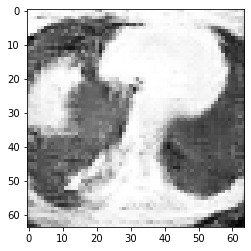

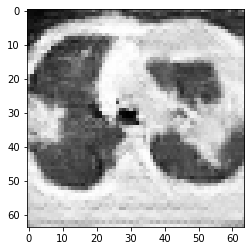

[239/300][0/6]
- D_loss : 0.1151 / G_loss : 0.9009
- D(x) : 0.9718 / D(G(z1)) : 0.0807 / D(G(z2)) : 0.4274 / d_acc : 1.0000
[239/300][1/6]
- D_loss : 0.0865 / G_loss : 0.7767
- D(x) : 0.9399 / D(G(z1)) : 0.0231 / D(G(z2)) : 0.4863 / d_acc : 1.0000
[239/300][2/6]
- D_loss : 0.1045 / G_loss : 0.6633
- D(x) : 0.9532 / D(G(z1)) : 0.0534 / D(G(z2)) : 0.5337 / d_acc : 1.0000
[239/300][3/6]
- D_loss : 0.1779 / G_loss : 0.6125
- D(x) : 0.9076 / D(G(z1)) : 0.0703 / D(G(z2)) : 0.5577 / d_acc : 1.0000
[239/300][4/6]
- D_loss : 0.1780 / G_loss : 1.5902
- D(x) : 0.9641 / D(G(z1)) : 0.1163 / D(G(z2)) : 0.3403 / d_acc : 0.9844
[239/300][5/6]
- D_loss : 0.3137 / G_loss : 0.4704
- D(x) : 0.8002 / D(G(z1)) : 0.0268 / D(G(z2)) : 0.6423 / d_acc : 0.9531


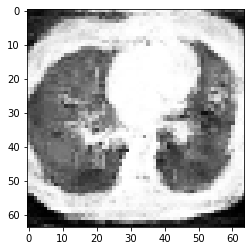

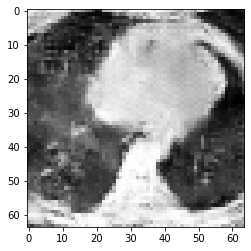

[240/300][0/6]
- D_loss : 0.1715 / G_loss : 0.7389
- D(x) : 0.9668 / D(G(z1)) : 0.1225 / D(G(z2)) : 0.5189 / d_acc : 1.0000
[240/300][1/6]
- D_loss : 0.2126 / G_loss : 1.1689
- D(x) : 0.9244 / D(G(z1)) : 0.0915 / D(G(z2)) : 0.5000 / d_acc : 0.9844
[240/300][2/6]
- D_loss : 0.3026 / G_loss : 0.4204
- D(x) : 0.8806 / D(G(z1)) : 0.0696 / D(G(z2)) : 0.6683 / d_acc : 0.9844
[240/300][3/6]
- D_loss : 0.1819 / G_loss : 0.5846
- D(x) : 0.9433 / D(G(z1)) : 0.1075 / D(G(z2)) : 0.5694 / d_acc : 1.0000
[240/300][4/6]
- D_loss : 0.1415 / G_loss : 0.8099
- D(x) : 0.9323 / D(G(z1)) : 0.0665 / D(G(z2)) : 0.4688 / d_acc : 1.0000
[240/300][5/6]
- D_loss : 0.1233 / G_loss : 0.6867
- D(x) : 0.9378 / D(G(z1)) : 0.0546 / D(G(z2)) : 0.5240 / d_acc : 1.0000


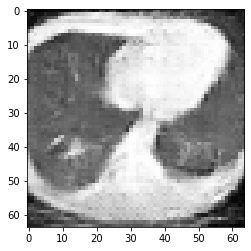

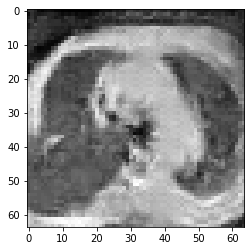

[241/300][0/6]
- D_loss : 0.1030 / G_loss : 0.6913
- D(x) : 0.9546 / D(G(z1)) : 0.0530 / D(G(z2)) : 0.5285 / d_acc : 1.0000
[241/300][1/6]
- D_loss : 0.1616 / G_loss : 0.9771
- D(x) : 0.9382 / D(G(z1)) : 0.0885 / D(G(z2)) : 0.3998 / d_acc : 1.0000
[241/300][2/6]
- D_loss : 0.1277 / G_loss : 0.8108
- D(x) : 0.9280 / D(G(z1)) : 0.0407 / D(G(z2)) : 0.4673 / d_acc : 0.9922
[241/300][3/6]
- D_loss : 0.1271 / G_loss : 0.6827
- D(x) : 0.9305 / D(G(z1)) : 0.0502 / D(G(z2)) : 0.5266 / d_acc : 1.0000
[241/300][4/6]
- D_loss : 0.1813 / G_loss : 0.9565
- D(x) : 0.9010 / D(G(z1)) : 0.0686 / D(G(z2)) : 0.5080 / d_acc : 1.0000
[241/300][5/6]
- D_loss : 0.2072 / G_loss : 0.8617
- D(x) : 0.9339 / D(G(z1)) : 0.1065 / D(G(z2)) : 0.4442 / d_acc : 0.9844


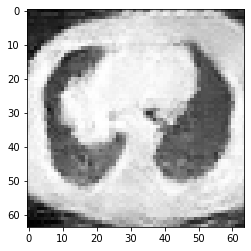

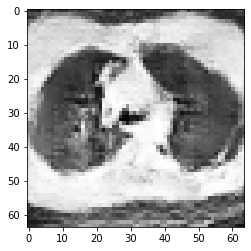

[242/300][0/6]
- D_loss : 0.0833 / G_loss : 1.0292
- D(x) : 0.9641 / D(G(z1)) : 0.0447 / D(G(z2)) : 0.3832 / d_acc : 1.0000
[242/300][1/6]
- D_loss : 0.1050 / G_loss : 0.7314
- D(x) : 0.9454 / D(G(z1)) : 0.0460 / D(G(z2)) : 0.5049 / d_acc : 1.0000
[242/300][2/6]
- D_loss : 0.2333 / G_loss : 0.2681
- D(x) : 0.8625 / D(G(z1)) : 0.0693 / D(G(z2)) : 0.7740 / d_acc : 0.9922
[242/300][3/6]
- D_loss : 0.2232 / G_loss : 1.3280
- D(x) : 0.9803 / D(G(z1)) : 0.1729 / D(G(z2)) : 0.2950 / d_acc : 0.9922
[242/300][4/6]
- D_loss : 0.1260 / G_loss : 1.3561
- D(x) : 0.9177 / D(G(z1)) : 0.0359 / D(G(z2)) : 0.2903 / d_acc : 1.0000
[242/300][5/6]
- D_loss : 0.2088 / G_loss : 0.3770
- D(x) : 0.8426 / D(G(z1)) : 0.0292 / D(G(z2)) : 0.6974 / d_acc : 1.0000


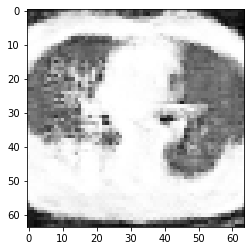

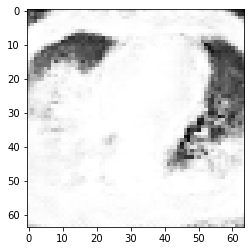

[243/300][0/6]
- D_loss : 0.2398 / G_loss : 0.8445
- D(x) : 0.9547 / D(G(z1)) : 0.1287 / D(G(z2)) : 0.4628 / d_acc : 0.9922
[243/300][1/6]
- D_loss : 0.0858 / G_loss : 1.3303
- D(x) : 0.9753 / D(G(z1)) : 0.0564 / D(G(z2)) : 0.3291 / d_acc : 1.0000
[243/300][2/6]
- D_loss : 0.0915 / G_loss : 0.8362
- D(x) : 0.9462 / D(G(z1)) : 0.0337 / D(G(z2)) : 0.4795 / d_acc : 1.0000
[243/300][3/6]
- D_loss : 0.1165 / G_loss : 0.6343
- D(x) : 0.9285 / D(G(z1)) : 0.0384 / D(G(z2)) : 0.5568 / d_acc : 1.0000
[243/300][4/6]
- D_loss : 0.0887 / G_loss : 0.8601
- D(x) : 0.9860 / D(G(z1)) : 0.0701 / D(G(z2)) : 0.4544 / d_acc : 1.0000
[243/300][5/6]
- D_loss : 0.0951 / G_loss : 0.6899
- D(x) : 0.9378 / D(G(z1)) : 0.0289 / D(G(z2)) : 0.5277 / d_acc : 1.0000


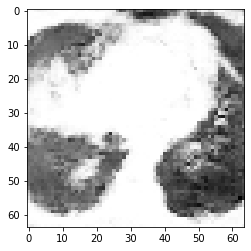

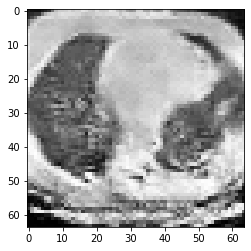

[244/300][0/6]
- D_loss : 0.0976 / G_loss : 0.7125
- D(x) : 0.9612 / D(G(z1)) : 0.0552 / D(G(z2)) : 0.5107 / d_acc : 1.0000
[244/300][1/6]
- D_loss : 0.1131 / G_loss : 0.4520
- D(x) : 0.9438 / D(G(z1)) : 0.0474 / D(G(z2)) : 0.6482 / d_acc : 1.0000
[244/300][2/6]
- D_loss : 0.0870 / G_loss : 0.5450
- D(x) : 0.9699 / D(G(z1)) : 0.0534 / D(G(z2)) : 0.5912 / d_acc : 1.0000
[244/300][3/6]
- D_loss : 0.3346 / G_loss : 3.4163
- D(x) : 0.8849 / D(G(z1)) : 0.1748 / D(G(z2)) : 0.1399 / d_acc : 0.9766
[244/300][4/6]
- D_loss : 0.2251 / G_loss : 0.9683
- D(x) : 0.8264 / D(G(z1)) : 0.0085 / D(G(z2)) : 0.5354 / d_acc : 0.9766
[244/300][5/6]
- D_loss : 0.2665 / G_loss : 0.6280
- D(x) : 0.9658 / D(G(z1)) : 0.1000 / D(G(z2)) : 0.5672 / d_acc : 0.9922


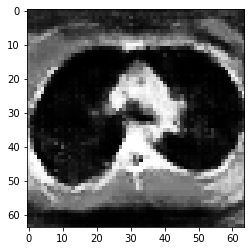

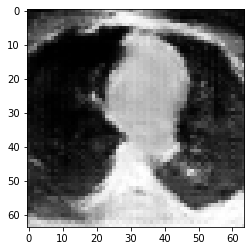

[245/300][0/6]
- D_loss : 0.1765 / G_loss : 1.9195
- D(x) : 0.9710 / D(G(z1)) : 0.1240 / D(G(z2)) : 0.2366 / d_acc : 0.9844
[245/300][1/6]
- D_loss : 0.1761 / G_loss : 0.8035
- D(x) : 0.8610 / D(G(z1)) : 0.0133 / D(G(z2)) : 0.5092 / d_acc : 0.9922
[245/300][2/6]
- D_loss : 0.0834 / G_loss : 0.4055
- D(x) : 0.9635 / D(G(z1)) : 0.0416 / D(G(z2)) : 0.6805 / d_acc : 1.0000
[245/300][3/6]
- D_loss : 0.2200 / G_loss : 0.4177
- D(x) : 0.8939 / D(G(z1)) : 0.0951 / D(G(z2)) : 0.6738 / d_acc : 1.0000
[245/300][4/6]
- D_loss : 0.1903 / G_loss : 1.6577
- D(x) : 0.9811 / D(G(z1)) : 0.1519 / D(G(z2)) : 0.2190 / d_acc : 1.0000
[245/300][5/6]
- D_loss : 0.1988 / G_loss : 0.6906
- D(x) : 0.8524 / D(G(z1)) : 0.0221 / D(G(z2)) : 0.5344 / d_acc : 0.9844


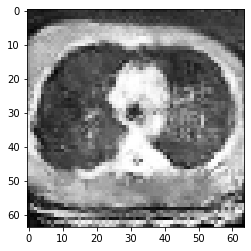

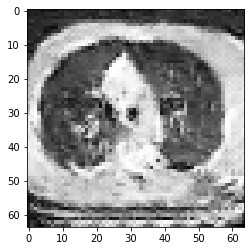

[246/300][0/6]
- D_loss : 0.0964 / G_loss : 0.5061
- D(x) : 0.9606 / D(G(z1)) : 0.0526 / D(G(z2)) : 0.6253 / d_acc : 1.0000
[246/300][1/6]
- D_loss : 0.1000 / G_loss : 0.9160
- D(x) : 0.9867 / D(G(z1)) : 0.0778 / D(G(z2)) : 0.4405 / d_acc : 0.9922
[246/300][2/6]
- D_loss : 0.1189 / G_loss : 0.8202
- D(x) : 0.9443 / D(G(z1)) : 0.0247 / D(G(z2)) : 0.4754 / d_acc : 0.9922
[246/300][3/6]
- D_loss : 0.1626 / G_loss : 0.8968
- D(x) : 0.9339 / D(G(z1)) : 0.0545 / D(G(z2)) : 0.5021 / d_acc : 0.9922
[246/300][4/6]
- D_loss : 0.1252 / G_loss : 0.6276
- D(x) : 0.9341 / D(G(z1)) : 0.0517 / D(G(z2)) : 0.6036 / d_acc : 1.0000
[246/300][5/6]
- D_loss : 0.2129 / G_loss : 0.6478
- D(x) : 0.9414 / D(G(z1)) : 0.0590 / D(G(z2)) : 0.5535 / d_acc : 0.9922


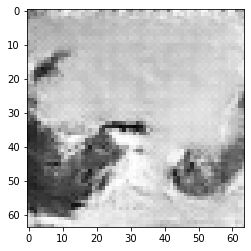

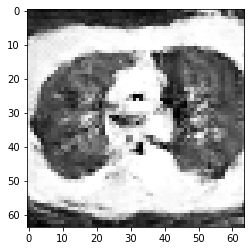

[247/300][0/6]
- D_loss : 0.0937 / G_loss : 0.8428
- D(x) : 0.9598 / D(G(z1)) : 0.0499 / D(G(z2)) : 0.4686 / d_acc : 1.0000
[247/300][1/6]
- D_loss : 0.0787 / G_loss : 0.7670
- D(x) : 0.9623 / D(G(z1)) : 0.0372 / D(G(z2)) : 0.4774 / d_acc : 1.0000
[247/300][2/6]
- D_loss : 0.0560 / G_loss : 0.9270
- D(x) : 0.9826 / D(G(z1)) : 0.0369 / D(G(z2)) : 0.4268 / d_acc : 1.0000
[247/300][3/6]
- D_loss : 0.0793 / G_loss : 0.6967
- D(x) : 0.9482 / D(G(z1)) : 0.0249 / D(G(z2)) : 0.5178 / d_acc : 1.0000
[247/300][4/6]
- D_loss : 0.0816 / G_loss : 0.7209
- D(x) : 0.9668 / D(G(z1)) : 0.0455 / D(G(z2)) : 0.5067 / d_acc : 1.0000
[247/300][5/6]
- D_loss : 0.0591 / G_loss : 0.9623
- D(x) : 0.9867 / D(G(z1)) : 0.0436 / D(G(z2)) : 0.3996 / d_acc : 1.0000


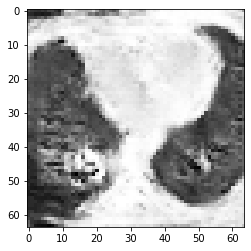

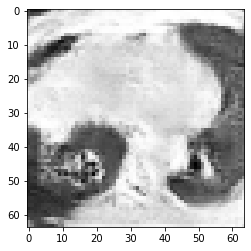

[248/300][0/6]
- D_loss : 0.2023 / G_loss : 0.2827
- D(x) : 0.8439 / D(G(z1)) : 0.0257 / D(G(z2)) : 0.7585 / d_acc : 1.0000
[248/300][1/6]
- D_loss : 0.2145 / G_loss : 2.1658
- D(x) : 0.9939 / D(G(z1)) : 0.1734 / D(G(z2)) : 0.1584 / d_acc : 0.9766
[248/300][2/6]
- D_loss : 0.0933 / G_loss : 1.3117
- D(x) : 0.9247 / D(G(z1)) : 0.0130 / D(G(z2)) : 0.3236 / d_acc : 1.0000
[248/300][3/6]
- D_loss : 0.0641 / G_loss : 0.9008
- D(x) : 0.9541 / D(G(z1)) : 0.0161 / D(G(z2)) : 0.4381 / d_acc : 1.0000
[248/300][4/6]
- D_loss : 0.0485 / G_loss : 0.5821
- D(x) : 0.9807 / D(G(z1)) : 0.0280 / D(G(z2)) : 0.5738 / d_acc : 1.0000
[248/300][5/6]
- D_loss : 0.0863 / G_loss : 0.8826
- D(x) : 0.9748 / D(G(z1)) : 0.0572 / D(G(z2)) : 0.4441 / d_acc : 1.0000


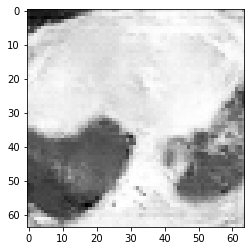

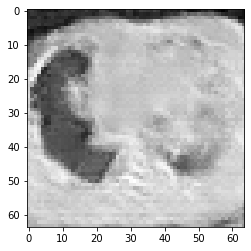

[249/300][0/6]
- D_loss : 0.0850 / G_loss : 0.9981
- D(x) : 0.9651 / D(G(z1)) : 0.0462 / D(G(z2)) : 0.3947 / d_acc : 1.0000
[249/300][1/6]
- D_loss : 0.0651 / G_loss : 0.8307
- D(x) : 0.9591 / D(G(z1)) : 0.0225 / D(G(z2)) : 0.4720 / d_acc : 1.0000
[249/300][2/6]
- D_loss : 0.0816 / G_loss : 0.5773
- D(x) : 0.9408 / D(G(z1)) : 0.0195 / D(G(z2)) : 0.5754 / d_acc : 1.0000
[249/300][3/6]
- D_loss : 0.1132 / G_loss : 0.5254
- D(x) : 0.9486 / D(G(z1)) : 0.0568 / D(G(z2)) : 0.6074 / d_acc : 1.0000
[249/300][4/6]
- D_loss : 0.1212 / G_loss : 0.7630
- D(x) : 0.9657 / D(G(z1)) : 0.0799 / D(G(z2)) : 0.4917 / d_acc : 1.0000
[249/300][5/6]
- D_loss : 0.0460 / G_loss : 1.3946
- D(x) : 0.9830 / D(G(z1)) : 0.0281 / D(G(z2)) : 0.2880 / d_acc : 1.0000


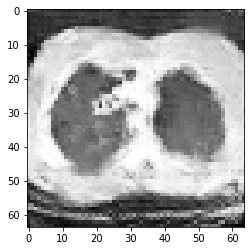

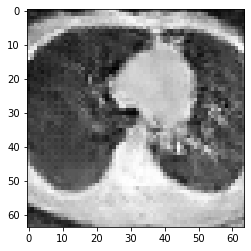

[250/300][0/6]
- D_loss : 0.0782 / G_loss : 0.8818
- D(x) : 0.9361 / D(G(z1)) : 0.0111 / D(G(z2)) : 0.4408 / d_acc : 1.0000
[250/300][1/6]
- D_loss : 0.0654 / G_loss : 1.1124
- D(x) : 0.9865 / D(G(z1)) : 0.0486 / D(G(z2)) : 0.3818 / d_acc : 1.0000
[250/300][2/6]
- D_loss : 0.0728 / G_loss : 1.1303
- D(x) : 0.9602 / D(G(z1)) : 0.0309 / D(G(z2)) : 0.3699 / d_acc : 1.0000
[250/300][3/6]
- D_loss : 0.0715 / G_loss : 0.4950
- D(x) : 0.9550 / D(G(z1)) : 0.0244 / D(G(z2)) : 0.6296 / d_acc : 1.0000
[250/300][4/6]
- D_loss : 0.1203 / G_loss : 0.4897
- D(x) : 0.9398 / D(G(z1)) : 0.0380 / D(G(z2)) : 0.6303 / d_acc : 0.9922
[250/300][5/6]
- D_loss : 0.0655 / G_loss : 0.6086
- D(x) : 0.9871 / D(G(z1)) : 0.0505 / D(G(z2)) : 0.5685 / d_acc : 1.0000


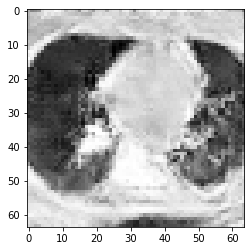

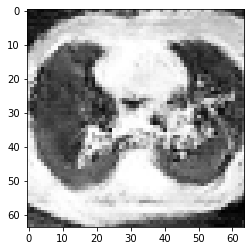

[251/300][0/6]
- D_loss : 0.1096 / G_loss : 0.8959
- D(x) : 0.9477 / D(G(z1)) : 0.0492 / D(G(z2)) : 0.4421 / d_acc : 0.9922
[251/300][1/6]
- D_loss : 0.0738 / G_loss : 0.6850
- D(x) : 0.9634 / D(G(z1)) : 0.0346 / D(G(z2)) : 0.5378 / d_acc : 1.0000
[251/300][2/6]
- D_loss : 0.0646 / G_loss : 0.8989
- D(x) : 0.9743 / D(G(z1)) : 0.0365 / D(G(z2)) : 0.4479 / d_acc : 1.0000
[251/300][3/6]
- D_loss : 0.0622 / G_loss : 0.4817
- D(x) : 0.9632 / D(G(z1)) : 0.0235 / D(G(z2)) : 0.6375 / d_acc : 1.0000
[251/300][4/6]
- D_loss : 0.1322 / G_loss : 1.3528
- D(x) : 0.9706 / D(G(z1)) : 0.0908 / D(G(z2)) : 0.3468 / d_acc : 1.0000
[251/300][5/6]
- D_loss : 0.1383 / G_loss : 0.6940
- D(x) : 0.8853 / D(G(z1)) : 0.0094 / D(G(z2)) : 0.6003 / d_acc : 1.0000


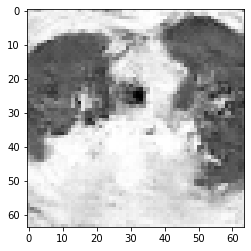

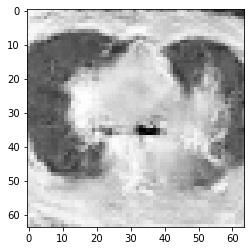

[252/300][0/6]
- D_loss : 0.1141 / G_loss : 0.3896
- D(x) : 0.9705 / D(G(z1)) : 0.0467 / D(G(z2)) : 0.6955 / d_acc : 0.9922
[252/300][1/6]
- D_loss : 0.1144 / G_loss : 1.1861
- D(x) : 0.9918 / D(G(z1)) : 0.0892 / D(G(z2)) : 0.3736 / d_acc : 0.9922
[252/300][2/6]
- D_loss : 0.1775 / G_loss : 0.2883
- D(x) : 0.8692 / D(G(z1)) : 0.0236 / D(G(z2)) : 0.7614 / d_acc : 0.9922
[252/300][3/6]
- D_loss : 0.1836 / G_loss : 2.1797
- D(x) : 0.9844 / D(G(z1)) : 0.1338 / D(G(z2)) : 0.2304 / d_acc : 0.9844
[252/300][4/6]
- D_loss : 0.0842 / G_loss : 1.7826
- D(x) : 0.9394 / D(G(z1)) : 0.0197 / D(G(z2)) : 0.3235 / d_acc : 1.0000
[252/300][5/6]
- D_loss : 0.1943 / G_loss : 0.3197
- D(x) : 0.8565 / D(G(z1)) : 0.0145 / D(G(z2)) : 0.7850 / d_acc : 0.9844


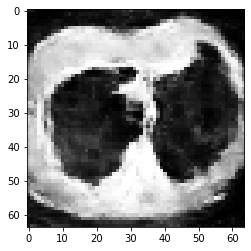

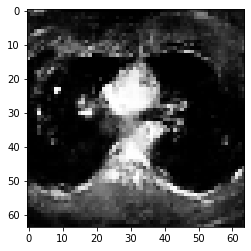

[253/300][0/6]
- D_loss : 0.2925 / G_loss : 2.5350
- D(x) : 0.9920 / D(G(z1)) : 0.2202 / D(G(z2)) : 0.1377 / d_acc : 0.9609
[253/300][1/6]
- D_loss : 0.8383 / G_loss : 0.2163
- D(x) : 0.5717 / D(G(z1)) : 0.0190 / D(G(z2)) : 0.8213 / d_acc : 0.8125
[253/300][2/6]
- D_loss : 0.5755 / G_loss : 5.7387
- D(x) : 0.9723 / D(G(z1)) : 0.3706 / D(G(z2)) : 0.0097 / d_acc : 0.8359
[253/300][3/6]
- D_loss : 5.4623 / G_loss : 0.0380
- D(x) : 0.0126 / D(G(z1)) : 0.0039 / D(G(z2)) : 0.9635 / d_acc : 0.5000
[253/300][4/6]
- D_loss : 3.2506 / G_loss : 1.7090
- D(x) : 0.9909 / D(G(z1)) : 0.8460 / D(G(z2)) : 0.3755 / d_acc : 0.5391
[253/300][5/6]
- D_loss : 1.5257 / G_loss : 0.1221
- D(x) : 0.4901 / D(G(z1)) : 0.2235 / D(G(z2)) : 0.8876 / d_acc : 0.7188


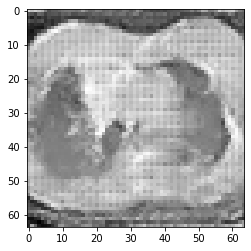

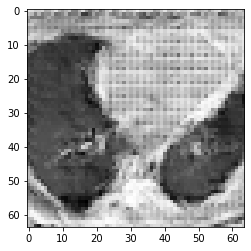

[254/300][0/6]
- D_loss : 1.3028 / G_loss : 2.0993
- D(x) : 0.9239 / D(G(z1)) : 0.6283 / D(G(z2)) : 0.2164 / d_acc : 0.6484
[254/300][1/6]
- D_loss : 1.8425 / G_loss : 0.1963
- D(x) : 0.3100 / D(G(z1)) : 0.0802 / D(G(z2)) : 0.8816 / d_acc : 0.6328
[254/300][2/6]
- D_loss : 1.8975 / G_loss : 1.9242
- D(x) : 0.8381 / D(G(z1)) : 0.6747 / D(G(z2)) : 0.2483 / d_acc : 0.5469
[254/300][3/6]
- D_loss : 2.4639 / G_loss : 0.2363
- D(x) : 0.2985 / D(G(z1)) : 0.1708 / D(G(z2)) : 0.8232 / d_acc : 0.5391
[254/300][4/6]
- D_loss : 1.8292 / G_loss : 0.8567
- D(x) : 0.8321 / D(G(z1)) : 0.6932 / D(G(z2)) : 0.4774 / d_acc : 0.5000
[254/300][5/6]
- D_loss : 1.2368 / G_loss : 0.1262
- D(x) : 0.4915 / D(G(z1)) : 0.2150 / D(G(z2)) : 0.8831 / d_acc : 0.7109


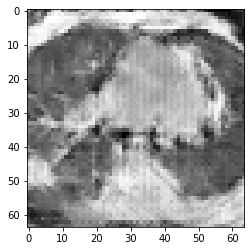

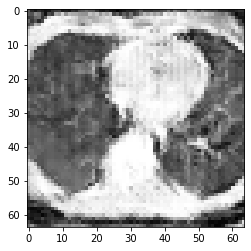

[255/300][0/6]
- D_loss : 1.1224 / G_loss : 0.7766
- D(x) : 0.8708 / D(G(z1)) : 0.5745 / D(G(z2)) : 0.4896 / d_acc : 0.6406
[255/300][1/6]
- D_loss : 0.5903 / G_loss : 0.4175
- D(x) : 0.7346 / D(G(z1)) : 0.2002 / D(G(z2)) : 0.6779 / d_acc : 0.9531
[255/300][2/6]
- D_loss : 0.7389 / G_loss : 0.3859
- D(x) : 0.7071 / D(G(z1)) : 0.2611 / D(G(z2)) : 0.6954 / d_acc : 0.8828
[255/300][3/6]
- D_loss : 0.5937 / G_loss : 0.3517
- D(x) : 0.7659 / D(G(z1)) : 0.2191 / D(G(z2)) : 0.7135 / d_acc : 0.9297
[255/300][4/6]
- D_loss : 0.4844 / G_loss : 0.6815
- D(x) : 0.8577 / D(G(z1)) : 0.2428 / D(G(z2)) : 0.5289 / d_acc : 0.9688
[255/300][5/6]
- D_loss : 0.5840 / G_loss : 0.1977
- D(x) : 0.6989 / D(G(z1)) : 0.1382 / D(G(z2)) : 0.8238 / d_acc : 0.9062


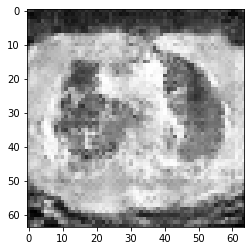

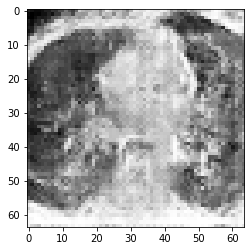

[256/300][0/6]
- D_loss : 0.5401 / G_loss : 1.9158
- D(x) : 0.9450 / D(G(z1)) : 0.3422 / D(G(z2)) : 0.2098 / d_acc : 0.8906
[256/300][1/6]
- D_loss : 0.5564 / G_loss : 0.3955
- D(x) : 0.6856 / D(G(z1)) : 0.0550 / D(G(z2)) : 0.6971 / d_acc : 0.9531
[256/300][2/6]
- D_loss : 0.4335 / G_loss : 0.3783
- D(x) : 0.8401 / D(G(z1)) : 0.1933 / D(G(z2)) : 0.6925 / d_acc : 0.9766
[256/300][3/6]
- D_loss : 0.4321 / G_loss : 1.6659
- D(x) : 0.9394 / D(G(z1)) : 0.2779 / D(G(z2)) : 0.2074 / d_acc : 0.9609
[256/300][4/6]
- D_loss : 0.5114 / G_loss : 0.4394
- D(x) : 0.6561 / D(G(z1)) : 0.0234 / D(G(z2)) : 0.6588 / d_acc : 0.8906
[256/300][5/6]
- D_loss : 0.3538 / G_loss : 0.3696
- D(x) : 0.8981 / D(G(z1)) : 0.2023 / D(G(z2)) : 0.7004 / d_acc : 0.9844


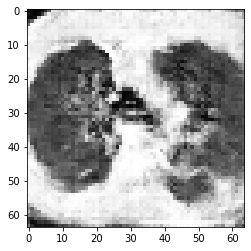

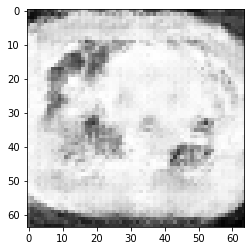

[257/300][0/6]
- D_loss : 0.3350 / G_loss : 1.7013
- D(x) : 0.9565 / D(G(z1)) : 0.2380 / D(G(z2)) : 0.2410 / d_acc : 0.9766
[257/300][1/6]
- D_loss : 0.2956 / G_loss : 0.6419
- D(x) : 0.7849 / D(G(z1)) : 0.0422 / D(G(z2)) : 0.5607 / d_acc : 1.0000
[257/300][2/6]
- D_loss : 0.3652 / G_loss : 0.3231
- D(x) : 0.8143 / D(G(z1)) : 0.0866 / D(G(z2)) : 0.7284 / d_acc : 0.9922
[257/300][3/6]
- D_loss : 0.3458 / G_loss : 1.0947
- D(x) : 0.9641 / D(G(z1)) : 0.2527 / D(G(z2)) : 0.3637 / d_acc : 0.9766
[257/300][4/6]
- D_loss : 0.4476 / G_loss : 0.4285
- D(x) : 0.7159 / D(G(z1)) : 0.0593 / D(G(z2)) : 0.6618 / d_acc : 0.9297
[257/300][5/6]
- D_loss : 0.1741 / G_loss : 0.3414
- D(x) : 0.9341 / D(G(z1)) : 0.0940 / D(G(z2)) : 0.7193 / d_acc : 1.0000


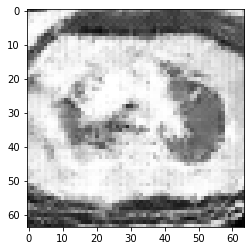

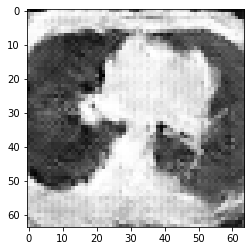

[258/300][0/6]
- D_loss : 0.2417 / G_loss : 1.0012
- D(x) : 0.9683 / D(G(z1)) : 0.1771 / D(G(z2)) : 0.3924 / d_acc : 0.9844
[258/300][1/6]
- D_loss : 0.1894 / G_loss : 0.6971
- D(x) : 0.8876 / D(G(z1)) : 0.0627 / D(G(z2)) : 0.5194 / d_acc : 1.0000
[258/300][2/6]
- D_loss : 0.2159 / G_loss : 0.3509
- D(x) : 0.8600 / D(G(z1)) : 0.0538 / D(G(z2)) : 0.7093 / d_acc : 0.9922
[258/300][3/6]
- D_loss : 0.2948 / G_loss : 1.0900
- D(x) : 0.9377 / D(G(z1)) : 0.1919 / D(G(z2)) : 0.3947 / d_acc : 0.9844
[258/300][4/6]
- D_loss : 0.1852 / G_loss : 0.9140
- D(x) : 0.8804 / D(G(z1)) : 0.0502 / D(G(z2)) : 0.4384 / d_acc : 1.0000
[258/300][5/6]
- D_loss : 0.2077 / G_loss : 0.8447
- D(x) : 0.9093 / D(G(z1)) : 0.1011 / D(G(z2)) : 0.4516 / d_acc : 1.0000


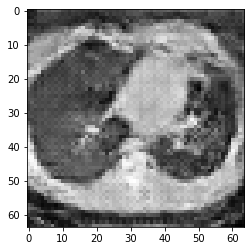

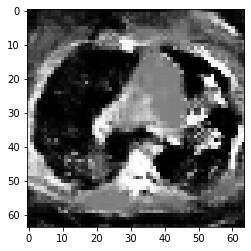

[259/300][0/6]
- D_loss : 0.3174 / G_loss : 0.3239
- D(x) : 0.8041 / D(G(z1)) : 0.0389 / D(G(z2)) : 0.7294 / d_acc : 0.9844
[259/300][1/6]
- D_loss : 0.5373 / G_loss : 2.8069
- D(x) : 0.9781 / D(G(z1)) : 0.3281 / D(G(z2)) : 0.1850 / d_acc : 0.9141
[259/300][2/6]
- D_loss : 0.3019 / G_loss : 1.5189
- D(x) : 0.7966 / D(G(z1)) : 0.0355 / D(G(z2)) : 0.2828 / d_acc : 0.9609
[259/300][3/6]
- D_loss : 0.1534 / G_loss : 0.5594
- D(x) : 0.8947 / D(G(z1)) : 0.0360 / D(G(z2)) : 0.5894 / d_acc : 1.0000
[259/300][4/6]
- D_loss : 0.2201 / G_loss : 0.5667
- D(x) : 0.9199 / D(G(z1)) : 0.1201 / D(G(z2)) : 0.5841 / d_acc : 1.0000
[259/300][5/6]
- D_loss : 0.2365 / G_loss : 1.2198
- D(x) : 0.9548 / D(G(z1)) : 0.1495 / D(G(z2)) : 0.3428 / d_acc : 0.9844


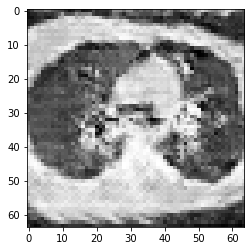

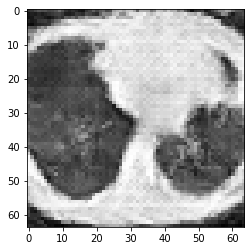

[260/300][0/6]
- D_loss : 0.1871 / G_loss : 0.9281
- D(x) : 0.8771 / D(G(z1)) : 0.0495 / D(G(z2)) : 0.4347 / d_acc : 1.0000
[260/300][1/6]
- D_loss : 0.2185 / G_loss : 0.7143
- D(x) : 0.9194 / D(G(z1)) : 0.0555 / D(G(z2)) : 0.5186 / d_acc : 0.9922
[260/300][2/6]
- D_loss : 0.1478 / G_loss : 0.7223
- D(x) : 0.9472 / D(G(z1)) : 0.0853 / D(G(z2)) : 0.5068 / d_acc : 1.0000
[260/300][3/6]
- D_loss : 0.2330 / G_loss : 0.4173
- D(x) : 0.8566 / D(G(z1)) : 0.0677 / D(G(z2)) : 0.6698 / d_acc : 1.0000
[260/300][4/6]
- D_loss : 0.2600 / G_loss : 0.7539
- D(x) : 0.9436 / D(G(z1)) : 0.1732 / D(G(z2)) : 0.4928 / d_acc : 1.0000
[260/300][5/6]
- D_loss : 0.1399 / G_loss : 1.0171
- D(x) : 0.9358 / D(G(z1)) : 0.0667 / D(G(z2)) : 0.3947 / d_acc : 1.0000


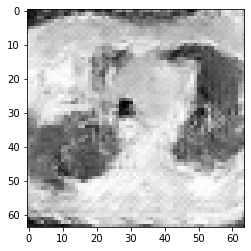

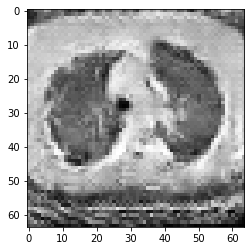

[261/300][0/6]
- D_loss : 0.1067 / G_loss : 1.0686
- D(x) : 0.9435 / D(G(z1)) : 0.0456 / D(G(z2)) : 0.3882 / d_acc : 1.0000
[261/300][1/6]
- D_loss : 0.1809 / G_loss : 0.6013
- D(x) : 0.8816 / D(G(z1)) : 0.0485 / D(G(z2)) : 0.5758 / d_acc : 1.0000
[261/300][2/6]
- D_loss : 0.3025 / G_loss : 0.3064
- D(x) : 0.8176 / D(G(z1)) : 0.0776 / D(G(z2)) : 0.7435 / d_acc : 0.9766
[261/300][3/6]
- D_loss : 0.2909 / G_loss : 1.4689
- D(x) : 0.9846 / D(G(z1)) : 0.2249 / D(G(z2)) : 0.2681 / d_acc : 0.9766
[261/300][4/6]
- D_loss : 0.1704 / G_loss : 1.1642
- D(x) : 0.8920 / D(G(z1)) : 0.0423 / D(G(z2)) : 0.3500 / d_acc : 0.9922
[261/300][5/6]
- D_loss : 0.1687 / G_loss : 0.5410
- D(x) : 0.8844 / D(G(z1)) : 0.0406 / D(G(z2)) : 0.5972 / d_acc : 1.0000


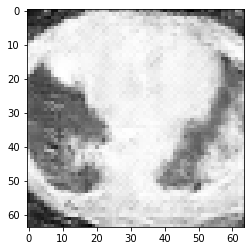

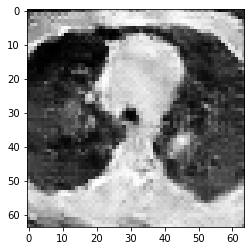

[262/300][0/6]
- D_loss : 0.1178 / G_loss : 0.6495
- D(x) : 0.9689 / D(G(z1)) : 0.0798 / D(G(z2)) : 0.5474 / d_acc : 1.0000
[262/300][1/6]
- D_loss : 0.2180 / G_loss : 1.3217
- D(x) : 0.9468 / D(G(z1)) : 0.1445 / D(G(z2)) : 0.3190 / d_acc : 1.0000
[262/300][2/6]
- D_loss : 0.1563 / G_loss : 0.9467
- D(x) : 0.8945 / D(G(z1)) : 0.0391 / D(G(z2)) : 0.4267 / d_acc : 1.0000
[262/300][3/6]
- D_loss : 0.1472 / G_loss : 0.8664
- D(x) : 0.9191 / D(G(z1)) : 0.0553 / D(G(z2)) : 0.4482 / d_acc : 0.9922
[262/300][4/6]
- D_loss : 0.1379 / G_loss : 0.9179
- D(x) : 0.9399 / D(G(z1)) : 0.0699 / D(G(z2)) : 0.4336 / d_acc : 1.0000
[262/300][5/6]
- D_loss : 0.1450 / G_loss : 0.8442
- D(x) : 0.9281 / D(G(z1)) : 0.0614 / D(G(z2)) : 0.4624 / d_acc : 0.9922


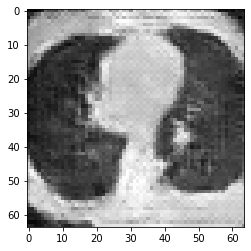

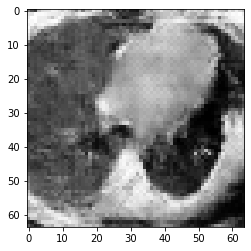

[263/300][0/6]
- D_loss : 0.2164 / G_loss : 0.9857
- D(x) : 0.9278 / D(G(z1)) : 0.1199 / D(G(z2)) : 0.4031 / d_acc : 0.9844
[263/300][1/6]
- D_loss : 0.0892 / G_loss : 1.0175
- D(x) : 0.9428 / D(G(z1)) : 0.0288 / D(G(z2)) : 0.3850 / d_acc : 1.0000
[263/300][2/6]
- D_loss : 0.0933 / G_loss : 1.0180
- D(x) : 0.9520 / D(G(z1)) : 0.0413 / D(G(z2)) : 0.4077 / d_acc : 1.0000
[263/300][3/6]
- D_loss : 0.0776 / G_loss : 1.0546
- D(x) : 0.9630 / D(G(z1)) : 0.0382 / D(G(z2)) : 0.3777 / d_acc : 1.0000
[263/300][4/6]
- D_loss : 0.1794 / G_loss : 0.4468
- D(x) : 0.8941 / D(G(z1)) : 0.0532 / D(G(z2)) : 0.6502 / d_acc : 0.9844
[263/300][5/6]
- D_loss : 0.1543 / G_loss : 1.0657
- D(x) : 0.9593 / D(G(z1)) : 0.1018 / D(G(z2)) : 0.3840 / d_acc : 1.0000


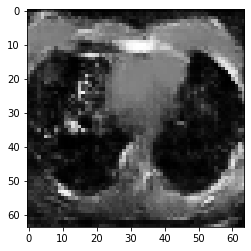

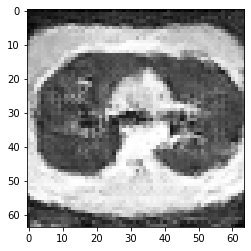

[264/300][0/6]
- D_loss : 0.0914 / G_loss : 1.3119
- D(x) : 0.9661 / D(G(z1)) : 0.0539 / D(G(z2)) : 0.3155 / d_acc : 1.0000
[264/300][1/6]
- D_loss : 0.0673 / G_loss : 1.1647
- D(x) : 0.9526 / D(G(z1)) : 0.0180 / D(G(z2)) : 0.3599 / d_acc : 1.0000
[264/300][2/6]
- D_loss : 0.3056 / G_loss : 0.1341
- D(x) : 0.7648 / D(G(z1)) : 0.0181 / D(G(z2)) : 0.8765 / d_acc : 0.9688
[264/300][3/6]
- D_loss : 0.5379 / G_loss : 2.5807
- D(x) : 0.9950 / D(G(z1)) : 0.3793 / D(G(z2)) : 0.1206 / d_acc : 0.8672
[264/300][4/6]
- D_loss : 0.2392 / G_loss : 1.4941
- D(x) : 0.8480 / D(G(z1)) : 0.0240 / D(G(z2)) : 0.2660 / d_acc : 0.9766
[264/300][5/6]
- D_loss : 0.2155 / G_loss : 0.4471
- D(x) : 0.8493 / D(G(z1)) : 0.0198 / D(G(z2)) : 0.6545 / d_acc : 0.9688


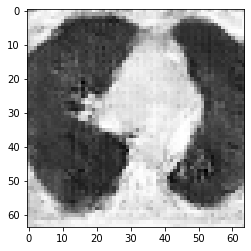

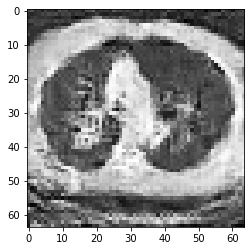

[265/300][0/6]
- D_loss : 0.1696 / G_loss : 0.3873
- D(x) : 0.9469 / D(G(z1)) : 0.1017 / D(G(z2)) : 0.6891 / d_acc : 1.0000
[265/300][1/6]
- D_loss : 0.2503 / G_loss : 1.4431
- D(x) : 0.9824 / D(G(z1)) : 0.1980 / D(G(z2)) : 0.2811 / d_acc : 1.0000
[265/300][2/6]
- D_loss : 0.1018 / G_loss : 1.6791
- D(x) : 0.9185 / D(G(z1)) : 0.0139 / D(G(z2)) : 0.2442 / d_acc : 1.0000
[265/300][3/6]
- D_loss : 0.1414 / G_loss : 0.8767
- D(x) : 0.8846 / D(G(z1)) : 0.0125 / D(G(z2)) : 0.4681 / d_acc : 1.0000
[265/300][4/6]
- D_loss : 0.0886 / G_loss : 0.5347
- D(x) : 0.9539 / D(G(z1)) : 0.0374 / D(G(z2)) : 0.6046 / d_acc : 1.0000
[265/300][5/6]
- D_loss : 0.1736 / G_loss : 0.5531
- D(x) : 0.9327 / D(G(z1)) : 0.0897 / D(G(z2)) : 0.5919 / d_acc : 0.9922


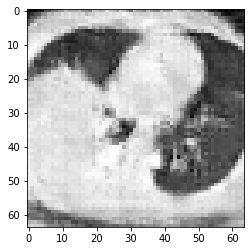

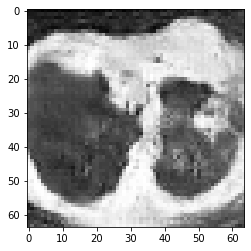

[266/300][0/6]
- D_loss : 0.1947 / G_loss : 1.0326
- D(x) : 0.9323 / D(G(z1)) : 0.1073 / D(G(z2)) : 0.3830 / d_acc : 0.9922
[266/300][1/6]
- D_loss : 0.0598 / G_loss : 1.3646
- D(x) : 0.9788 / D(G(z1)) : 0.0365 / D(G(z2)) : 0.2927 / d_acc : 1.0000
[266/300][2/6]
- D_loss : 0.1321 / G_loss : 0.8946
- D(x) : 0.9283 / D(G(z1)) : 0.0436 / D(G(z2)) : 0.4264 / d_acc : 0.9844
[266/300][3/6]
- D_loss : 0.1284 / G_loss : 0.6936
- D(x) : 0.9288 / D(G(z1)) : 0.0509 / D(G(z2)) : 0.5164 / d_acc : 1.0000
[266/300][4/6]
- D_loss : 0.0864 / G_loss : 0.5264
- D(x) : 0.9484 / D(G(z1)) : 0.0317 / D(G(z2)) : 0.6085 / d_acc : 1.0000
[266/300][5/6]
- D_loss : 0.2205 / G_loss : 1.8213
- D(x) : 0.9848 / D(G(z1)) : 0.1792 / D(G(z2)) : 0.1858 / d_acc : 0.9922


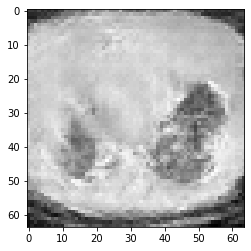

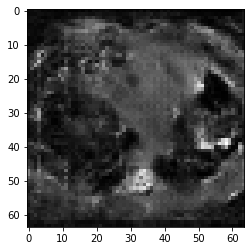

[267/300][0/6]
- D_loss : 0.1101 / G_loss : 1.8757
- D(x) : 0.9156 / D(G(z1)) : 0.0200 / D(G(z2)) : 0.1850 / d_acc : 1.0000
[267/300][1/6]
- D_loss : 0.1976 / G_loss : 0.6547
- D(x) : 0.8354 / D(G(z1)) : 0.0118 / D(G(z2)) : 0.5617 / d_acc : 1.0000
[267/300][2/6]
- D_loss : 0.1029 / G_loss : 0.4602
- D(x) : 0.9673 / D(G(z1)) : 0.0630 / D(G(z2)) : 0.6473 / d_acc : 1.0000
[267/300][3/6]
- D_loss : 0.1561 / G_loss : 1.1428
- D(x) : 0.9887 / D(G(z1)) : 0.1305 / D(G(z2)) : 0.3502 / d_acc : 1.0000
[267/300][4/6]
- D_loss : 0.1088 / G_loss : 1.2051
- D(x) : 0.9439 / D(G(z1)) : 0.0481 / D(G(z2)) : 0.3284 / d_acc : 1.0000
[267/300][5/6]
- D_loss : 0.0694 / G_loss : 1.2078
- D(x) : 0.9593 / D(G(z1)) : 0.0267 / D(G(z2)) : 0.3305 / d_acc : 1.0000


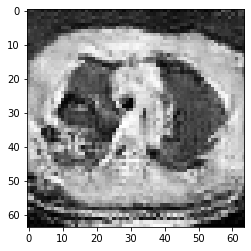

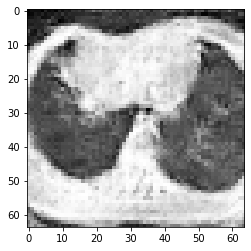

[268/300][0/6]
- D_loss : 0.1037 / G_loss : 0.8018
- D(x) : 0.9348 / D(G(z1)) : 0.0339 / D(G(z2)) : 0.4893 / d_acc : 1.0000
[268/300][1/6]
- D_loss : 0.1000 / G_loss : 0.8316
- D(x) : 0.9638 / D(G(z1)) : 0.0595 / D(G(z2)) : 0.4539 / d_acc : 1.0000
[268/300][2/6]
- D_loss : 0.1093 / G_loss : 0.7759
- D(x) : 0.9456 / D(G(z1)) : 0.0501 / D(G(z2)) : 0.4924 / d_acc : 1.0000
[268/300][3/6]
- D_loss : 0.0869 / G_loss : 0.9350
- D(x) : 0.9574 / D(G(z1)) : 0.0415 / D(G(z2)) : 0.4284 / d_acc : 1.0000
[268/300][4/6]
- D_loss : 0.0816 / G_loss : 1.2051
- D(x) : 0.9801 / D(G(z1)) : 0.0581 / D(G(z2)) : 0.3369 / d_acc : 1.0000
[268/300][5/6]
- D_loss : 0.1807 / G_loss : 0.7151
- D(x) : 0.8698 / D(G(z1)) : 0.0368 / D(G(z2)) : 0.5134 / d_acc : 1.0000


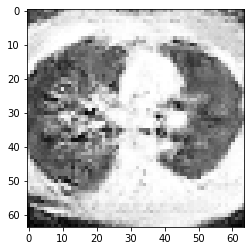

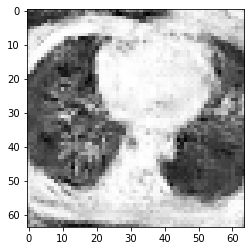

[269/300][0/6]
- D_loss : 0.0832 / G_loss : 0.8638
- D(x) : 0.9705 / D(G(z1)) : 0.0507 / D(G(z2)) : 0.4700 / d_acc : 1.0000
[269/300][1/6]
- D_loss : 0.0603 / G_loss : 0.9835
- D(x) : 0.9842 / D(G(z1)) : 0.0424 / D(G(z2)) : 0.3984 / d_acc : 1.0000
[269/300][2/6]
- D_loss : 0.0669 / G_loss : 1.0207
- D(x) : 0.9700 / D(G(z1)) : 0.0352 / D(G(z2)) : 0.3845 / d_acc : 1.0000
[269/300][3/6]
- D_loss : 0.0607 / G_loss : 0.9672
- D(x) : 0.9754 / D(G(z1)) : 0.0328 / D(G(z2)) : 0.4181 / d_acc : 1.0000
[269/300][4/6]
- D_loss : 0.0602 / G_loss : 1.0570
- D(x) : 0.9615 / D(G(z1)) : 0.0200 / D(G(z2)) : 0.3962 / d_acc : 1.0000
[269/300][5/6]
- D_loss : 0.1015 / G_loss : 1.4478
- D(x) : 0.9662 / D(G(z1)) : 0.0624 / D(G(z2)) : 0.2890 / d_acc : 1.0000


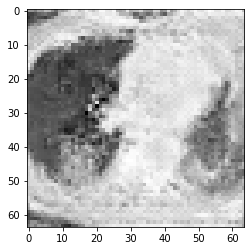

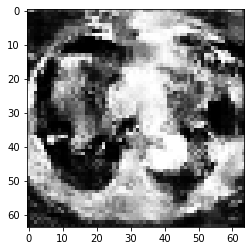

[270/300][0/6]
- D_loss : 0.1009 / G_loss : 1.4140
- D(x) : 0.9468 / D(G(z1)) : 0.0428 / D(G(z2)) : 0.2971 / d_acc : 1.0000
[270/300][1/6]
- D_loss : 0.0702 / G_loss : 1.1936
- D(x) : 0.9572 / D(G(z1)) : 0.0248 / D(G(z2)) : 0.3629 / d_acc : 1.0000
[270/300][2/6]
- D_loss : 0.0665 / G_loss : 0.9791
- D(x) : 0.9775 / D(G(z1)) : 0.0418 / D(G(z2)) : 0.4038 / d_acc : 1.0000
[270/300][3/6]
- D_loss : 0.0737 / G_loss : 1.1028
- D(x) : 0.9578 / D(G(z1)) : 0.0290 / D(G(z2)) : 0.3757 / d_acc : 1.0000
[270/300][4/6]
- D_loss : 0.0707 / G_loss : 1.3083
- D(x) : 0.9864 / D(G(z1)) : 0.0545 / D(G(z2)) : 0.3110 / d_acc : 1.0000
[270/300][5/6]
- D_loss : 0.0862 / G_loss : 1.1152
- D(x) : 0.9414 / D(G(z1)) : 0.0232 / D(G(z2)) : 0.3901 / d_acc : 1.0000


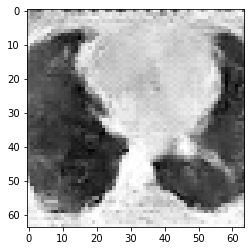

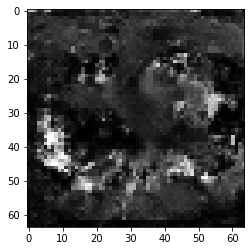

[271/300][0/6]
- D_loss : 0.0554 / G_loss : 0.7141
- D(x) : 0.9585 / D(G(z1)) : 0.0125 / D(G(z2)) : 0.5158 / d_acc : 1.0000
[271/300][1/6]
- D_loss : 0.1262 / G_loss : 1.6408
- D(x) : 0.9908 / D(G(z1)) : 0.1063 / D(G(z2)) : 0.2336 / d_acc : 1.0000
[271/300][2/6]
- D_loss : 0.1000 / G_loss : 1.3483
- D(x) : 0.9357 / D(G(z1)) : 0.0305 / D(G(z2)) : 0.2982 / d_acc : 1.0000
[271/300][3/6]
- D_loss : 0.0673 / G_loss : 1.2643
- D(x) : 0.9615 / D(G(z1)) : 0.0264 / D(G(z2)) : 0.3210 / d_acc : 1.0000
[271/300][4/6]
- D_loss : 0.0685 / G_loss : 0.6617
- D(x) : 0.9577 / D(G(z1)) : 0.0235 / D(G(z2)) : 0.5419 / d_acc : 1.0000
[271/300][5/6]
- D_loss : 0.0721 / G_loss : 0.6653
- D(x) : 0.9655 / D(G(z1)) : 0.0354 / D(G(z2)) : 0.5403 / d_acc : 1.0000


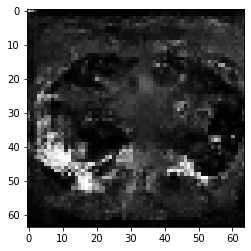

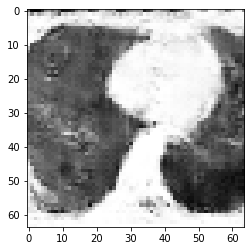

[272/300][0/6]
- D_loss : 0.1244 / G_loss : 2.2371
- D(x) : 0.9921 / D(G(z1)) : 0.1055 / D(G(z2)) : 0.1317 / d_acc : 1.0000
[272/300][1/6]
- D_loss : 0.1132 / G_loss : 1.5223
- D(x) : 0.9083 / D(G(z1)) : 0.0144 / D(G(z2)) : 0.2659 / d_acc : 1.0000
[272/300][2/6]
- D_loss : 0.1339 / G_loss : 0.5776
- D(x) : 0.9010 / D(G(z1)) : 0.0266 / D(G(z2)) : 0.5938 / d_acc : 1.0000
[272/300][3/6]
- D_loss : 0.1050 / G_loss : 1.0369
- D(x) : 0.9853 / D(G(z1)) : 0.0836 / D(G(z2)) : 0.3929 / d_acc : 1.0000
[272/300][4/6]
- D_loss : 0.0679 / G_loss : 1.4070
- D(x) : 0.9759 / D(G(z1)) : 0.0412 / D(G(z2)) : 0.2839 / d_acc : 1.0000
[272/300][5/6]
- D_loss : 0.0880 / G_loss : 1.0531
- D(x) : 0.9488 / D(G(z1)) : 0.0331 / D(G(z2)) : 0.3870 / d_acc : 1.0000


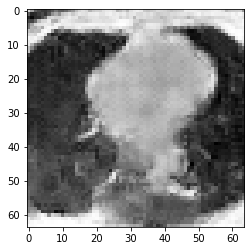

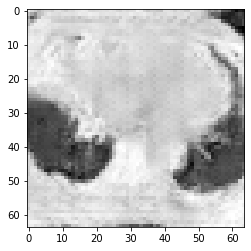

[273/300][0/6]
- D_loss : 0.0586 / G_loss : 0.9629
- D(x) : 0.9696 / D(G(z1)) : 0.0261 / D(G(z2)) : 0.4087 / d_acc : 1.0000
[273/300][1/6]
- D_loss : 0.0864 / G_loss : 1.0940
- D(x) : 0.9605 / D(G(z1)) : 0.0427 / D(G(z2)) : 0.3823 / d_acc : 1.0000
[273/300][2/6]
- D_loss : 0.0651 / G_loss : 1.2703
- D(x) : 0.9654 / D(G(z1)) : 0.0287 / D(G(z2)) : 0.3398 / d_acc : 1.0000
[273/300][3/6]
- D_loss : 0.0689 / G_loss : 1.3330
- D(x) : 0.9842 / D(G(z1)) : 0.0496 / D(G(z2)) : 0.3015 / d_acc : 1.0000
[273/300][4/6]
- D_loss : 0.0417 / G_loss : 1.3907
- D(x) : 0.9786 / D(G(z1)) : 0.0194 / D(G(z2)) : 0.2837 / d_acc : 1.0000
[273/300][5/6]
- D_loss : 0.1607 / G_loss : 0.3797
- D(x) : 0.8706 / D(G(z1)) : 0.0166 / D(G(z2)) : 0.6940 / d_acc : 1.0000


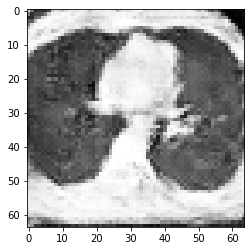

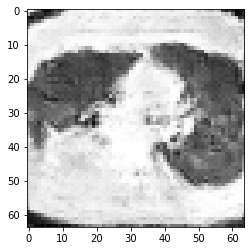

[274/300][0/6]
- D_loss : 0.0900 / G_loss : 0.9037
- D(x) : 0.9943 / D(G(z1)) : 0.0782 / D(G(z2)) : 0.4444 / d_acc : 1.0000
[274/300][1/6]
- D_loss : 0.0724 / G_loss : 1.7030
- D(x) : 0.9889 / D(G(z1)) : 0.0585 / D(G(z2)) : 0.2154 / d_acc : 1.0000
[274/300][2/6]
- D_loss : 0.0599 / G_loss : 1.3826
- D(x) : 0.9644 / D(G(z1)) : 0.0173 / D(G(z2)) : 0.3040 / d_acc : 0.9922
[274/300][3/6]
- D_loss : 0.0487 / G_loss : 0.9002
- D(x) : 0.9645 / D(G(z1)) : 0.0119 / D(G(z2)) : 0.4370 / d_acc : 1.0000
[274/300][4/6]
- D_loss : 0.0566 / G_loss : 0.8646
- D(x) : 0.9736 / D(G(z1)) : 0.0288 / D(G(z2)) : 0.4559 / d_acc : 1.0000
[274/300][5/6]
- D_loss : 0.0528 / G_loss : 0.9054
- D(x) : 0.9764 / D(G(z1)) : 0.0275 / D(G(z2)) : 0.4525 / d_acc : 1.0000


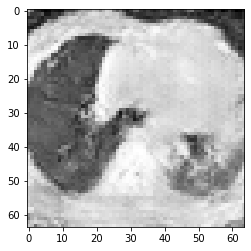

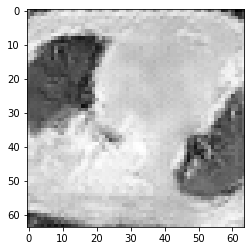

[275/300][0/6]
- D_loss : 0.0571 / G_loss : 0.9025
- D(x) : 0.9755 / D(G(z1)) : 0.0313 / D(G(z2)) : 0.4457 / d_acc : 1.0000
[275/300][1/6]
- D_loss : 0.0663 / G_loss : 0.9234
- D(x) : 0.9688 / D(G(z1)) : 0.0330 / D(G(z2)) : 0.4407 / d_acc : 1.0000
[275/300][2/6]
- D_loss : 0.1110 / G_loss : 0.5938
- D(x) : 0.9302 / D(G(z1)) : 0.0325 / D(G(z2)) : 0.5751 / d_acc : 0.9922
[275/300][3/6]
- D_loss : 0.0831 / G_loss : 1.7038
- D(x) : 0.9926 / D(G(z1)) : 0.0691 / D(G(z2)) : 0.2141 / d_acc : 1.0000
[275/300][4/6]
- D_loss : 0.0568 / G_loss : 1.7101
- D(x) : 0.9609 / D(G(z1)) : 0.0158 / D(G(z2)) : 0.2284 / d_acc : 1.0000
[275/300][5/6]
- D_loss : 0.0633 / G_loss : 1.0899
- D(x) : 0.9533 / D(G(z1)) : 0.0148 / D(G(z2)) : 0.3768 / d_acc : 1.0000


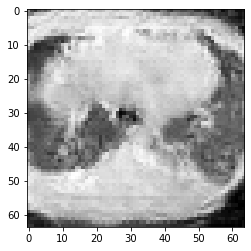

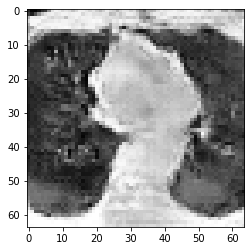

[276/300][0/6]
- D_loss : 0.0507 / G_loss : 0.9628
- D(x) : 0.9863 / D(G(z1)) : 0.0351 / D(G(z2)) : 0.4164 / d_acc : 1.0000
[276/300][1/6]
- D_loss : 0.1359 / G_loss : 0.6641
- D(x) : 0.9185 / D(G(z1)) : 0.0448 / D(G(z2)) : 0.5425 / d_acc : 1.0000
[276/300][2/6]
- D_loss : 0.0858 / G_loss : 1.7621
- D(x) : 0.9945 / D(G(z1)) : 0.0743 / D(G(z2)) : 0.2023 / d_acc : 1.0000
[276/300][3/6]
- D_loss : 0.0739 / G_loss : 1.7196
- D(x) : 0.9484 / D(G(z1)) : 0.0177 / D(G(z2)) : 0.2225 / d_acc : 1.0000
[276/300][4/6]
- D_loss : 0.0615 / G_loss : 0.9905
- D(x) : 0.9624 / D(G(z1)) : 0.0219 / D(G(z2)) : 0.4116 / d_acc : 1.0000
[276/300][5/6]
- D_loss : 0.1256 / G_loss : 0.5919
- D(x) : 0.9250 / D(G(z1)) : 0.0428 / D(G(z2)) : 0.5690 / d_acc : 1.0000


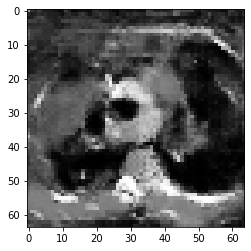

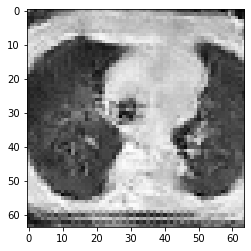

[277/300][0/6]
- D_loss : 0.1431 / G_loss : 2.7977
- D(x) : 0.9789 / D(G(z1)) : 0.1106 / D(G(z2)) : 0.1188 / d_acc : 1.0000
[277/300][1/6]
- D_loss : 0.0594 / G_loss : 2.1805
- D(x) : 0.9548 / D(G(z1)) : 0.0101 / D(G(z2)) : 0.1646 / d_acc : 1.0000
[277/300][2/6]
- D_loss : 0.0508 / G_loss : 1.5154
- D(x) : 0.9681 / D(G(z1)) : 0.0160 / D(G(z2)) : 0.2811 / d_acc : 1.0000
[277/300][3/6]
- D_loss : 0.0490 / G_loss : 1.3264
- D(x) : 0.9762 / D(G(z1)) : 0.0241 / D(G(z2)) : 0.3009 / d_acc : 1.0000
[277/300][4/6]
- D_loss : 0.0657 / G_loss : 0.9119
- D(x) : 0.9623 / D(G(z1)) : 0.0243 / D(G(z2)) : 0.4435 / d_acc : 1.0000
[277/300][5/6]
- D_loss : 0.0944 / G_loss : 1.5908
- D(x) : 0.9617 / D(G(z1)) : 0.0520 / D(G(z2)) : 0.2636 / d_acc : 1.0000


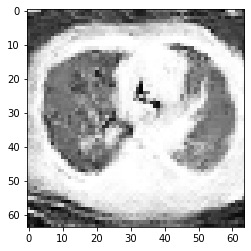

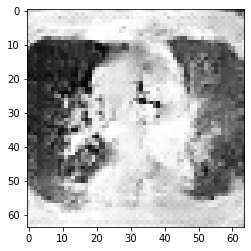

[278/300][0/6]
- D_loss : 0.0530 / G_loss : 1.5141
- D(x) : 0.9664 / D(G(z1)) : 0.0180 / D(G(z2)) : 0.2682 / d_acc : 1.0000
[278/300][1/6]
- D_loss : 0.0345 / G_loss : 1.4409
- D(x) : 0.9904 / D(G(z1)) : 0.0242 / D(G(z2)) : 0.2983 / d_acc : 1.0000
[278/300][2/6]
- D_loss : 0.0735 / G_loss : 2.2852
- D(x) : 0.9848 / D(G(z1)) : 0.0542 / D(G(z2)) : 0.1413 / d_acc : 1.0000
[278/300][3/6]
- D_loss : 0.0686 / G_loss : 1.5005
- D(x) : 0.9555 / D(G(z1)) : 0.0210 / D(G(z2)) : 0.2562 / d_acc : 1.0000
[278/300][4/6]
- D_loss : 0.1409 / G_loss : 0.5282
- D(x) : 0.9118 / D(G(z1)) : 0.0282 / D(G(z2)) : 0.6126 / d_acc : 0.9844
[278/300][5/6]
- D_loss : 0.1931 / G_loss : 5.6198
- D(x) : 0.9961 / D(G(z1)) : 0.1585 / D(G(z2)) : 0.0297 / d_acc : 0.9844


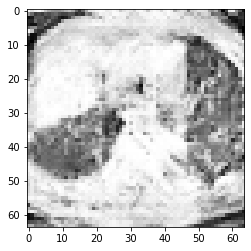

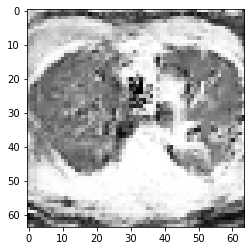

[279/300][0/6]
- D_loss : 0.1489 / G_loss : 2.8381
- D(x) : 0.9261 / D(G(z1)) : 0.0024 / D(G(z2)) : 0.1450 / d_acc : 0.9844
[279/300][1/6]
- D_loss : 0.0884 / G_loss : 0.4048
- D(x) : 0.9424 / D(G(z1)) : 0.0198 / D(G(z2)) : 0.6873 / d_acc : 0.9922
[279/300][2/6]
- D_loss : 0.2049 / G_loss : 4.0840
- D(x) : 0.9891 / D(G(z1)) : 0.1588 / D(G(z2)) : 0.0240 / d_acc : 0.9688
[279/300][3/6]
- D_loss : 0.1292 / G_loss : 2.1327
- D(x) : 0.8887 / D(G(z1)) : 0.0042 / D(G(z2)) : 0.1715 / d_acc : 1.0000
[279/300][4/6]
- D_loss : 0.2304 / G_loss : 0.3894
- D(x) : 0.8560 / D(G(z1)) : 0.0560 / D(G(z2)) : 0.6874 / d_acc : 0.9844
[279/300][5/6]
- D_loss : 0.1379 / G_loss : 2.5175
- D(x) : 0.9901 / D(G(z1)) : 0.1074 / D(G(z2)) : 0.2124 / d_acc : 0.9922


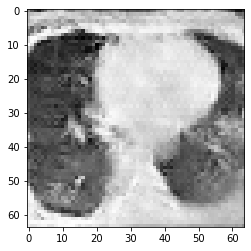

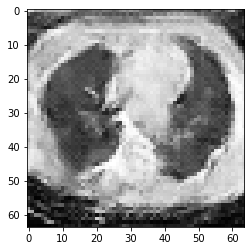

[280/300][0/6]
- D_loss : 0.0855 / G_loss : 3.2337
- D(x) : 0.9747 / D(G(z1)) : 0.0550 / D(G(z2)) : 0.0857 / d_acc : 1.0000
[280/300][1/6]
- D_loss : 0.0859 / G_loss : 1.2769
- D(x) : 0.9403 / D(G(z1)) : 0.0118 / D(G(z2)) : 0.3325 / d_acc : 0.9922
[280/300][2/6]
- D_loss : 0.1003 / G_loss : 1.2164
- D(x) : 0.9593 / D(G(z1)) : 0.0535 / D(G(z2)) : 0.3654 / d_acc : 1.0000
[280/300][3/6]
- D_loss : 0.1253 / G_loss : 3.4944
- D(x) : 0.9818 / D(G(z1)) : 0.0969 / D(G(z2)) : 0.0671 / d_acc : 1.0000
[280/300][4/6]
- D_loss : 0.2834 / G_loss : 1.4069
- D(x) : 0.8611 / D(G(z1)) : 0.0090 / D(G(z2)) : 0.2836 / d_acc : 0.9922
[280/300][5/6]
- D_loss : 0.0950 / G_loss : 0.7301
- D(x) : 0.9628 / D(G(z1)) : 0.0424 / D(G(z2)) : 0.5095 / d_acc : 0.9922


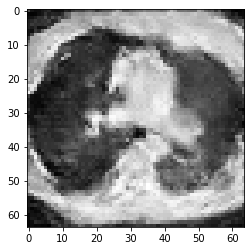

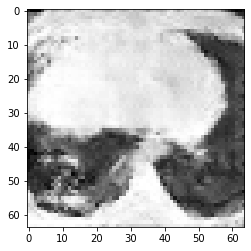

[281/300][0/6]
- D_loss : 0.2459 / G_loss : 6.0869
- D(x) : 0.9589 / D(G(z1)) : 0.1711 / D(G(z2)) : 0.0280 / d_acc : 0.9922
[281/300][1/6]
- D_loss : 0.1315 / G_loss : 4.1224
- D(x) : 0.9046 / D(G(z1)) : 0.0053 / D(G(z2)) : 0.1211 / d_acc : 0.9844
[281/300][2/6]
- D_loss : 0.1448 / G_loss : 0.8845
- D(x) : 0.9250 / D(G(z1)) : 0.0178 / D(G(z2)) : 0.4919 / d_acc : 0.9844
[281/300][3/6]
- D_loss : 0.2261 / G_loss : 2.6174
- D(x) : 0.9730 / D(G(z1)) : 0.1235 / D(G(z2)) : 0.1994 / d_acc : 0.9844
[281/300][4/6]
- D_loss : 0.0847 / G_loss : 2.8116
- D(x) : 0.9688 / D(G(z1)) : 0.0463 / D(G(z2)) : 0.1210 / d_acc : 1.0000
[281/300][5/6]
- D_loss : 0.1116 / G_loss : 1.5315
- D(x) : 0.9172 / D(G(z1)) : 0.0162 / D(G(z2)) : 0.3148 / d_acc : 0.9922


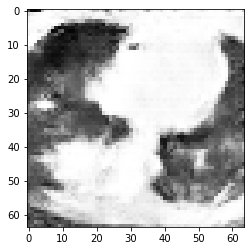

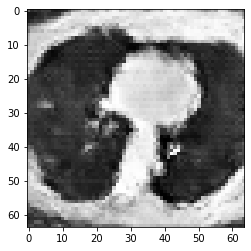

[282/300][0/6]
- D_loss : 0.1075 / G_loss : 2.0579
- D(x) : 0.9684 / D(G(z1)) : 0.0692 / D(G(z2)) : 0.1903 / d_acc : 1.0000
[282/300][1/6]
- D_loss : 0.1555 / G_loss : 0.9082
- D(x) : 0.8954 / D(G(z1)) : 0.0216 / D(G(z2)) : 0.4678 / d_acc : 0.9922
[282/300][2/6]
- D_loss : 0.1303 / G_loss : 2.3437
- D(x) : 0.9942 / D(G(z1)) : 0.1128 / D(G(z2)) : 0.1285 / d_acc : 1.0000
[282/300][3/6]
- D_loss : 0.1490 / G_loss : 1.7788
- D(x) : 0.9564 / D(G(z1)) : 0.0228 / D(G(z2)) : 0.2392 / d_acc : 0.9844
[282/300][4/6]
- D_loss : 0.1057 / G_loss : 2.8736
- D(x) : 0.9577 / D(G(z1)) : 0.0569 / D(G(z2)) : 0.1295 / d_acc : 1.0000
[282/300][5/6]
- D_loss : 0.1173 / G_loss : 1.8069
- D(x) : 0.9068 / D(G(z1)) : 0.0150 / D(G(z2)) : 0.3022 / d_acc : 1.0000


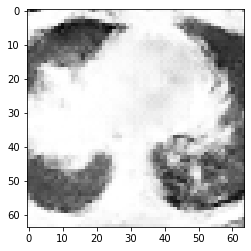

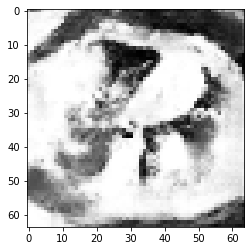

[283/300][0/6]
- D_loss : 0.0650 / G_loss : 1.2955
- D(x) : 0.9820 / D(G(z1)) : 0.0445 / D(G(z2)) : 0.3647 / d_acc : 1.0000
[283/300][1/6]
- D_loss : 0.1314 / G_loss : 1.9210
- D(x) : 0.9556 / D(G(z1)) : 0.0766 / D(G(z2)) : 0.1870 / d_acc : 1.0000
[283/300][2/6]
- D_loss : 0.0513 / G_loss : 2.7605
- D(x) : 0.9832 / D(G(z1)) : 0.0333 / D(G(z2)) : 0.0747 / d_acc : 1.0000
[283/300][3/6]
- D_loss : 0.0258 / G_loss : 2.5708
- D(x) : 0.9849 / D(G(z1)) : 0.0103 / D(G(z2)) : 0.1153 / d_acc : 1.0000
[283/300][4/6]
- D_loss : 0.0679 / G_loss : 1.3767
- D(x) : 0.9559 / D(G(z1)) : 0.0180 / D(G(z2)) : 0.3007 / d_acc : 0.9922
[283/300][5/6]
- D_loss : 0.0760 / G_loss : 1.2826
- D(x) : 0.9693 / D(G(z1)) : 0.0422 / D(G(z2)) : 0.3253 / d_acc : 1.0000


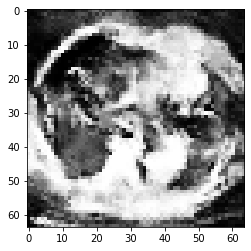

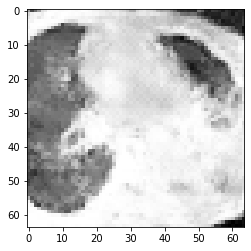

[284/300][0/6]
- D_loss : 0.0710 / G_loss : 2.1570
- D(x) : 0.9858 / D(G(z1)) : 0.0541 / D(G(z2)) : 0.1364 / d_acc : 1.0000
[284/300][1/6]
- D_loss : 0.1314 / G_loss : 1.0847
- D(x) : 0.8954 / D(G(z1)) : 0.0152 / D(G(z2)) : 0.3802 / d_acc : 1.0000
[284/300][2/6]
- D_loss : 0.0803 / G_loss : 1.8934
- D(x) : 0.9857 / D(G(z1)) : 0.0618 / D(G(z2)) : 0.1916 / d_acc : 1.0000
[284/300][3/6]
- D_loss : 0.0566 / G_loss : 2.1405
- D(x) : 0.9732 / D(G(z1)) : 0.0281 / D(G(z2)) : 0.1602 / d_acc : 1.0000
[284/300][4/6]
- D_loss : 0.0331 / G_loss : 2.0051
- D(x) : 0.9804 / D(G(z1)) : 0.0127 / D(G(z2)) : 0.1777 / d_acc : 1.0000
[284/300][5/6]
- D_loss : 0.0448 / G_loss : 2.1577
- D(x) : 0.9856 / D(G(z1)) : 0.0294 / D(G(z2)) : 0.1460 / d_acc : 1.0000


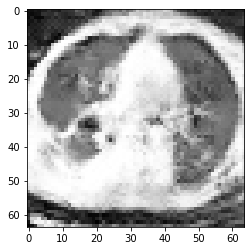

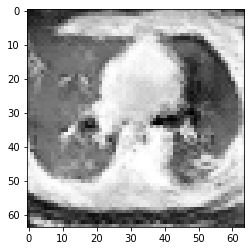

[285/300][0/6]
- D_loss : 0.0345 / G_loss : 1.8424
- D(x) : 0.9773 / D(G(z1)) : 0.0113 / D(G(z2)) : 0.1997 / d_acc : 1.0000
[285/300][1/6]
- D_loss : 0.0538 / G_loss : 1.4687
- D(x) : 0.9726 / D(G(z1)) : 0.0249 / D(G(z2)) : 0.2753 / d_acc : 1.0000
[285/300][2/6]
- D_loss : 0.0533 / G_loss : 2.0824
- D(x) : 0.9831 / D(G(z1)) : 0.0347 / D(G(z2)) : 0.1570 / d_acc : 1.0000
[285/300][3/6]
- D_loss : 0.0728 / G_loss : 1.7418
- D(x) : 0.9500 / D(G(z1)) : 0.0196 / D(G(z2)) : 0.2075 / d_acc : 1.0000
[285/300][4/6]
- D_loss : 0.0528 / G_loss : 1.8805
- D(x) : 0.9802 / D(G(z1)) : 0.0303 / D(G(z2)) : 0.1820 / d_acc : 1.0000
[285/300][5/6]
- D_loss : 0.0488 / G_loss : 2.1978
- D(x) : 0.9771 / D(G(z1)) : 0.0239 / D(G(z2)) : 0.1346 / d_acc : 1.0000


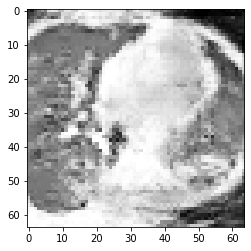

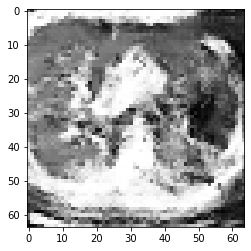

[286/300][0/6]
- D_loss : 0.0446 / G_loss : 2.3581
- D(x) : 0.9804 / D(G(z1)) : 0.0239 / D(G(z2)) : 0.1175 / d_acc : 1.0000
[286/300][1/6]
- D_loss : 0.0244 / G_loss : 2.6807
- D(x) : 0.9898 / D(G(z1)) : 0.0139 / D(G(z2)) : 0.0971 / d_acc : 1.0000
[286/300][2/6]
- D_loss : 0.0573 / G_loss : 1.4594
- D(x) : 0.9558 / D(G(z1)) : 0.0110 / D(G(z2)) : 0.2854 / d_acc : 1.0000
[286/300][3/6]
- D_loss : 0.0553 / G_loss : 2.5698
- D(x) : 0.9937 / D(G(z1)) : 0.0470 / D(G(z2)) : 0.0999 / d_acc : 1.0000
[286/300][4/6]
- D_loss : 0.0331 / G_loss : 2.8994
- D(x) : 0.9840 / D(G(z1)) : 0.0166 / D(G(z2)) : 0.0793 / d_acc : 1.0000
[286/300][5/6]
- D_loss : 0.0547 / G_loss : 2.0381
- D(x) : 0.9617 / D(G(z1)) : 0.0148 / D(G(z2)) : 0.1754 / d_acc : 1.0000


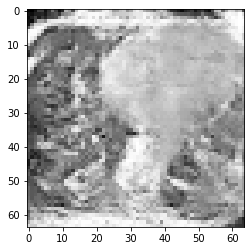

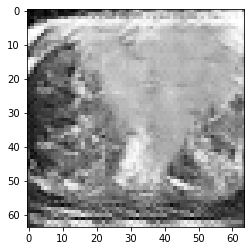

[287/300][0/6]
- D_loss : 0.0389 / G_loss : 2.0719
- D(x) : 0.9813 / D(G(z1)) : 0.0195 / D(G(z2)) : 0.1487 / d_acc : 1.0000
[287/300][1/6]
- D_loss : 0.0521 / G_loss : 2.7894
- D(x) : 0.9838 / D(G(z1)) : 0.0345 / D(G(z2)) : 0.0934 / d_acc : 1.0000
[287/300][2/6]
- D_loss : 0.0189 / G_loss : 2.5366
- D(x) : 0.9894 / D(G(z1)) : 0.0081 / D(G(z2)) : 0.1061 / d_acc : 1.0000
[287/300][3/6]
- D_loss : 0.0388 / G_loss : 2.2873
- D(x) : 0.9794 / D(G(z1)) : 0.0173 / D(G(z2)) : 0.1382 / d_acc : 1.0000
[287/300][4/6]
- D_loss : 0.0359 / G_loss : 1.5960
- D(x) : 0.9761 / D(G(z1)) : 0.0112 / D(G(z2)) : 0.2471 / d_acc : 1.0000
[287/300][5/6]
- D_loss : 0.1170 / G_loss : 5.4915
- D(x) : 0.9914 / D(G(z1)) : 0.0998 / D(G(z2)) : 0.0075 / d_acc : 1.0000


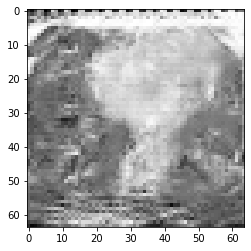

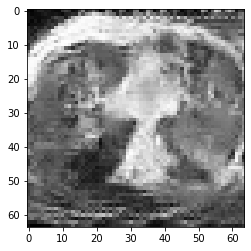

[288/300][0/6]
- D_loss : 0.0943 / G_loss : 3.9039
- D(x) : 0.9153 / D(G(z1)) : 0.0012 / D(G(z2)) : 0.0603 / d_acc : 1.0000
[288/300][1/6]
- D_loss : 0.0615 / G_loss : 1.7292
- D(x) : 0.9486 / D(G(z1)) : 0.0070 / D(G(z2)) : 0.2676 / d_acc : 1.0000
[288/300][2/6]
- D_loss : 0.1466 / G_loss : 3.7214
- D(x) : 0.9868 / D(G(z1)) : 0.1130 / D(G(z2)) : 0.0987 / d_acc : 0.9922
[288/300][3/6]
- D_loss : 0.0632 / G_loss : 3.8270
- D(x) : 0.9559 / D(G(z1)) : 0.0148 / D(G(z2)) : 0.0377 / d_acc : 1.0000
[288/300][4/6]
- D_loss : 0.0244 / G_loss : 3.0703
- D(x) : 0.9862 / D(G(z1)) : 0.0101 / D(G(z2)) : 0.0890 / d_acc : 1.0000
[288/300][5/6]
- D_loss : 0.0452 / G_loss : 2.9288
- D(x) : 0.9872 / D(G(z1)) : 0.0308 / D(G(z2)) : 0.1085 / d_acc : 1.0000


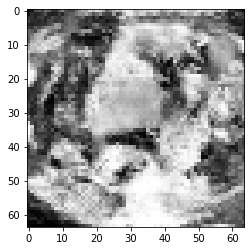

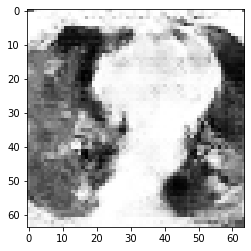

[289/300][0/6]
- D_loss : 0.0399 / G_loss : 3.4246
- D(x) : 0.9875 / D(G(z1)) : 0.0265 / D(G(z2)) : 0.0695 / d_acc : 1.0000
[289/300][1/6]
- D_loss : 0.0267 / G_loss : 2.8748
- D(x) : 0.9845 / D(G(z1)) : 0.0107 / D(G(z2)) : 0.1028 / d_acc : 1.0000
[289/300][2/6]
- D_loss : 0.0500 / G_loss : 0.8110
- D(x) : 0.9568 / D(G(z1)) : 0.0049 / D(G(z2)) : 0.5265 / d_acc : 1.0000
[289/300][3/6]
- D_loss : 0.2508 / G_loss : 12.7768
- D(x) : 0.9893 / D(G(z1)) : 0.1957 / D(G(z2)) : 0.0000 / d_acc : 0.9766
[289/300][4/6]
- D_loss : 4.0555 / G_loss : 0.1950
- D(x) : 0.0666 / D(G(z1)) : 0.0000 / D(G(z2)) : 0.8461 / d_acc : 0.5156
[289/300][5/6]
- D_loss : 1.7554 / G_loss : 7.6857
- D(x) : 0.9754 / D(G(z1)) : 0.7561 / D(G(z2)) : 0.0018 / d_acc : 0.5391


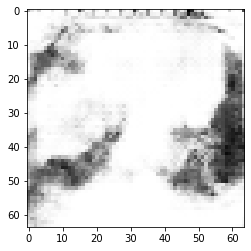

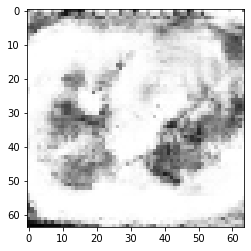

[290/300][0/6]
- D_loss : 3.9707 / G_loss : 0.0199
- D(x) : 0.0482 / D(G(z1)) : 0.0040 / D(G(z2)) : 0.9806 / d_acc : 0.5000
[290/300][1/6]
- D_loss : 4.0421 / G_loss : 3.9627
- D(x) : 0.9723 / D(G(z1)) : 0.9643 / D(G(z2)) : 0.3441 / d_acc : 0.4922
[290/300][2/6]
- D_loss : 0.7783 / G_loss : 3.0145
- D(x) : 0.8995 / D(G(z1)) : 0.4055 / D(G(z2)) : 0.2592 / d_acc : 0.8359
[290/300][3/6]
- D_loss : 2.3642 / G_loss : 1.7938
- D(x) : 0.3116 / D(G(z1)) : 0.3258 / D(G(z2)) : 0.4296 / d_acc : 0.4688
[290/300][4/6]
- D_loss : 0.8644 / G_loss : 2.4533
- D(x) : 0.8770 / D(G(z1)) : 0.4066 / D(G(z2)) : 0.1289 / d_acc : 0.8281
[290/300][5/6]
- D_loss : 0.7071 / G_loss : 1.1091
- D(x) : 0.8296 / D(G(z1)) : 0.2829 / D(G(z2)) : 0.4175 / d_acc : 0.8984


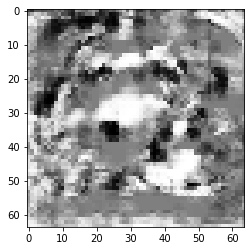

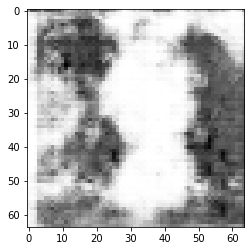

[291/300][0/6]
- D_loss : 1.7472 / G_loss : 5.8298
- D(x) : 0.7173 / D(G(z1)) : 0.6543 / D(G(z2)) : 0.0218 / d_acc : 0.5234
[291/300][1/6]
- D_loss : 2.5860 / G_loss : 0.0461
- D(x) : 0.1752 / D(G(z1)) : 0.0505 / D(G(z2)) : 0.9573 / d_acc : 0.5312
[291/300][2/6]
- D_loss : 3.6482 / G_loss : 6.7556
- D(x) : 0.8704 / D(G(z1)) : 0.9206 / D(G(z2)) : 0.0304 / d_acc : 0.4688
[291/300][3/6]
- D_loss : 4.7133 / G_loss : 0.3889
- D(x) : 0.1386 / D(G(z1)) : 0.0470 / D(G(z2)) : 0.8215 / d_acc : 0.5547
[291/300][4/6]
- D_loss : 2.3605 / G_loss : 0.8702
- D(x) : 0.8536 / D(G(z1)) : 0.7758 / D(G(z2)) : 0.5220 / d_acc : 0.5156
[291/300][5/6]
- D_loss : 1.8858 / G_loss : 1.6884
- D(x) : 0.5386 / D(G(z1)) : 0.5047 / D(G(z2)) : 0.3265 / d_acc : 0.4609


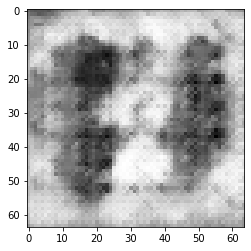

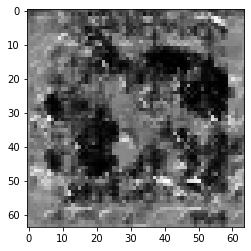

[292/300][0/6]
- D_loss : 1.3695 / G_loss : 0.4090
- D(x) : 0.5511 / D(G(z1)) : 0.3538 / D(G(z2)) : 0.6961 / d_acc : 0.6328
[292/300][1/6]
- D_loss : 1.6878 / G_loss : 2.6790
- D(x) : 0.7691 / D(G(z1)) : 0.6129 / D(G(z2)) : 0.1745 / d_acc : 0.6719
[292/300][2/6]
- D_loss : 1.4221 / G_loss : 0.1615
- D(x) : 0.4565 / D(G(z1)) : 0.1953 / D(G(z2)) : 0.8564 / d_acc : 0.7266
[292/300][3/6]
- D_loss : 2.2206 / G_loss : 3.2955
- D(x) : 0.8657 / D(G(z1)) : 0.8278 / D(G(z2)) : 0.0465 / d_acc : 0.5078
[292/300][4/6]
- D_loss : 1.7916 / G_loss : 0.2389
- D(x) : 0.2996 / D(G(z1)) : 0.0648 / D(G(z2)) : 0.7973 / d_acc : 0.6172
[292/300][5/6]
- D_loss : 2.1254 / G_loss : 3.7753
- D(x) : 0.7843 / D(G(z1)) : 0.7974 / D(G(z2)) : 0.0831 / d_acc : 0.4844


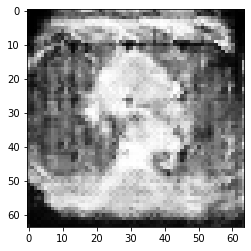

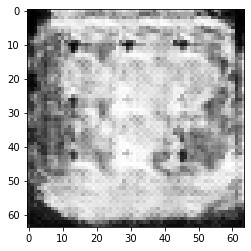

[293/300][0/6]
- D_loss : 0.8546 / G_loss : 0.7114
- D(x) : 0.6196 / D(G(z1)) : 0.1007 / D(G(z2)) : 0.5400 / d_acc : 0.8672
[293/300][1/6]
- D_loss : 1.2536 / G_loss : 2.6890
- D(x) : 0.7149 / D(G(z1)) : 0.5306 / D(G(z2)) : 0.1109 / d_acc : 0.6641
[293/300][2/6]
- D_loss : 0.7890 / G_loss : 0.4688
- D(x) : 0.5673 / D(G(z1)) : 0.1053 / D(G(z2)) : 0.6546 / d_acc : 0.7812
[293/300][3/6]
- D_loss : 1.2356 / G_loss : 2.0860
- D(x) : 0.7191 / D(G(z1)) : 0.5331 / D(G(z2)) : 0.1887 / d_acc : 0.6406
[293/300][4/6]
- D_loss : 0.7280 / G_loss : 1.0549
- D(x) : 0.6953 / D(G(z1)) : 0.2383 / D(G(z2)) : 0.5528 / d_acc : 0.8672
[293/300][5/6]
- D_loss : 1.1158 / G_loss : 5.6857
- D(x) : 0.7630 / D(G(z1)) : 0.4833 / D(G(z2)) : 0.0215 / d_acc : 0.6406


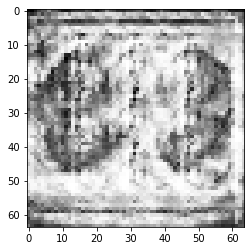

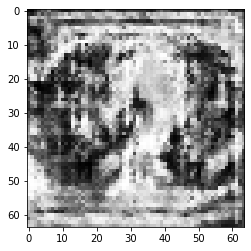

[294/300][0/6]
- D_loss : 1.0346 / G_loss : 0.4117
- D(x) : 0.4400 / D(G(z1)) : 0.0147 / D(G(z2)) : 0.6753 / d_acc : 0.6719
[294/300][1/6]
- D_loss : 1.0758 / G_loss : 4.1108
- D(x) : 0.8440 / D(G(z1)) : 0.5553 / D(G(z2)) : 0.0402 / d_acc : 0.6562
[294/300][2/6]
- D_loss : 0.4784 / G_loss : 0.7415
- D(x) : 0.6996 / D(G(z1)) : 0.0583 / D(G(z2)) : 0.4974 / d_acc : 0.8984
[294/300][3/6]
- D_loss : 0.9297 / G_loss : 3.7145
- D(x) : 0.8227 / D(G(z1)) : 0.4860 / D(G(z2)) : 0.0314 / d_acc : 0.7344
[294/300][4/6]
- D_loss : 0.5968 / G_loss : 0.7055
- D(x) : 0.6566 / D(G(z1)) : 0.0209 / D(G(z2)) : 0.5378 / d_acc : 0.8750
[294/300][5/6]
- D_loss : 0.8574 / G_loss : 4.2697
- D(x) : 0.8506 / D(G(z1)) : 0.4610 / D(G(z2)) : 0.0349 / d_acc : 0.7734


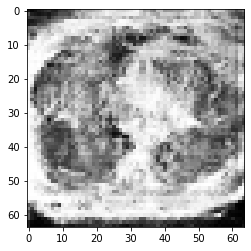

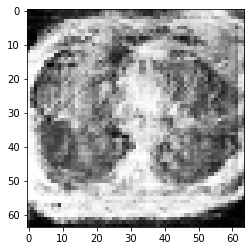

[295/300][0/6]
- D_loss : 0.5247 / G_loss : 0.8620
- D(x) : 0.6534 / D(G(z1)) : 0.0402 / D(G(z2)) : 0.4964 / d_acc : 0.8984
[295/300][1/6]
- D_loss : 0.8543 / G_loss : 2.8661
- D(x) : 0.7607 / D(G(z1)) : 0.3928 / D(G(z2)) : 0.0775 / d_acc : 0.8359
[295/300][2/6]
- D_loss : 0.3500 / G_loss : 0.8367
- D(x) : 0.7623 / D(G(z1)) : 0.0515 / D(G(z2)) : 0.4617 / d_acc : 0.9609
[295/300][3/6]
- D_loss : 0.4801 / G_loss : 3.2414
- D(x) : 0.9127 / D(G(z1)) : 0.3080 / D(G(z2)) : 0.0444 / d_acc : 0.9766
[295/300][4/6]
- D_loss : 0.6114 / G_loss : 0.6392
- D(x) : 0.6350 / D(G(z1)) : 0.0288 / D(G(z2)) : 0.5516 / d_acc : 0.8672
[295/300][5/6]
- D_loss : 0.8105 / G_loss : 3.7098
- D(x) : 0.8448 / D(G(z1)) : 0.4313 / D(G(z2)) : 0.0604 / d_acc : 0.8203


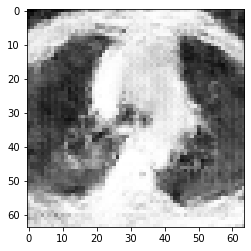

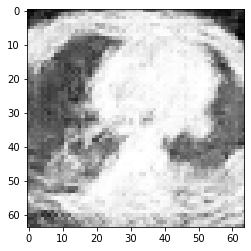

[296/300][0/6]
- D_loss : 0.3810 / G_loss : 1.7912
- D(x) : 0.7271 / D(G(z1)) : 0.0227 / D(G(z2)) : 0.3121 / d_acc : 0.9297
[296/300][1/6]
- D_loss : 0.3586 / G_loss : 1.8117
- D(x) : 0.9102 / D(G(z1)) : 0.2146 / D(G(z2)) : 0.1941 / d_acc : 0.9844
[296/300][2/6]
- D_loss : 0.2856 / G_loss : 1.8883
- D(x) : 0.8774 / D(G(z1)) : 0.1285 / D(G(z2)) : 0.1863 / d_acc : 0.9766
[296/300][3/6]
- D_loss : 0.2858 / G_loss : 1.9667
- D(x) : 0.8680 / D(G(z1)) : 0.1194 / D(G(z2)) : 0.1909 / d_acc : 0.9922
[296/300][4/6]
- D_loss : 0.4376 / G_loss : 0.6381
- D(x) : 0.7391 / D(G(z1)) : 0.0795 / D(G(z2)) : 0.5515 / d_acc : 0.9297
[296/300][5/6]
- D_loss : 0.7067 / G_loss : 4.6657
- D(x) : 0.9285 / D(G(z1)) : 0.4272 / D(G(z2)) : 0.0174 / d_acc : 0.7969


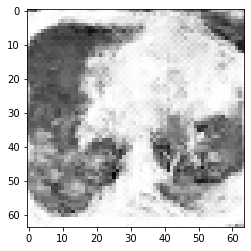

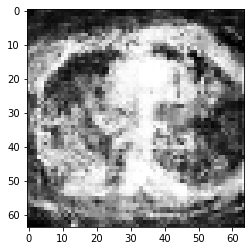

[297/300][0/6]
- D_loss : 0.6815 / G_loss : 0.7905
- D(x) : 0.5705 / D(G(z1)) : 0.0074 / D(G(z2)) : 0.5020 / d_acc : 0.8125
[297/300][1/6]
- D_loss : 0.7880 / G_loss : 3.8929
- D(x) : 0.9451 / D(G(z1)) : 0.4623 / D(G(z2)) : 0.0765 / d_acc : 0.7734
[297/300][2/6]
- D_loss : 0.5048 / G_loss : 1.4256
- D(x) : 0.6676 / D(G(z1)) : 0.0197 / D(G(z2)) : 0.3555 / d_acc : 0.9141
[297/300][3/6]
- D_loss : 0.4975 / G_loss : 1.0471
- D(x) : 0.8084 / D(G(z1)) : 0.2080 / D(G(z2)) : 0.3999 / d_acc : 0.9375
[297/300][4/6]
- D_loss : 0.4813 / G_loss : 2.3763
- D(x) : 0.9114 / D(G(z1)) : 0.2892 / D(G(z2)) : 0.1273 / d_acc : 0.8828
[297/300][5/6]
- D_loss : 0.1791 / G_loss : 2.4107
- D(x) : 0.9122 / D(G(z1)) : 0.0749 / D(G(z2)) : 0.1311 / d_acc : 0.9922


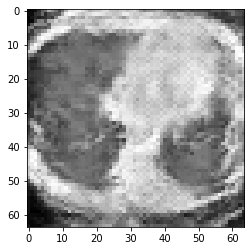

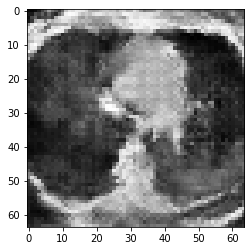

[298/300][0/6]
- D_loss : 0.3113 / G_loss : 1.1705
- D(x) : 0.8188 / D(G(z1)) : 0.0750 / D(G(z2)) : 0.3430 / d_acc : 0.9609
[298/300][1/6]
- D_loss : 0.6202 / G_loss : 1.0003
- D(x) : 0.7069 / D(G(z1)) : 0.1971 / D(G(z2)) : 0.3857 / d_acc : 0.9297
[298/300][2/6]
- D_loss : 0.3348 / G_loss : 3.1506
- D(x) : 0.9496 / D(G(z1)) : 0.2372 / D(G(z2)) : 0.0591 / d_acc : 0.9844
[298/300][3/6]
- D_loss : 0.1573 / G_loss : 2.5647
- D(x) : 0.8820 / D(G(z1)) : 0.0248 / D(G(z2)) : 0.1022 / d_acc : 1.0000
[298/300][4/6]
- D_loss : 0.3152 / G_loss : 0.8233
- D(x) : 0.8021 / D(G(z1)) : 0.0503 / D(G(z2)) : 0.4623 / d_acc : 0.9688
[298/300][5/6]
- D_loss : 0.4587 / G_loss : 3.3177
- D(x) : 0.9351 / D(G(z1)) : 0.3152 / D(G(z2)) : 0.0531 / d_acc : 0.9922


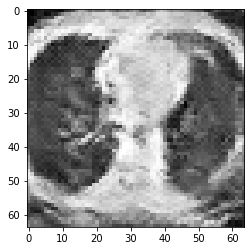

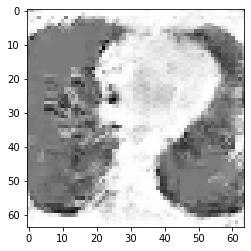

[299/300][0/6]
- D_loss : 0.2434 / G_loss : 1.8681
- D(x) : 0.8296 / D(G(z1)) : 0.0437 / D(G(z2)) : 0.2105 / d_acc : 0.9922
[299/300][1/6]
- D_loss : 0.3430 / G_loss : 1.4538
- D(x) : 0.8482 / D(G(z1)) : 0.1522 / D(G(z2)) : 0.2541 / d_acc : 1.0000
[299/300][2/6]
- D_loss : 0.3416 / G_loss : 0.9602
- D(x) : 0.7963 / D(G(z1)) : 0.0897 / D(G(z2)) : 0.4134 / d_acc : 0.9844
[299/300][3/6]
- D_loss : 0.3619 / G_loss : 3.4212
- D(x) : 0.9365 / D(G(z1)) : 0.2465 / D(G(z2)) : 0.0434 / d_acc : 0.9922
[299/300][4/6]
- D_loss : 0.2807 / G_loss : 1.3340
- D(x) : 0.8074 / D(G(z1)) : 0.0323 / D(G(z2)) : 0.2970 / d_acc : 0.9766
[299/300][5/6]
- D_loss : 0.3678 / G_loss : 4.3474
- D(x) : 0.9621 / D(G(z1)) : 0.2655 / D(G(z2)) : 0.0172 / d_acc : 0.9688


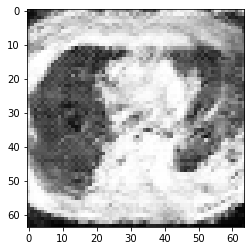

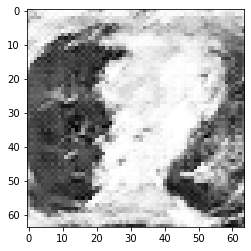

[300/300][0/6]
- D_loss : 0.2367 / G_loss : 2.4648
- D(x) : 0.8231 / D(G(z1)) : 0.0159 / D(G(z2)) : 0.1084 / d_acc : 0.9688
[300/300][1/6]
- D_loss : 0.2312 / G_loss : 0.6585
- D(x) : 0.8657 / D(G(z1)) : 0.0641 / D(G(z2)) : 0.5313 / d_acc : 0.9844
[300/300][2/6]
- D_loss : 0.8794 / G_loss : 5.1082
- D(x) : 0.8015 / D(G(z1)) : 0.4251 / D(G(z2)) : 0.0143 / d_acc : 0.7969
[300/300][3/6]
- D_loss : 0.1382 / G_loss : 3.7896
- D(x) : 0.8962 / D(G(z1)) : 0.0115 / D(G(z2)) : 0.0521 / d_acc : 0.9922
[300/300][4/6]
- D_loss : 0.2630 / G_loss : 0.9503
- D(x) : 0.8142 / D(G(z1)) : 0.0317 / D(G(z2)) : 0.4483 / d_acc : 0.9609
[300/300][5/6]
- D_loss : 0.5434 / G_loss : 5.5458
- D(x) : 0.9624 / D(G(z1)) : 0.3776 / D(G(z2)) : 0.0059 / d_acc : 0.8750


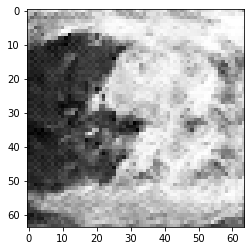

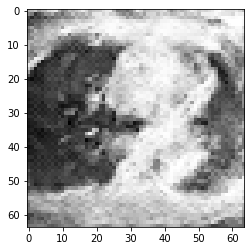

In [ ]:
for epoch in range(epochs):
    train(epoch, learning_G_per_D = 4)


# Graph

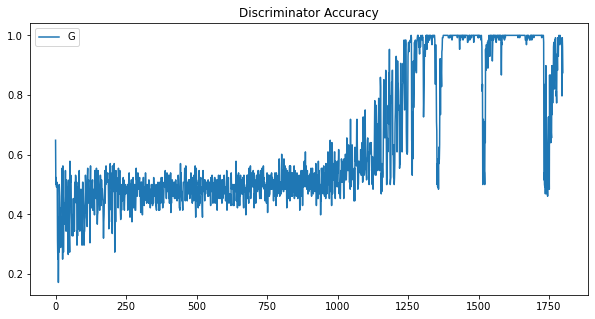

In [ ]:
#Results: Finally, lets check out how we did.
# Below is a plot of D & G’s losses versus training iterations.

plt.figure(figsize=(10,5))
plt.title("Discriminator Accuracy")
plt.plot(Acc, label="G")
plt.legend()
plt.savefig('Disc_Accuracy.png')
plt.show()

In [ ]:
def plot_train_loss():
    plt.figure(figsize=(10,5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(G_losses, label="G")
    plt.plot(D_losses,label="D")
    plt.xlabel("iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.show()

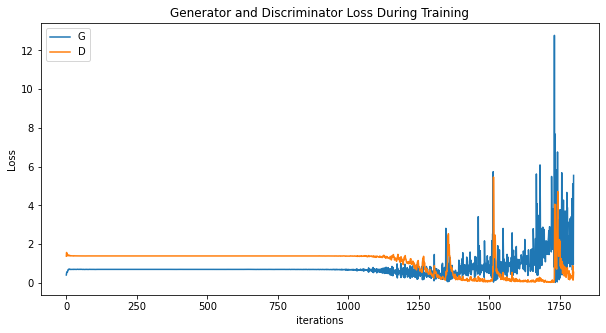

In [ ]:
plot_train_loss()

# Animation

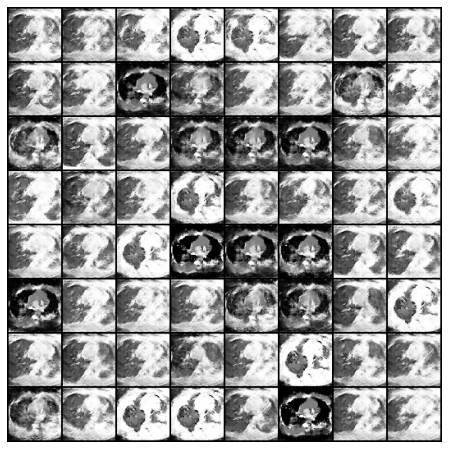

In [ ]:
#Visualization of Generator progression

#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# Test dataset

In [ ]:

test_data_root = "C:/Users/nafti/OneDrive/Bureau/Conda/data/COVID/"
test_data_set = dataset.ImageFolder(root = test_data_root,
                           transform = transforms.Compose([
                                  transforms.Resize(img_size),
                                  transforms.CenterCrop(img_size),
                                  torchvision.transforms.Grayscale(channel),
                                  transforms.ToTensor(),
                                  transforms.Normalize((0.5,),(0.5,))
                              ]))


# dataloader
test_data_loader = torch.utils.data.DataLoader(test_data_set, batch_size = 1,
                                              shuffle = False, num_workers = workers)

# Anomaly Loss

In [ ]:
latent_vector = torch.randn(1, latent_size, 1, 1, device = device, requires_grad=True)

def Anomaly_loss(Test_Data, G_Data, Lambda=0.1):
    _, Test_Data_feature = D(Test_Data)
    _, G_Data_feature = D(G_Data)
    residual_loss = torch.sum(torch.abs(Test_Data - G_Data))
    discrimination_loss = torch.sum(torch.abs(Test_Data_feature - G_Data_feature))
    ano_loss = (1-Lambda)*residual_loss + Lambda*discrimination_loss
    
    return ano_loss

z_optimizer = torch.optim.Adam([latent_vector],lr=0.01,betas=(0.5, 0.999))



# Train Latent Space Z

In [ ]:
latent_space = []
auc=[]

def train_latent_space():
    
    for i,data in enumerate(test_data_loader,0):
        test_img = data[0].to(device)
        print("picture ", i+1)
        for step in range(401):

            G_Data = G(latent_vector)
            ano_loss = Anomaly_loss(test_img, G_Data)

            z_optimizer.zero_grad()

            # residual loss, dicriminator loss 
            ano_loss.backward(retain_graph = True)

            z_optimizer.step()

            if step%200 == 0:

                loss   = ano_loss.item()
                noises = torch.sum(latent_vector).item()
                print("[%d]\t Ano_loss : %.4f  Sum_of_z : %.4f" %(step,loss, noises))
                if step == 400:
                    latent_space.append(latent_vector.cpu().data.numpy())
                    if loss > 500:
                        auc.append(1)
                    else :
                        auc.append(0)

In [ ]:
train_latent_space()

latent_space = np.array(latent_space)
latent_space = torch.Tensor(latent_space).to(device)

picture  1
[0]	 Ano_loss : 2030.2141  Sum_of_z : 2.4960
[200]	 Ano_loss : 1560.2369  Sum_of_z : -2.3124
[400]	 Ano_loss : 1412.9369  Sum_of_z : -2.3769
picture  2
[0]	 Ano_loss : 2209.8337  Sum_of_z : -2.4307
[200]	 Ano_loss : 1745.5809  Sum_of_z : 2.6902
[400]	 Ano_loss : 1684.2809  Sum_of_z : 3.9972
picture  3
[0]	 Ano_loss : 1659.5833  Sum_of_z : 4.0001
[200]	 Ano_loss : 1442.3872  Sum_of_z : 4.1608
[400]	 Ano_loss : 1376.4044  Sum_of_z : 6.4657
picture  4
[0]	 Ano_loss : 1551.1909  Sum_of_z : 6.5022
[200]	 Ano_loss : 1388.9258  Sum_of_z : 12.8280
[400]	 Ano_loss : 1352.9209  Sum_of_z : 12.2697
picture  5
[0]	 Ano_loss : 2152.1204  Sum_of_z : 12.2553
[200]	 Ano_loss : 1574.1947  Sum_of_z : 10.2775
[400]	 Ano_loss : 1500.5209  Sum_of_z : 10.6936
picture  6
[0]	 Ano_loss : 1500.1124  Sum_of_z : 10.6191
[200]	 Ano_loss : 1422.9624  Sum_of_z : 10.9208
[400]	 Ano_loss : 1378.8553  Sum_of_z : 11.3081
picture  7
[0]	 Ano_loss : 1597.4451  Sum_of_z : 11.1828
[200]	 Ano_loss : 1290.0715  Sum

In [ ]:
latent_space = []
auc=[]

def train_latent_space():
    
    for i,data in enumerate(data_loader,0):
        test_img = data[0].to(device)
        print("picture ", i+1)
        for step in range(401):

            G_Data = G(latent_vector)
            ano_loss = Anomaly_loss(test_img, G_Data)

            z_optimizer.zero_grad()

            # residual loss, dicriminator loss 
            ano_loss.backward(retain_graph = True)

            z_optimizer.step()

            if step%200 == 0:

                loss   = ano_loss.item()
                noises = torch.sum(latent_vector).item()
                print("[%d]\t Ano_loss : %.4f  Sum_of_z : %.4f" %(step,loss, noises))
                if step == 400:
                    latent_space.append(latent_vector.cpu().data.numpy())
                    if loss > 500:
                        auc.append(1)
                    else :
                        auc.append(0)

In [ ]:
train_latent_space()

latent_space = np.array(latent_space)
latent_space = torch.Tensor(latent_space).to(device)

picture  1
[0]	 Ano_loss : 153048.7969  Sum_of_z : -12.0743
[200]	 Ano_loss : 118610.2344  Sum_of_z : 4.4131
[400]	 Ano_loss : 117401.6797  Sum_of_z : 4.4605
picture  2
[0]	 Ano_loss : 120124.8125  Sum_of_z : 4.4114
[200]	 Ano_loss : 119509.9375  Sum_of_z : 6.4904
[400]	 Ano_loss : 119364.3125  Sum_of_z : 8.6175
picture  3
[0]	 Ano_loss : 113995.2422  Sum_of_z : 8.5383
[200]	 Ano_loss : 113366.0234  Sum_of_z : 10.1163
[400]	 Ano_loss : 113316.8828  Sum_of_z : 10.9227
picture  4
[0]	 Ano_loss : 119510.6719  Sum_of_z : 11.0031
[200]	 Ano_loss : 118340.9688  Sum_of_z : 14.0248
[400]	 Ano_loss : 118150.1875  Sum_of_z : 15.4258
picture  5
[0]	 Ano_loss : 120370.2422  Sum_of_z : 15.3822
[200]	 Ano_loss : 119764.2969  Sum_of_z : 14.5368
[400]	 Ano_loss : 119705.4375  Sum_of_z : 15.0229
picture  6
[0]	 Ano_loss : 110807.2734  Sum_of_z : 15.0672
[200]	 Ano_loss : 110561.3906  Sum_of_z : 16.7344
[400]	 Ano_loss : 110519.2500  Sum_of_z : 17.9334


---

# Function to check the number of abnormal pixels

In [ ]:
def count_el_not_0(diff_img):
    count_el_not_0 = 0
    
    col_size = diff_img.shape[0]
    row_size = diff_img.shape[1]
    
    #print(col_size, row_size)
    
    for col in range(col_size):
        for row in range(row_size):
            if diff_img[col][row] != 0:
                count_el_not_0 += 1
                
    return count_el_not_0

# Similar Z , Ano_Score and Segementation


In [ ]:
#Compare input images with generated images 
diff_cnts = []
diff_points = []
anomaly_imgs = []


def compare_imgs(real_img, generated_img, i, reverse=False, threshold=50):
    global anomaly_img
    
    score = Anomaly_loss(real_img, generated_img)
    score = round(score.item(), 2)
    
    real_img = real_img.cpu().data.numpy().reshape(img_size, img_size) * 255
    generated_img = generated_img.cpu().data.numpy().reshape(img_size, img_size) * 255
    
    negative = np.zeros_like(real_img)
    
    if not reverse:
        diff_img = real_img - generated_img
    else:
        diff_img = generated_img - real_img
    diff_img[diff_img <= threshold] = 0
    
    # Fraction extraction
    diff_cnts.append(count_el_not_0(diff_img))
    
    # Distributed extraction
    diff_points.append(np.where(diff_img > threshold))
    
    
    anomaly_img = np.zeros(shape=(img_size, img_size, 3))
    anomaly_img[:, :, 0] = real_img - diff_img
    anomaly_img[:, :, 1] = real_img - diff_img
    anomaly_img[:, :, 2] = real_img - diff_img
    anomaly_img[:, :, 0] = anomaly_img[:,:,0] + diff_img
    anomaly_img = anomaly_img.astype(np.uint8)
    
    # anomaly_img
    anomaly_imgs.append(anomaly_img)
    
    fig, plots = plt.subplots(1, 4)
    if auc[i] == 0:
        fig.suptitle(f'Normal - (anomaly score: {score:.4})')
    else :
        fig.suptitle(f'Anomaly - (anomaly score: {score:.4})')
    
    fig.set_figwidth(9)
    fig.set_tight_layout(True)
    plots = plots.reshape(-1)
    plots[0].imshow(real_img, cmap='gray', label = "real")
    plots[1].imshow(generated_img, cmap='gray')
    plots[2].imshow(diff_img, cmap='gray')
    plots[3].imshow(anomaly_img)
    
    plots[0].set_title('real')
    plots[1].set_title('generated')
    plots[2].set_title('difference')
    plots[3].set_title('Anomaly Detection')

C:\Users\nafti\anaconda3\envs\st\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


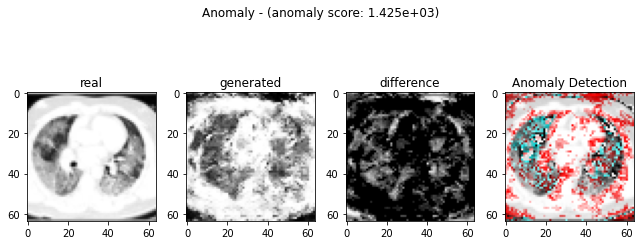

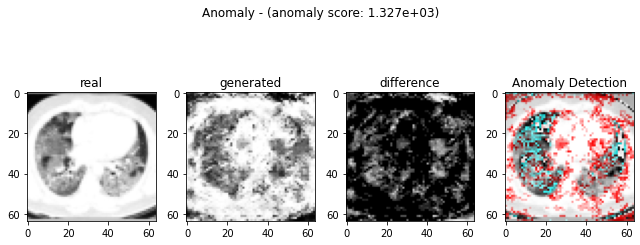

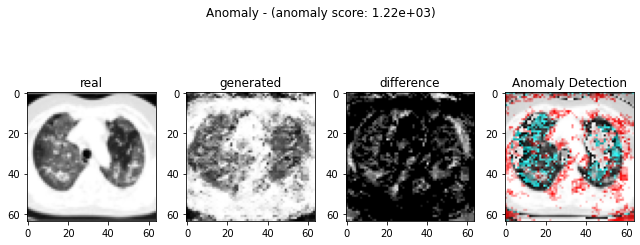

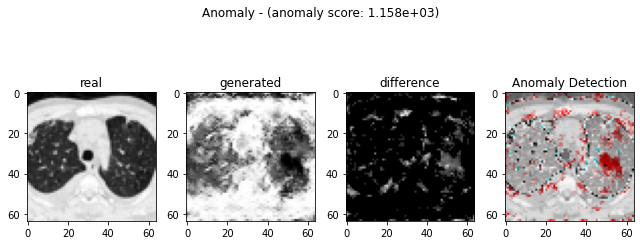

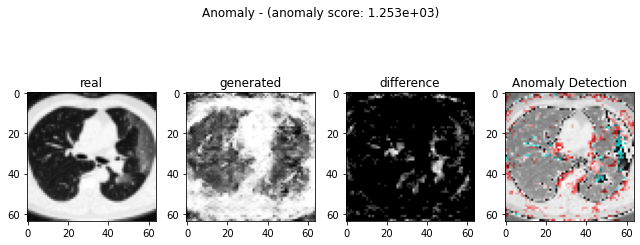

...

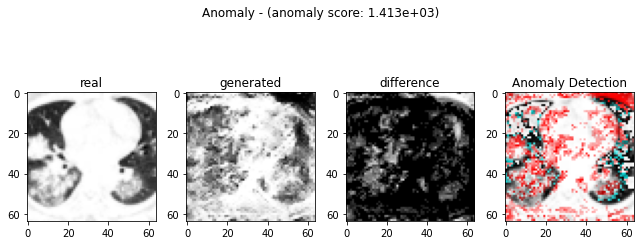

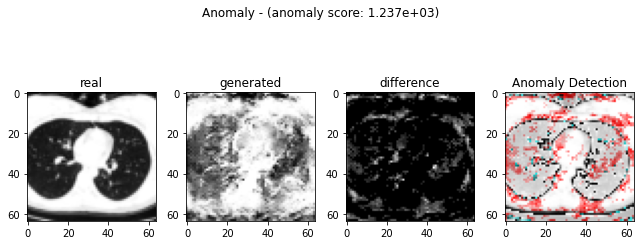

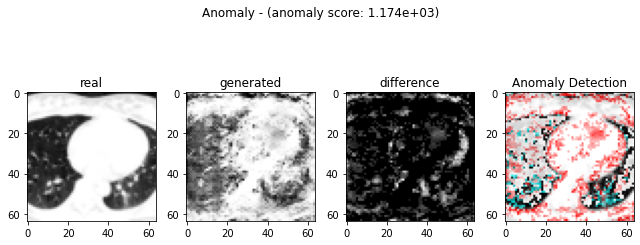

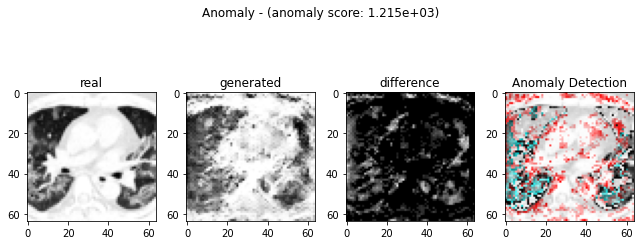

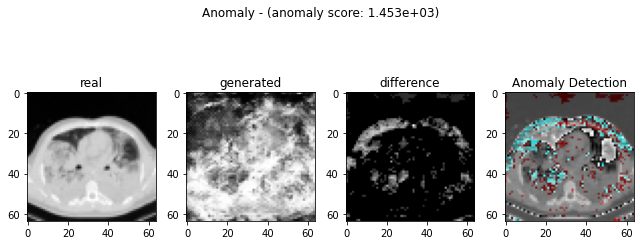

In [ ]:
for i,data in enumerate(test_data_loader,0):
    test_img = data[0].to(device)

    #for i in range(len(latent_space)):
    update_z = latent_space[i]
    R_img = test_img
    G_img = G(update_z).to(device)
    
    if i in [9]:
        compare_imgs(R_img, G_img,i,reverse = True, threshold = 50)
    else:
        compare_imgs(R_img, G_img,i,reverse = False, threshold = 50)

---

# Fraction Extraction

In [ ]:
diff_cnts = np.array(diff_cnts)

diff_fraction = diff_cnts / img_size ** 2

print(diff_fraction)

[0.47241211 0.44677734 0.3762207  0.17944336 0.18041992 0.29345703
 0.26318359 0.19238281 0.25756836 0.3203125  0.18139648 0.35083008
 0.35107422 0.26928711 0.31689453 0.35961914 0.45947266 0.2421875
 0.08984375 0.24462891 0.32006836 0.37255859 0.3034668  0.19995117
 0.26416016 0.20068359 0.24316406 0.20800781 0.16625977 0.35302734
 0.33154297 0.20117188 0.17285156 0.2265625  0.1340332  0.24365234
 0.26293945 0.23608398 0.2800293  0.23266602 0.24047852 0.25805664
 0.25439453 0.3605957  0.28613281 0.31689453 0.29248047 0.28344727
 0.31079102 0.3972168  0.40551758 0.17041016 0.19287109 0.234375
 0.1394043  0.24267578 0.17700195 0.18701172 0.17431641 0.2277832
 0.2097168  0.16186523 0.21582031 0.21142578 0.44067383 0.28662109
 0.38061523 0.37451172 0.18920898]


---

# Extract distributed

In [ ]:
from scipy import stats
from extended_int import int_inf

corr_coeffis = []
corr_p_vals = []

def cal_corr_coeffis():
    for idx in range(len(test_data_loader)):
        x_points = diff_points[idx][0]
        y_points = diff_points[idx][1]
        
        
        if len(x_points) > 0:
            corr_coeffi, corr_p_val = stats.pearsonr(x_points, y_points)
        else:
            corr_coeffi, corr_p_val = -int_inf, -int_inf
        
        corr_coeffis.append(corr_coeffi)
        corr_p_vals.append(corr_p_val)

In [ ]:
cal_corr_coeffis()

print(corr_coeffis)

[0.03315667757837506, 0.035940178752322735, 0.052305577781107705, -0.020984378713708382, -0.025389594209539176, 0.10992629261660919, -0.20278350814196616, -0.043323965654675646, -0.14702471169984863, -0.06726650503509499, 0.2579211191966573, 0.06202464137523263, -0.1383059283686658, 0.065738667316467, 0.027502491673833233, 0.039715599109976164, 0.01093299023717555, -0.008327250814638067, 0.09269685577372364, 0.23197112337838122, -0.10657678141510041, 0.00801456126394699, -0.08392831228189378, 0.24105096057579578, 0.21442227197562885, 0.41295428103553655, 0.2666809627456574, 0.27842522225263816, -0.013554410380310399, -0.04378647055299549, -0.03034826570507848, 0.016838112015054134, 0.0024255877409884805, -0.041502699559716916, -0.1713817455567177, 0.19960652290198383, 0.09037861795140156, 0.26672229125208435, 0.05478494866972201, 0.10191603694130928, 0.016345896355117625, 0.13576010016206191, 0.008256289120285207, -0.07466882408113636, 0.043129557158527544, -0.09145596431546343, -0.091

---

# Save & Read model

In [ ]:
save_file = "./pretrained/pretrained.pth"

def save_pretrained():
    pretrained = {
        "D" : D.state_dict(),
        "G" : G.state_dict(),
        #"latent_space" : latent_space.state_dict()
    }

    if not os.path.isdir("pretrained"):
        os.mkdir("pretrained")
    torch.save(pretrained, save_file)

In [ ]:
save_pretrained()

In [ ]:
pretrained_D = Discriminator().to(device)
pretrained_G = Generator().to(device)
#pretrained_latent_space = [] # 

def load_pretrained():
    global pretrained_D
    global pretrained_G
    #global pretrained_latent_space
    
    assert os.path.isdir("pretrained"), "Error : no pretrained dir found!"
    
    pretrained = torch.load(save_file)
    
    pretrained_D.load_state_dict(pretrained["D"])
    pretrained_G.load_state_dict(pretrained["G"])
    #pretrained_latent_space.load_state_dict(pretrained["latent_space"])
    
    #print("pretrained_D :", pretrained_D)
    #print("pretrained_G :", pretrained_G)
    #print("pretrained_latent_space :", pretrained_latent_space)

In [ ]:
load_pretrained()

In [ ]:
def Anomaly_loss(Test_Data, G_Data, Lambda=0.1):
    
    _, Test_Data_feature = pretrained_D(Test_Data)
    _, G_Data_feature = pretrained_D(G_Data)
    
    residual_loss = torch.sum(torch.abs(Test_Data - G_Data))
    discrimination_loss = torch.sum(torch.abs(Test_Data_feature - G_Data_feature))
    
    ano_loss = (1-Lambda)*residual_loss + Lambda*discrimination_loss
    
    return ano_loss

In [ ]:
# train latent_space

latent_space = []
auc = []

def train_latent_space():
    global latent_space
    global auc
    
    for i,data in enumerate(data_loader,0):
        test_img = data[0].to(device)
        print("picture ", i+1)
        
        for step in range(401):
            G_Data   = pretrained_G(latent_vector)
            ano_loss = Anomaly_loss(test_img, G_Data)

            z_optimizer.zero_grad()

            # residual loss, dicriminator loss 
            ano_loss.backward(retain_graph = True)

            z_optimizer.step()

            if step%200 == 0:

                loss   = ano_loss.item()
                noises = torch.sum(latent_vector).item()
                print("[%d]\t Ano_loss : %.4f  Sum_of_z : %.4f" %(step,loss,noises))
                if step==400:
                    latent_space.append(latent_vector.cpu().data.numpy())
                    if loss>500:
                        auc.append(1)
                    else :
                        auc.append(0)

In [ ]:
#train dataset
train_latent_space()

latent_space = np.array(latent_space)
latent_space = torch.Tensor(latent_space).to(device)

picture  1
[0]	 Ano_loss : 117663.2734  Sum_of_z : 17.8831
[200]	 Ano_loss : 117402.0703  Sum_of_z : 18.8364
[400]	 Ano_loss : 117310.2891  Sum_of_z : 18.7731
picture  2
[0]	 Ano_loss : 113312.1406  Sum_of_z : 18.7982
[200]	 Ano_loss : 112954.9531  Sum_of_z : 20.3869
[400]	 Ano_loss : 112623.4141  Sum_of_z : 21.1298
picture  3
[0]	 Ano_loss : 114447.8906  Sum_of_z : 21.1391
[200]	 Ano_loss : 114208.8516  Sum_of_z : 24.0747
[400]	 Ano_loss : 114138.7266  Sum_of_z : 24.5042
picture  4
[0]	 Ano_loss : 123283.9609  Sum_of_z : 24.5010
[200]	 Ano_loss : 122528.8672  Sum_of_z : 20.6584
[400]	 Ano_loss : 122283.6328  Sum_of_z : 20.6828
picture  5
[0]	 Ano_loss : 116992.5781  Sum_of_z : 20.6217
[200]	 Ano_loss : 116406.0781  Sum_of_z : 20.1985
[400]	 Ano_loss : 116350.0859  Sum_of_z : 20.1023
picture  6
[0]	 Ano_loss : 113042.1094  Sum_of_z : 20.0670
[200]	 Ano_loss : 112507.2812  Sum_of_z : 21.4363
[400]	 Ano_loss : 112396.5000  Sum_of_z : 23.7101


In [ ]:
#test dataset
train_latent_space()

latent_space = np.array(latent_space)
latent_space = torch.Tensor(latent_space).to(device)

picture  1
[0]	 Ano_loss : 2227.2102  Sum_of_z : 26.3106
[200]	 Ano_loss : 1484.8152  Sum_of_z : 16.7524
[400]	 Ano_loss : 1407.9867  Sum_of_z : 14.2286
picture  2
[0]	 Ano_loss : 1423.7656  Sum_of_z : 14.2923
[200]	 Ano_loss : 1326.9703  Sum_of_z : 17.6244
[400]	 Ano_loss : 1298.7079  Sum_of_z : 20.8053
picture  3
[0]	 Ano_loss : 1545.4177  Sum_of_z : 20.5591
[200]	 Ano_loss : 1300.1846  Sum_of_z : 23.0821
[400]	 Ano_loss : 1231.9474  Sum_of_z : 23.2769
picture  4
[0]	 Ano_loss : 1707.2712  Sum_of_z : 23.0997
[200]	 Ano_loss : 1299.4443  Sum_of_z : 12.0886
[400]	 Ano_loss : 1255.6183  Sum_of_z : 9.3688
picture  5
[0]	 Ano_loss : 1632.1500  Sum_of_z : 9.2986
[200]	 Ano_loss : 1380.3938  Sum_of_z : 7.7674
[400]	 Ano_loss : 1323.4497  Sum_of_z : 4.2545
picture  6
[0]	 Ano_loss : 1584.4440  Sum_of_z : 4.1670
[200]	 Ano_loss : 1318.5750  Sum_of_z : -6.9891
[400]	 Ano_loss : 1251.6030  Sum_of_z : -5.7679
picture  7
[0]	 Ano_loss : 2284.0066  Sum_of_z : -6.1536
[200]	 Ano_loss : 1502.1002  S

In [ ]:
def test():
    for i,data in enumerate(test_data_loader,0):
        test_img = data[0].to(device)

        #for i in range(len(latent_space)):
        update_z = latent_space[i]
        R_img = test_img
        G_img = pretrained_G(update_z).to(device)

        if i in [9]:
            compare_imgs(R_img, G_img,i,reverse = True, threshold = 50)
        else:
            compare_imgs(R_img, G_img,i,reverse = False, threshold = 50)

C:\Users\nafti\anaconda3\envs\st\lib\site-packages\ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


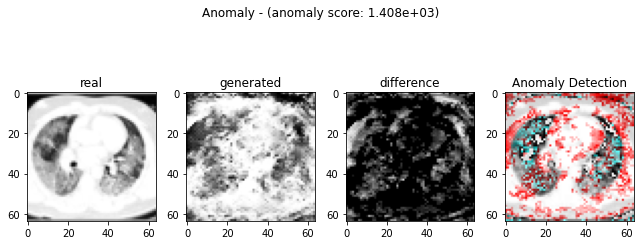

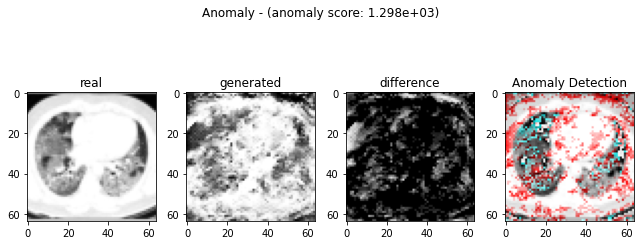

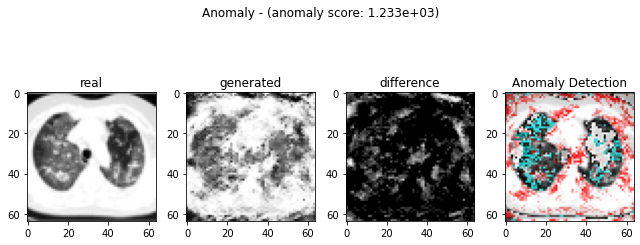

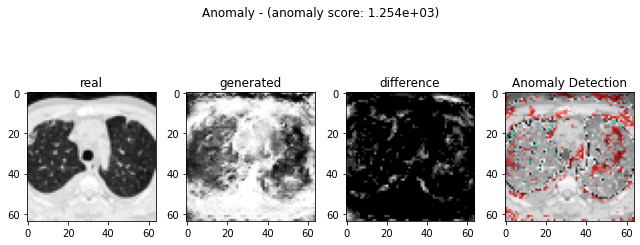

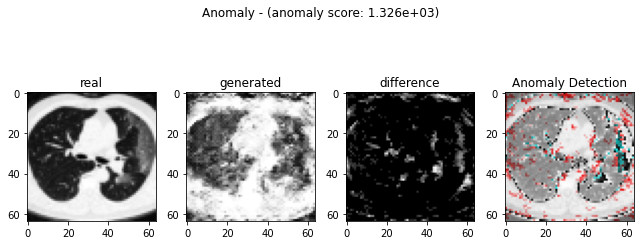

...

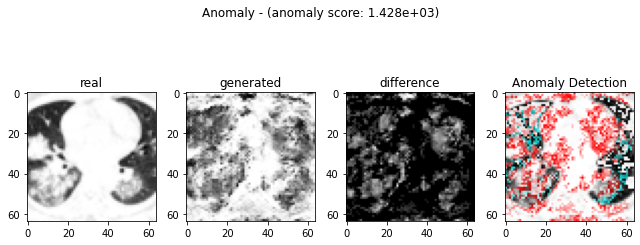

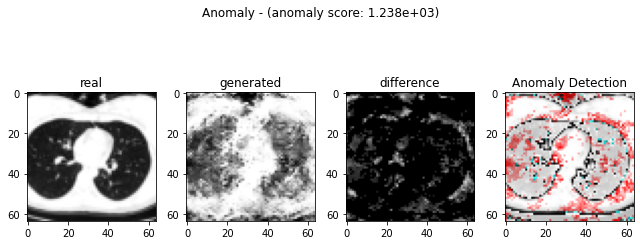

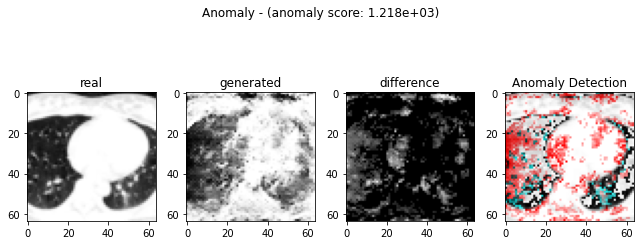

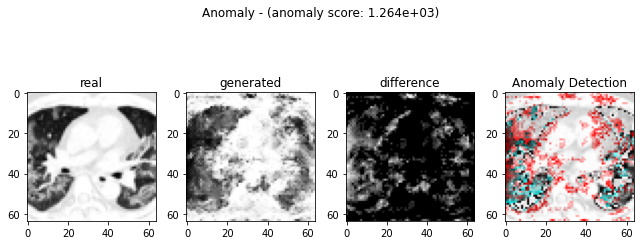

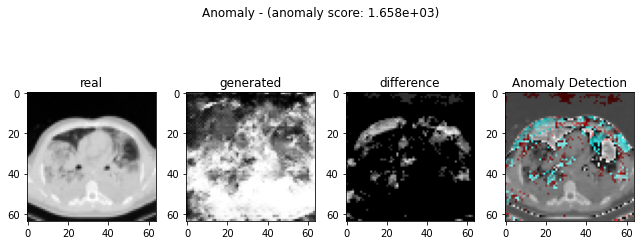

In [ ]:
diff_cnts = []
diff_points = []
anomaly_imgs = []

corr_coeffis = []
corr_p_vals = []

test()

In [ ]:
diff_cnts = np.array(diff_cnts)

diff_fraction = diff_cnts / img_size ** 2

print(diff_fraction)

[0.45532227 0.43286133 0.36962891 0.21899414 0.1862793  0.29516602
 0.26367188 0.21728516 0.2722168  0.33862305 0.17089844 0.36328125
 0.36303711 0.26977539 0.33349609 0.40673828 0.47167969 0.23461914
 0.08764648 0.2878418  0.34741211 0.39599609 0.29199219 0.15771484
 0.24462891 0.17114258 0.22216797 0.20922852 0.15893555 0.34472656
 0.30908203 0.18554688 0.17626953 0.2434082  0.14135742 0.2265625
 0.25537109 0.24804688 0.30151367 0.20068359 0.17578125 0.16601562
 0.17529297 0.36035156 0.30126953 0.33007812 0.30981445 0.25415039
 0.30444336 0.36523438 0.37695312 0.17724609 0.203125   0.23852539
 0.13110352 0.2668457  0.12915039 0.1796875  0.16088867 0.18457031
 0.19702148 0.12915039 0.17456055 0.1965332  0.46533203 0.28540039
 0.38623047 0.38842773 0.18554688]


In [ ]:
cal_corr_coeffis()

print(corr_coeffis)

[-0.02196916715270584, -0.00034414487267862403, 0.039367447167079, -0.15748668243424968, 0.047846550309872546, -0.06416306860060465, -0.3189586863017586, -0.32836634567286366, -0.1324909902732412, 0.00878101567162926, 0.19740210919591406, 0.03637328876664117, -0.1122335782292446, 0.09333996746883953, 0.01500546457114395, 0.016167602177597037, 0.09219193413409452, 0.08967627825797715, -0.17921384185558759, 0.030058463005102388, -0.02194224733518785, 0.007588223725206735, -0.078610114212856, 0.34127257788224385, 0.3433548097224511, 0.22833463764636522, 0.10602204085005161, 0.3372477692115958, 0.014389034332901784, 0.11408466261415381, -0.05312356885272922, 0.11473206654496176, 0.004937305234586116, -0.08691819009559579, -0.08776317233985903, 0.10683463029115299, 0.04300028580072118, -0.0485192859546595, 0.0791501535387335, 0.02944885502336509, -0.0684080169515351, -0.05502797072748704, -0.08742384004631007, -0.05360109590075045, -0.08873211952661525, -0.12718160047007168, -0.112829181790

---

# Extract anomaly detection image

In [ ]:
anomaly_imgs

[array([[[173, 122, 122],
         [173, 120, 120],
         [173, 136, 136],
         ...,
         [171,  44,  44],
         [173,  61,  61],
         [173, 112, 112]],
 
        [[199,  23,  23],
         [197,  67,  67],
         [201,  53,  53],
         ...,
         [201,  83,  83],
         [200, 200, 200],
         [200, 200, 200]],
 
        [[171,   6,   6],
         [168,  58,  58],
         [168,  88,  88],
         ...,
         [172, 172, 172],
         [170, 170, 170],
         [172, 172, 172]],
 
        ...,
 
        [[227,  72,  72],
         [ 25, 138, 138],
         [ 91, 160, 160],
         ...,
         [190, 190, 190],
         [200, 200, 200],
         [  9,  83,  83]],
 
        [[213, 119, 119],
         [209,  71,  71],
         [213, 115, 115],
         ...,
         [ 55, 186, 186],
         [121,   4,   4],
         [129, 135, 135]],
 
        [[ 85, 202, 202],
         [ 77, 197, 197],
         [ 79, 169, 169],
         ...,
         [125, 249, 249],
  

# Anomaly Image save function

In [ ]:
import cv2

def save_imgs(folder, imgs):
    if not os.path.isdir("anomaly_imgs"):
        os.mkdir("anomaly_imgs")
    
    for i in range(len(imgs)):
        cv2.imwrite('%s/%d.png' %(folder,i), imgs[i]) 
    print("image saving complete")

In [ ]:
save_imgs("./anomaly_imgs", anomaly_imgs)

image saving complete


---